# What's this PyTorch business?

You've written a lot of code in this assignment to provide a whole host of neural network functionality. Dropout, Batch Norm, and 2D convolutions are some of the workhorses of deep learning in computer vision. You've also worked hard to make your code efficient and vectorized.

For the last part of this assignment, though, we're going to leave behind your beautiful codebase and instead migrate to one of two popular deep learning frameworks: in this instance, PyTorch (or TensorFlow, if you choose to use that notebook).

### What is PyTorch?

PyTorch is a system for executing dynamic computational graphs over Tensor objects that behave similarly as numpy ndarray. It comes with a powerful automatic differentiation engine that removes the need for manual back-propagation. 

### Why?

* Our code will now run on GPUs! Much faster training. When using a framework like PyTorch or TensorFlow you can harness the power of the GPU for your own custom neural network architectures without having to write CUDA code directly (which is beyond the scope of this class).
* We want you to be ready to use one of these frameworks for your project so you can experiment more efficiently than if you were writing every feature you want to use by hand. 
* We want you to stand on the shoulders of giants! TensorFlow and PyTorch are both excellent frameworks that will make your lives a lot easier, and now that you understand their guts, you are free to use them :) 
* We want you to be exposed to the sort of deep learning code you might run into in academia or industry.

### PyTorch versions
This notebook assumes that you are using **PyTorch version 1.4**. In some of the previous versions (e.g. before 0.4), Tensors had to be wrapped in Variable objects to be used in autograd; however Variables have now been deprecated. In addition 1.0+ versions separate a Tensor's datatype from its device, and use numpy-style factories for constructing Tensors rather than directly invoking Tensor constructors.

## How will I learn PyTorch?

Justin Johnson has made an excellent [tutorial](https://github.com/jcjohnson/pytorch-examples) for PyTorch. 

You can also find the detailed [API doc](http://pytorch.org/docs/stable/index.html) here. If you have other questions that are not addressed by the API docs, the [PyTorch forum](https://discuss.pytorch.org/) is a much better place to ask than StackOverflow.

## Install PyTorch 1.4 (ONLY IF YOU ARE WORKING LOCALLY)

1. Have the latest version of Anaconda installed on your machine.
2. Create a new conda environment starting from Python 3.7. In this setup example, we'll call it `torch_env`.
3. Run the command: `conda activate torch_env`
4. Run the command: `pip install torch==1.4 torchvision==0.5.0`

# Table of Contents

This assignment has 5 parts. You will learn PyTorch on **three different levels of abstraction**, which will help you understand it better and prepare you for the final project. 

1. Part I, Preparation: we will use CIFAR-10 dataset.
2. Part II, Barebones PyTorch: **Abstraction level 1**, we will work directly with the lowest-level PyTorch Tensors. 
3. Part III, PyTorch Module API: **Abstraction level 2**, we will use `nn.Module` to define arbitrary neural network architecture. 
4. Part IV, PyTorch Sequential API: **Abstraction level 3**, we will use `nn.Sequential` to define a linear feed-forward network very conveniently. 
5. Part V, CIFAR-10 open-ended challenge: please implement your own network to get as high accuracy as possible on CIFAR-10. You can experiment with any layer, optimizer, hyperparameters or other advanced features. 

Here is a table of comparison:

| API           | Flexibility | Convenience |
|---------------|-------------|-------------|
| Barebone      | High        | Low         |
| `nn.Module`     | High        | Medium      |
| `nn.Sequential` | Low         | High        |

# Part I. Preparation

First, we load the CIFAR-10 dataset. This might take a couple minutes the first time you do it, but the files should stay cached after that.

In previous parts of the assignment we had to write our own code to download the CIFAR-10 dataset, preprocess it, and iterate through it in minibatches; PyTorch provides convenient tools to automate this process for us.

In [ ]:
!nvidia-smi

Wed Oct  7 05:14:59 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   51C    P0    25W /  75W |   7603MiB /  7611MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import torch
# assert '.'.join(torch.__version__.split('.')[:2]) == '1.4'
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler

import torchvision.datasets as dset
import torchvision.transforms as T

import numpy as np

In [ ]:
NUM_TRAIN = 49000

# The torchvision.transforms package provides tools for preprocessing data
# and for performing data augmentation; here we set up a transform to
# preprocess the data by subtracting the mean RGB value and dividing by the
# standard deviation of each RGB value; we've hardcoded the mean and std.
transform = T.Compose([
                T.ToTensor(),
                T.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
            ])

# We set up a Dataset object for each split (train / val / test); Datasets load
# training examples one at a time, so we wrap each Dataset in a DataLoader which
# iterates through the Dataset and forms minibatches. We divide the CIFAR-10
# training set into train and val sets by passing a Sampler object to the
# DataLoader telling how it should sample from the underlying Dataset.
cifar10_train = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                             transform=transform)
loader_train = DataLoader(cifar10_train, batch_size=64, 
                          sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN)))

cifar10_val = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                           transform=transform)
loader_val = DataLoader(cifar10_val, batch_size=64, 
                        sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN, 50000)))

cifar10_test = dset.CIFAR10('./cs231n/datasets', train=False, download=True, 
                            transform=transform)
loader_test = DataLoader(cifar10_test, batch_size=64)
!nvidia-smi

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Wed Oct  7 05:15:07 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   51C    P0    25W /  75W |   7603MiB /  7611MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+---------------------

You have an option to **use GPU by setting the flag to True below**. It is not necessary to use GPU for this assignment. Note that if your computer does not have CUDA enabled, `torch.cuda.is_available()` will return False and this notebook will fallback to CPU mode.

The global variables `dtype` and `device` will control the data types throughout this assignment.

## Colab Users

If you are using Colab, you need to manually switch to a GPU device. You can do this by clicking `Runtime -> Change runtime type` and selecting `GPU` under `Hardware Accelerator`. Note that you have to rerun the cells from the top since the kernel gets restarted upon switching runtimes.

In [ ]:
USE_GPU = True

dtype = torch.float32 # we will be using float throughout this tutorial

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

# Constant to control how frequently we print train loss
print_every = 100

print('using device:', device)
!nvidia-smi

using device: cuda
Wed Oct  7 05:15:08 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   51C    P0    25W /  75W |   7603MiB /  7611MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                     

# Part II. Barebones PyTorch

PyTorch ships with high-level APIs to help us define model architectures conveniently, which we will cover in Part II of this tutorial. In this section, we will start with the barebone PyTorch elements to understand the autograd engine better. After this exercise, you will come to appreciate the high-level model API more.

We will start with a simple fully-connected ReLU network with two hidden layers and no biases for CIFAR classification. 
This implementation computes the forward pass using operations on PyTorch Tensors, and uses PyTorch autograd to compute gradients. It is important that you understand every line, because you will write a harder version after the example.

When we create a PyTorch Tensor with `requires_grad=True`, then operations involving that Tensor will not just compute values; they will also build up a computational graph in the background, allowing us to easily backpropagate through the graph to compute gradients of some Tensors with respect to a downstream loss. Concretely if x is a Tensor with `x.requires_grad == True` then after backpropagation `x.grad` will be another Tensor holding the gradient of x with respect to the scalar loss at the end.

### PyTorch Tensors: Flatten Function
A PyTorch Tensor is conceptionally similar to a numpy array: it is an n-dimensional grid of numbers, and like numpy PyTorch provides many functions to efficiently operate on Tensors. As a simple example, we provide a `flatten` function below which reshapes image data for use in a fully-connected neural network.

Recall that image data is typically stored in a Tensor of shape N x C x H x W, where:

* N is the number of datapoints
* C is the number of channels
* H is the height of the intermediate feature map in pixels
* W is the height of the intermediate feature map in pixels

This is the right way to represent the data when we are doing something like a 2D convolution, that needs spatial understanding of where the intermediate features are relative to each other. When we use fully connected affine layers to process the image, however, we want each datapoint to be represented by a single vector -- it's no longer useful to segregate the different channels, rows, and columns of the data. So, we use a "flatten" operation to collapse the `C x H x W` values per representation into a single long vector. The flatten function below first reads in the N, C, H, and W values from a given batch of data, and then returns a "view" of that data. "View" is analogous to numpy's "reshape" method: it reshapes x's dimensions to be N x ??, where ?? is allowed to be anything (in this case, it will be C x H x W, but we don't need to specify that explicitly). 

In [ ]:
def flatten(x):
    N = x.shape[0] # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image

def test_flatten():
    x = torch.arange(12).view(2, 1, 3, 2)
    print('Before flattening: ', x)
    print('After flattening: ', flatten(x))

# test_flatten()
!nvidia-smi

Wed Oct  7 05:15:17 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   52C    P0    25W /  75W |   7603MiB /  7611MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Barebones PyTorch: Two-Layer Network

Here we define a function `two_layer_fc` which performs the forward pass of a two-layer fully-connected ReLU network on a batch of image data. After defining the forward pass we check that it doesn't crash and that it produces outputs of the right shape by running zeros through the network.

You don't have to write any code here, but it's important that you read and understand the implementation.

In [ ]:
import torch.nn.functional as F  # useful stateless functions

def two_layer_fc(x, params):
    """
    A fully-connected neural networks; the architecture is:
    NN is fully connected -> ReLU -> fully connected layer.
    Note that this function only defines the forward pass; 
    PyTorch will take care of the backward pass for us.
    
    The input to the network will be a minibatch of data, of shape
    (N, d1, ..., dM) where d1 * ... * dM = D. The hidden layer will have H units,
    and the output layer will produce scores for C classes.
    
    Inputs:
    - x: A PyTorch Tensor of shape (N, d1, ..., dM) giving a minibatch of
      input data.
    - params: A list [w1, w2] of PyTorch Tensors giving weights for the network;
      w1 has shape (D, H) and w2 has shape (H, C).
    
    Returns:
    - scores: A PyTorch Tensor of shape (N, C) giving classification scores for
      the input data x.
    """
    # first we flatten the image
    x = flatten(x)  # shape: [batch_size, C x H x W]
    
    w1, w2 = params
    
    # Forward pass: compute predicted y using operations on Tensors. Since w1 and
    # w2 have requires_grad=True, operations involving these Tensors will cause
    # PyTorch to build a computational graph, allowing automatic computation of
    # gradients. Since we are no longer implementing the backward pass by hand we
    # don't need to keep references to intermediate values.
    # you can also use `.clamp(min=0)`, equivalent to F.relu()
    x = F.relu(x.mm(w1))
    x = x.mm(w2)
    return x
    

def two_layer_fc_test():
    hidden_layer_size = 42
    x = torch.zeros((64, 50), dtype=dtype)  # minibatch size 64, feature dimension 50
    w1 = torch.zeros((50, hidden_layer_size), dtype=dtype)
    w2 = torch.zeros((hidden_layer_size, 10), dtype=dtype)
    scores = two_layer_fc(x, [w1, w2])
    print(scores.size())  # you should see [64, 10]

# two_layer_fc_test()
!nvidia-smi

Wed Oct  7 05:15:22 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   52C    P0    25W /  75W |   7603MiB /  7611MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Barebones PyTorch: Three-Layer ConvNet

Here you will complete the implementation of the function `three_layer_convnet`, which will perform the forward pass of a three-layer convolutional network. Like above, we can immediately test our implementation by passing zeros through the network. The network should have the following architecture:

1. A convolutional layer (with bias) with `channel_1` filters, each with shape `KW1 x KH1`, and zero-padding of two
2. ReLU nonlinearity
3. A convolutional layer (with bias) with `channel_2` filters, each with shape `KW2 x KH2`, and zero-padding of one
4. ReLU nonlinearity
5. Fully-connected layer with bias, producing scores for C classes.

Note that we have **no softmax activation** here after our fully-connected layer: this is because PyTorch's cross entropy loss performs a softmax activation for you, and by bundling that step in makes computation more efficient.

**HINT**: For convolutions: http://pytorch.org/docs/stable/nn.html#torch.nn.functional.conv2d; pay attention to the shapes of convolutional filters!

In [ ]:
def three_layer_convnet(x, params):
    """
    Performs the forward pass of a three-layer convolutional network with the
    architecture defined above.

    Inputs:
    - x: A PyTorch Tensor of shape (N, 3, H, W) giving a minibatch of images
    - params: A list of PyTorch Tensors giving the weights and biases for the
      network; should contain the following:
      - conv_w1: PyTorch Tensor of shape (channel_1, 3, KH1, KW1) giving weights
        for the first convolutional layer
      - conv_b1: PyTorch Tensor of shape (channel_1,) giving biases for the first
        convolutional layer
      - conv_w2: PyTorch Tensor of shape (channel_2, channel_1, KH2, KW2) giving
        weights for the second convolutional layer
      - conv_b2: PyTorch Tensor of shape (channel_2,) giving biases for the second
        convolutional layer
      - fc_w: PyTorch Tensor giving weights for the fully-connected layer. Can you
        figure out what the shape should be?
      - fc_b: PyTorch Tensor giving biases for the fully-connected layer. Can you
        figure out what the shape should be?
    
    Returns:
    - scores: PyTorch Tensor of shape (N, C) giving classification scores for x
    """
    conv_w1, conv_b1, conv_w2, conv_b2, fc_w, fc_b = params
    scores = None
    ################################################################################
    # TODO: Implement the forward pass for the three-layer ConvNet.                #
    ################################################################################
    # *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
    channel_1, _, KH1, KW1 = list(conv_w1.size())
    channel_2, _, KH2, KW2 = list(conv_w2.size())

    out_conv_1 = F.conv2d(x, conv_w1, conv_b1, stride= 1, padding=2)
    out_relu_1 = F.relu(out_conv_1)
    out_conv_2 = F.conv2d(out_relu_1, conv_w2, conv_b2, stride= 1, padding=1)
    out_relu_2 = F.relu(out_conv_2)
    N = x.shape[0]
    out_relu_2 = out_relu_2.view(N, -1)
    out_fc     = out_relu_2.mm(fc_w) + fc_b
    scores = out_fc


    # *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
    ################################################################################
    #                                 END OF YOUR CODE                             #
    ################################################################################
    return scores
!nvidia-smi

Wed Oct  7 05:15:27 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   53C    P0    25W /  75W |   7603MiB /  7611MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

After defining the forward pass of the ConvNet above, run the following cell to test your implementation.

When you run this function, scores should have shape (64, 10).

In [ ]:
def three_layer_convnet_test():
    x = torch.zeros((64, 3, 32, 32), dtype=dtype)  # minibatch size 64, image size [3, 32, 32]

    conv_w1 = torch.zeros((6, 3, 5, 5), dtype=dtype)  # [out_channel, in_channel, kernel_H, kernel_W]
    conv_b1 = torch.zeros((6,))  # out_channel
    conv_w2 = torch.zeros((9, 6, 3, 3), dtype=dtype)  # [out_channel, in_channel, kernel_H, kernel_W]
    conv_b2 = torch.zeros((9,))  # out_channel
    # print(conv_w2.size())

    # you must calculate the shape of the tensor after two conv layers, before the fully-connected layer
    fc_w = torch.zeros((9 * 32 * 32, 10))
    fc_b = torch.zeros(10)

    scores = three_layer_convnet(x, [conv_w1, conv_b1, conv_w2, conv_b2, fc_w, fc_b])
    print(scores.size())  # you should see [64, 10]
three_layer_convnet_test()

torch.Size([64, 10])


In [ ]:
!nvidia-smi

Wed Oct  7 05:13:02 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P8     8W /  75W |     10MiB /  7611MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Barebones PyTorch: Initialization
Let's write a couple utility methods to initialize the weight matrices for our models.

- `random_weight(shape)` initializes a weight tensor with the Kaiming normalization method.
- `zero_weight(shape)` initializes a weight tensor with all zeros. Useful for instantiating bias parameters.

The `random_weight` function uses the Kaiming normal initialization method, described in:

He et al, *Delving Deep into Rectifiers: Surpassing Human-Level Performance on ImageNet Classification*, ICCV 2015, https://arxiv.org/abs/1502.01852

In [ ]:
def random_weight(shape):
    """
    Create random Tensors for weights; setting requires_grad=True means that we
    want to compute gradients for these Tensors during the backward pass.
    We use Kaiming normalization: sqrt(2 / fan_in)
    """
    if len(shape) == 2:  # FC weight
        fan_in = shape[0]
    else:
        fan_in = np.prod(shape[1:]) # conv weight [out_channel, in_channel, kH, kW]
    # randn is standard normal distribution generator. 
    w = torch.randn(shape, device=device, dtype=dtype) * np.sqrt(2. / fan_in)
    w.requires_grad = True
    return w

def zero_weight(shape):
    return torch.zeros(shape, device=device, dtype=dtype, requires_grad=True)

# create a weight of shape [3 x 5]
# you should see the type `torch.cuda.FloatTensor` if you use GPU. 
# Otherwise it should be `torch.FloatTensor`
# random_weight((3, 5))
!nvidia-smi

Wed Oct  7 05:15:53 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   54C    P0    25W /  75W |   7603MiB /  7611MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Barebones PyTorch: Check Accuracy
When training the model we will use the following function to check the accuracy of our model on the training or validation sets.

When checking accuracy we don't need to compute any gradients; as a result we don't need PyTorch to build a computational graph for us when we compute scores. To prevent a graph from being built we scope our computation under a `torch.no_grad()` context manager.

In [ ]:
def check_accuracy_part2(loader, model_fn, params):
    """
    Check the accuracy of a classification model.
    
    Inputs:
    - loader: A DataLoader for the data split we want to check
    - model_fn: A function that performs the forward pass of the model,
      with the signature scores = model_fn(x, params)
    - params: List of PyTorch Tensors giving parameters of the model
    
    Returns: Nothing, but prints the accuracy of the model
    """
    split = 'val' if loader.dataset.train else 'test'
    print('Checking accuracy on the %s set' % split)
    num_correct, num_samples = 0, 0
    with torch.no_grad():
        for x, y in loader:
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.int64)
            scores = model_fn(x, params)
            _, preds = scores.max(1)
            num_correct += (preds == y).sum()
            num_samples += preds.size(0)
        acc = float(num_correct) / num_samples
        print('Got %d / %d correct (%.2f%%)' % (num_correct, num_samples, 100 * acc))

### BareBones PyTorch: Training Loop
We can now set up a basic training loop to train our network. We will train the model using stochastic gradient descent without momentum. We will use `torch.functional.cross_entropy` to compute the loss; you can [read about it here](http://pytorch.org/docs/stable/nn.html#cross-entropy).

The training loop takes as input the neural network function, a list of initialized parameters (`[w1, w2]` in our example), and learning rate.

In [ ]:
def train_part2(model_fn, params, learning_rate):
    """
    Train a model on CIFAR-10.
    
    Inputs:
    - model_fn: A Python function that performs the forward pass of the model.
      It should have the signature scores = model_fn(x, params) where x is a
      PyTorch Tensor of image data, params is a list of PyTorch Tensors giving
      model weights, and scores is a PyTorch Tensor of shape (N, C) giving
      scores for the elements in x.
    - params: List of PyTorch Tensors giving weights for the model
    - learning_rate: Python scalar giving the learning rate to use for SGD
    
    Returns: Nothing
    """
    for t, (x, y) in enumerate(loader_train):
        # Move the data to the proper device (GPU or CPU)
        x = x.to(device=device, dtype=dtype)
        y = y.to(device=device, dtype=torch.long)

        # Forward pass: compute scores and loss
        scores = model_fn(x, params)
        loss = F.cross_entropy(scores, y)

        # Backward pass: PyTorch figures out which Tensors in the computational
        # graph has requires_grad=True and uses backpropagation to compute the
        # gradient of the loss with respect to these Tensors, and stores the
        # gradients in the .grad attribute of each Tensor.
        loss.backward()

        # Update parameters. We don't want to backpropagate through the
        # parameter updates, so we scope the updates under a torch.no_grad()
        # context manager to prevent a computational graph from being built.
        with torch.no_grad():
            for w in params:
                w -= learning_rate * w.grad

                # Manually zero the gradients after running the backward pass
                w.grad.zero_()

        if t % print_every == 0:
            print('Iteration %d, loss = %.4f' % (t, loss.item()))
            check_accuracy_part2(loader_val, model_fn, params)
            print()

### BareBones PyTorch: Train a Two-Layer Network
Now we are ready to run the training loop. We need to explicitly allocate tensors for the fully connected weights, `w1` and `w2`. 

Each minibatch of CIFAR has 64 examples, so the tensor shape is `[64, 3, 32, 32]`. 

After flattening, `x` shape should be `[64, 3 * 32 * 32]`. This will be the size of the first dimension of `w1`. 
The second dimension of `w1` is the hidden layer size, which will also be the first dimension of `w2`. 

Finally, the output of the network is a 10-dimensional vector that represents the probability distribution over 10 classes. 

You don't need to tune any hyperparameters but you should see accuracies above 40% after training for one epoch.

In [ ]:
hidden_layer_size = 4000
learning_rate = 1e-2

w1 = random_weight((3 * 32 * 32, hidden_layer_size))
w2 = random_weight((hidden_layer_size, 10))

train_part2(two_layer_fc, [w1, w2], learning_rate)

Iteration 0, loss = 3.4340
Checking accuracy on the val set
Got 133 / 1000 correct (13.30%)

Iteration 100, loss = 2.0256
Checking accuracy on the val set
Got 342 / 1000 correct (34.20%)

Iteration 200, loss = 2.3963
Checking accuracy on the val set
Got 364 / 1000 correct (36.40%)

Iteration 300, loss = 1.6882
Checking accuracy on the val set
Got 393 / 1000 correct (39.30%)

Iteration 400, loss = 1.7536
Checking accuracy on the val set
Got 407 / 1000 correct (40.70%)

Iteration 500, loss = 1.5845
Checking accuracy on the val set
Got 414 / 1000 correct (41.40%)

Iteration 600, loss = 1.5521
Checking accuracy on the val set
Got 444 / 1000 correct (44.40%)

Iteration 700, loss = 1.5786
Checking accuracy on the val set
Got 462 / 1000 correct (46.20%)



### BareBones PyTorch: Training a ConvNet

In the below you should use the functions defined above to train a three-layer convolutional network on CIFAR. The network should have the following architecture:

1. Convolutional layer (with bias) with 32 5x5 filters, with zero-padding of 2
2. ReLU
3. Convolutional layer (with bias) with 16 3x3 filters, with zero-padding of 1
4. ReLU
5. Fully-connected layer (with bias) to compute scores for 10 classes

You should initialize your weight matrices using the `random_weight` function defined above, and you should initialize your bias vectors using the `zero_weight` function above.

You don't need to tune any hyperparameters, but if everything works correctly you should achieve an accuracy above 42% after one epoch.

In [ ]:
learning_rate = 3e-3

channel_1 = 32
channel_2 = 16

conv_w1 = None
conv_b1 = None
conv_w2 = None
conv_b2 = None
fc_w = None
fc_b = None

################################################################################
# TODO: Initialize the parameters of a three-layer ConvNet.                    #
################################################################################
# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****

conv_w1 = random_weight((channel_1, 3,         5, 5))
conv_w2 = random_weight((channel_2, channel_1, 3, 3))
fc_w    = random_weight((channel_2*32*32, 10))

conv_b1 = zero_weight(channel_1)
conv_b2 = zero_weight(channel_2)
fc_b    = zero_weight(10)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             #
################################################################################

params = [conv_w1, conv_b1, conv_w2, conv_b2, fc_w, fc_b]
train_part2(three_layer_convnet, params, learning_rate)

Iteration 0, loss = 2.8108
Checking accuracy on the val set
Got 153 / 1000 correct (15.30%)

Iteration 100, loss = 1.8638
Checking accuracy on the val set
Got 362 / 1000 correct (36.20%)

Iteration 200, loss = 1.7214
Checking accuracy on the val set
Got 387 / 1000 correct (38.70%)

Iteration 300, loss = 1.6954
Checking accuracy on the val set
Got 425 / 1000 correct (42.50%)

Iteration 400, loss = 1.6445
Checking accuracy on the val set
Got 447 / 1000 correct (44.70%)

Iteration 500, loss = 1.6593
Checking accuracy on the val set
Got 457 / 1000 correct (45.70%)

Iteration 600, loss = 1.5486
Checking accuracy on the val set
Got 472 / 1000 correct (47.20%)

Iteration 700, loss = 1.7305
Checking accuracy on the val set
Got 490 / 1000 correct (49.00%)



# Part III. PyTorch Module API

Barebone PyTorch requires that we track all the parameter tensors by hand. This is fine for small networks with a few tensors, but it would be extremely inconvenient and error-prone to track tens or hundreds of tensors in larger networks.

PyTorch provides the `nn.Module` API for you to define arbitrary network architectures, while tracking every learnable parameters for you. In Part II, we implemented SGD ourselves. PyTorch also provides the `torch.optim` package that implements all the common optimizers, such as RMSProp, Adagrad, and Adam. It even supports approximate second-order methods like L-BFGS! You can refer to the [doc](http://pytorch.org/docs/master/optim.html) for the exact specifications of each optimizer.

To use the Module API, follow the steps below:

1. Subclass `nn.Module`. Give your network class an intuitive name like `TwoLayerFC`. 

2. In the constructor `__init__()`, define all the layers you need as class attributes. Layer objects like `nn.Linear` and `nn.Conv2d` are themselves `nn.Module` subclasses and contain learnable parameters, so that you don't have to instantiate the raw tensors yourself. `nn.Module` will track these internal parameters for you. Refer to the [doc](http://pytorch.org/docs/master/nn.html) to learn more about the dozens of builtin layers. **Warning**: don't forget to call the `super().__init__()` first!

3. In the `forward()` method, define the *connectivity* of your network. You should use the attributes defined in `__init__` as function calls that take tensor as input and output the "transformed" tensor. Do *not* create any new layers with learnable parameters in `forward()`! All of them must be declared upfront in `__init__`. 

After you define your Module subclass, you can instantiate it as an object and call it just like the NN forward function in part II.

### Module API: Two-Layer Network
Here is a concrete example of a 2-layer fully connected network:

In [ ]:
class TwoLayerFC(nn.Module):
    def __init__(self, input_size, hidden_size, num_classes):
        super().__init__()
        # assign layer objects to class attributes
        self.fc1 = nn.Linear(input_size, hidden_size)
        # nn.init package contains convenient initialization methods
        # http://pytorch.org/docs/master/nn.html#torch-nn-init 
        nn.init.kaiming_normal_(self.fc1.weight)
        self.fc2 = nn.Linear(hidden_size, num_classes)
        nn.init.kaiming_normal_(self.fc2.weight)
    
    def forward(self, x):
        # forward always defines connectivity
        x = flatten(x)
        scores = self.fc2(F.relu(self.fc1(x)))
        return scores

def test_TwoLayerFC():
    input_size = 50
    x = torch.zeros((64, input_size), dtype=dtype)  # minibatch size 64, feature dimension 50
    model = TwoLayerFC(input_size, 42, 10)
    scores = model(x)
    print(scores.size())  # you should see [64, 10]
test_TwoLayerFC()

torch.Size([64, 10])


In [ ]:
!nvidia-smi

Wed Oct  7 04:52:06 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P0    32W / 250W |    793MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Module API: Three-Layer ConvNet
It's your turn to implement a 3-layer ConvNet followed by a fully connected layer. The network architecture should be the same as in Part II:

1. Convolutional layer with `channel_1` 5x5 filters with zero-padding of 2
2. ReLU
3. Convolutional layer with `channel_2` 3x3 filters with zero-padding of 1
4. ReLU
5. Fully-connected layer to `num_classes` classes

You should initialize the weight matrices of the model using the Kaiming normal initialization method.

**HINT**: http://pytorch.org/docs/stable/nn.html#conv2d

After you implement the three-layer ConvNet, the `test_ThreeLayerConvNet` function will run your implementation; it should print `(64, 10)` for the shape of the output scores.

In [ ]:
class ThreeLayerConvNet(nn.Module):
    def __init__(self, in_channel, channel_1, channel_2, num_classes):
        super().__init__()
        ########################################################################
        # TODO: Set up the layers you need for a three-layer ConvNet with the  #
        # architecture defined above.                                          #
        ########################################################################
        # *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****

        self.conv1 = nn.Conv2d(3,           channel_1, 5, stride=1, padding=2)
        self.relu1 = nn.ReLU()
        self.conv2 = nn.Conv2d(channel_1, channel_2, 3, stride=1, padding=1)
        self.relu2 = nn.ReLU()
        self.fc    = nn.Linear(in_features=32*32*channel_2, out_features=num_classes)

        nn.init.kaiming_normal_(self.conv1.weight)
        nn.init.kaiming_normal_(self.conv2.weight)
        nn.init.kaiming_normal_(self.fc.weight)
        

        # *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
        ########################################################################
        #                          END OF YOUR CODE                            #       
        ########################################################################

    def forward(self, x):
        scores = None
        ########################################################################
        # TODO: Implement the forward function for a 3-layer ConvNet. you      #
        # should use the layers you defined in __init__ and specify the        #
        # connectivity of those layers in forward()                            #
        ########################################################################
        # *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****

        out_conv = self.relu2(self.conv2(self.relu1(self.conv1(x))))
        N = out_conv.shape[0]
        out_conv = out_conv.view(N, -1)
        scores = self.fc(out_conv)

        # *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################
        return scores


def test_ThreeLayerConvNet():
    x = torch.zeros((64, 3, 32, 32), dtype=dtype)  # minibatch size 64, image size [3, 32, 32]
    model = ThreeLayerConvNet(in_channel=3, channel_1=12, channel_2=8, num_classes=10)
    scores = model(x)
    print(scores.size())  # you should see [64, 10]
# test_ThreeLayerConvNet()
!nvidia-smi

Wed Oct  7 05:16:05 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   54C    P0    25W /  75W |   7603MiB /  7611MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!nvidia-smi

Wed Oct  7 04:52:26 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P0    32W / 250W |    793MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Module API: Check Accuracy
Given the validation or test set, we can check the classification accuracy of a neural network. 

This version is slightly different from the one in part II. You don't manually pass in the parameters anymore.

In [ ]:
def check_accuracy_part34(loader, model):
    if loader.dataset.train:
        print('Checking accuracy on validation set')
    else:
        print('Checking accuracy on test set')   
    num_correct = 0
    num_samples = 0
    model.eval()  # set model to evaluation mode
    with torch.no_grad():
        for x, y in loader:
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)
            scores = model(x)
            _, preds = scores.max(1)
            num_correct += (preds == y).sum()
            num_samples += preds.size(0)
        acc = float(num_correct) / num_samples
        print('Got %d / %d correct (%.2f)' % (num_correct, num_samples, 100 * acc))
!nvidia-smi

Wed Oct  7 05:13:25 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P8     7W /  75W |     10MiB /  7611MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Module API: Training Loop
We also use a slightly different training loop. Rather than updating the values of the weights ourselves, we use an Optimizer object from the `torch.optim` package, which abstract the notion of an optimization algorithm and provides implementations of most of the algorithms commonly used to optimize neural networks.

In [ ]:
def train_part34(model, optimizer, epochs=1, ld=0.01):
    """
    Train a model on CIFAR-10 using the PyTorch Module API.
    
    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model
    - epochs: (Optional) A Python integer giving the number of epochs to train for
    
    Returns: Nothing, but prints model accuracies during training.
    """

    trainning_acc = []
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    for e in range(epochs):
        print("epoch ", e)
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            loss = nn.CrossEntropyLoss()(scores, y)

            # l2_reg = 0.0
            # for param in model.parameters():
            #     l2_reg += torch.norm(param, 2)
            # loss += ld*l2_reg

            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            # This is the backwards pass: compute the gradient of the loss with
            # respect to each  parameter of the model.
            loss.backward()


            # Actually update the parameters of the model using the gradients
            # computed by the backwards pass.
            optimizer.step()

            if t % print_every == 0:
                print('Iteration %d, loss = %.4f' % (t, loss.item()))
                check_accuracy_part34(loader_val, model)
                print()

### Module API: Train a Two-Layer Network
Now we are ready to run the training loop. In contrast to part II, we don't explicitly allocate parameter tensors anymore.

Simply pass the input size, hidden layer size, and number of classes (i.e. output size) to the constructor of `TwoLayerFC`. 

You also need to define an optimizer that tracks all the learnable parameters inside `TwoLayerFC`.

You don't need to tune any hyperparameters, but you should see model accuracies above 40% after training for one epoch.

In [ ]:
hidden_layer_size = 4000
learning_rate = 1e-2
model = TwoLayerFC(3 * 32 * 32, hidden_layer_size, 10)
optimizer = optim.SGD(model.parameters(), lr=learning_rate)

train_part34(model, optimizer)

epoch  0
Iteration 0, loss = 3.3896
Checking accuracy on validation set
Got 149 / 1000 correct (14.90)

Iteration 100, loss = 2.3302
Checking accuracy on validation set
Got 330 / 1000 correct (33.00)

Iteration 200, loss = 2.3576
Checking accuracy on validation set
Got 389 / 1000 correct (38.90)

Iteration 300, loss = 2.1123
Checking accuracy on validation set
Got 436 / 1000 correct (43.60)

Iteration 400, loss = 1.7059
Checking accuracy on validation set
Got 427 / 1000 correct (42.70)

Iteration 500, loss = 1.6792
Checking accuracy on validation set
Got 446 / 1000 correct (44.60)

Iteration 600, loss = 1.5970
Checking accuracy on validation set
Got 456 / 1000 correct (45.60)

Iteration 700, loss = 1.7002
Checking accuracy on validation set
Got 418 / 1000 correct (41.80)



### Module API: Train a Three-Layer ConvNet
You should now use the Module API to train a three-layer ConvNet on CIFAR. This should look very similar to training the two-layer network! You don't need to tune any hyperparameters, but you should achieve above above 45% after training for one epoch.

You should train the model using stochastic gradient descent without momentum.

In [ ]:
learning_rate = 3e-3
channel_1 = 32
channel_2 = 16

model = None
optimizer = None
################################################################################
# TODO: Instantiate your ThreeLayerConvNet model and a corresponding optimizer #
################################################################################
# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****

model = ThreeLayerConvNet(3, channel_1, channel_2, 10)
optimizer = optim.SGD(model.parameters(), lr=learning_rate)


# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

train_part34(model, optimizer)

epoch  0
Iteration 0, loss = 2.9734
Checking accuracy on validation set
Got 123 / 1000 correct (12.30)

Iteration 100, loss = 1.9133
Checking accuracy on validation set
Got 364 / 1000 correct (36.40)

Iteration 200, loss = 1.7300
Checking accuracy on validation set
Got 382 / 1000 correct (38.20)

Iteration 300, loss = 1.6545
Checking accuracy on validation set
Got 412 / 1000 correct (41.20)

Iteration 400, loss = 1.8271
Checking accuracy on validation set
Got 426 / 1000 correct (42.60)

Iteration 500, loss = 1.7791
Checking accuracy on validation set
Got 447 / 1000 correct (44.70)

Iteration 600, loss = 1.7349
Checking accuracy on validation set
Got 470 / 1000 correct (47.00)

Iteration 700, loss = 1.4298
Checking accuracy on validation set
Got 482 / 1000 correct (48.20)



# Part IV. PyTorch Sequential API

Part III introduced the PyTorch Module API, which allows you to define arbitrary learnable layers and their connectivity. 

For simple models like a stack of feed forward layers, you still need to go through 3 steps: subclass `nn.Module`, assign layers to class attributes in `__init__`, and call each layer one by one in `forward()`. Is there a more convenient way? 

Fortunately, PyTorch provides a container Module called `nn.Sequential`, which merges the above steps into one. It is not as flexible as `nn.Module`, because you cannot specify more complex topology than a feed-forward stack, but it's good enough for many use cases.

### Sequential API: Two-Layer Network
Let's see how to rewrite our two-layer fully connected network example with `nn.Sequential`, and train it using the training loop defined above.

Again, you don't need to tune any hyperparameters here, but you shoud achieve above 40% accuracy after one epoch of training.

In [ ]:
# We need to wrap `flatten` function in a module in order to stack it
# in nn.Sequential
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

hidden_layer_size = 4000
learning_rate = 1e-2

model = nn.Sequential(
    Flatten(),
    nn.Linear(3 * 32 * 32, hidden_layer_size),
    nn.ReLU(),
    nn.Linear(hidden_layer_size, 10),
)

# you can use Nesterov momentum in optim.SGD
optimizer = optim.SGD(model.parameters(), lr=learning_rate,
                     momentum=0.9, nesterov=True)

train_part34(model, optimizer)

epoch  0
Iteration 0, loss = 2.3129
Checking accuracy on validation set
Got 136 / 1000 correct (13.60)

Iteration 100, loss = 1.9850
Checking accuracy on validation set
Got 413 / 1000 correct (41.30)

Iteration 200, loss = 1.8974
Checking accuracy on validation set
Got 402 / 1000 correct (40.20)

Iteration 300, loss = 1.7753
Checking accuracy on validation set
Got 398 / 1000 correct (39.80)

Iteration 400, loss = 1.8629
Checking accuracy on validation set
Got 433 / 1000 correct (43.30)

Iteration 500, loss = 1.6619
Checking accuracy on validation set
Got 423 / 1000 correct (42.30)

Iteration 600, loss = 1.7398
Checking accuracy on validation set
Got 448 / 1000 correct (44.80)

Iteration 700, loss = 2.1035
Checking accuracy on validation set
Got 438 / 1000 correct (43.80)



### Sequential API: Three-Layer ConvNet
Here you should use `nn.Sequential` to define and train a three-layer ConvNet with the same architecture we used in Part III:

1. Convolutional layer (with bias) with 32 5x5 filters, with zero-padding of 2
2. ReLU
3. Convolutional layer (with bias) with 16 3x3 filters, with zero-padding of 1
4. ReLU
5. Fully-connected layer (with bias) to compute scores for 10 classes

You should initialize your weight matrices using the `random_weight` function defined above, and you should initialize your bias vectors using the `zero_weight` function above.

You should optimize your model using stochastic gradient descent with Nesterov momentum 0.9.

Again, you don't need to tune any hyperparameters but you should see accuracy above 55% after one epoch of training.

In [ ]:
channel_1 = 32
channel_2 = 16
learning_rate = 1e-2

model = None
optimizer = None

################################################################################
# TODO: Rewrite the 2-layer ConvNet with bias from Part III with the           #
# Sequential API.                                                              #
################################################################################
# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****

class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3, out_channels=channel_1, kernel_size=5, padding=2),
    nn.ReLU(),
    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.ReLU(),
    Flatten(),
    nn.Linear(32*32*channel_2, 10),
)

# you can use Nesterov momentum in optim.SGD
optimizer = optim.SGD(model.parameters(), lr=learning_rate,
                     momentum=0.9, nesterov=True)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

train_part34(model, optimizer)

epoch  0
Iteration 0, loss = 2.2956
Checking accuracy on validation set
Got 105 / 1000 correct (10.50)

Iteration 100, loss = 1.6540
Checking accuracy on validation set
Got 423 / 1000 correct (42.30)

Iteration 200, loss = 1.4956
Checking accuracy on validation set
Got 469 / 1000 correct (46.90)

Iteration 300, loss = 1.4122
Checking accuracy on validation set
Got 516 / 1000 correct (51.60)

Iteration 400, loss = 1.2591
Checking accuracy on validation set
Got 540 / 1000 correct (54.00)

Iteration 500, loss = 1.1389
Checking accuracy on validation set
Got 567 / 1000 correct (56.70)

Iteration 600, loss = 1.3471
Checking accuracy on validation set
Got 567 / 1000 correct (56.70)

Iteration 700, loss = 1.1416
Checking accuracy on validation set
Got 582 / 1000 correct (58.20)



# Part V. CIFAR-10 open-ended challenge

In this section, you can experiment with whatever ConvNet architecture you'd like on CIFAR-10. 

Now it's your job to experiment with architectures, hyperparameters, loss functions, and optimizers to train a model that achieves **at least 70%** accuracy on the CIFAR-10 **validation** set within 10 epochs. You can use the check_accuracy and train functions from above. You can use either `nn.Module` or `nn.Sequential` API. 

Describe what you did at the end of this notebook.

Here are the official API documentation for each component. One note: what we call in the class "spatial batch norm" is called "BatchNorm2D" in PyTorch.

* Layers in torch.nn package: http://pytorch.org/docs/stable/nn.html
* Activations: http://pytorch.org/docs/stable/nn.html#non-linear-activations
* Loss functions: http://pytorch.org/docs/stable/nn.html#loss-functions
* Optimizers: http://pytorch.org/docs/stable/optim.html


### Things you might try:
- **Filter size**: Above we used 5x5; would smaller filters be more efficient?
- **Number of filters**: Above we used 32 filters. Do more or fewer do better?
- **Pooling vs Strided Convolution**: Do you use max pooling or just stride convolutions?
- **Batch normalization**: Try adding spatial batch normalization after convolution layers and vanilla batch normalization after affine layers. Do your networks train faster?
- **Network architecture**: The network above has two layers of trainable parameters. Can you do better with a deep network? Good architectures to try include:
    - [conv-relu-pool]xN -> [affine]xM -> [softmax or SVM]
    - [conv-relu-conv-relu-pool]xN -> [affine]xM -> [softmax or SVM]
    - [batchnorm-relu-conv]xN -> [affine]xM -> [softmax or SVM]
- **Global Average Pooling**: Instead of flattening and then having multiple affine layers, perform convolutions until your image gets small (7x7 or so) and then perform an average pooling operation to get to a 1x1 image picture (1, 1 , Filter#), which is then reshaped into a (Filter#) vector. This is used in [Google's Inception Network](https://arxiv.org/abs/1512.00567) (See Table 1 for their architecture).
- **Regularization**: Add l2 weight regularization, or perhaps use Dropout.

### Tips for training
For each network architecture that you try, you should tune the learning rate and other hyperparameters. When doing this there are a couple important things to keep in mind:

- If the parameters are working well, you should see improvement within a few hundred iterations
- Remember the coarse-to-fine approach for hyperparameter tuning: start by testing a large range of hyperparameters for just a few training iterations to find the combinations of parameters that are working at all.
- Once you have found some sets of parameters that seem to work, search more finely around these parameters. You may need to train for more epochs.
- You should use the validation set for hyperparameter search, and save your test set for evaluating your architecture on the best parameters as selected by the validation set.

### Going above and beyond
If you are feeling adventurous there are many other features you can implement to try and improve your performance. You are **not required** to implement any of these, but don't miss the fun if you have time!

- Alternative optimizers: you can try Adam, Adagrad, RMSprop, etc.
- Alternative activation functions such as leaky ReLU, parametric ReLU, ELU, or MaxOut.
- Model ensembles
- Data augmentation
- New Architectures
  - [ResNets](https://arxiv.org/abs/1512.03385) where the input from the previous layer is added to the output.
  - [DenseNets](https://arxiv.org/abs/1608.06993) where inputs into previous layers are concatenated together.
  - [This blog has an in-depth overview](https://chatbotslife.com/resnets-highwaynets-and-densenets-oh-my-9bb15918ee32)

### Have fun and happy training! 

In [ ]:
################################################################################
# TODO:                                                                        #         
# Experiment with any architectures, optimizers, and hyperparameters.          #
# Achieve AT LEAST 70% accuracy on the *validation set* within 10 epochs.      #
#                                                                              #
# Note that you can use the check_accuracy function to evaluate on either      #
# the test set or the validation set, by passing either loader_test or         #
# loader_val as the second argument to check_accuracy. You should not touch    #
# the test set until you have finished your architecture and  hyperparameter   #
# tuning, and only run the test set once at the end to report a final value.   #
################################################################################
model = None
optimizer = None
k = 1
channel_1  = 64
channel_2  = 64
channel_3  = 128
channel_4  = 128
channel_5  = 256
channel_6  = 256
channel_7  = 512
channel_8  = 512
channel_9  = 1024
channel_10 = 1024

learning_rate = 1e-4
# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****

class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3, out_channels=channel_1, kernel_size=11, padding=5),
    nn.BatchNorm2d(num_features=channel_1),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=11, padding=5),
    nn.BatchNorm2d(num_features=channel_2),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_2, out_channels=channel_3, kernel_size=7, padding=3),
    nn.BatchNorm2d(num_features=channel_3),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_3, out_channels=channel_4, kernel_size=7, padding=3),
    nn.BatchNorm2d(num_features=channel_4),
    nn.ReLU(),
    
    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=7, padding=3),
    nn.BatchNorm2d(num_features=channel_5),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_5, out_channels=channel_6, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_6),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_6, out_channels=channel_7, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_7),
    nn.ReLU(),

    # nn.Conv2d(in_channels=channel_7, out_channels=channel_8, kernel_size=3, padding=1),
    # nn.BatchNorm2d(num_features=channel_8),
    # nn.ReLU(),

    # nn.Conv2d(in_channels=channel_8, out_channels=channel_9, kernel_size=3, padding=1),
    # nn.BatchNorm2d(num_features=channel_9),
    # nn.ReLU(),

    # nn.Conv2d(in_channels=channel_9, out_channels=channel_10, kernel_size=3, padding=1),
    # nn.BatchNorm2d(num_features=channel_10),
    # nn.ReLU(),

    Flatten(),
    nn.Linear(32*32*channel_7, 10)
)

# you can use Nesterov momentum in optim.SGD
optimizer = optim.SGD(model.parameters(), lr=learning_rate, weight_decay=0.01)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

# You should get at least 70% accuracy
train_part34(model, optimizer, epochs=10)

epoch  0
Iteration 0, loss = 2.3920
Checking accuracy on validation set
Got 99 / 1000 correct (9.90)

Iteration 100, loss = 1.9411
Checking accuracy on validation set
Got 362 / 1000 correct (36.20)

Iteration 200, loss = 1.6486
Checking accuracy on validation set
Got 420 / 1000 correct (42.00)

Iteration 300, loss = 1.5901
Checking accuracy on validation set
Got 435 / 1000 correct (43.50)

Iteration 400, loss = 1.6291
Checking accuracy on validation set
Got 469 / 1000 correct (46.90)

Iteration 500, loss = 1.5794
Checking accuracy on validation set
Got 481 / 1000 correct (48.10)

Iteration 600, loss = 1.5330
Checking accuracy on validation set
Got 496 / 1000 correct (49.60)

Iteration 700, loss = 1.4363
Checking accuracy on validation set
Got 518 / 1000 correct (51.80)

epoch  1
Iteration 0, loss = 1.4204
Checking accuracy on validation set
Got 493 / 1000 correct (49.30)



KeyboardInterrupt: ignored

In [75]:
import torch
# assert '.'.join(torch.__version__.split('.')[:2]) == '1.4'
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler

import torchvision.datasets as dset
import torchvision.transforms as T

import numpy as np

NUM_TRAIN = 49000

# The torchvision.transforms package provides tools for preprocessing data
# and for performing data augmentation; here we set up a transform to
# preprocess the data by subtracting the mean RGB value and dividing by the
# standard deviation of each RGB value; we've hardcoded the mean and std.
transform = T.Compose([
                T.ToTensor(),
                T.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
            ])

# We set up a Dataset object for each split (train / val / test); Datasets load
# training examples one at a time, so we wrap each Dataset in a DataLoader which
# iterates through the Dataset and forms minibatches. We divide the CIFAR-10
# training set into train and val sets by passing a Sampler object to the
# DataLoader telling how it should sample from the underlying Dataset.
cifar10_train = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                             transform=transform)
loader_train = DataLoader(cifar10_train, batch_size=64, 
                          sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN)))

cifar10_val = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                           transform=transform)
loader_val = DataLoader(cifar10_val, batch_size=64, 
                        sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN, 50000)))

cifar10_test = dset.CIFAR10('./cs231n/datasets', train=False, download=True, 
                            transform=transform)
loader_test = DataLoader(cifar10_test, batch_size=64)
!nvidia-smi

USE_GPU = True

dtype = torch.float32 # we will be using float throughout this tutorial

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

# Constant to control how frequently we print train loss

print('using device:', device)
!nvidia-smi

import matplotlib.pyplot as plt
from statistics import mean 
import torch.nn.functional as F  # useful stateless functions

def check_accuracy_part34(loader, model, train_part=False):
    if train_part==False:
      if loader.dataset.train:
          print('Checking accuracy on validation set')
      else:
          print('Checking accuracy on test set')   
    else:
       print('Checking accuracy on train set')
    num_correct = 0
    num_samples = 0
    model.eval()  # set model to evaluation mode

    batch_loss = []
    with torch.no_grad():
        for x, y in loader:
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)
            scores = model(x)
            _, preds = scores.max(1)
            num_correct += (preds == y).sum()
            num_samples += preds.size(0)
            # print(nn.CrossEntropyLoss()(scores, y).type)
            # print(nn.CrossEntropyLoss()(scores, y))

            batch_loss.append(nn.CrossEntropyLoss()(scores, y).item())

        acc = float(num_correct) / num_samples

        print('Got %d / %d correct (%.2f)' % (num_correct, num_samples, 100 * acc))
        return sum(batch_loss)/len(batch_loss), 100 * acc, 
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

def train_part(model, optimizer, epochs=1, ld=0.01, print_every = 100):
    """
    Train a model on CIFAR-10 using the PyTorch Module API.
    
    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model
    - epochs: (Optional) A Python integer giving the number of epochs to train for
    
    Returns: Nothing, but prints model accuracies during training.
    """

    trainning_loss = []
    val_loss = []
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    ave_trainning_loss = 0.0

    train_acc_hist = []
    val_acc_hist  = []
    for e in range(epochs):
        print("epoch ", e)
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            loss = nn.CrossEntropyLoss()(scores, y)

            l2_reg = 0.0
            for param in model.parameters():
                l2_reg += torch.norm(param, 2)
            loss += ld*l2_reg

            ave_trainning_loss = loss.item()*0.1 + 0.9*ave_trainning_loss

            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            # This is the backwards pass: compute the gradient of the loss with
            # respect to each  parameter of the model.
            loss.backward()


            # Actually update the parameters of the model using the gradients
            # computed by the backwards pass.
            optimizer.step()

            # loss_val_batch = []

            # for x_test, y_test in loader_val:
            #     # x_test = x_test.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            #     # y_test = y_test.to(device=device, dtype=torch.long)
            #     model.eval()
            #     scores_test = model(x_test)
            #     loss_val_batch.append(nn.CrossEntropyLoss()(scores_test, y_test) + ld*l2_reg)
                
            # val_loss.append(sum(loss_val_batch)/len(loss_val_batch))

            if t % print_every == 0:
                print('Iteration %d, loss = %.4f' % (t, loss.item()))
                # print('Valid loss = ', val_loss)
                val_loss_, val_acc = check_accuracy_part34(loader_val, model)
                _, train_acc  = check_accuracy_part34(loader_train, model, train_part=True)
                trainning_loss.append(ave_trainning_loss)
                val_loss.append(val_loss_ + ld*l2_reg)

                train_acc_hist.append(train_acc)
                val_acc_hist.append(val_acc)

                # print(trainning_loss)
                # print(val_loss)
                if len(val_loss) > 2:
                  plt.plot(list(range(len(val_loss)-1)), val_loss[1:], label='val')
                  plt.plot(list(range(len(trainning_loss)-1)), trainning_loss[1:], label='train')
                  plt.legend()
                  plt.show()

                  plt.plot(list(range(len(val_acc_hist)-1)), val_acc_hist[1:], label='val acc')
                  plt.plot(list(range(len(train_acc_hist)-1)), train_acc_hist[1:], label='train acc')
                  plt.legend()
                  plt.show()
                print()

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Wed Oct  7 11:14:17 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   50C    P0    36W / 250W |  14243MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+---------------------

Wed Oct  7 07:52:51 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   54C    P0    38W / 250W |  14185MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

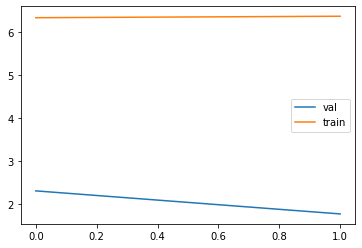


Iteration 200, loss = 6.0926
Checking accuracy on validation set
Got 407 / 1000 correct (40.70)


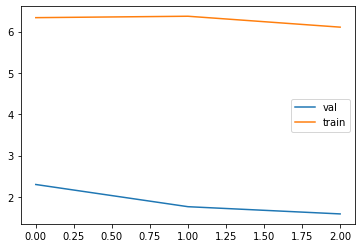


Iteration 300, loss = 6.0653
Checking accuracy on validation set
Got 433 / 1000 correct (43.30)


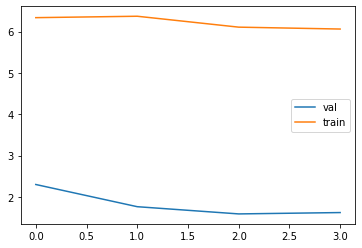


Iteration 400, loss = 5.7702
Checking accuracy on validation set
Got 464 / 1000 correct (46.40)


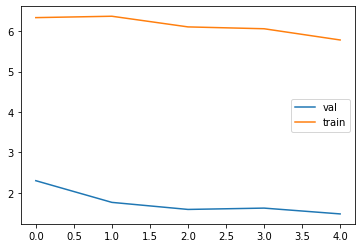


Iteration 500, loss = 5.5719
Checking accuracy on validation set
Got 548 / 1000 correct (54.80)


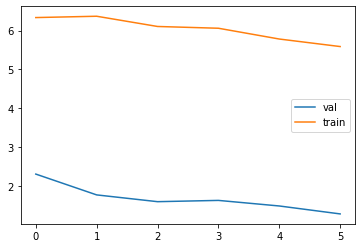


Iteration 600, loss = 5.4920
Checking accuracy on validation set
Got 551 / 1000 correct (55.10)


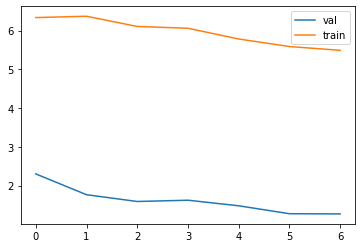


Iteration 700, loss = 5.5265
Checking accuracy on validation set
Got 538 / 1000 correct (53.80)


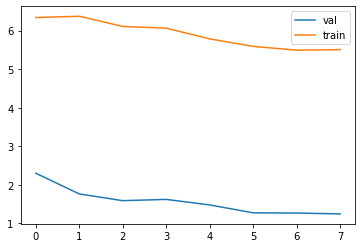


epoch  1
Iteration 0, loss = 5.4873
Checking accuracy on validation set
Got 591 / 1000 correct (59.10)


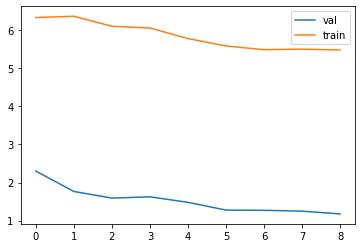


Iteration 100, loss = 5.0662
Checking accuracy on validation set
Got 533 / 1000 correct (53.30)


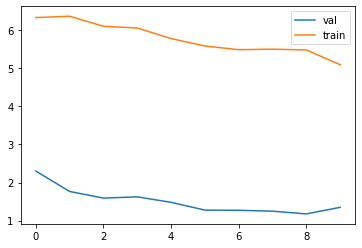


Iteration 200, loss = 4.9064
Checking accuracy on validation set
Got 575 / 1000 correct (57.50)


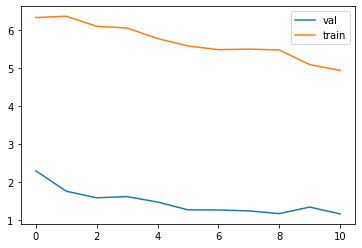


Iteration 300, loss = 5.0810
Checking accuracy on validation set
Got 614 / 1000 correct (61.40)


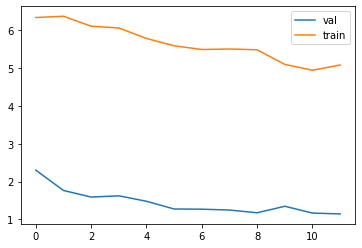


Iteration 400, loss = 5.0058
Checking accuracy on validation set
Got 592 / 1000 correct (59.20)


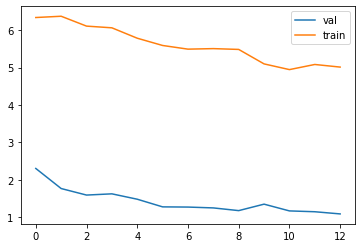


Iteration 500, loss = 4.7363
Checking accuracy on validation set
Got 567 / 1000 correct (56.70)


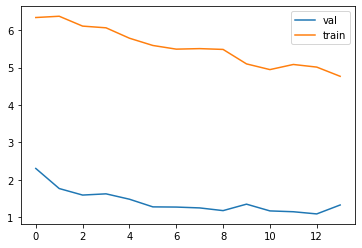


Iteration 600, loss = 4.6475
Checking accuracy on validation set
Got 639 / 1000 correct (63.90)


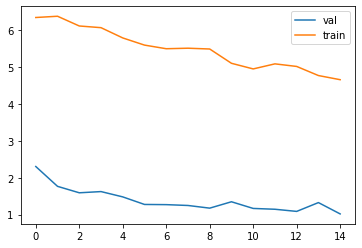


Iteration 700, loss = 4.9182
Checking accuracy on validation set
Got 644 / 1000 correct (64.40)


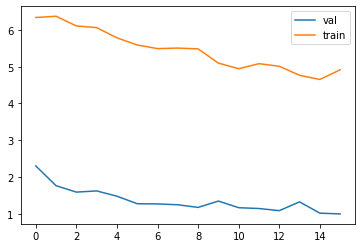


epoch  2
Iteration 0, loss = 4.5687
Checking accuracy on validation set
Got 650 / 1000 correct (65.00)


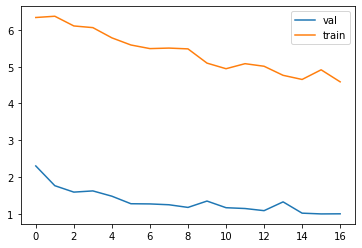


Iteration 100, loss = 4.3063
Checking accuracy on validation set
Got 669 / 1000 correct (66.90)


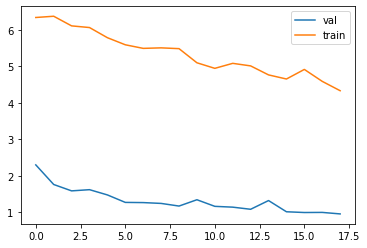


Iteration 200, loss = 4.3491
Checking accuracy on validation set
Got 682 / 1000 correct (68.20)


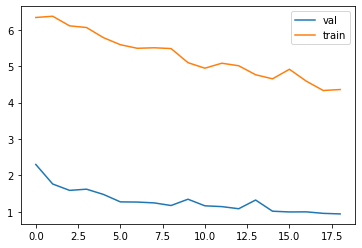


Iteration 300, loss = 4.3716
Checking accuracy on validation set
Got 617 / 1000 correct (61.70)


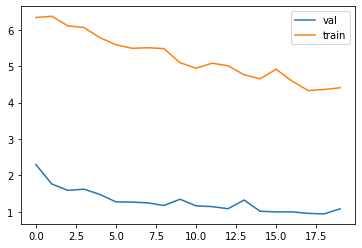


Iteration 400, loss = 4.2456
Checking accuracy on validation set
Got 677 / 1000 correct (67.70)


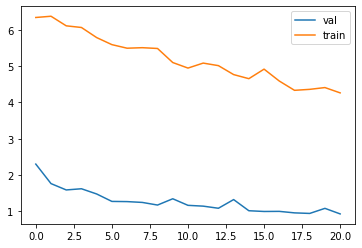


Iteration 500, loss = 4.4083
Checking accuracy on validation set
Got 622 / 1000 correct (62.20)


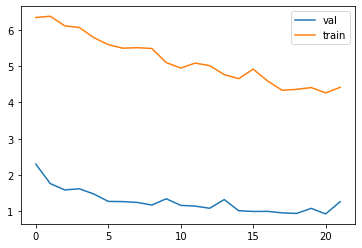


Iteration 600, loss = 4.3633
Checking accuracy on validation set
Got 648 / 1000 correct (64.80)


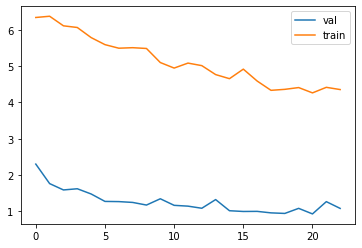


Iteration 700, loss = 4.1559
Checking accuracy on validation set
Got 685 / 1000 correct (68.50)


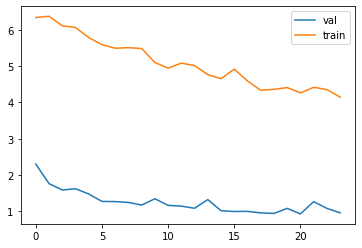


epoch  3
Iteration 0, loss = 4.0249
Checking accuracy on validation set
Got 680 / 1000 correct (68.00)


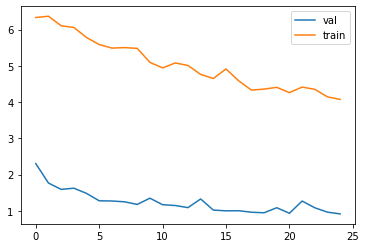


Iteration 100, loss = 4.2104
Checking accuracy on validation set
Got 732 / 1000 correct (73.20)


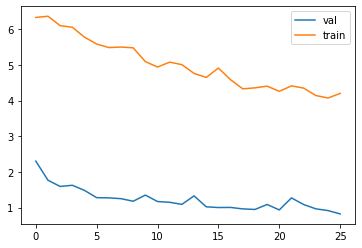


Iteration 200, loss = 3.9596
Checking accuracy on validation set
Got 727 / 1000 correct (72.70)


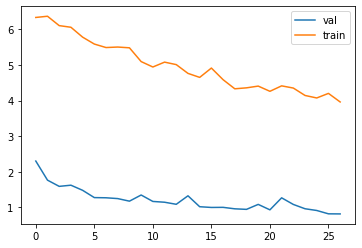


Iteration 300, loss = 4.1277
Checking accuracy on validation set
Got 694 / 1000 correct (69.40)


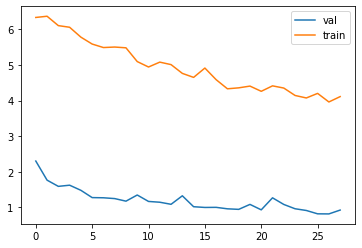


Iteration 400, loss = 3.7998
Checking accuracy on validation set
Got 698 / 1000 correct (69.80)


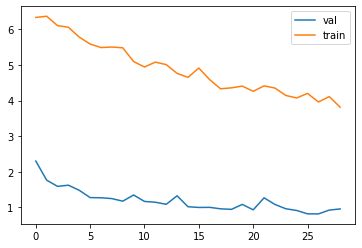


Iteration 500, loss = 4.1685
Checking accuracy on validation set
Got 677 / 1000 correct (67.70)


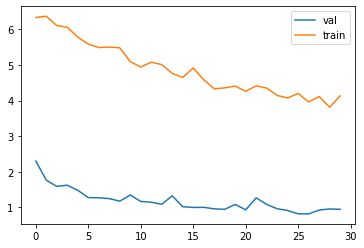


Iteration 600, loss = 3.8902
Checking accuracy on validation set
Got 696 / 1000 correct (69.60)


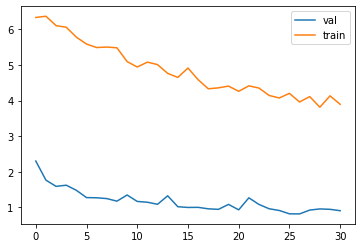


Iteration 700, loss = 3.7348
Checking accuracy on validation set
Got 707 / 1000 correct (70.70)


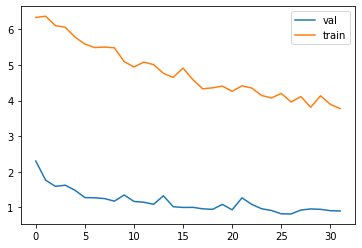


epoch  4
Iteration 0, loss = 3.6886
Checking accuracy on validation set
Got 683 / 1000 correct (68.30)


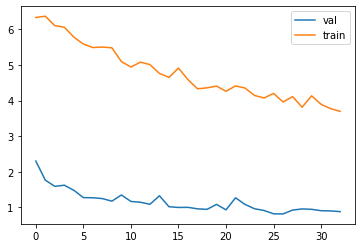


Iteration 100, loss = 3.5970
Checking accuracy on validation set
Got 700 / 1000 correct (70.00)


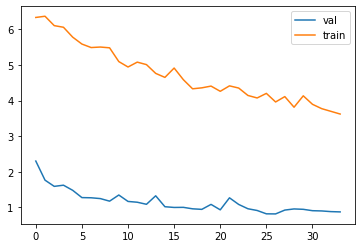


Iteration 200, loss = 3.6856
Checking accuracy on validation set
Got 726 / 1000 correct (72.60)


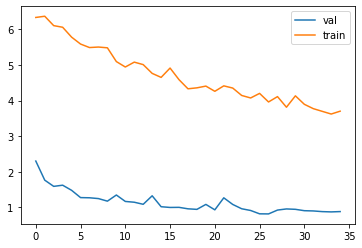


Iteration 300, loss = 3.5623
Checking accuracy on validation set
Got 746 / 1000 correct (74.60)


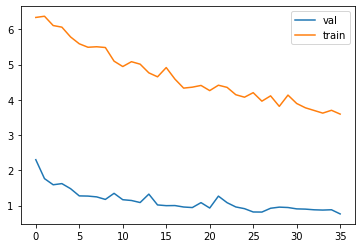


Iteration 400, loss = 3.4936
Checking accuracy on validation set
Got 760 / 1000 correct (76.00)


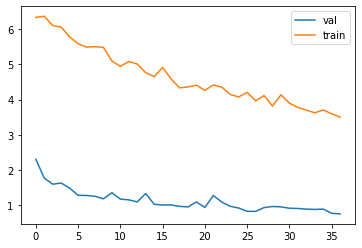


Iteration 500, loss = 3.7841
Checking accuracy on validation set
Got 737 / 1000 correct (73.70)


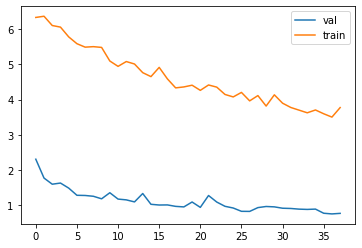


Iteration 600, loss = 3.6794
Checking accuracy on validation set
Got 725 / 1000 correct (72.50)


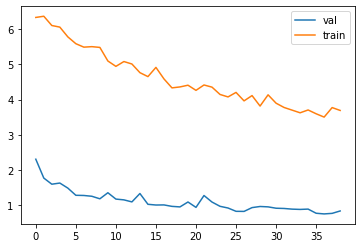


Iteration 700, loss = 3.5697
Checking accuracy on validation set
Got 717 / 1000 correct (71.70)


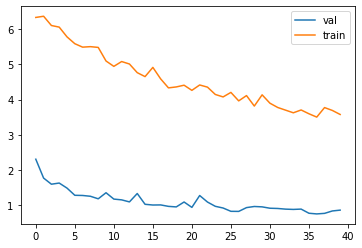


epoch  5
Iteration 0, loss = 3.4793
Checking accuracy on validation set
Got 718 / 1000 correct (71.80)


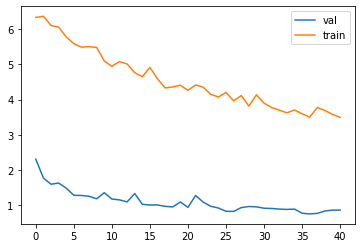


Iteration 100, loss = 3.5483
Checking accuracy on validation set
Got 587 / 1000 correct (58.70)


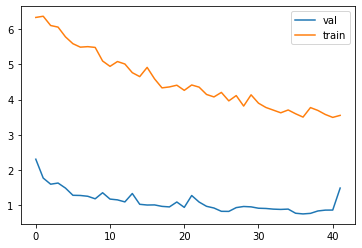


Iteration 200, loss = 3.2926
Checking accuracy on validation set
Got 673 / 1000 correct (67.30)


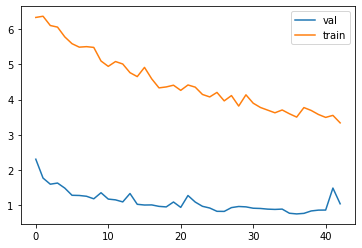


Iteration 300, loss = 3.1827
Checking accuracy on validation set
Got 727 / 1000 correct (72.70)


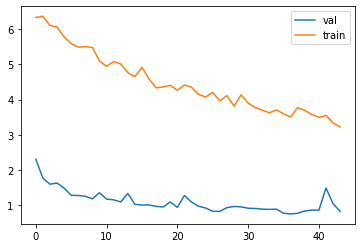


Iteration 400, loss = 3.5436
Checking accuracy on validation set
Got 720 / 1000 correct (72.00)


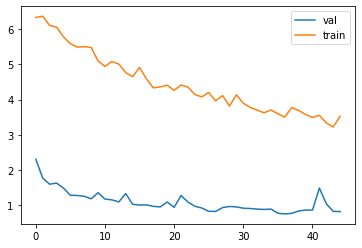


Iteration 500, loss = 3.4648
Checking accuracy on validation set
Got 766 / 1000 correct (76.60)


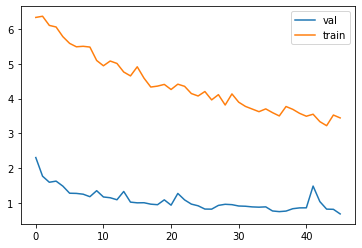


Iteration 600, loss = 3.3603
Checking accuracy on validation set
Got 732 / 1000 correct (73.20)


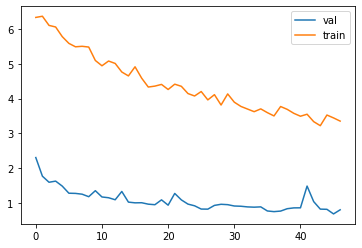


Iteration 700, loss = 3.6047
Checking accuracy on validation set
Got 743 / 1000 correct (74.30)


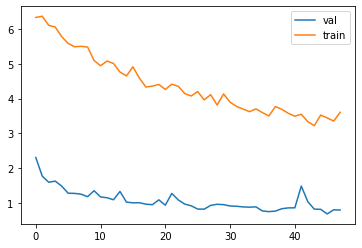


epoch  6
Iteration 0, loss = 3.3447
Checking accuracy on validation set
Got 725 / 1000 correct (72.50)


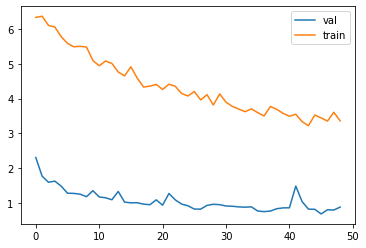


Iteration 100, loss = 3.2484
Checking accuracy on validation set
Got 700 / 1000 correct (70.00)


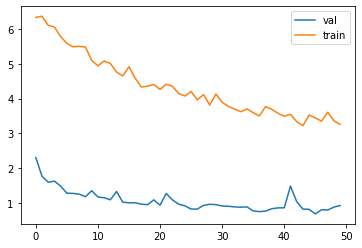


Iteration 200, loss = 3.4016
Checking accuracy on validation set
Got 760 / 1000 correct (76.00)


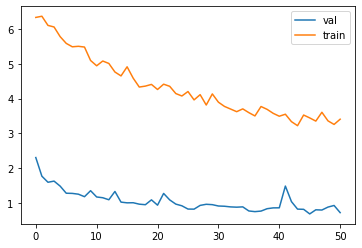


Iteration 300, loss = 3.2819
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)


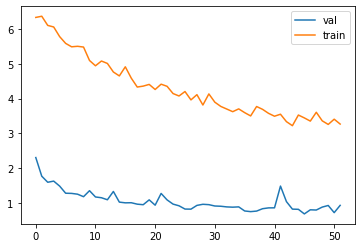


Iteration 400, loss = 3.2900
Checking accuracy on validation set
Got 768 / 1000 correct (76.80)


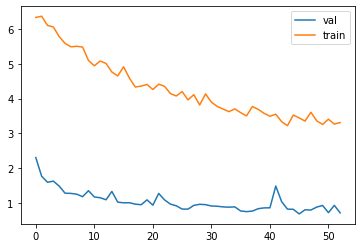


Iteration 500, loss = 3.1505
Checking accuracy on validation set
Got 738 / 1000 correct (73.80)


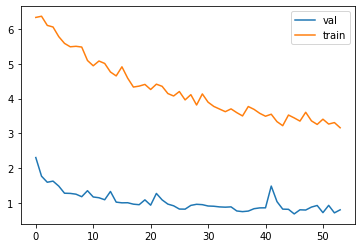


Iteration 600, loss = 3.2740
Checking accuracy on validation set
Got 770 / 1000 correct (77.00)


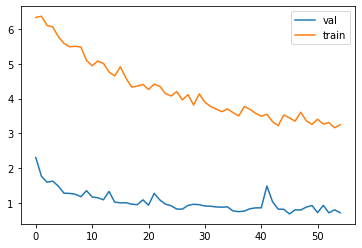


Iteration 700, loss = 3.2716
Checking accuracy on validation set
Got 757 / 1000 correct (75.70)


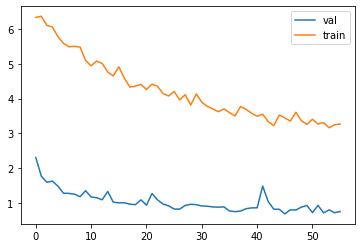


epoch  7
Iteration 0, loss = 3.0252
Checking accuracy on validation set
Got 756 / 1000 correct (75.60)


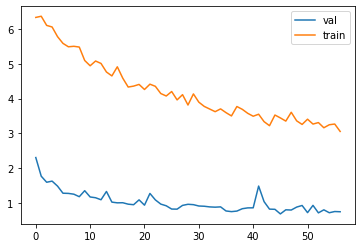


Iteration 100, loss = 3.1289
Checking accuracy on validation set
Got 737 / 1000 correct (73.70)


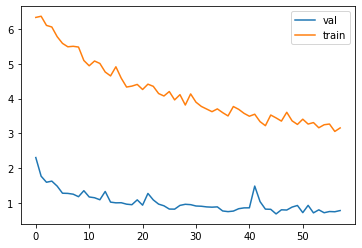


Iteration 200, loss = 3.2956
Checking accuracy on validation set
Got 737 / 1000 correct (73.70)


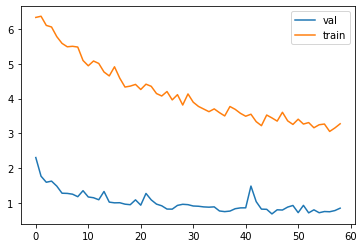


Iteration 300, loss = 3.2407
Checking accuracy on validation set
Got 736 / 1000 correct (73.60)


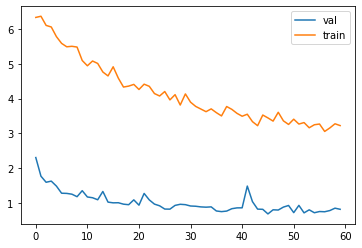


Iteration 400, loss = 3.0396
Checking accuracy on validation set
Got 739 / 1000 correct (73.90)


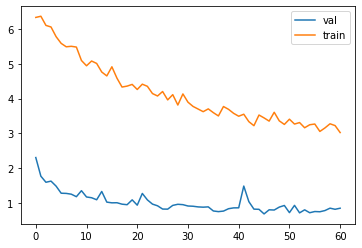


Iteration 500, loss = 3.0916
Checking accuracy on validation set
Got 778 / 1000 correct (77.80)


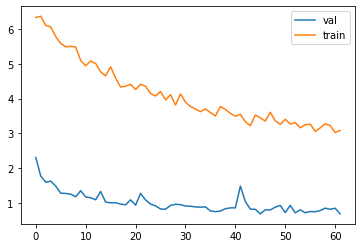


Iteration 600, loss = 2.9292
Checking accuracy on validation set
Got 756 / 1000 correct (75.60)


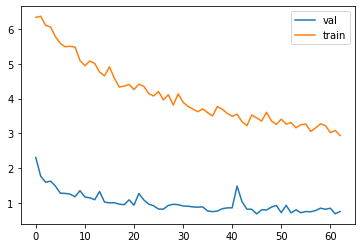


Iteration 700, loss = 3.0955
Checking accuracy on validation set
Got 750 / 1000 correct (75.00)


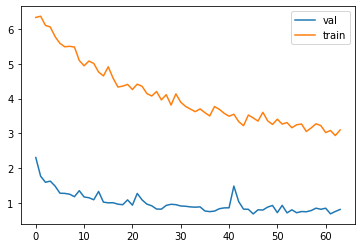


epoch  8
Iteration 0, loss = 3.1138
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)


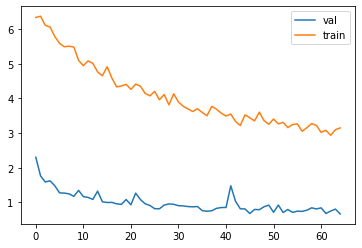


Iteration 100, loss = 3.0960
Checking accuracy on validation set
Got 739 / 1000 correct (73.90)


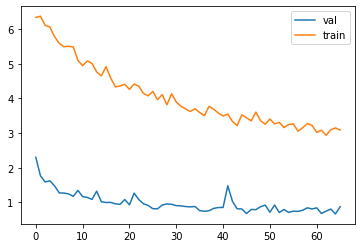


Iteration 200, loss = 3.0904
Checking accuracy on validation set
Got 751 / 1000 correct (75.10)


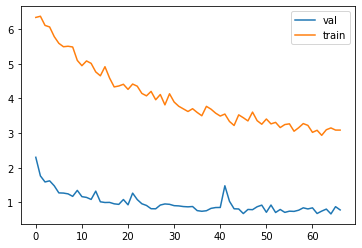


Iteration 300, loss = 2.9567
Checking accuracy on validation set
Got 752 / 1000 correct (75.20)


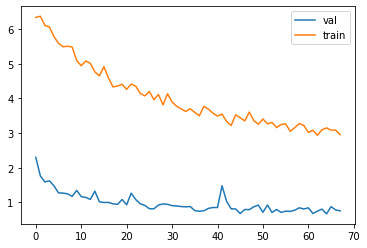


Iteration 400, loss = 2.6667
Checking accuracy on validation set
Got 738 / 1000 correct (73.80)


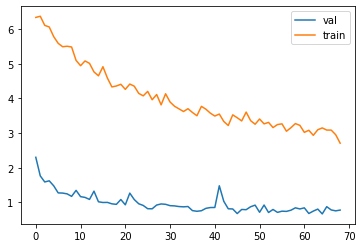


Iteration 500, loss = 3.0104
Checking accuracy on validation set
Got 766 / 1000 correct (76.60)


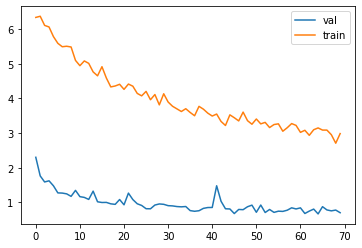


Iteration 600, loss = 2.8604
Checking accuracy on validation set
Got 783 / 1000 correct (78.30)


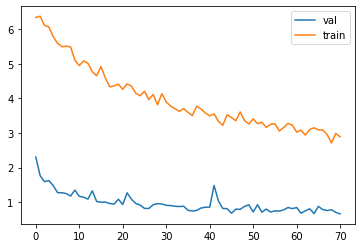


Iteration 700, loss = 2.8939
Checking accuracy on validation set
Got 777 / 1000 correct (77.70)


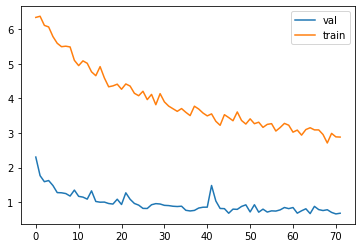


epoch  9
Iteration 0, loss = 2.7285
Checking accuracy on validation set
Got 759 / 1000 correct (75.90)


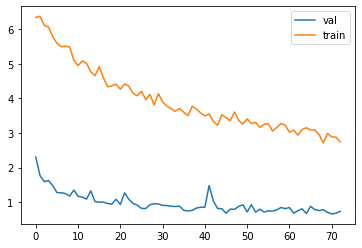


Iteration 100, loss = 2.8567
Checking accuracy on validation set
Got 735 / 1000 correct (73.50)


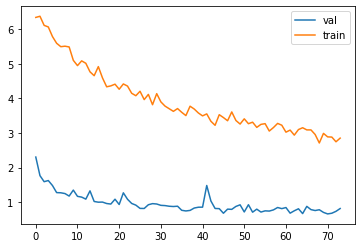


Iteration 200, loss = 2.7186
Checking accuracy on validation set
Got 758 / 1000 correct (75.80)


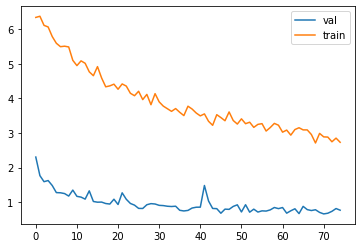


Iteration 300, loss = 2.6640
Checking accuracy on validation set
Got 785 / 1000 correct (78.50)


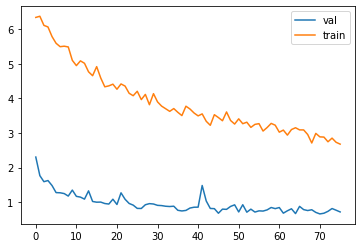


Iteration 400, loss = 3.0069
Checking accuracy on validation set
Got 778 / 1000 correct (77.80)


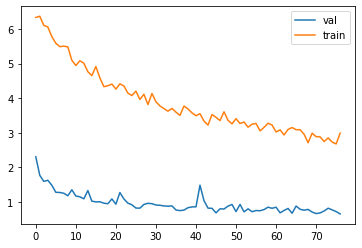


Iteration 500, loss = 2.6732
Checking accuracy on validation set
Got 790 / 1000 correct (79.00)


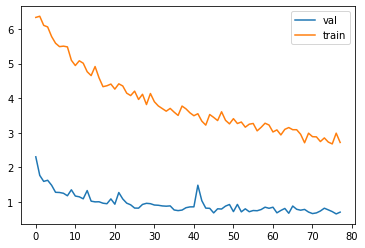


Iteration 600, loss = 2.7849
Checking accuracy on validation set
Got 729 / 1000 correct (72.90)


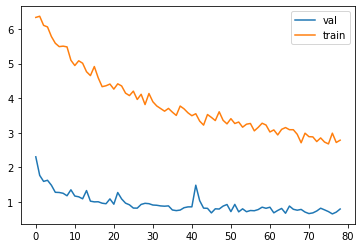


Iteration 700, loss = 2.8024
Checking accuracy on validation set
Got 777 / 1000 correct (77.70)


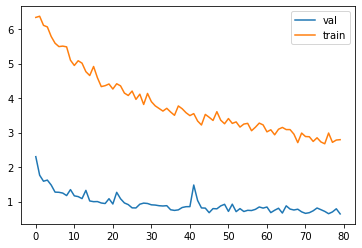


Wed Oct  7 08:18:42 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   73C    P0   170W / 250W |  14185MiB / 16280MiB |     98%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+------

In [42]:
model = None
optimizer = None
k = 1
channel_1  = int(64)
channel_2  = int(64)
channel_3  = int(128)
channel_4  = int(128)
channel_5  = int(128)
channel_6  = int(256)
channel_7  = int(256)
channel_8  = int(256)
channel_9  = int(256)
channel_10 = int(512)
channel_11 = int(512)
channel_12 = int(512)
channel_13 = int(512)
channel_14 = int(512)
channel_15 = int(1024)
channel_16 = int(1024)

# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
def flatten(x):
    N = x.shape[0] # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image
    
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3,         out_channels=channel_1, kernel_size=9, padding=4),
    nn.BatchNorm2d(num_features=channel_1),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=9, padding=4),
    nn.BatchNorm2d(num_features=channel_2),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_2, out_channels=channel_3, kernel_size=9, padding=4),
    nn.BatchNorm2d(num_features=channel_3),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_3, out_channels=channel_4, kernel_size=7, padding=3),
    nn.BatchNorm2d(num_features=channel_4),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=7, padding=3),
    nn.BatchNorm2d(num_features=channel_5),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_5, out_channels=channel_6, kernel_size=7, padding=3),
    nn.BatchNorm2d(num_features=channel_6),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_6, out_channels=channel_7, kernel_size=7, padding=3),
    nn.BatchNorm2d(num_features=channel_7),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_7, out_channels=channel_8, kernel_size=5, padding=2),
    nn.BatchNorm2d(num_features=channel_8),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_8, out_channels=channel_9, kernel_size=5, padding=2),
    nn.BatchNorm2d(num_features=channel_9),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_9, out_channels=channel_10, kernel_size=5, padding=2),
    nn.BatchNorm2d(num_features=channel_10),
    nn.ReLU(),
    
    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=5, padding=2),
    nn.BatchNorm2d(num_features=channel_11),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_11, out_channels=channel_12, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_12),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_12, out_channels=channel_13, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_13),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_14, out_channels=channel_15, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_15),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_15, out_channels=channel_16, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_16),
    nn.ReLU(),

    Flatten(),
    nn.Linear(16*channel_16, 10)
)

# you can use Nesterov momentum in optim.SGD
learning_rate = 5e-5

optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=0.01)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

# You should get at least 70% accuracy
!nvidia-smi
train_part(model, optimizer, epochs=10, ld=1e-2)
!nvidia-smi

## Describe what you did 

In the cell below you should write an explanation of what you did, any additional features that you implemented, and/or any graphs that you made in the process of training and evaluating your network.

TODO: Describe what you did

## Test set -- run this only once

Now that we've gotten a result we're happy with, we test our final model on the test set (which you should store in best_model). Think about how this compares to your validation set accuracy.

In [43]:
best_model = model
check_accuracy_part34(loader_test, best_model)

Checking accuracy on test set
Got 7759 / 10000 correct (77.59)


0.7053903238788531

In [ ]:
# Another model

Wed Oct  7 08:46:54 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   55C    P0    38W / 250W |  14185MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

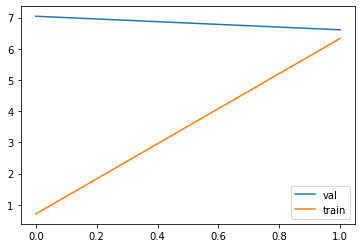


Iteration 200, loss = 6.2699
Checking accuracy on validation set
Got 377 / 1000 correct (37.70)


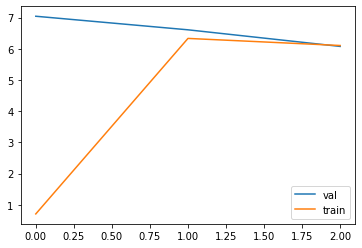


Iteration 300, loss = 5.7107
Checking accuracy on validation set
Got 406 / 1000 correct (40.60)


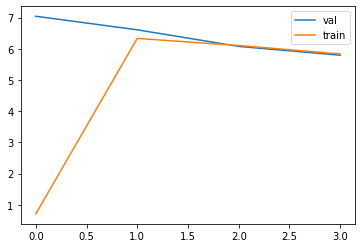


Iteration 400, loss = 5.2898
Checking accuracy on validation set
Got 403 / 1000 correct (40.30)


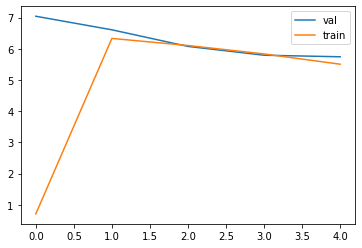


Iteration 500, loss = 5.4038
Checking accuracy on validation set
Got 463 / 1000 correct (46.30)


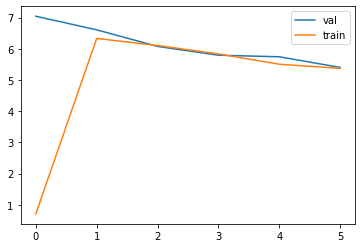


Iteration 600, loss = 4.8964
Checking accuracy on validation set
Got 413 / 1000 correct (41.30)


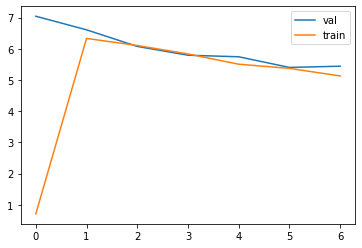


Iteration 700, loss = 4.8526
Checking accuracy on validation set
Got 501 / 1000 correct (50.10)


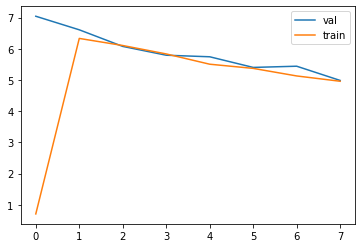


epoch  1
Iteration 0, loss = 4.6334
Checking accuracy on validation set
Got 492 / 1000 correct (49.20)


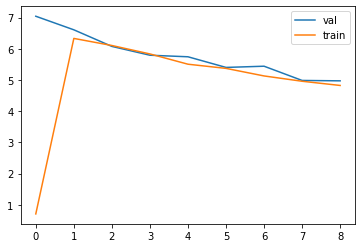


Iteration 100, loss = 4.7488
Checking accuracy on validation set
Got 514 / 1000 correct (51.40)


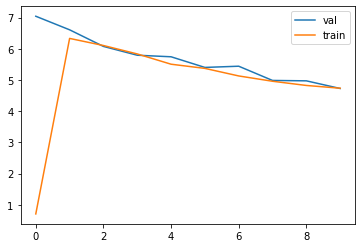


Iteration 200, loss = 4.5270
Checking accuracy on validation set
Got 485 / 1000 correct (48.50)


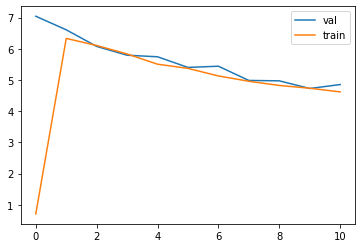


Iteration 300, loss = 4.6574
Checking accuracy on validation set
Got 460 / 1000 correct (46.00)


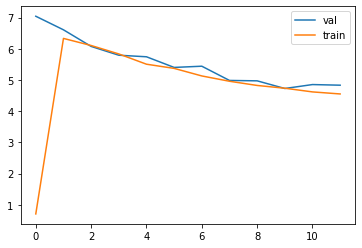


Iteration 400, loss = 4.1345
Checking accuracy on validation set
Got 559 / 1000 correct (55.90)


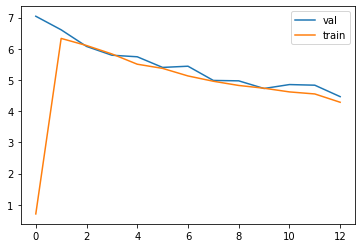


Iteration 500, loss = 4.2981
Checking accuracy on validation set
Got 500 / 1000 correct (50.00)


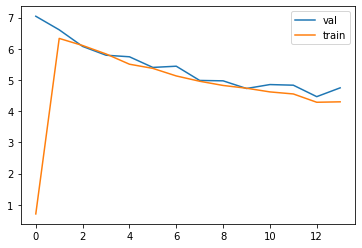


Iteration 600, loss = 4.2137
Checking accuracy on validation set
Got 558 / 1000 correct (55.80)


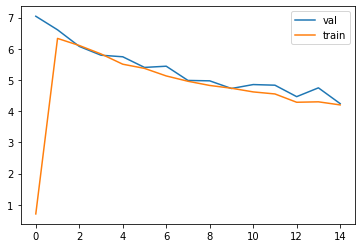


Iteration 700, loss = 4.0674
Checking accuracy on validation set
Got 556 / 1000 correct (55.60)


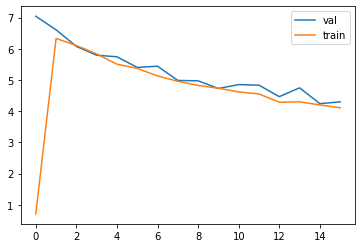


epoch  2
Iteration 0, loss = 4.2122
Checking accuracy on validation set
Got 556 / 1000 correct (55.60)


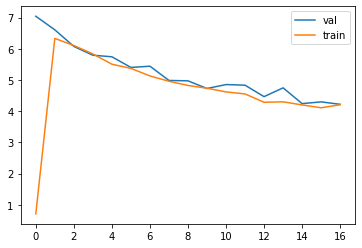


Iteration 100, loss = 4.1421
Checking accuracy on validation set
Got 602 / 1000 correct (60.20)


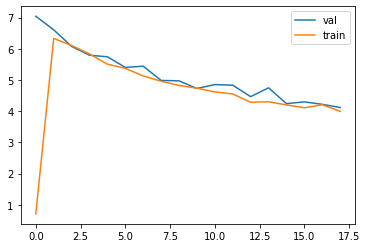


Iteration 200, loss = 3.8480
Checking accuracy on validation set
Got 584 / 1000 correct (58.40)


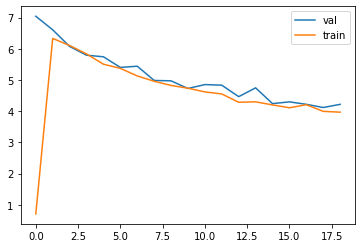


Iteration 300, loss = 3.7703
Checking accuracy on validation set
Got 517 / 1000 correct (51.70)


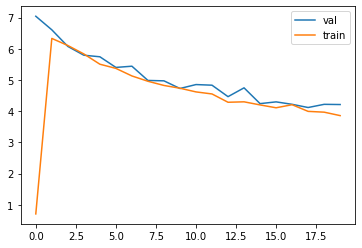


Iteration 400, loss = 3.6715
Checking accuracy on validation set
Got 602 / 1000 correct (60.20)


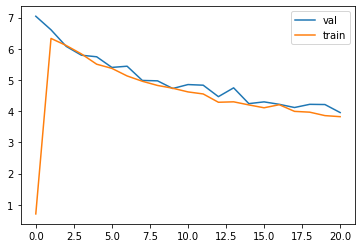


Iteration 500, loss = 4.1853
Checking accuracy on validation set
Got 581 / 1000 correct (58.10)


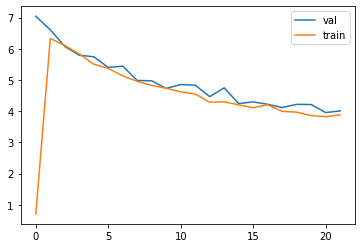


Iteration 600, loss = 3.7112
Checking accuracy on validation set
Got 597 / 1000 correct (59.70)


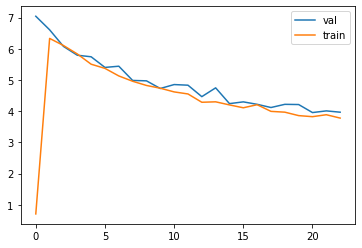


Iteration 700, loss = 3.9898
Checking accuracy on validation set
Got 628 / 1000 correct (62.80)


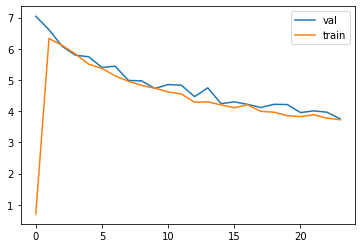


epoch  3
Iteration 0, loss = 3.7320
Checking accuracy on validation set
Got 669 / 1000 correct (66.90)


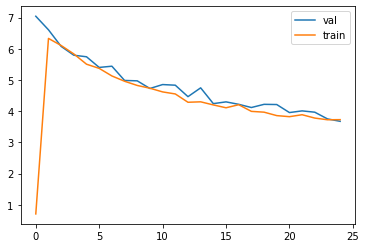


Iteration 100, loss = 3.4810
Checking accuracy on validation set
Got 564 / 1000 correct (56.40)


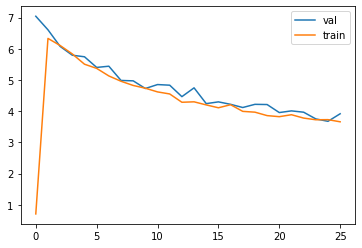


Iteration 200, loss = 3.7924
Checking accuracy on validation set
Got 537 / 1000 correct (53.70)


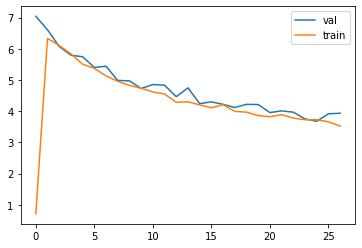


Iteration 300, loss = 3.6065
Checking accuracy on validation set
Got 546 / 1000 correct (54.60)


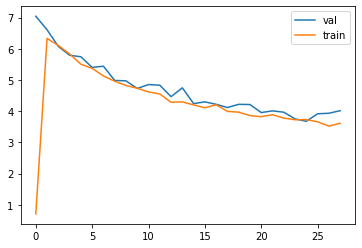


Iteration 400, loss = 3.7923
Checking accuracy on validation set
Got 623 / 1000 correct (62.30)


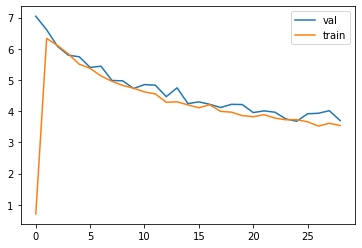


Iteration 500, loss = 3.5618
Checking accuracy on validation set
Got 638 / 1000 correct (63.80)


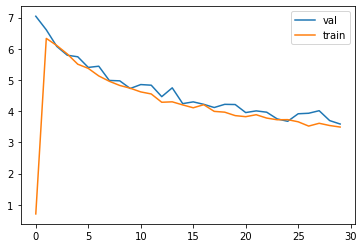


Iteration 600, loss = 3.5287
Checking accuracy on validation set
Got 680 / 1000 correct (68.00)


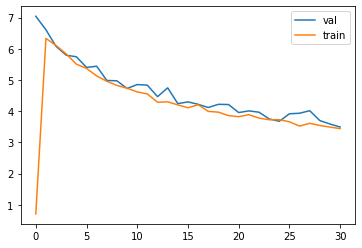


Iteration 700, loss = 3.6417
Checking accuracy on validation set
Got 666 / 1000 correct (66.60)


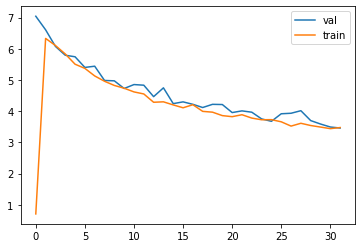


epoch  4
Iteration 0, loss = 3.2956
Checking accuracy on validation set
Got 507 / 1000 correct (50.70)


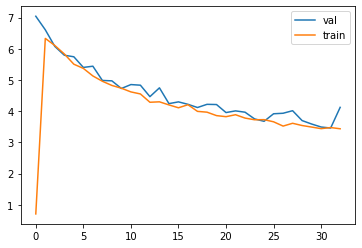


Iteration 100, loss = 3.6148
Checking accuracy on validation set
Got 626 / 1000 correct (62.60)


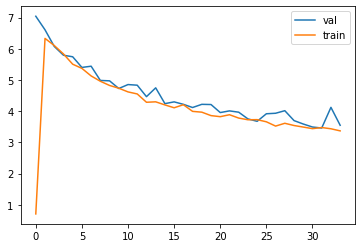


Iteration 200, loss = 3.3587
Checking accuracy on validation set
Got 535 / 1000 correct (53.50)


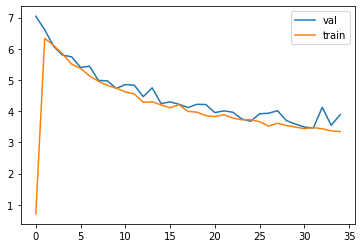


Iteration 300, loss = 3.2637
Checking accuracy on validation set
Got 643 / 1000 correct (64.30)


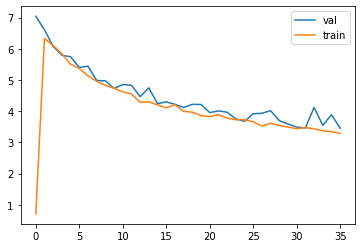


Iteration 400, loss = 3.0229
Checking accuracy on validation set
Got 599 / 1000 correct (59.90)


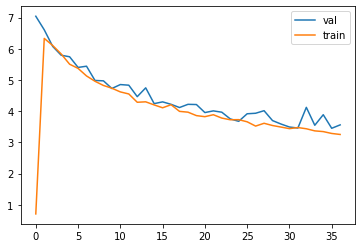


Iteration 500, loss = 3.0579
Checking accuracy on validation set
Got 614 / 1000 correct (61.40)


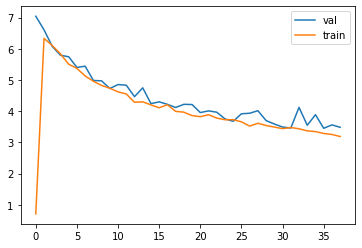


Iteration 600, loss = 3.1879
Checking accuracy on validation set
Got 567 / 1000 correct (56.70)


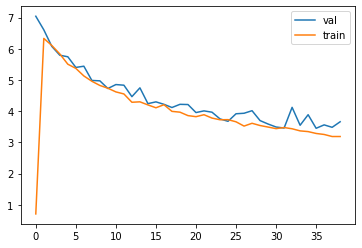


Iteration 700, loss = 3.2817
Checking accuracy on validation set
Got 690 / 1000 correct (69.00)


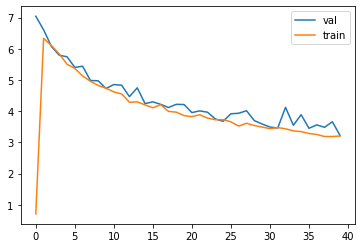


epoch  5
Iteration 0, loss = 3.2894
Checking accuracy on validation set
Got 652 / 1000 correct (65.20)


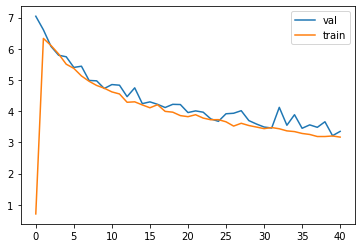


Iteration 100, loss = 3.0207
Checking accuracy on validation set
Got 607 / 1000 correct (60.70)


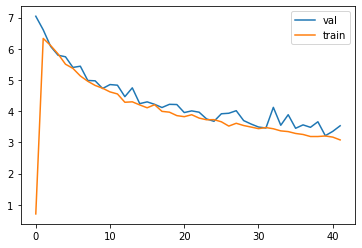


Iteration 200, loss = 3.0621
Checking accuracy on validation set
Got 645 / 1000 correct (64.50)


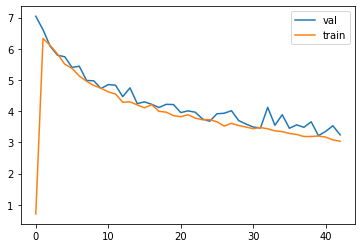


Iteration 300, loss = 3.0199
Checking accuracy on validation set
Got 604 / 1000 correct (60.40)


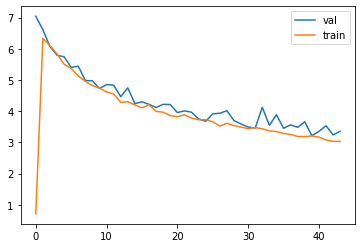


Iteration 400, loss = 3.3480
Checking accuracy on validation set
Got 695 / 1000 correct (69.50)


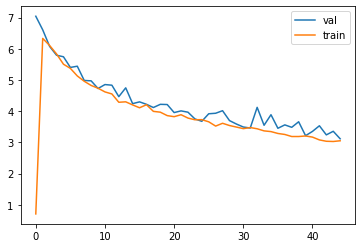


Iteration 500, loss = 2.9311
Checking accuracy on validation set
Got 639 / 1000 correct (63.90)


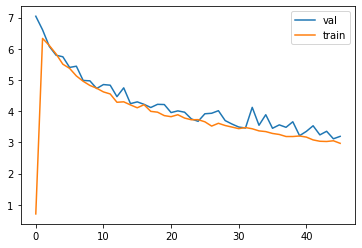


Iteration 600, loss = 3.2043
Checking accuracy on validation set
Got 625 / 1000 correct (62.50)


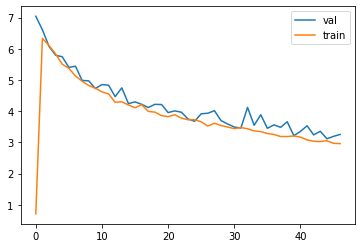


Iteration 700, loss = 2.9035
Checking accuracy on validation set
Got 716 / 1000 correct (71.60)


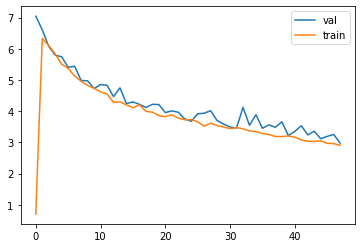


epoch  6
Iteration 0, loss = 2.7287
Checking accuracy on validation set
Got 611 / 1000 correct (61.10)


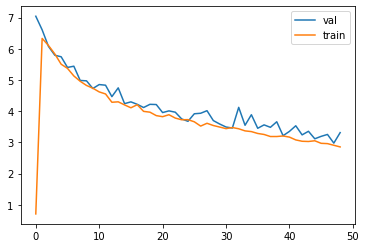


Iteration 100, loss = 2.7701
Checking accuracy on validation set
Got 704 / 1000 correct (70.40)


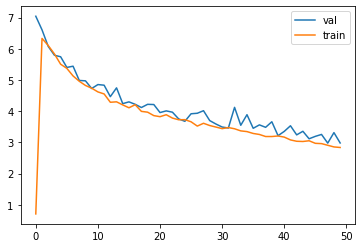


Iteration 200, loss = 2.5548
Checking accuracy on validation set
Got 580 / 1000 correct (58.00)


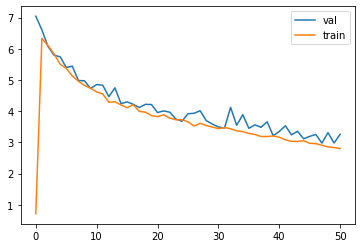


Iteration 300, loss = 2.7475
Checking accuracy on validation set
Got 633 / 1000 correct (63.30)


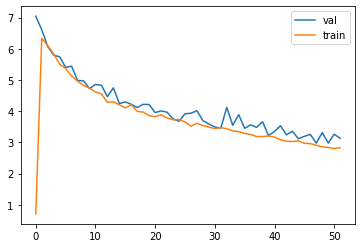


Iteration 400, loss = 2.7261
Checking accuracy on validation set
Got 669 / 1000 correct (66.90)


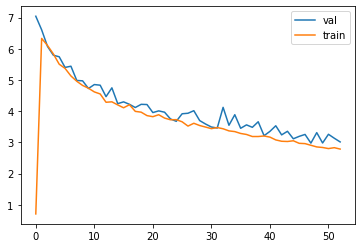


Iteration 500, loss = 2.7252
Checking accuracy on validation set
Got 684 / 1000 correct (68.40)


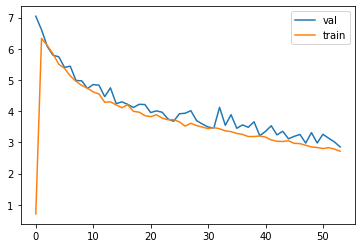


Iteration 600, loss = 2.7737
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)


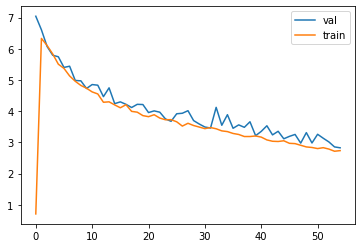


Iteration 700, loss = 2.4281
Checking accuracy on validation set
Got 711 / 1000 correct (71.10)


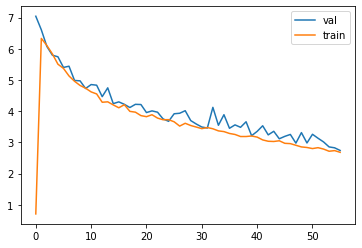


epoch  7
Iteration 0, loss = 2.6877
Checking accuracy on validation set
Got 662 / 1000 correct (66.20)


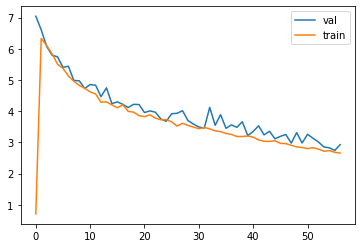


Iteration 100, loss = 2.5994
Checking accuracy on validation set
Got 707 / 1000 correct (70.70)


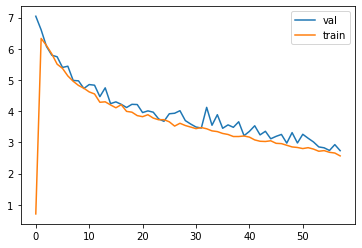


Iteration 200, loss = 2.5733
Checking accuracy on validation set
Got 578 / 1000 correct (57.80)


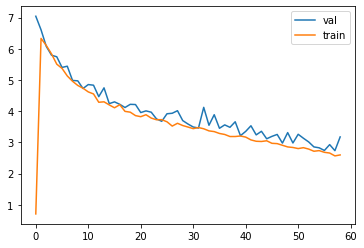


Iteration 300, loss = 2.6157
Checking accuracy on validation set
Got 718 / 1000 correct (71.80)


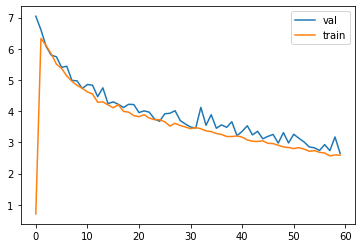


Iteration 400, loss = 2.5920
Checking accuracy on validation set
Got 627 / 1000 correct (62.70)


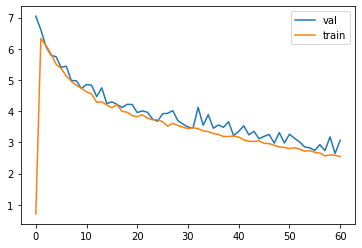


Iteration 500, loss = 2.5303
Checking accuracy on validation set
Got 693 / 1000 correct (69.30)


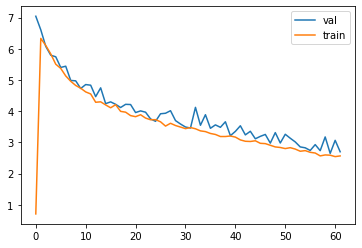


Iteration 600, loss = 2.4411
Checking accuracy on validation set
Got 749 / 1000 correct (74.90)


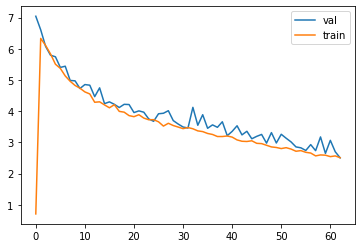


Iteration 700, loss = 2.4251
Checking accuracy on validation set
Got 731 / 1000 correct (73.10)


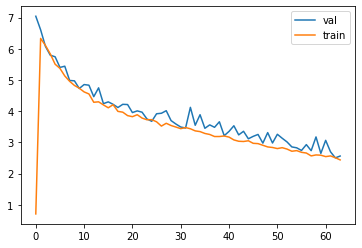


epoch  8
Iteration 0, loss = 2.3102
Checking accuracy on validation set
Got 718 / 1000 correct (71.80)


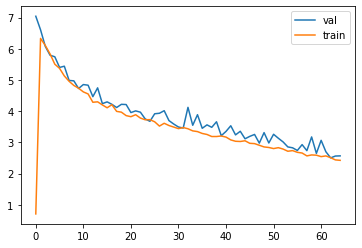


Iteration 100, loss = 2.4873
Checking accuracy on validation set
Got 665 / 1000 correct (66.50)


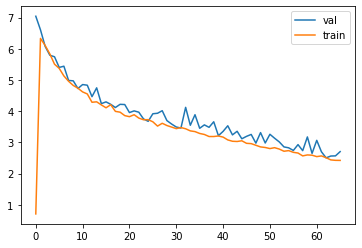


Iteration 200, loss = 2.9379
Checking accuracy on validation set
Got 575 / 1000 correct (57.50)


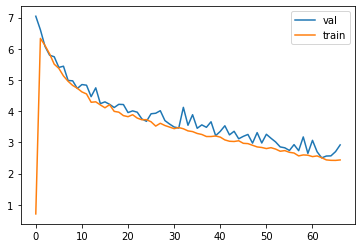


Iteration 300, loss = 2.5155
Checking accuracy on validation set
Got 587 / 1000 correct (58.70)


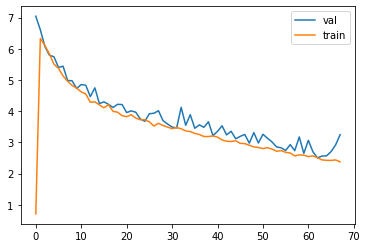


Iteration 400, loss = 2.2969
Checking accuracy on validation set
Got 701 / 1000 correct (70.10)


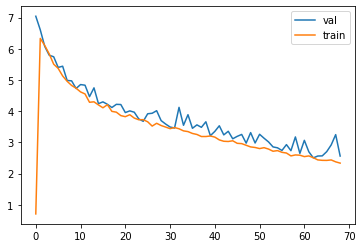


Iteration 500, loss = 2.1384
Checking accuracy on validation set
Got 700 / 1000 correct (70.00)


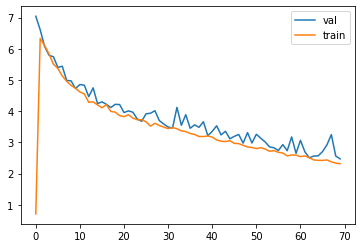


Iteration 600, loss = 2.1626
Checking accuracy on validation set
Got 714 / 1000 correct (71.40)


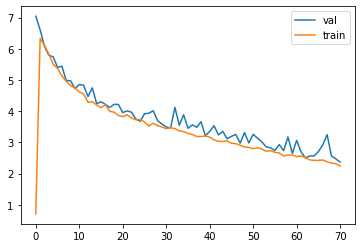


Iteration 700, loss = 2.5749
Checking accuracy on validation set
Got 699 / 1000 correct (69.90)


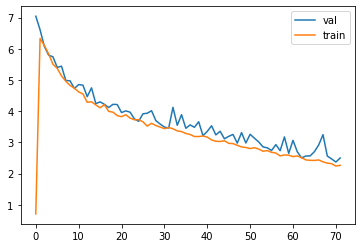


epoch  9
Iteration 0, loss = 2.1770
Checking accuracy on validation set
Got 713 / 1000 correct (71.30)


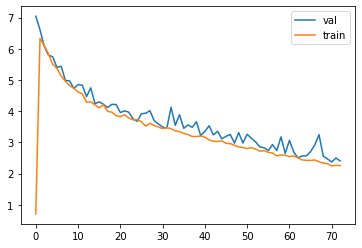


Iteration 100, loss = 2.0787
Checking accuracy on validation set
Got 710 / 1000 correct (71.00)


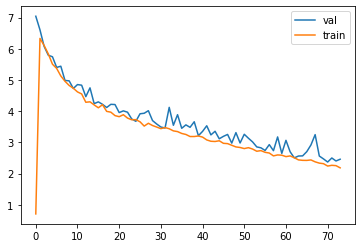


Iteration 200, loss = 2.4241
Checking accuracy on validation set
Got 697 / 1000 correct (69.70)


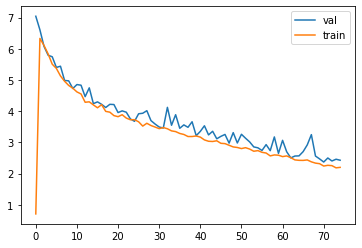


Iteration 300, loss = 2.0785
Checking accuracy on validation set
Got 624 / 1000 correct (62.40)


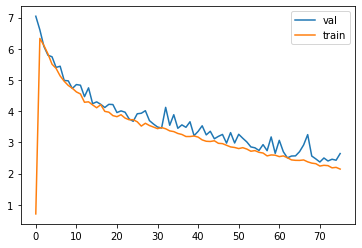


Iteration 400, loss = 1.9712
Checking accuracy on validation set
Got 746 / 1000 correct (74.60)


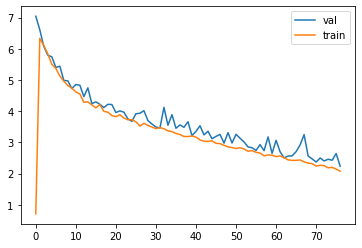


Iteration 500, loss = 2.0722
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)


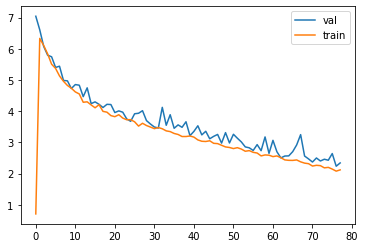


Iteration 600, loss = 2.2436
Checking accuracy on validation set
Got 738 / 1000 correct (73.80)


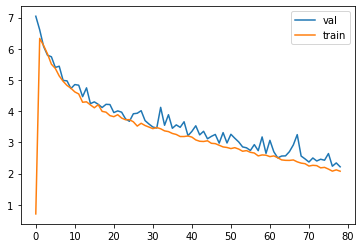


Iteration 700, loss = 2.1720
Checking accuracy on validation set
Got 529 / 1000 correct (52.90)


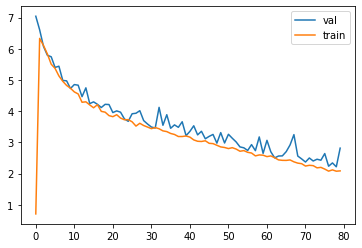


Wed Oct  7 09:03:50 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   73C    P0    75W / 250W |  14185MiB / 16280MiB |     98%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+------

In [50]:
model = None
optimizer = None
k = 1
channel_1  = int(128)
channel_2  = int(128)
channel_3  = int(128)
channel_4  = int(128)
channel_5  = int(128)
channel_6  = int(256)
channel_7  = int(256)
channel_8  = int(256)
channel_9  = int(256)
channel_10 = int(512)
channel_11 = int(512)
channel_12 = int(512)
channel_13 = int(512)
channel_14 = int(512)
channel_15 = int(1024)
channel_16 = int(1024)

# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
def flatten(x):
    N = x.shape[0] # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image
    
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3,         out_channels=channel_1, kernel_size=9, padding=4),
    nn.BatchNorm2d(num_features=channel_1),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=9, padding=4),
    nn.BatchNorm2d(num_features=channel_2),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_2, out_channels=channel_3, kernel_size=9, padding=4),
    nn.BatchNorm2d(num_features=channel_3),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_3, out_channels=channel_4, kernel_size=7, padding=3),
    nn.BatchNorm2d(num_features=channel_4),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=7, padding=3),
    nn.BatchNorm2d(num_features=channel_5),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_5, out_channels=channel_6, kernel_size=7, padding=3),
    nn.BatchNorm2d(num_features=channel_6),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_6, out_channels=channel_7, kernel_size=7, padding=3),
    nn.BatchNorm2d(num_features=channel_7),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_7, out_channels=channel_8, kernel_size=5, padding=2),
    nn.BatchNorm2d(num_features=channel_8),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_8, out_channels=channel_9, kernel_size=5, padding=2),
    nn.BatchNorm2d(num_features=channel_9),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_9, out_channels=channel_10, kernel_size=5, padding=2),
    nn.BatchNorm2d(num_features=channel_10),
    nn.ReLU(),
    
    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=5, padding=2),
    nn.BatchNorm2d(num_features=channel_11),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_11, out_channels=channel_12, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_12),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_12, out_channels=channel_13, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_13),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_14, out_channels=channel_15, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_15),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_15, out_channels=channel_16, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_16),
    nn.ReLU(),

    Flatten(),
    nn.Linear(4*channel_16, 10)
)

# you can use Nesterov momentum in optim.SGD
learning_rate = 1e-4

optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=0.01)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

# You should get at least 70% accuracy
!nvidia-smi
train_part(model, optimizer, epochs=10, ld=1e-2)
!nvidia-smi

In [51]:
best_model = model
check_accuracy_part34(loader_test, best_model)

Checking accuracy on test set
Got 7127 / 10000 correct (71.27)


0.8541393188913916

Wed Oct  7 09:14:30 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   57C    P0    39W / 250W |  14199MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

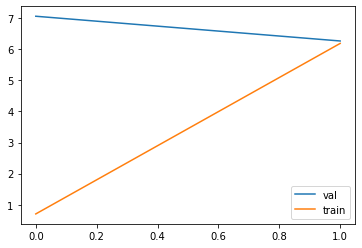


Iteration 200, loss = 5.9075
Checking accuracy on validation set
Got 473 / 1000 correct (47.30)


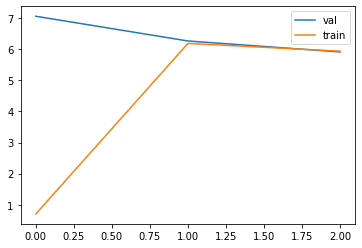


Iteration 300, loss = 5.8327
Checking accuracy on validation set
Got 522 / 1000 correct (52.20)


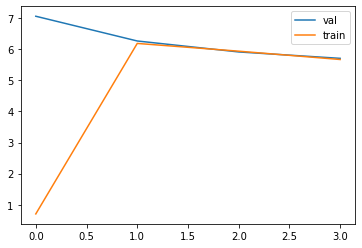


Iteration 400, loss = 5.2594
Checking accuracy on validation set
Got 568 / 1000 correct (56.80)


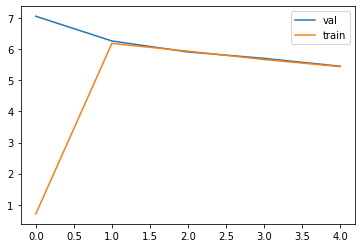


Iteration 500, loss = 5.4799
Checking accuracy on validation set
Got 579 / 1000 correct (57.90)


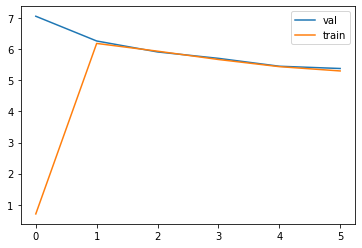


Iteration 600, loss = 5.0159
Checking accuracy on validation set
Got 576 / 1000 correct (57.60)


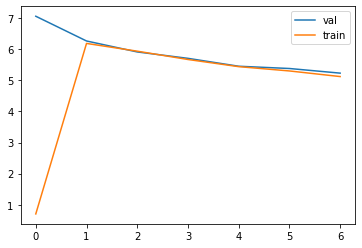


Iteration 700, loss = 5.1934
Checking accuracy on validation set
Got 653 / 1000 correct (65.30)


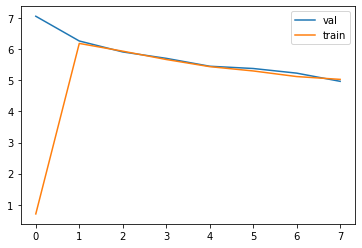


epoch  1
Iteration 0, loss = 5.0634
Checking accuracy on validation set
Got 644 / 1000 correct (64.40)


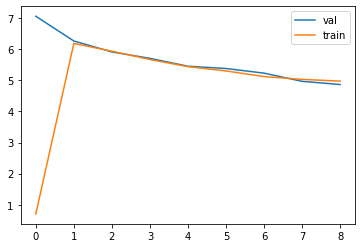


Iteration 100, loss = 4.5161
Checking accuracy on validation set
Got 632 / 1000 correct (63.20)


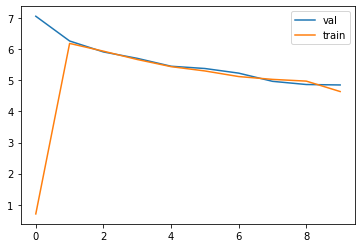


Iteration 200, loss = 4.5429
Checking accuracy on validation set
Got 651 / 1000 correct (65.10)


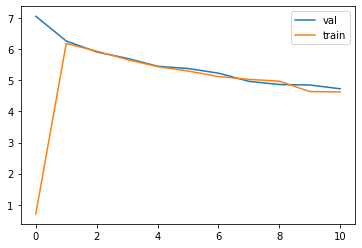


Iteration 300, loss = 4.5069
Checking accuracy on validation set
Got 601 / 1000 correct (60.10)


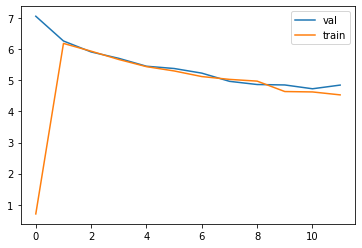


Iteration 400, loss = 4.4453
Checking accuracy on validation set
Got 660 / 1000 correct (66.00)


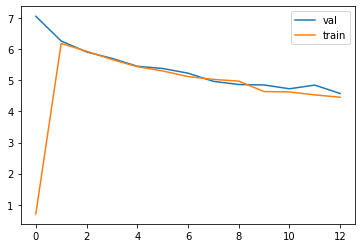


Iteration 500, loss = 4.3166
Checking accuracy on validation set
Got 674 / 1000 correct (67.40)


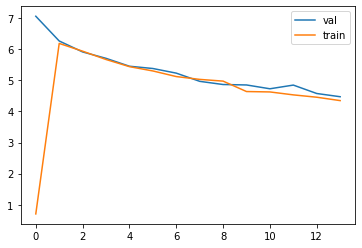


Iteration 600, loss = 4.1618
Checking accuracy on validation set
Got 652 / 1000 correct (65.20)


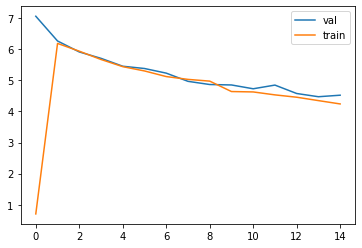


Iteration 700, loss = 3.9374
Checking accuracy on validation set
Got 718 / 1000 correct (71.80)


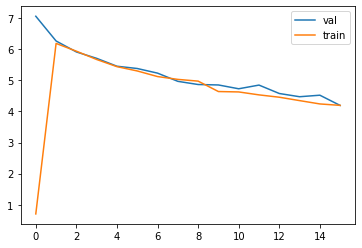


epoch  2
Iteration 0, loss = 4.3147
Checking accuracy on validation set
Got 747 / 1000 correct (74.70)


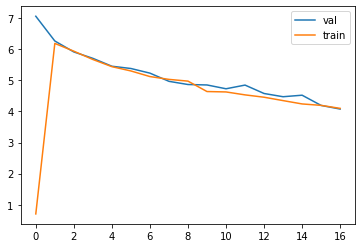


Iteration 100, loss = 3.9180
Checking accuracy on validation set
Got 701 / 1000 correct (70.10)


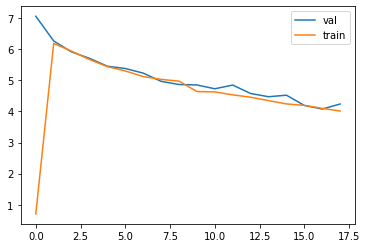


Iteration 200, loss = 3.6956
Checking accuracy on validation set
Got 727 / 1000 correct (72.70)


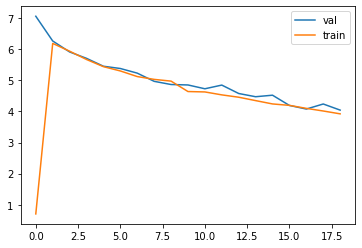


Iteration 300, loss = 3.9522
Checking accuracy on validation set
Got 707 / 1000 correct (70.70)


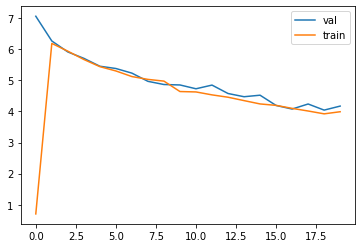


Iteration 400, loss = 3.8748
Checking accuracy on validation set
Got 750 / 1000 correct (75.00)


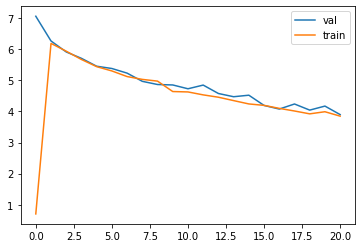


Iteration 500, loss = 3.7606
Checking accuracy on validation set
Got 753 / 1000 correct (75.30)


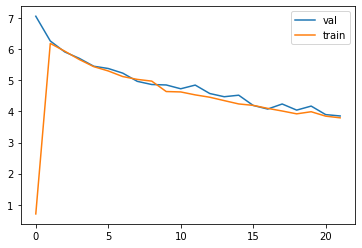


Iteration 600, loss = 3.5683
Checking accuracy on validation set
Got 730 / 1000 correct (73.00)


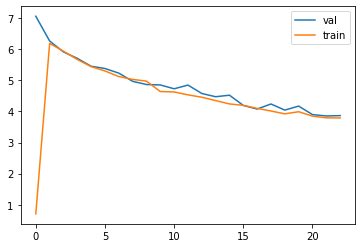


Iteration 700, loss = 3.6234
Checking accuracy on validation set
Got 732 / 1000 correct (73.20)


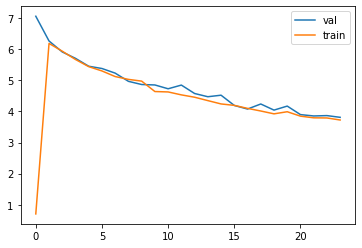


epoch  3
Iteration 0, loss = 3.6273
Checking accuracy on validation set
Got 676 / 1000 correct (67.60)


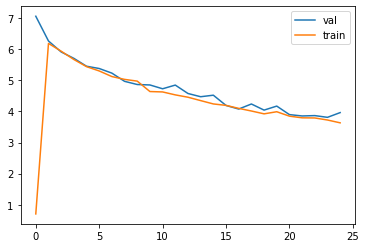


Iteration 100, loss = 3.6231
Checking accuracy on validation set
Got 713 / 1000 correct (71.30)


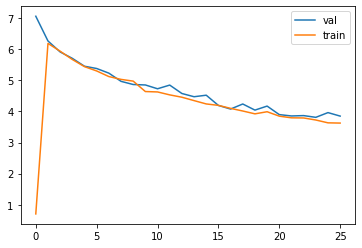


Iteration 200, loss = 3.4308
Checking accuracy on validation set
Got 723 / 1000 correct (72.30)


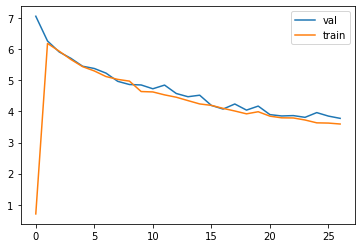


Iteration 300, loss = 3.2661
Checking accuracy on validation set
Got 718 / 1000 correct (71.80)


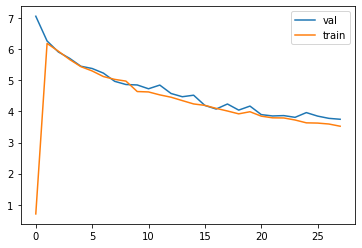


Iteration 400, loss = 3.4043
Checking accuracy on validation set
Got 782 / 1000 correct (78.20)


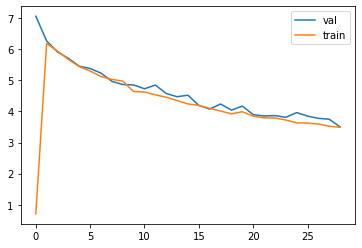


Iteration 500, loss = 3.5549
Checking accuracy on validation set
Got 738 / 1000 correct (73.80)


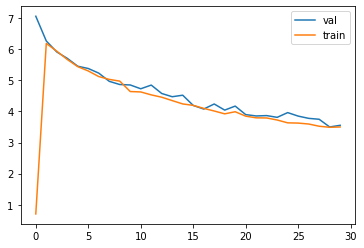


Iteration 600, loss = 3.4560
Checking accuracy on validation set
Got 759 / 1000 correct (75.90)


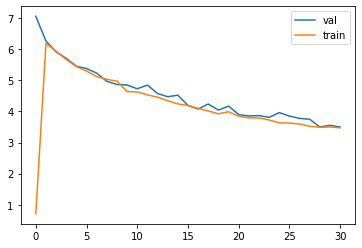


Iteration 700, loss = 3.3215
Checking accuracy on validation set
Got 759 / 1000 correct (75.90)


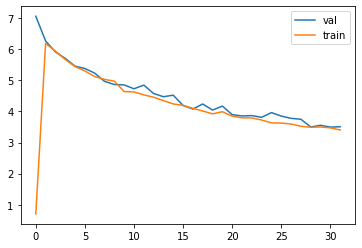


epoch  4
Iteration 0, loss = 3.1505
Checking accuracy on validation set
Got 736 / 1000 correct (73.60)


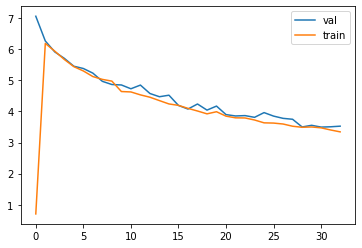


Iteration 100, loss = 3.4564
Checking accuracy on validation set
Got 719 / 1000 correct (71.90)


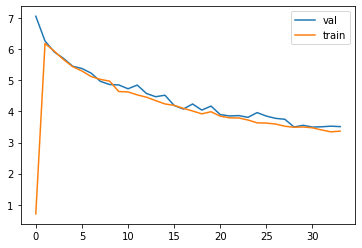


Iteration 200, loss = 3.5066
Checking accuracy on validation set
Got 756 / 1000 correct (75.60)


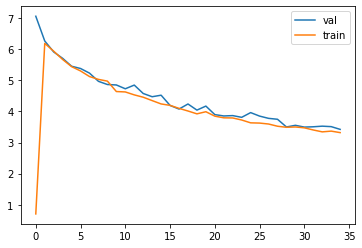


Iteration 300, loss = 3.0527
Checking accuracy on validation set
Got 795 / 1000 correct (79.50)


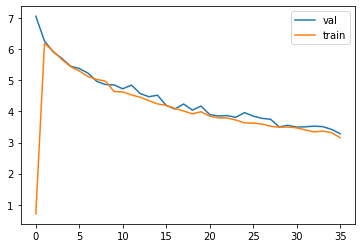


Iteration 400, loss = 3.1991
Checking accuracy on validation set
Got 806 / 1000 correct (80.60)


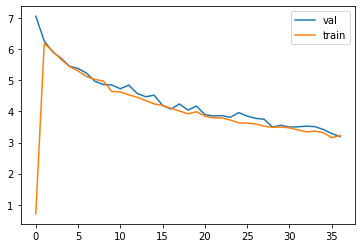


Iteration 500, loss = 3.0357
Checking accuracy on validation set
Got 739 / 1000 correct (73.90)


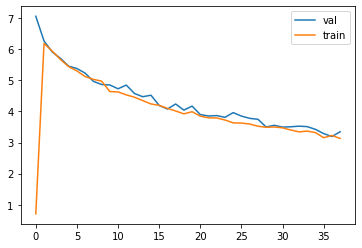


Iteration 600, loss = 2.9292
Checking accuracy on validation set
Got 759 / 1000 correct (75.90)


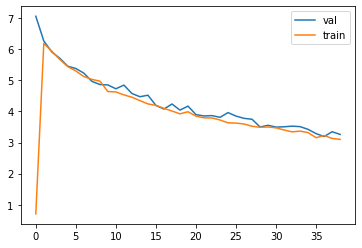


Iteration 700, loss = 3.0377
Checking accuracy on validation set
Got 810 / 1000 correct (81.00)


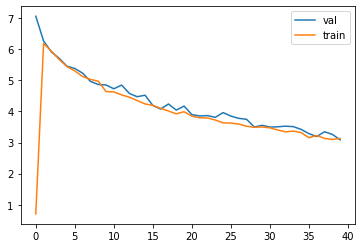


epoch  5
Iteration 0, loss = 2.8538
Checking accuracy on validation set
Got 803 / 1000 correct (80.30)


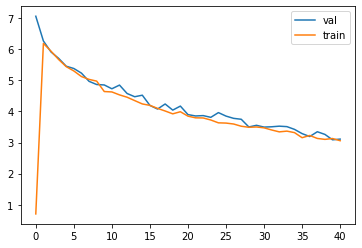


Iteration 100, loss = 3.0125
Checking accuracy on validation set
Got 788 / 1000 correct (78.80)


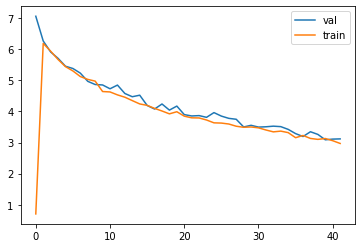


Iteration 200, loss = 2.7237
Checking accuracy on validation set
Got 692 / 1000 correct (69.20)


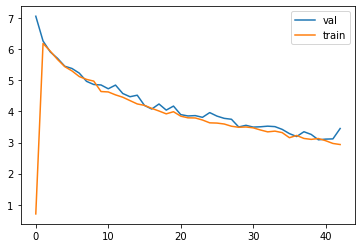


Iteration 300, loss = 3.1108
Checking accuracy on validation set
Got 785 / 1000 correct (78.50)


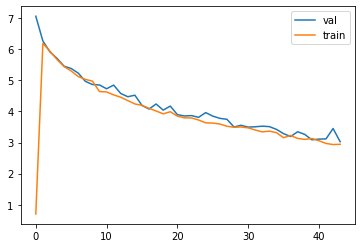


Iteration 400, loss = 2.8520
Checking accuracy on validation set
Got 844 / 1000 correct (84.40)


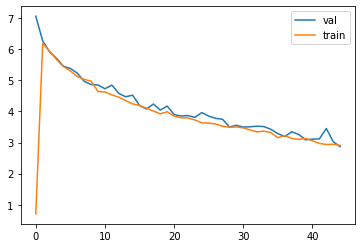


Iteration 500, loss = 3.0083
Checking accuracy on validation set
Got 697 / 1000 correct (69.70)


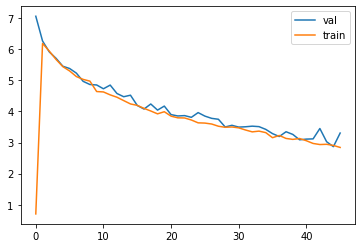


Iteration 600, loss = 2.5571
Checking accuracy on validation set
Got 811 / 1000 correct (81.10)


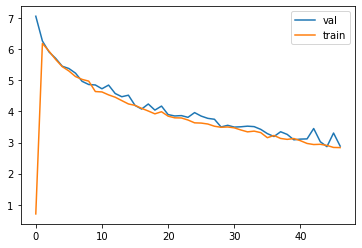


Iteration 700, loss = 2.7731
Checking accuracy on validation set
Got 754 / 1000 correct (75.40)


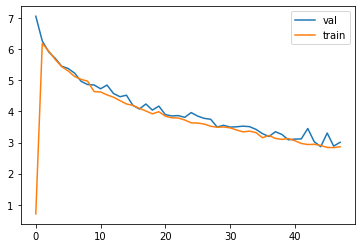


epoch  6
Iteration 0, loss = 2.4924
Checking accuracy on validation set
Got 797 / 1000 correct (79.70)


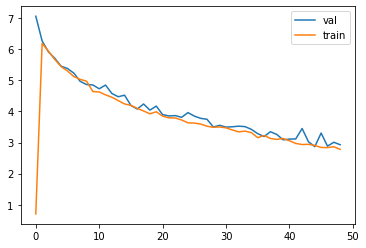


Iteration 100, loss = 2.6094
Checking accuracy on validation set
Got 803 / 1000 correct (80.30)


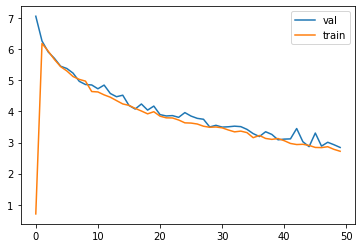


Iteration 200, loss = 2.6666
Checking accuracy on validation set
Got 787 / 1000 correct (78.70)


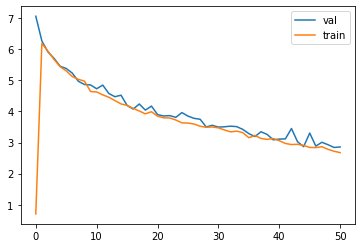


Iteration 300, loss = 2.5860
Checking accuracy on validation set
Got 811 / 1000 correct (81.10)


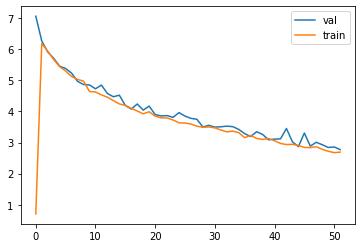


Iteration 400, loss = 2.8263
Checking accuracy on validation set
Got 678 / 1000 correct (67.80)


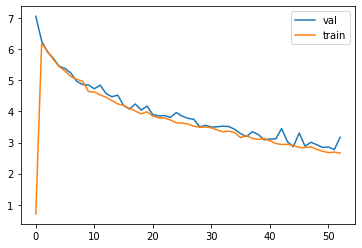


Iteration 500, loss = 2.4951
Checking accuracy on validation set
Got 765 / 1000 correct (76.50)


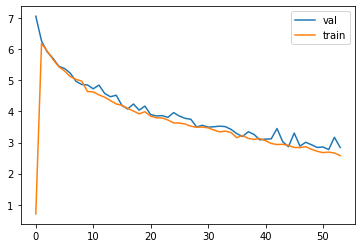


Iteration 600, loss = 2.5540
Checking accuracy on validation set
Got 766 / 1000 correct (76.60)


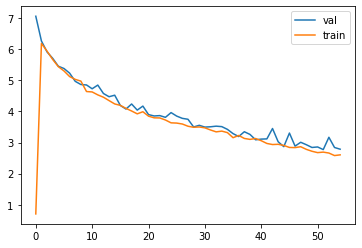


Iteration 700, loss = 2.5692
Checking accuracy on validation set
Got 813 / 1000 correct (81.30)


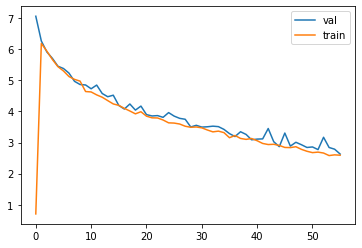


epoch  7
Iteration 0, loss = 2.4832
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)


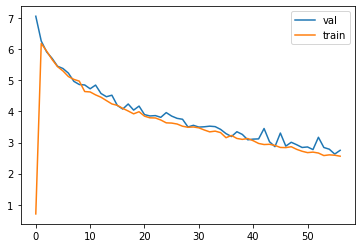


Iteration 100, loss = 2.3581
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)


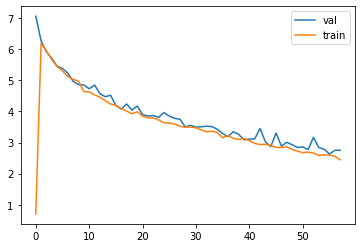


Iteration 200, loss = 2.3056
Checking accuracy on validation set
Got 813 / 1000 correct (81.30)


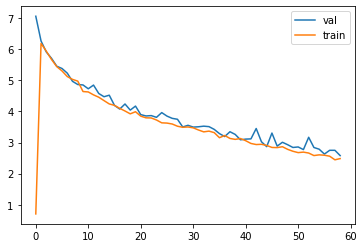


Iteration 300, loss = 2.5630
Checking accuracy on validation set
Got 796 / 1000 correct (79.60)


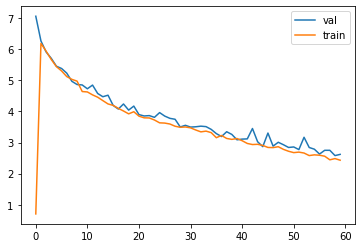


Iteration 400, loss = 2.3634
Checking accuracy on validation set
Got 784 / 1000 correct (78.40)


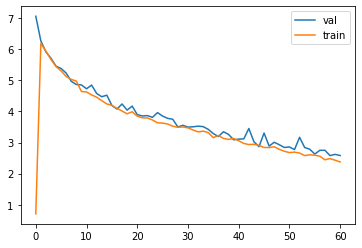


Iteration 500, loss = 2.2953
Checking accuracy on validation set
Got 773 / 1000 correct (77.30)


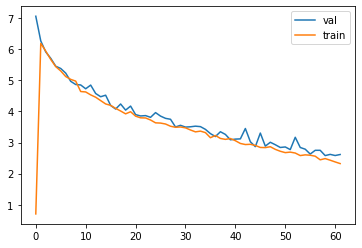


Iteration 600, loss = 2.2355
Checking accuracy on validation set
Got 802 / 1000 correct (80.20)


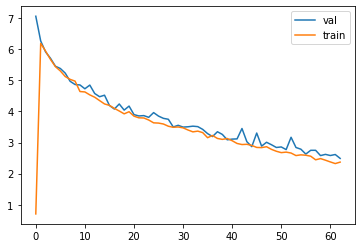


Iteration 700, loss = 2.2235
Checking accuracy on validation set
Got 758 / 1000 correct (75.80)


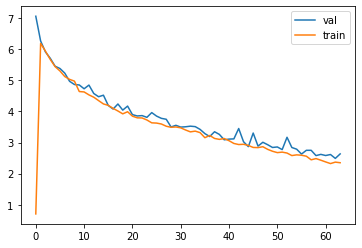


epoch  8
Iteration 0, loss = 2.2553
Checking accuracy on validation set
Got 765 / 1000 correct (76.50)


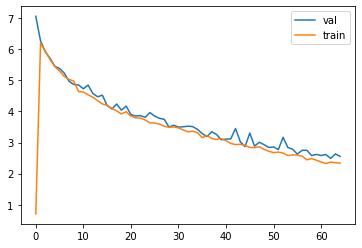


Iteration 100, loss = 2.2644
Checking accuracy on validation set
Got 734 / 1000 correct (73.40)


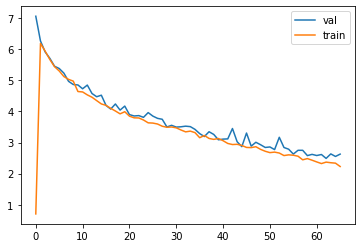


Iteration 200, loss = 2.2071
Checking accuracy on validation set
Got 786 / 1000 correct (78.60)


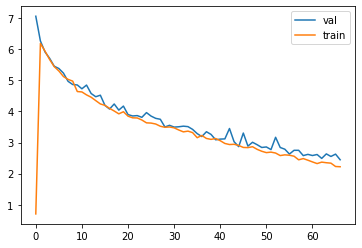


Iteration 300, loss = 2.1039
Checking accuracy on validation set
Got 833 / 1000 correct (83.30)


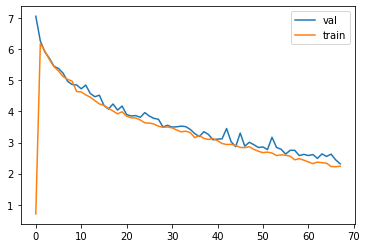


Iteration 400, loss = 2.3801
Checking accuracy on validation set
Got 733 / 1000 correct (73.30)


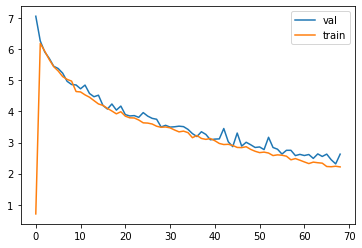


Iteration 500, loss = 2.3970
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)


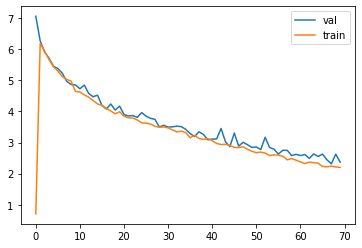


Iteration 600, loss = 1.9747
Checking accuracy on validation set
Got 753 / 1000 correct (75.30)


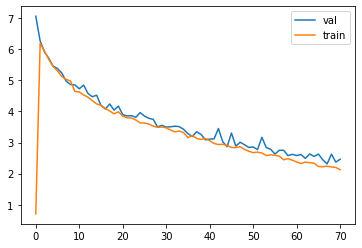


Iteration 700, loss = 2.1810
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)


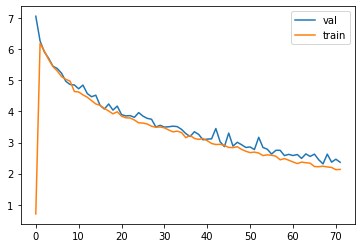


epoch  9
Iteration 0, loss = 2.0689
Checking accuracy on validation set
Got 812 / 1000 correct (81.20)


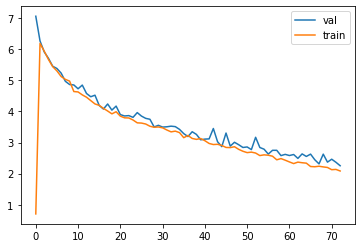


Iteration 100, loss = 2.0657
Checking accuracy on validation set
Got 779 / 1000 correct (77.90)


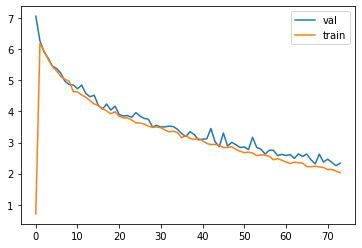


Iteration 200, loss = 1.8883
Checking accuracy on validation set
Got 748 / 1000 correct (74.80)


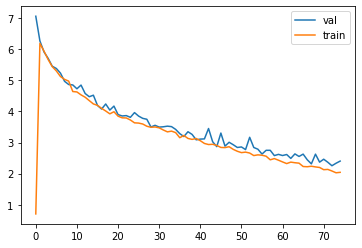


Iteration 300, loss = 1.9368
Checking accuracy on validation set
Got 764 / 1000 correct (76.40)


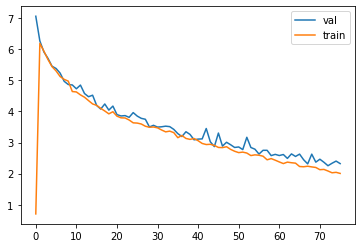


Iteration 400, loss = 1.8896
Checking accuracy on validation set
Got 822 / 1000 correct (82.20)


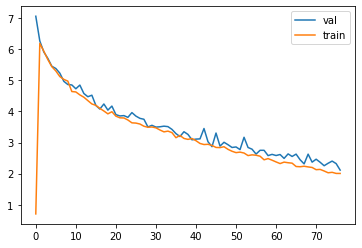


Iteration 500, loss = 1.9651
Checking accuracy on validation set
Got 789 / 1000 correct (78.90)


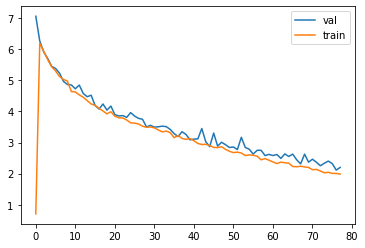


Iteration 600, loss = 2.0034
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)


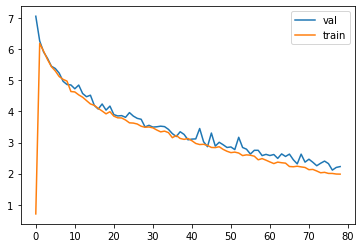


Iteration 700, loss = 2.0440
Checking accuracy on validation set
Got 837 / 1000 correct (83.70)


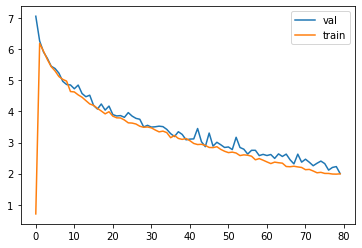


Wed Oct  7 09:25:35 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   73C    P0    57W / 250W |  14209MiB / 16280MiB |     71%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+------

In [54]:
# Another model
model = None
optimizer = None
k = 1
channel_1  = int(128)
channel_2  = int(128)
channel_3  = int(128)
channel_4  = int(128)
channel_5  = int(128)
channel_6  = int(256)
channel_7  = int(256)
channel_8  = int(256)
channel_9  = int(256)
channel_10 = int(512)
channel_11 = int(512)
channel_12 = int(512)
channel_13 = int(512)
channel_14 = int(512)
channel_15 = int(1024)
channel_16 = int(1024)

# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
def flatten(x):
    N = x.shape[0] # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image
    
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3,         out_channels=channel_1, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_1),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_2, out_channels=channel_3, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_3),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_3, out_channels=channel_4, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_4),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_5, out_channels=channel_6, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_6),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_6, out_channels=channel_7, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_7),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_7, out_channels=channel_8, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_8),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_8, out_channels=channel_9, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_9),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_9, out_channels=channel_10, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_10),
    nn.ReLU(),
    
    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_11, out_channels=channel_12, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_12),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_12, out_channels=channel_13, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_13),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_14, out_channels=channel_15, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_15),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_15, out_channels=channel_16, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_16),
    nn.ReLU(),

    Flatten(),
    nn.Linear(4*channel_16, 10)
)

# you can use Nesterov momentum in optim.SGD
learning_rate = 1e-4

optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=0.01)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

# You should get at least 70% accuracy
!nvidia-smi
train_part(model, optimizer, epochs=10, ld=1e-2)
!nvidia-smi

In [55]:
best_model = model
check_accuracy_part34(loader_test, best_model)

Checking accuracy on test set
Got 8038 / 10000 correct (80.38)


0.6209287149890973

Wed Oct  7 09:27:39 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   49C    P0    36W / 250W |  14209MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

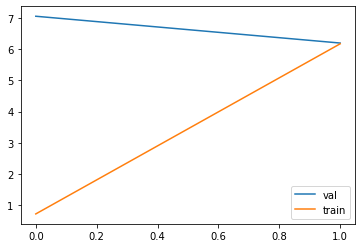


Iteration 200, loss = 6.1512
Checking accuracy on validation set
Got 515 / 1000 correct (51.50)


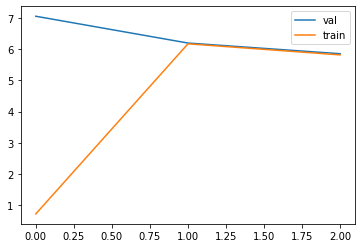


Iteration 300, loss = 5.8014
Checking accuracy on validation set
Got 579 / 1000 correct (57.90)


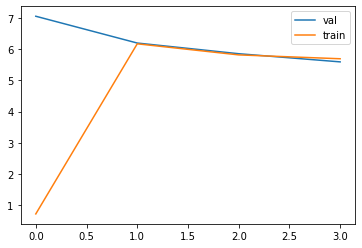


Iteration 400, loss = 5.5509
Checking accuracy on validation set
Got 575 / 1000 correct (57.50)


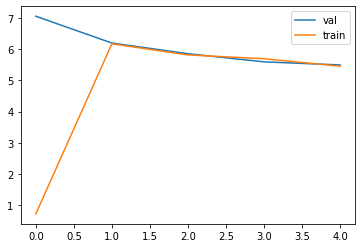


Iteration 500, loss = 5.4522
Checking accuracy on validation set
Got 600 / 1000 correct (60.00)


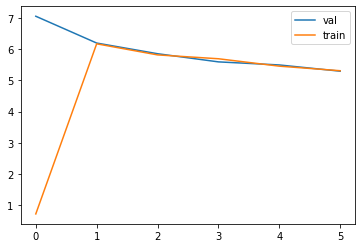


Iteration 600, loss = 5.2277
Checking accuracy on validation set
Got 612 / 1000 correct (61.20)


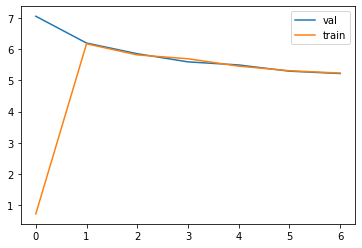


Iteration 700, loss = 4.8659
Checking accuracy on validation set
Got 592 / 1000 correct (59.20)


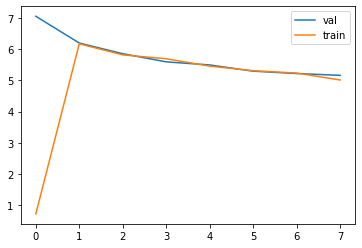


epoch  1
Iteration 0, loss = 5.0296
Checking accuracy on validation set
Got 586 / 1000 correct (58.60)


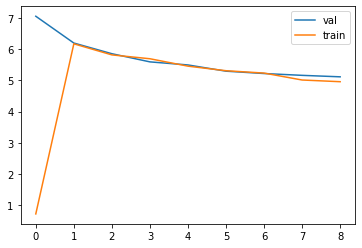


Iteration 100, loss = 4.6037
Checking accuracy on validation set
Got 618 / 1000 correct (61.80)


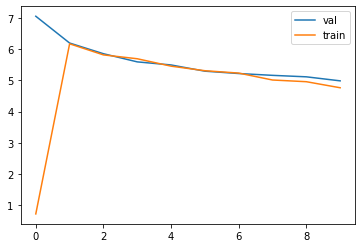


Iteration 200, loss = 4.5311
Checking accuracy on validation set
Got 706 / 1000 correct (70.60)


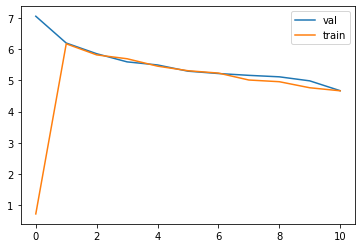


Iteration 300, loss = 4.3982
Checking accuracy on validation set
Got 691 / 1000 correct (69.10)


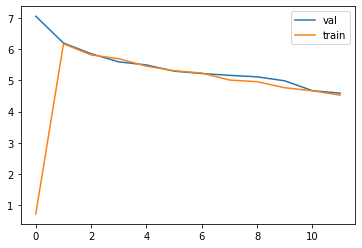


Iteration 400, loss = 4.6272
Checking accuracy on validation set
Got 680 / 1000 correct (68.00)


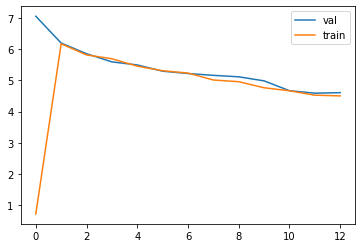


Iteration 500, loss = 4.3882
Checking accuracy on validation set
Got 680 / 1000 correct (68.00)


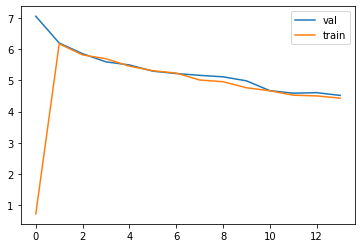


Iteration 600, loss = 4.0919
Checking accuracy on validation set
Got 705 / 1000 correct (70.50)


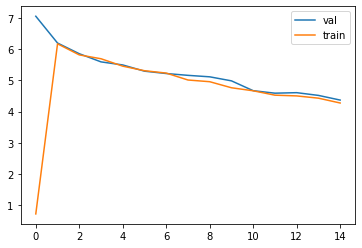


Iteration 700, loss = 4.3133
Checking accuracy on validation set
Got 696 / 1000 correct (69.60)


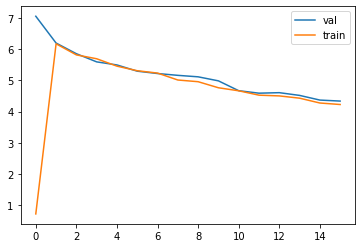


epoch  2
Iteration 0, loss = 4.2117
Checking accuracy on validation set
Got 714 / 1000 correct (71.40)


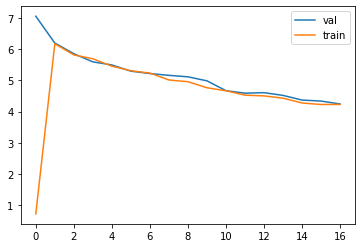


Iteration 100, loss = 4.2923
Checking accuracy on validation set
Got 731 / 1000 correct (73.10)


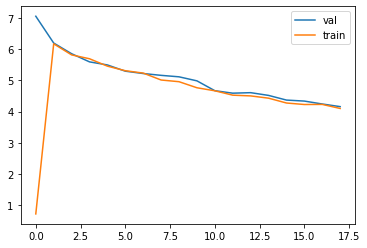


Iteration 200, loss = 3.9707
Checking accuracy on validation set
Got 708 / 1000 correct (70.80)


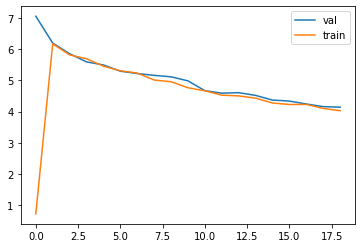


Iteration 300, loss = 3.9176
Checking accuracy on validation set
Got 698 / 1000 correct (69.80)


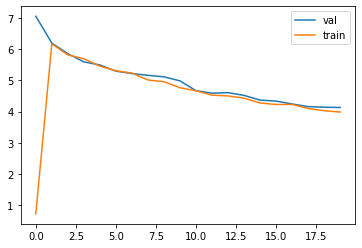


Iteration 400, loss = 3.8434
Checking accuracy on validation set
Got 754 / 1000 correct (75.40)


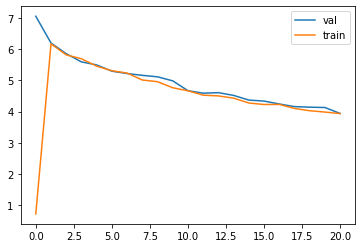


Iteration 500, loss = 3.8441
Checking accuracy on validation set
Got 732 / 1000 correct (73.20)


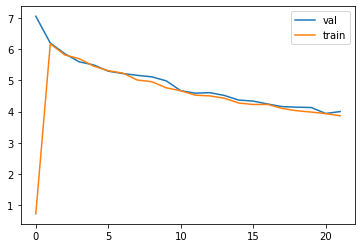


Iteration 600, loss = 3.7633
Checking accuracy on validation set
Got 762 / 1000 correct (76.20)


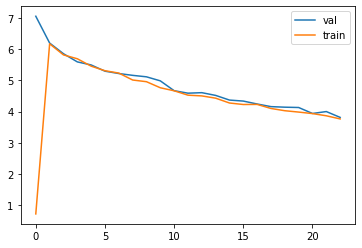


Iteration 700, loss = 3.6905
Checking accuracy on validation set
Got 745 / 1000 correct (74.50)


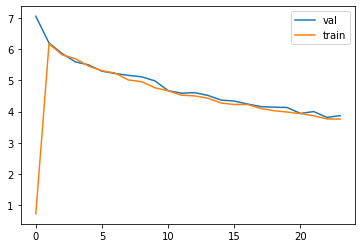


epoch  3
Iteration 0, loss = 3.4288
Checking accuracy on validation set
Got 746 / 1000 correct (74.60)


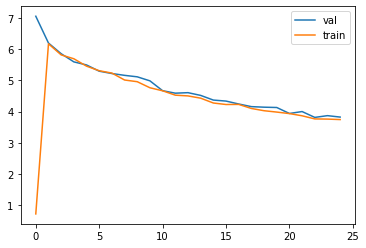


Iteration 100, loss = 3.5621
Checking accuracy on validation set
Got 704 / 1000 correct (70.40)


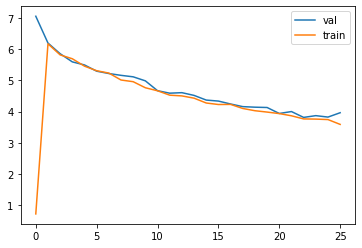


Iteration 200, loss = 3.5360
Checking accuracy on validation set
Got 734 / 1000 correct (73.40)


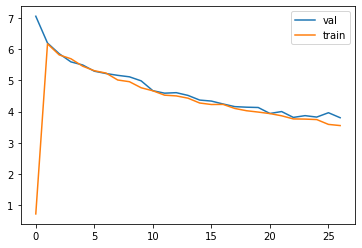


Iteration 300, loss = 3.4316
Checking accuracy on validation set
Got 761 / 1000 correct (76.10)


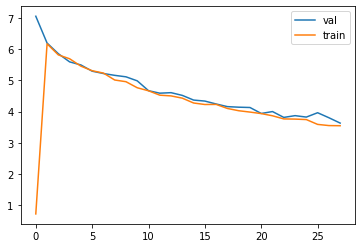


Iteration 400, loss = 3.4798
Checking accuracy on validation set
Got 747 / 1000 correct (74.70)


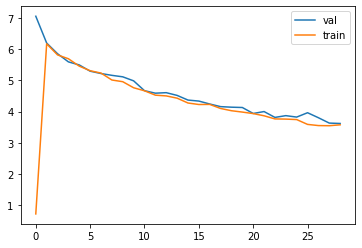


Iteration 500, loss = 3.3332
Checking accuracy on validation set
Got 808 / 1000 correct (80.80)


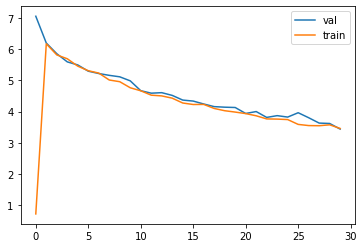


Iteration 600, loss = 3.4568
Checking accuracy on validation set
Got 765 / 1000 correct (76.50)


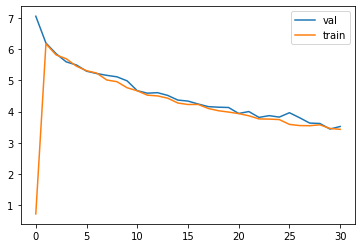


Iteration 700, loss = 3.6261
Checking accuracy on validation set
Got 703 / 1000 correct (70.30)


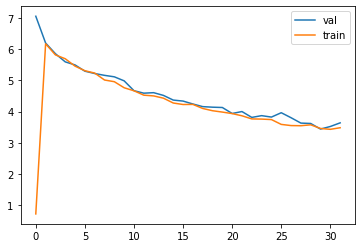


epoch  4
Iteration 0, loss = 3.2462
Checking accuracy on validation set
Got 713 / 1000 correct (71.30)


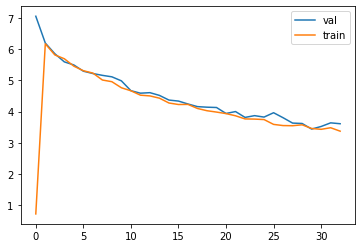


Iteration 100, loss = 3.4805
Checking accuracy on validation set
Got 776 / 1000 correct (77.60)


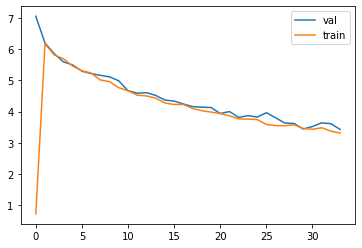


Iteration 200, loss = 3.3839
Checking accuracy on validation set
Got 735 / 1000 correct (73.50)


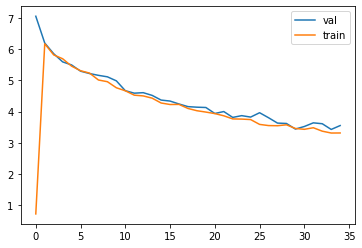


Iteration 300, loss = 3.4324
Checking accuracy on validation set
Got 712 / 1000 correct (71.20)


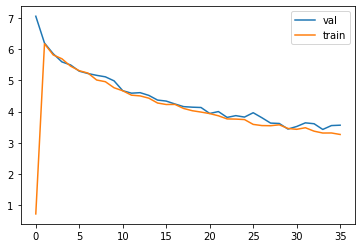


Iteration 400, loss = 3.3010
Checking accuracy on validation set
Got 766 / 1000 correct (76.60)


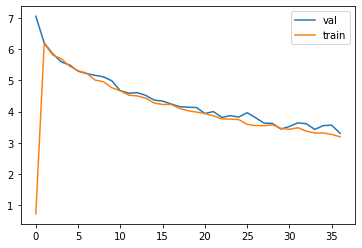


Iteration 500, loss = 3.0985
Checking accuracy on validation set
Got 767 / 1000 correct (76.70)


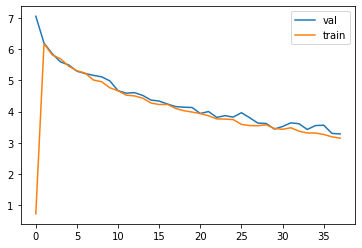


Iteration 600, loss = 3.1062
Checking accuracy on validation set
Got 805 / 1000 correct (80.50)


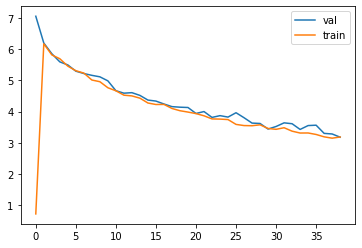


Iteration 700, loss = 3.0486
Checking accuracy on validation set
Got 790 / 1000 correct (79.00)


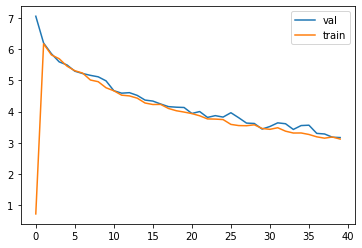


epoch  5
Iteration 0, loss = 2.9838
Checking accuracy on validation set
Got 798 / 1000 correct (79.80)


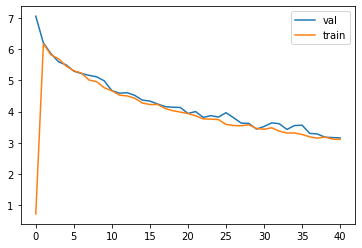


Iteration 100, loss = 2.8182
Checking accuracy on validation set
Got 821 / 1000 correct (82.10)


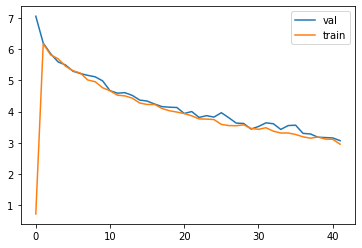


Iteration 200, loss = 2.8678
Checking accuracy on validation set
Got 733 / 1000 correct (73.30)


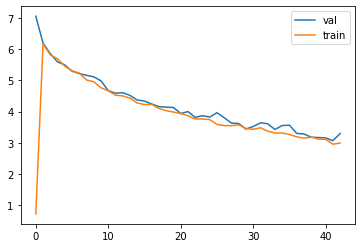


Iteration 300, loss = 2.9783
Checking accuracy on validation set
Got 760 / 1000 correct (76.00)


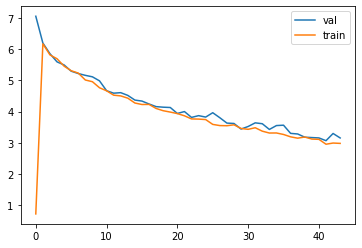


Iteration 400, loss = 2.9098
Checking accuracy on validation set
Got 748 / 1000 correct (74.80)


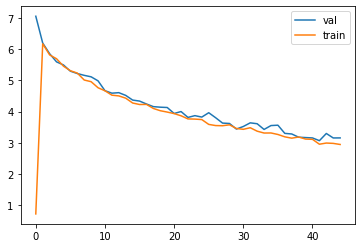


Iteration 500, loss = 2.8557
Checking accuracy on validation set
Got 770 / 1000 correct (77.00)


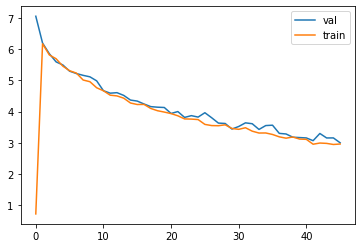


Iteration 600, loss = 3.0371
Checking accuracy on validation set
Got 782 / 1000 correct (78.20)


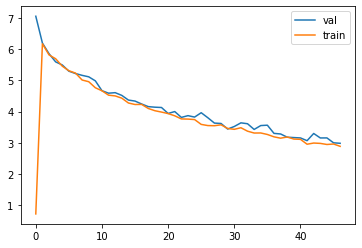


Iteration 700, loss = 3.0477
Checking accuracy on validation set
Got 794 / 1000 correct (79.40)


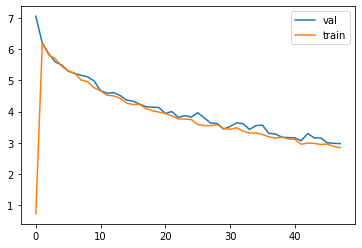


epoch  6
Iteration 0, loss = 2.6174
Checking accuracy on validation set
Got 786 / 1000 correct (78.60)


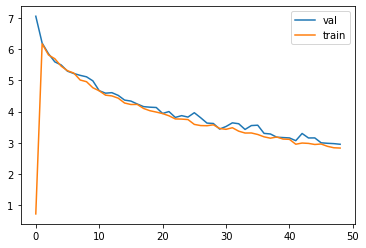


Iteration 100, loss = 2.6331
Checking accuracy on validation set
Got 802 / 1000 correct (80.20)


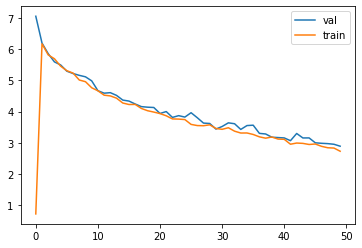


Iteration 200, loss = 2.6610
Checking accuracy on validation set
Got 801 / 1000 correct (80.10)


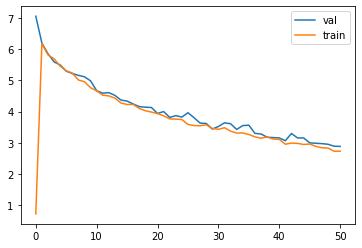


Iteration 300, loss = 3.0643
Checking accuracy on validation set
Got 794 / 1000 correct (79.40)


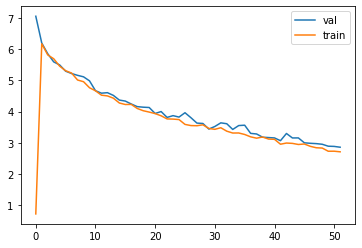


Iteration 400, loss = 2.6704
Checking accuracy on validation set
Got 790 / 1000 correct (79.00)


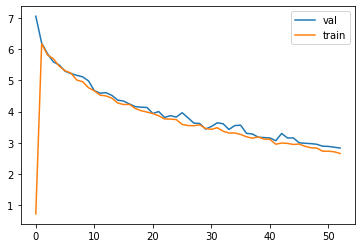


Iteration 500, loss = 2.7614
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)


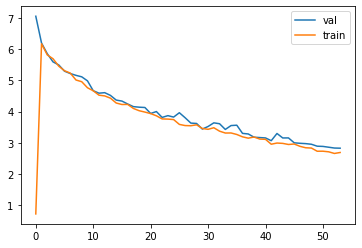


Iteration 600, loss = 2.4772
Checking accuracy on validation set
Got 802 / 1000 correct (80.20)


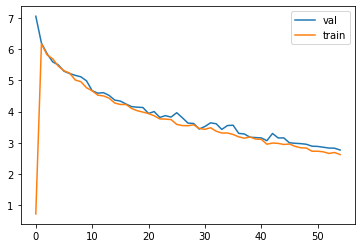


Iteration 700, loss = 2.6927
Checking accuracy on validation set
Got 799 / 1000 correct (79.90)


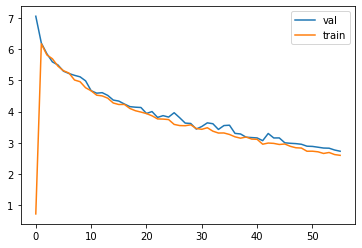


epoch  7
Iteration 0, loss = 2.6428
Checking accuracy on validation set
Got 775 / 1000 correct (77.50)


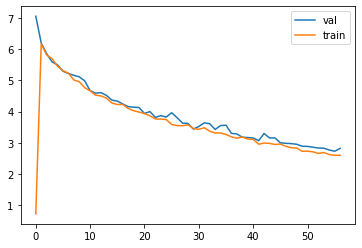


Iteration 100, loss = 2.4069
Checking accuracy on validation set
Got 803 / 1000 correct (80.30)


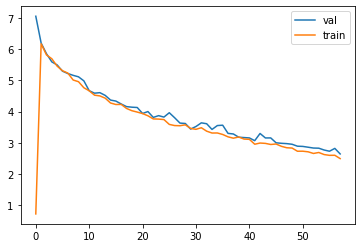


Iteration 200, loss = 2.5340
Checking accuracy on validation set
Got 759 / 1000 correct (75.90)


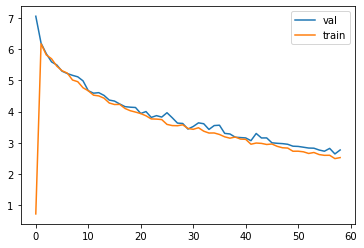


Iteration 300, loss = 2.5567
Checking accuracy on validation set
Got 787 / 1000 correct (78.70)


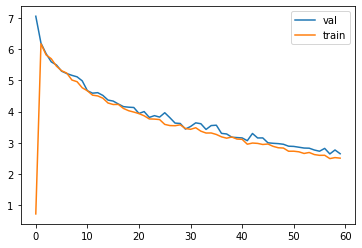


Iteration 400, loss = 2.2485
Checking accuracy on validation set
Got 753 / 1000 correct (75.30)


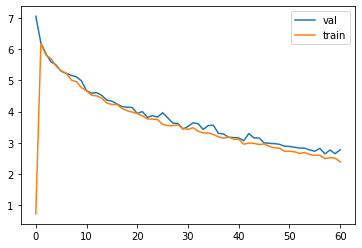


Iteration 500, loss = 2.3904
Checking accuracy on validation set
Got 788 / 1000 correct (78.80)


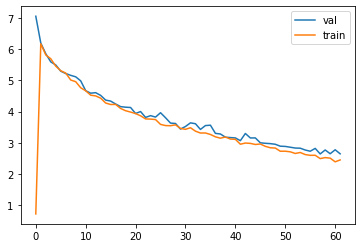


Iteration 600, loss = 2.2662
Checking accuracy on validation set
Got 809 / 1000 correct (80.90)


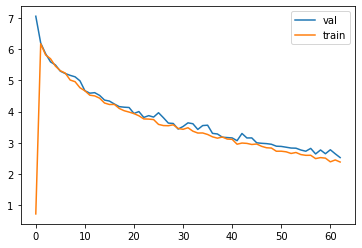


Iteration 700, loss = 2.5697
Checking accuracy on validation set
Got 823 / 1000 correct (82.30)


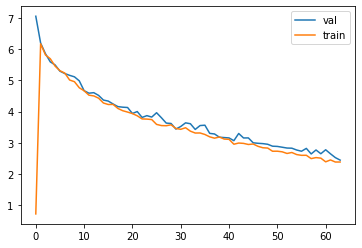


epoch  8
Iteration 0, loss = 2.2811
Checking accuracy on validation set
Got 759 / 1000 correct (75.90)


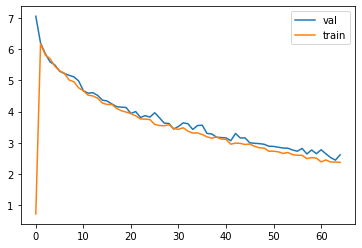


Iteration 100, loss = 2.1747
Checking accuracy on validation set
Got 835 / 1000 correct (83.50)


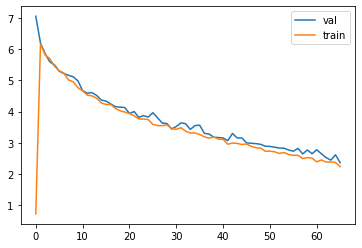


Iteration 200, loss = 2.2017
Checking accuracy on validation set
Got 782 / 1000 correct (78.20)


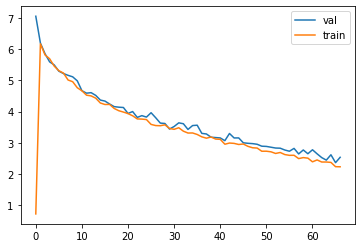


Iteration 300, loss = 2.3814
Checking accuracy on validation set
Got 768 / 1000 correct (76.80)


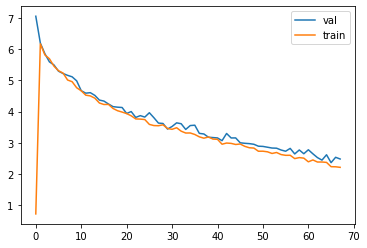


Iteration 400, loss = 2.2950
Checking accuracy on validation set
Got 833 / 1000 correct (83.30)


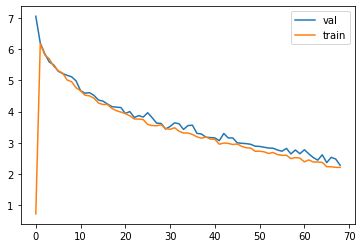


Iteration 500, loss = 2.0863
Checking accuracy on validation set
Got 712 / 1000 correct (71.20)


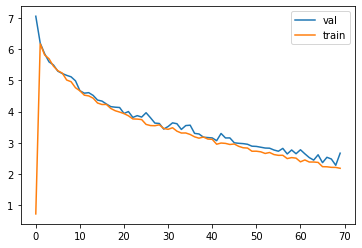


Iteration 600, loss = 2.1841
Checking accuracy on validation set
Got 811 / 1000 correct (81.10)


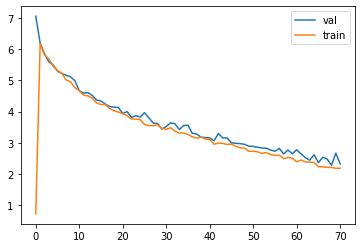


Iteration 700, loss = 2.1567
Checking accuracy on validation set
Got 821 / 1000 correct (82.10)


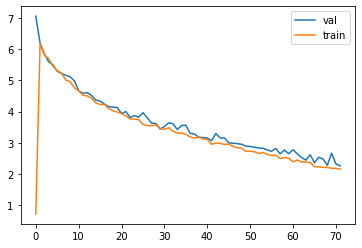


epoch  9
Iteration 0, loss = 2.0748
Checking accuracy on validation set
Got 783 / 1000 correct (78.30)


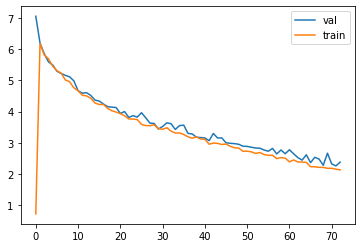


Iteration 100, loss = 2.2105
Checking accuracy on validation set
Got 775 / 1000 correct (77.50)


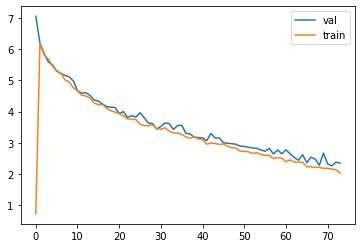


Iteration 200, loss = 2.0108
Checking accuracy on validation set
Got 747 / 1000 correct (74.70)


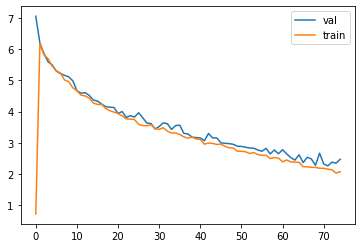


Iteration 300, loss = 2.1791
Checking accuracy on validation set
Got 821 / 1000 correct (82.10)


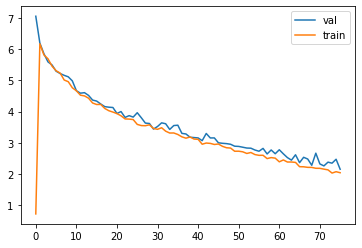


Iteration 400, loss = 2.1069
Checking accuracy on validation set
Got 814 / 1000 correct (81.40)


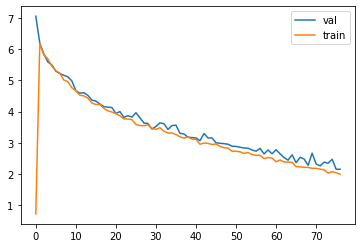


Iteration 500, loss = 2.1030
Checking accuracy on validation set
Got 810 / 1000 correct (81.00)


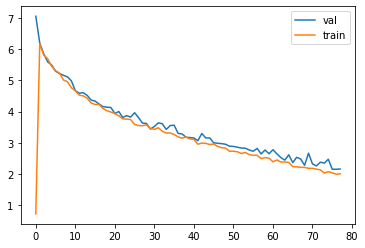


Iteration 600, loss = 1.8278
Checking accuracy on validation set
Got 806 / 1000 correct (80.60)


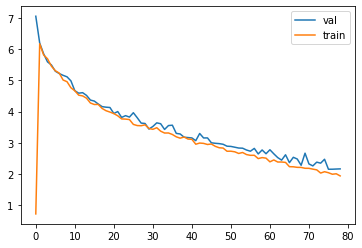


Iteration 700, loss = 1.8371
Checking accuracy on validation set
Got 808 / 1000 correct (80.80)


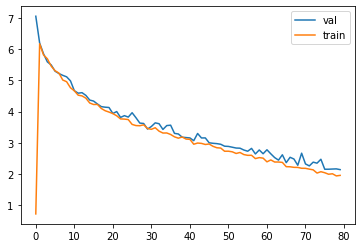


Wed Oct  7 09:38:45 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P0    57W / 250W |  14209MiB / 16280MiB |     96%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+------

In [56]:
# Another model
model = None
optimizer = None
k = 1
channel_1  = int(128)
channel_2  = int(128)
channel_3  = int(128)
channel_4  = int(128)
channel_5  = int(128)
channel_6  = int(256)
channel_7  = int(256)
channel_8  = int(256)
channel_9  = int(256)
channel_10 = int(512)
channel_11 = int(512)
channel_12 = int(512)
channel_13 = int(512)
channel_14 = int(512)
channel_15 = int(1024)
channel_16 = int(1024)

# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
def flatten(x):
    N = x.shape[0] # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image
    
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3,         out_channels=channel_1, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_1),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_2, out_channels=channel_3, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_3),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_3, out_channels=channel_4, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_4),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_5, out_channels=channel_6, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_6),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_6, out_channels=channel_7, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_7),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_7, out_channels=channel_8, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_8),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_8, out_channels=channel_9, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_9),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_9, out_channels=channel_10, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_10),
    nn.ReLU(),
    
    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_11, out_channels=channel_12, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_12),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_12, out_channels=channel_13, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_13),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_14, out_channels=channel_15, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_15),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_15, out_channels=channel_16, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_16),
    nn.ReLU(),

    nn.MaxPool2d(2),

    Flatten(),
    nn.Linear(channel_16, 10)
)

# you can use Nesterov momentum in optim.SGD
learning_rate = 1e-4

optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=0.01)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

# You should get at least 70% accuracy
!nvidia-smi
train_part(model, optimizer, epochs=10, ld=1e-2)
!nvidia-smi

In [57]:
best_model = model
check_accuracy_part34(loader_test, best_model)

Checking accuracy on test set
Got 8113 / 10000 correct (81.13)


0.6063773656726643

Wed Oct  7 09:47:36 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P0    33W / 250W |  14209MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

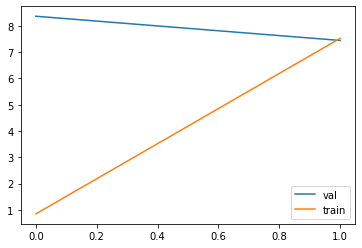


Iteration 200, loss = 7.0549
Checking accuracy on validation set
Got 467 / 1000 correct (46.70)


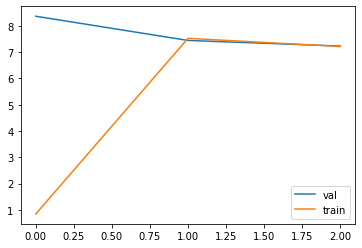


Iteration 300, loss = 6.8992
Checking accuracy on validation set
Got 496 / 1000 correct (49.60)


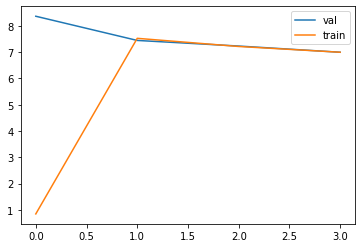


Iteration 400, loss = 6.5620
Checking accuracy on validation set
Got 498 / 1000 correct (49.80)


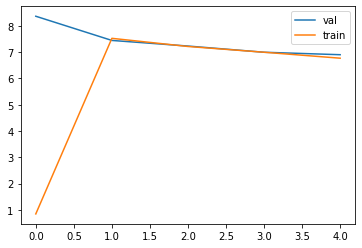


Iteration 500, loss = 6.6504
Checking accuracy on validation set
Got 534 / 1000 correct (53.40)


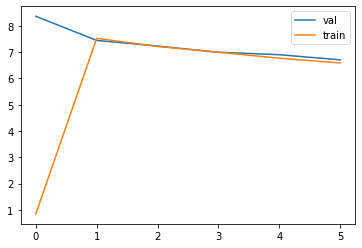


Iteration 600, loss = 6.3592
Checking accuracy on validation set
Got 600 / 1000 correct (60.00)


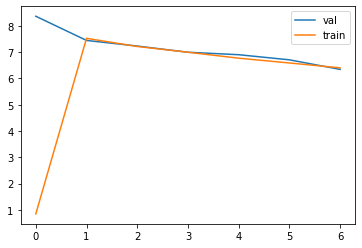


Iteration 700, loss = 6.4715
Checking accuracy on validation set
Got 579 / 1000 correct (57.90)


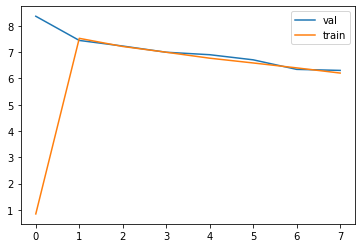


epoch  1
Iteration 0, loss = 6.1222
Checking accuracy on validation set
Got 612 / 1000 correct (61.20)


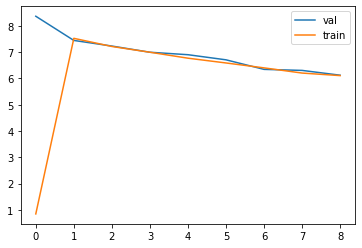


Iteration 100, loss = 5.7176
Checking accuracy on validation set
Got 556 / 1000 correct (55.60)


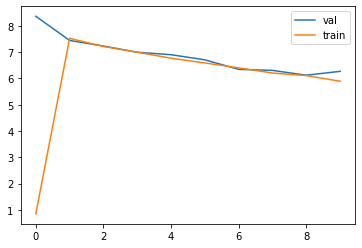


Iteration 200, loss = 5.7786
Checking accuracy on validation set
Got 607 / 1000 correct (60.70)


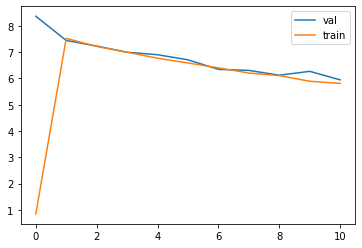


Iteration 300, loss = 5.7438
Checking accuracy on validation set
Got 620 / 1000 correct (62.00)


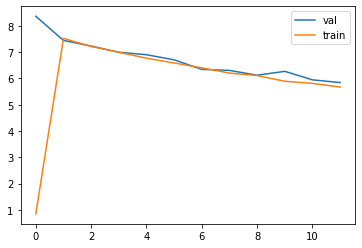


Iteration 400, loss = 5.3006
Checking accuracy on validation set
Got 695 / 1000 correct (69.50)


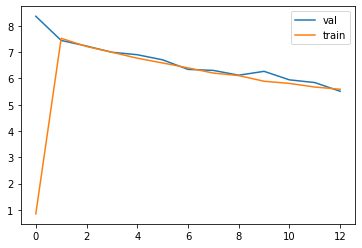


Iteration 500, loss = 5.4623
Checking accuracy on validation set
Got 671 / 1000 correct (67.10)


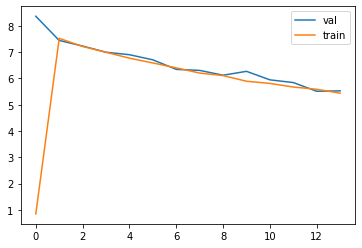


Iteration 600, loss = 5.6867
Checking accuracy on validation set
Got 653 / 1000 correct (65.30)


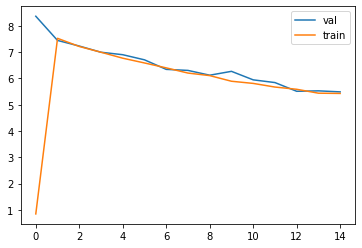


Iteration 700, loss = 5.1632
Checking accuracy on validation set
Got 693 / 1000 correct (69.30)


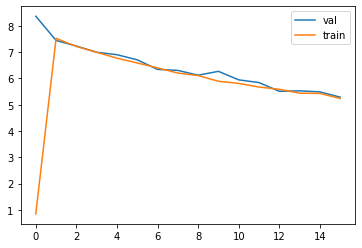


epoch  2
Iteration 0, loss = 5.1134
Checking accuracy on validation set
Got 682 / 1000 correct (68.20)


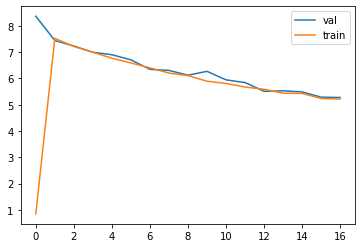


Iteration 100, loss = 4.9732
Checking accuracy on validation set
Got 708 / 1000 correct (70.80)


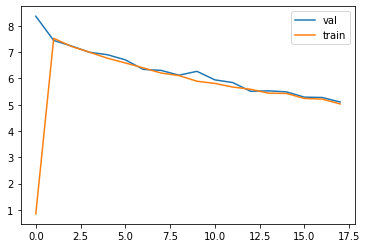


Iteration 200, loss = 5.0674
Checking accuracy on validation set
Got 725 / 1000 correct (72.50)


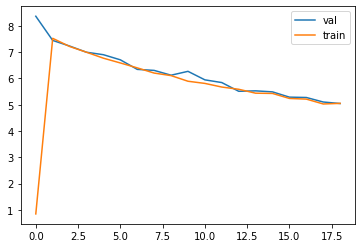


Iteration 300, loss = 4.7943
Checking accuracy on validation set
Got 683 / 1000 correct (68.30)


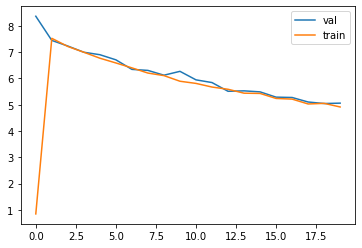


Iteration 400, loss = 5.1862
Checking accuracy on validation set
Got 752 / 1000 correct (75.20)


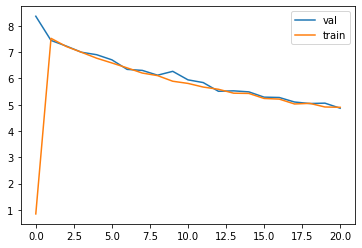


Iteration 500, loss = 4.7329
Checking accuracy on validation set
Got 726 / 1000 correct (72.60)


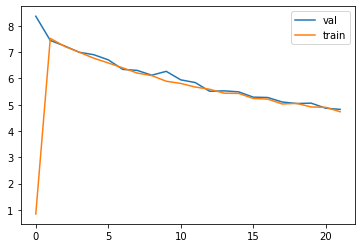


Iteration 600, loss = 5.1013
Checking accuracy on validation set
Got 679 / 1000 correct (67.90)


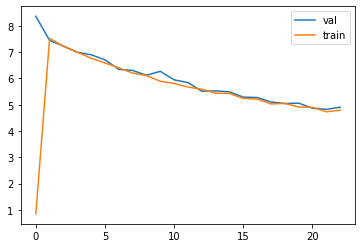


Iteration 700, loss = 4.6458
Checking accuracy on validation set
Got 717 / 1000 correct (71.70)


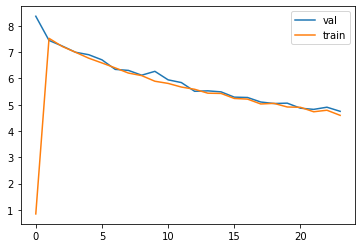


epoch  3
Iteration 0, loss = 4.6197
Checking accuracy on validation set
Got 751 / 1000 correct (75.10)


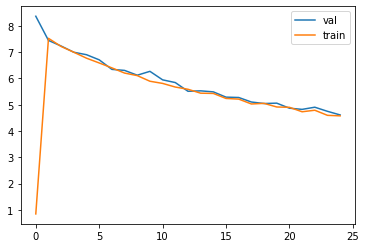


Iteration 100, loss = 4.5976
Checking accuracy on validation set
Got 705 / 1000 correct (70.50)


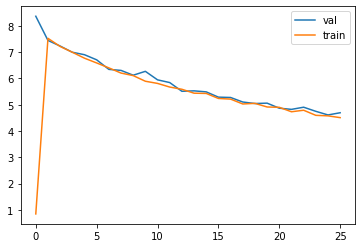


Iteration 200, loss = 4.6220
Checking accuracy on validation set
Got 771 / 1000 correct (77.10)


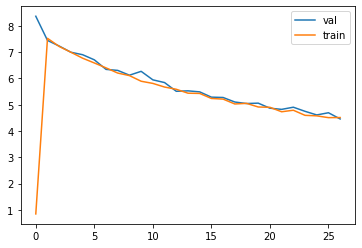


Iteration 300, loss = 4.4678
Checking accuracy on validation set
Got 730 / 1000 correct (73.00)


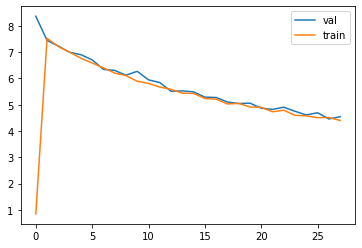


Iteration 400, loss = 4.4139
Checking accuracy on validation set
Got 760 / 1000 correct (76.00)


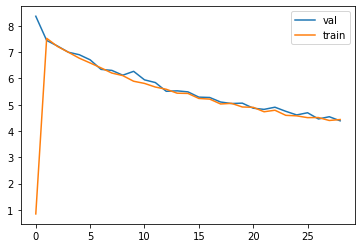


Iteration 500, loss = 4.1235
Checking accuracy on validation set
Got 751 / 1000 correct (75.10)


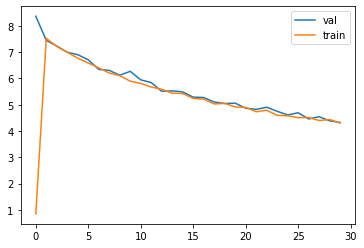


Iteration 600, loss = 4.1372
Checking accuracy on validation set
Got 705 / 1000 correct (70.50)


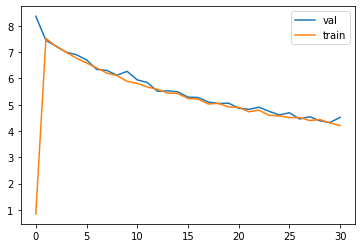


Iteration 700, loss = 4.1450
Checking accuracy on validation set
Got 756 / 1000 correct (75.60)


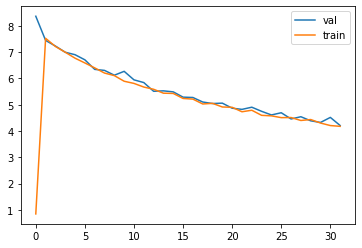


epoch  4
Iteration 0, loss = 3.9630
Checking accuracy on validation set
Got 693 / 1000 correct (69.30)


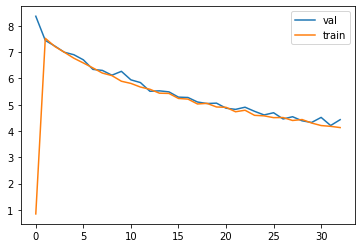


Iteration 100, loss = 4.0612
Checking accuracy on validation set
Got 745 / 1000 correct (74.50)


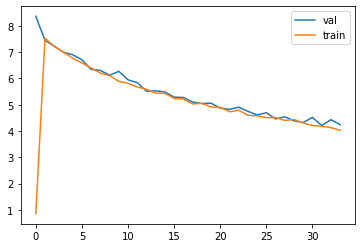


Iteration 200, loss = 4.1867
Checking accuracy on validation set
Got 682 / 1000 correct (68.20)


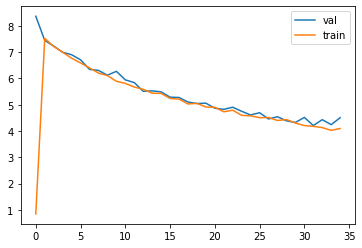


Iteration 300, loss = 3.9940
Checking accuracy on validation set
Got 667 / 1000 correct (66.70)


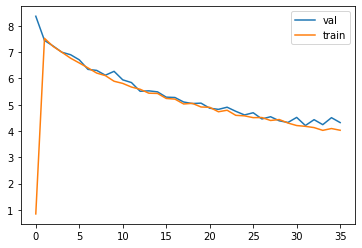


Iteration 400, loss = 4.0867
Checking accuracy on validation set
Got 742 / 1000 correct (74.20)


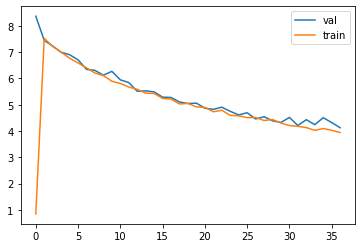


Iteration 500, loss = 4.0003
Checking accuracy on validation set
Got 772 / 1000 correct (77.20)


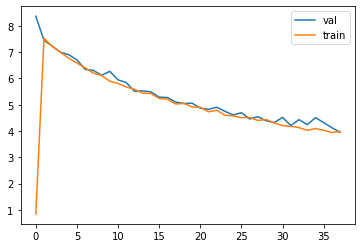


Iteration 600, loss = 4.1249
Checking accuracy on validation set
Got 718 / 1000 correct (71.80)


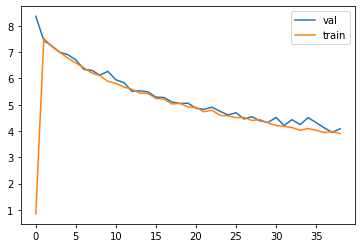


Iteration 700, loss = 3.6157
Checking accuracy on validation set
Got 784 / 1000 correct (78.40)


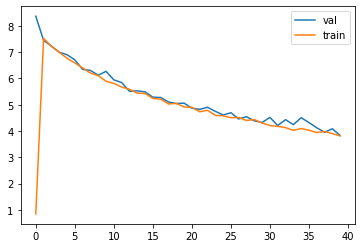


epoch  5
Iteration 0, loss = 3.5986
Checking accuracy on validation set
Got 758 / 1000 correct (75.80)


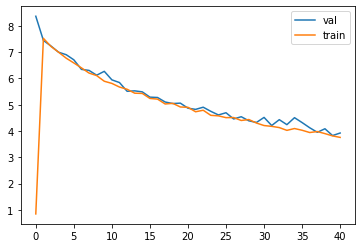


Iteration 100, loss = 3.9365
Checking accuracy on validation set
Got 768 / 1000 correct (76.80)


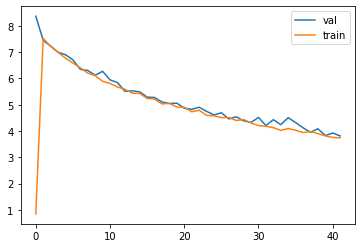


Iteration 200, loss = 3.7285
Checking accuracy on validation set
Got 714 / 1000 correct (71.40)


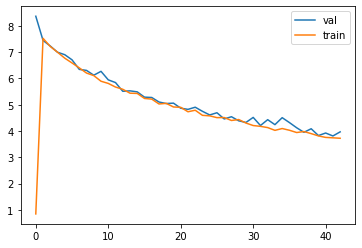


Iteration 300, loss = 3.4411
Checking accuracy on validation set
Got 746 / 1000 correct (74.60)


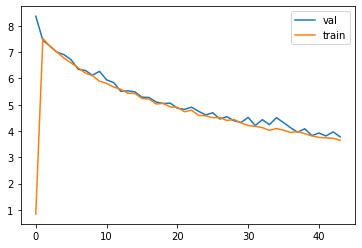


Iteration 400, loss = 3.3388
Checking accuracy on validation set
Got 651 / 1000 correct (65.10)


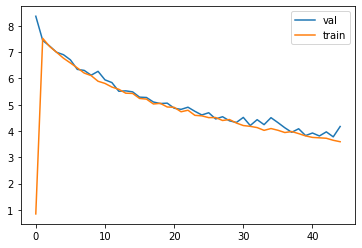


Iteration 500, loss = 3.5817
Checking accuracy on validation set
Got 771 / 1000 correct (77.10)


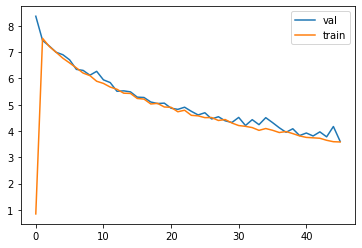


Iteration 600, loss = 3.3964
Checking accuracy on validation set
Got 716 / 1000 correct (71.60)


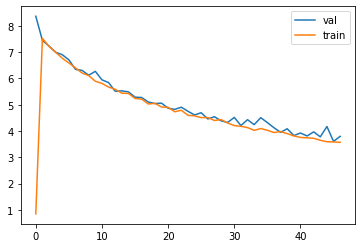


Iteration 700, loss = 3.6531
Checking accuracy on validation set
Got 712 / 1000 correct (71.20)


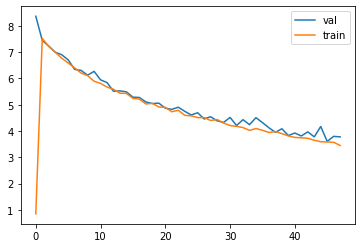


epoch  6
Iteration 0, loss = 3.2935
Checking accuracy on validation set
Got 708 / 1000 correct (70.80)


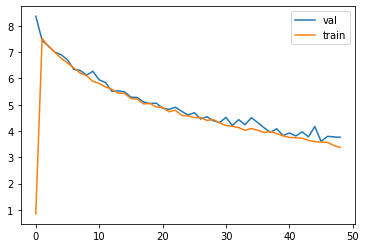


Iteration 100, loss = 3.4478
Checking accuracy on validation set
Got 761 / 1000 correct (76.10)


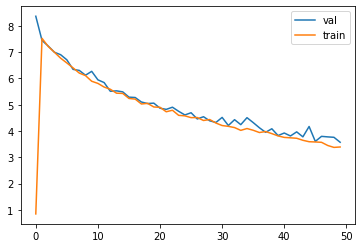


Iteration 200, loss = 3.2475
Checking accuracy on validation set
Got 744 / 1000 correct (74.40)


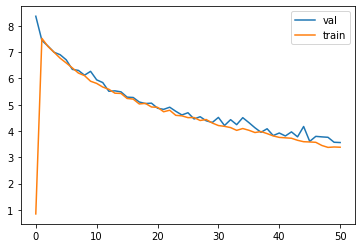


Iteration 300, loss = 3.4003
Checking accuracy on validation set
Got 761 / 1000 correct (76.10)


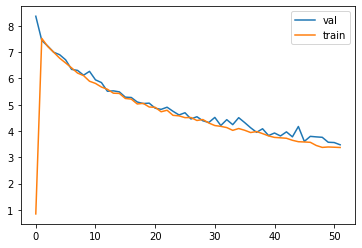


Iteration 400, loss = 3.4131
Checking accuracy on validation set
Got 768 / 1000 correct (76.80)


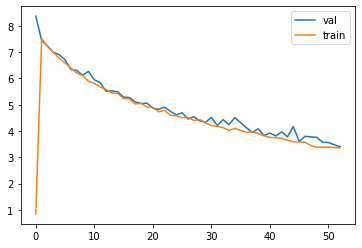


Iteration 500, loss = 3.2381
Checking accuracy on validation set
Got 756 / 1000 correct (75.60)


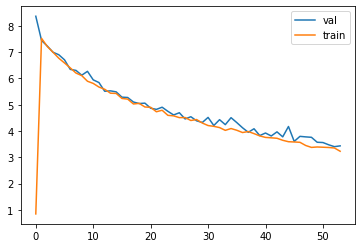


Iteration 600, loss = 2.9323
Checking accuracy on validation set
Got 793 / 1000 correct (79.30)


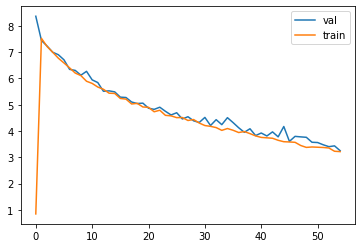


Iteration 700, loss = 3.2508
Checking accuracy on validation set
Got 770 / 1000 correct (77.00)


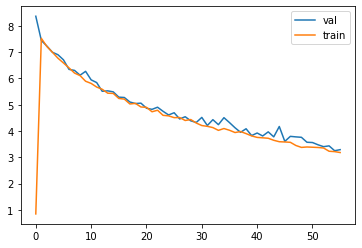


epoch  7
Iteration 0, loss = 3.0088
Checking accuracy on validation set
Got 733 / 1000 correct (73.30)


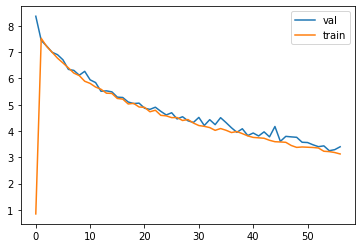


Iteration 100, loss = 3.1867
Checking accuracy on validation set
Got 796 / 1000 correct (79.60)


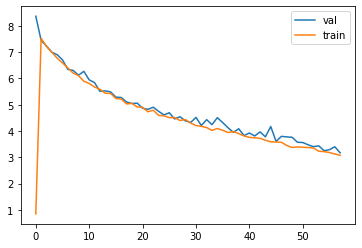


Iteration 200, loss = 3.0739
Checking accuracy on validation set
Got 731 / 1000 correct (73.10)


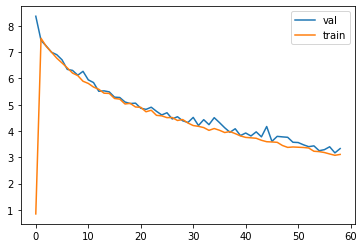


Iteration 300, loss = 2.8619
Checking accuracy on validation set
Got 823 / 1000 correct (82.30)


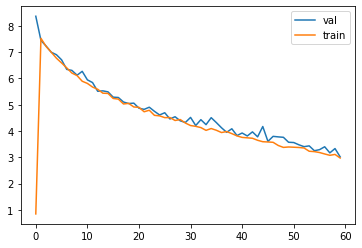


Iteration 400, loss = 2.9755
Checking accuracy on validation set
Got 790 / 1000 correct (79.00)


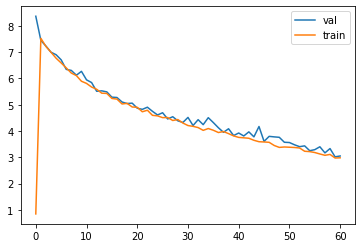


Iteration 500, loss = 3.2598
Checking accuracy on validation set
Got 688 / 1000 correct (68.80)


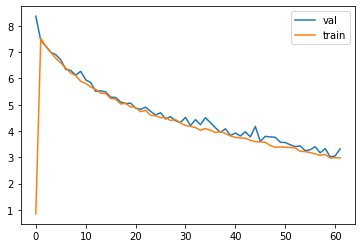


Iteration 600, loss = 2.9064
Checking accuracy on validation set
Got 726 / 1000 correct (72.60)


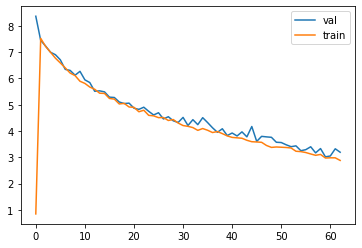


Iteration 700, loss = 2.8052
Checking accuracy on validation set
Got 790 / 1000 correct (79.00)


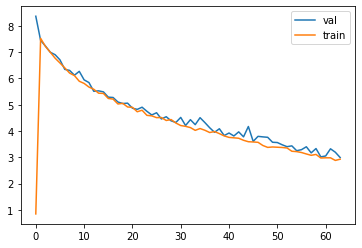


epoch  8
Iteration 0, loss = 2.7475
Checking accuracy on validation set
Got 766 / 1000 correct (76.60)


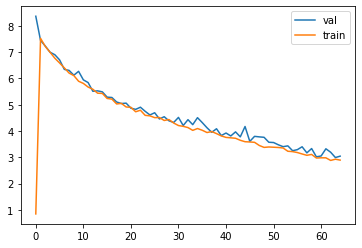


Iteration 100, loss = 2.6649
Checking accuracy on validation set
Got 720 / 1000 correct (72.00)


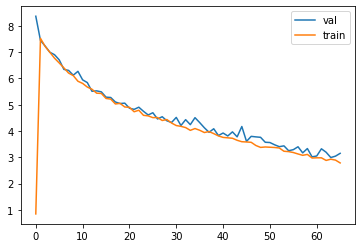


Iteration 200, loss = 2.6891
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)


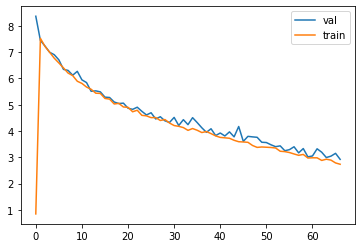


Iteration 300, loss = 2.6711
Checking accuracy on validation set
Got 786 / 1000 correct (78.60)


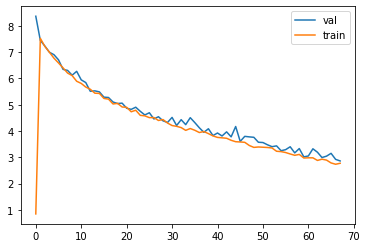


Iteration 400, loss = 2.6640
Checking accuracy on validation set
Got 756 / 1000 correct (75.60)


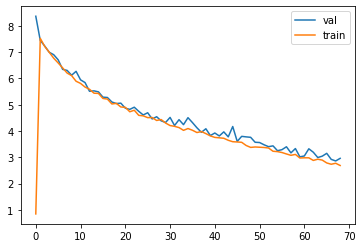


Iteration 500, loss = 2.9126
Checking accuracy on validation set
Got 719 / 1000 correct (71.90)


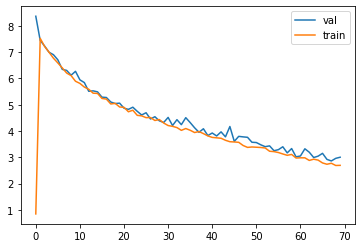


Iteration 600, loss = 2.5426
Checking accuracy on validation set
Got 751 / 1000 correct (75.10)


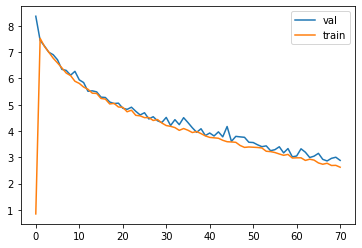


Iteration 700, loss = 2.4619
Checking accuracy on validation set
Got 807 / 1000 correct (80.70)


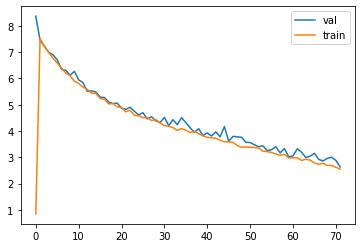


epoch  9
Iteration 0, loss = 2.5632
Checking accuracy on validation set
Got 774 / 1000 correct (77.40)


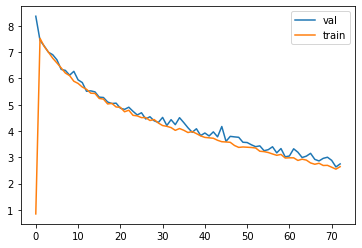


Iteration 100, loss = 2.6082
Checking accuracy on validation set
Got 723 / 1000 correct (72.30)


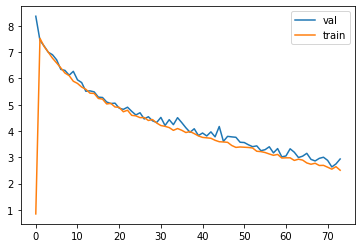


Iteration 200, loss = 2.5355
Checking accuracy on validation set
Got 743 / 1000 correct (74.30)


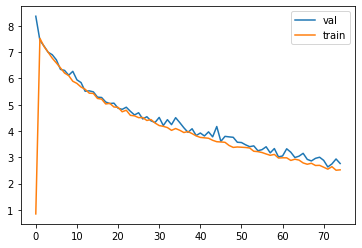


Iteration 300, loss = 2.2998
Checking accuracy on validation set
Got 777 / 1000 correct (77.70)


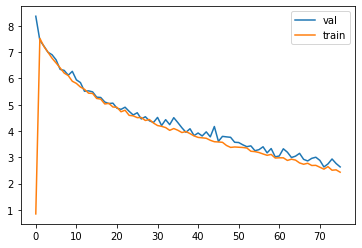


Iteration 400, loss = 2.3398
Checking accuracy on validation set
Got 694 / 1000 correct (69.40)


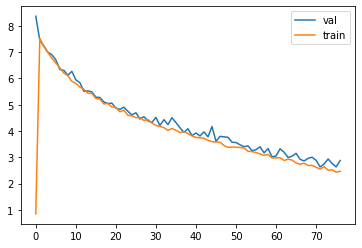


Iteration 500, loss = 2.4155
Checking accuracy on validation set
Got 748 / 1000 correct (74.80)


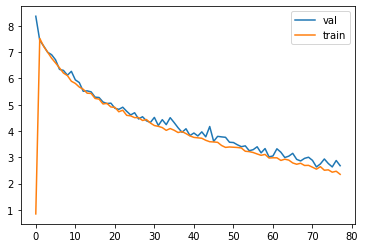


Iteration 600, loss = 2.6519
Checking accuracy on validation set
Got 797 / 1000 correct (79.70)


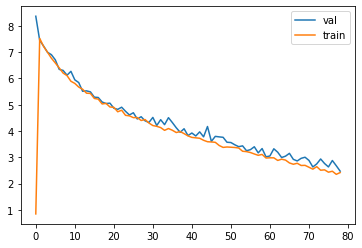


Iteration 700, loss = 2.4398
Checking accuracy on validation set
Got 771 / 1000 correct (77.10)


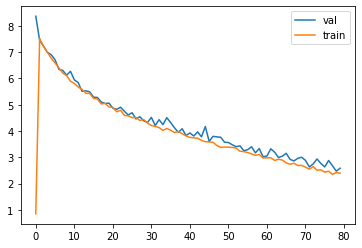


Wed Oct  7 10:01:49 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   73C    P0    58W / 250W |  14209MiB / 16280MiB |     95%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+------

In [58]:
# Another model
model = None
optimizer = None
k = 1
channel_1  = int(128)
channel_2  = int(128)
channel_3  = int(128)

channel_4  = int(256)
channel_5  = int(256)
channel_6  = int(256)

channel_7  = int(256)
channel_8  = int(256)
channel_9  = int(256)

channel_10 = int(512)
channel_11 = int(512)
channel_12 = int(512)

channel_13 = int(512)
channel_14 = int(512)
channel_15 = int(1024)

channel_16 = int(1024)

# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
def flatten(x):
    N = x.shape[0] # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image
    
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3,         out_channels=channel_1, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_1),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_2, out_channels=channel_3, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_3),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_3, out_channels=channel_4, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_4),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.ReLU(),


    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.ReLU(),


    nn.Conv2d(in_channels=channel_5, out_channels=channel_6, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_6),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_6, out_channels=channel_7, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_7),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_7, out_channels=channel_8, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_8),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_8, out_channels=channel_9, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_9),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_9, out_channels=channel_10, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_10),
    nn.ReLU(),
    
    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_11, out_channels=channel_12, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_12),
    nn.ReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_12, out_channels=channel_13, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_13),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_14, out_channels=channel_15, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_15),
    nn.ReLU(),

    nn.Conv2d(in_channels=channel_15, out_channels=channel_16, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_16),
    nn.ReLU(),

    nn.MaxPool2d(2),

    Flatten(),
    nn.Linear(channel_16, 10)
)

# you can use Nesterov momentum in optim.SGD
learning_rate = 1e-4

optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=0.01)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

# You should get at least 70% accuracy
!nvidia-smi
train_part(model, optimizer, epochs=10, ld=1e-2)
!nvidia-smi

In [59]:
best_model = model
check_accuracy_part34(loader_test, best_model)

Checking accuracy on test set
Got 7556 / 10000 correct (75.56)


0.7678205737262774

Wed Oct  7 10:03:52 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   50C    P0    36W / 250W |  14209MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

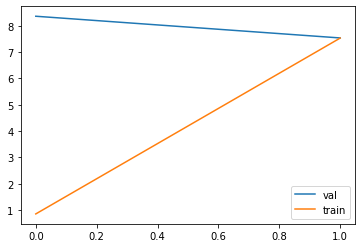


Iteration 200, loss = 7.2295
Checking accuracy on validation set
Got 471 / 1000 correct (47.10)


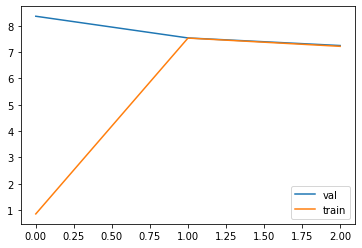


Iteration 300, loss = 6.9501
Checking accuracy on validation set
Got 469 / 1000 correct (46.90)


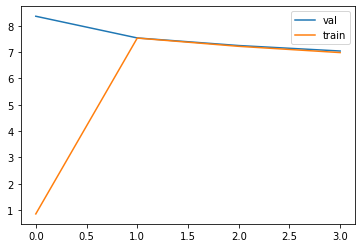


Iteration 400, loss = 6.6421
Checking accuracy on validation set
Got 558 / 1000 correct (55.80)


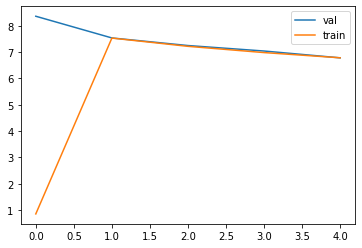


Iteration 500, loss = 6.4823
Checking accuracy on validation set
Got 570 / 1000 correct (57.00)


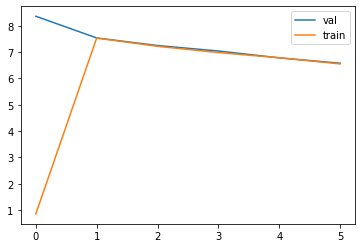


Iteration 600, loss = 6.4292
Checking accuracy on validation set
Got 507 / 1000 correct (50.70)


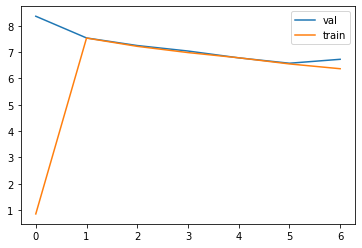


Iteration 700, loss = 5.9818
Checking accuracy on validation set
Got 598 / 1000 correct (59.80)


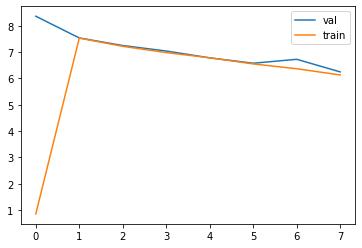


epoch  1
Iteration 0, loss = 6.0611
Checking accuracy on validation set
Got 548 / 1000 correct (54.80)


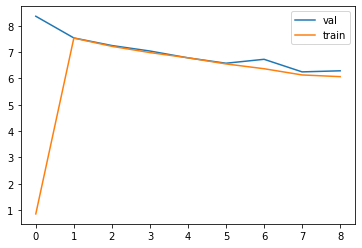


Iteration 100, loss = 5.8802
Checking accuracy on validation set
Got 592 / 1000 correct (59.20)


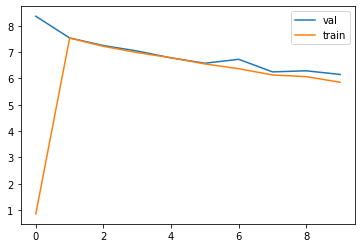


Iteration 200, loss = 5.7828
Checking accuracy on validation set
Got 660 / 1000 correct (66.00)


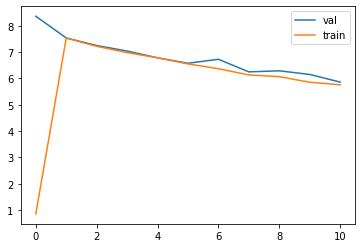


Iteration 300, loss = 5.8282
Checking accuracy on validation set
Got 536 / 1000 correct (53.60)


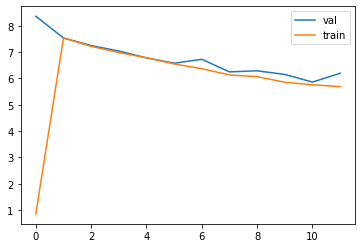


Iteration 400, loss = 5.4875
Checking accuracy on validation set
Got 685 / 1000 correct (68.50)


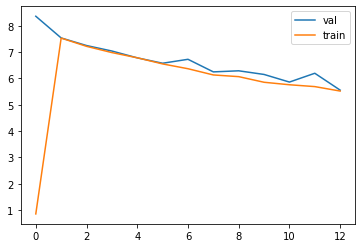


Iteration 500, loss = 5.5758
Checking accuracy on validation set
Got 625 / 1000 correct (62.50)


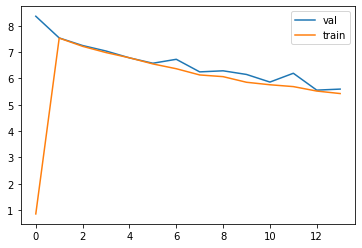


Iteration 600, loss = 5.4211
Checking accuracy on validation set
Got 742 / 1000 correct (74.20)


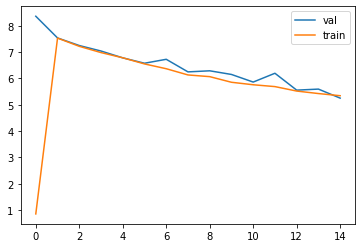


Iteration 700, loss = 5.0580
Checking accuracy on validation set
Got 751 / 1000 correct (75.10)


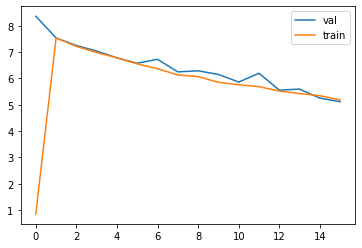


epoch  2
Iteration 0, loss = 5.0597
Checking accuracy on validation set
Got 627 / 1000 correct (62.70)


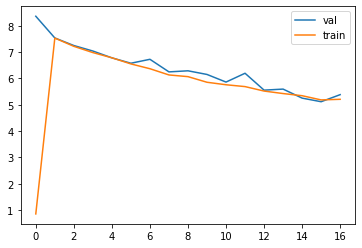


Iteration 100, loss = 5.1356
Checking accuracy on validation set
Got 640 / 1000 correct (64.00)


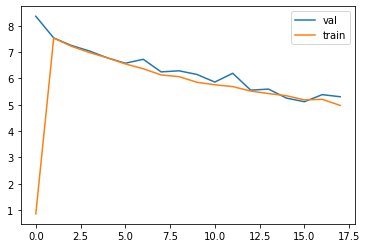


Iteration 200, loss = 4.7413
Checking accuracy on validation set
Got 673 / 1000 correct (67.30)


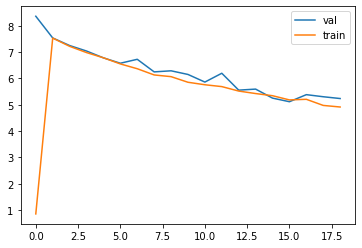


Iteration 300, loss = 4.8112
Checking accuracy on validation set
Got 690 / 1000 correct (69.00)


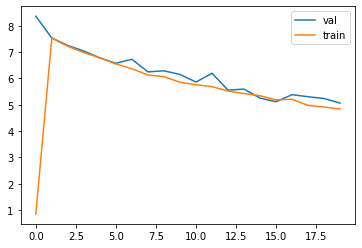


Iteration 400, loss = 4.9562
Checking accuracy on validation set
Got 711 / 1000 correct (71.10)


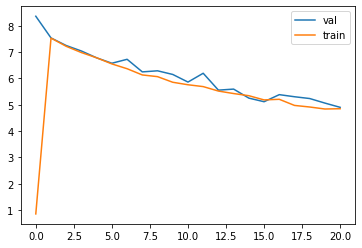


Iteration 500, loss = 4.7666
Checking accuracy on validation set
Got 749 / 1000 correct (74.90)


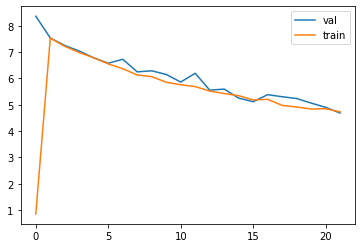


Iteration 600, loss = 4.5605
Checking accuracy on validation set
Got 697 / 1000 correct (69.70)


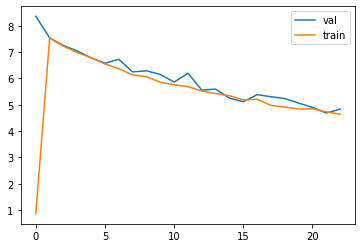


Iteration 700, loss = 4.8031
Checking accuracy on validation set
Got 735 / 1000 correct (73.50)


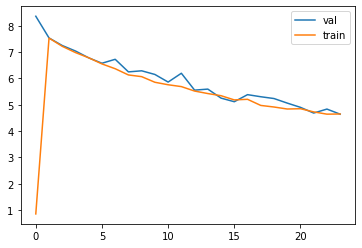


epoch  3
Iteration 0, loss = 4.4174
Checking accuracy on validation set
Got 712 / 1000 correct (71.20)


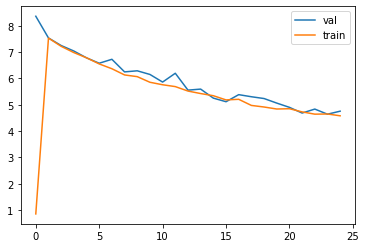


Iteration 100, loss = 4.2501
Checking accuracy on validation set
Got 757 / 1000 correct (75.70)


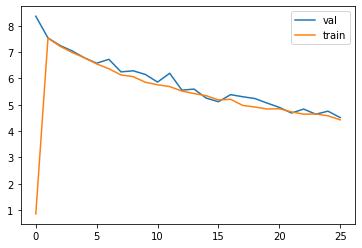


Iteration 200, loss = 4.3641
Checking accuracy on validation set
Got 747 / 1000 correct (74.70)


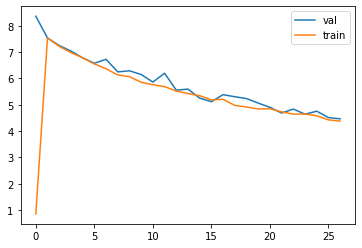


Iteration 300, loss = 4.6740
Checking accuracy on validation set
Got 751 / 1000 correct (75.10)


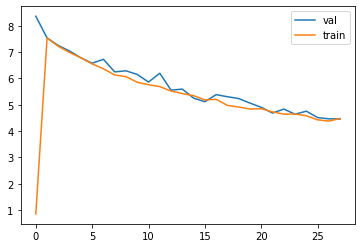


Iteration 400, loss = 4.3174
Checking accuracy on validation set
Got 743 / 1000 correct (74.30)


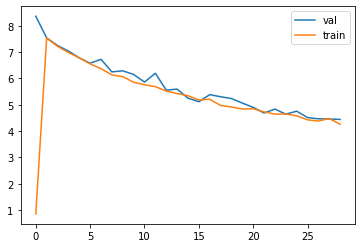


Iteration 500, loss = 4.1680
Checking accuracy on validation set
Got 731 / 1000 correct (73.10)


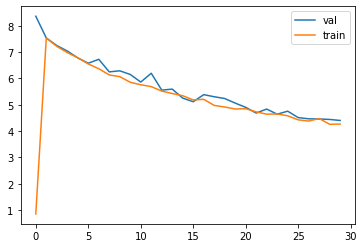


Iteration 600, loss = 4.1132
Checking accuracy on validation set
Got 731 / 1000 correct (73.10)


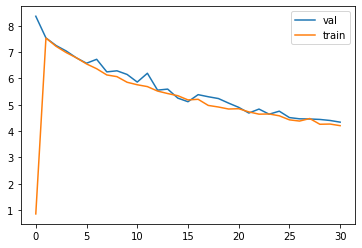


Iteration 700, loss = 4.3812
Checking accuracy on validation set
Got 730 / 1000 correct (73.00)


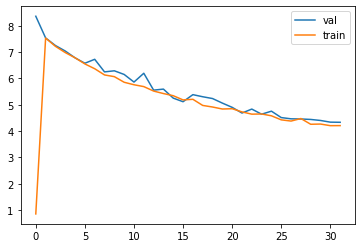


epoch  4
Iteration 0, loss = 4.0171
Checking accuracy on validation set
Got 768 / 1000 correct (76.80)


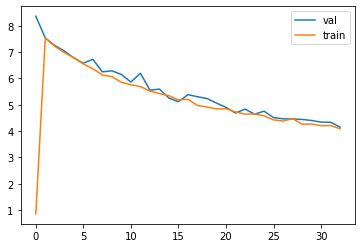


Iteration 100, loss = 4.1267
Checking accuracy on validation set
Got 775 / 1000 correct (77.50)


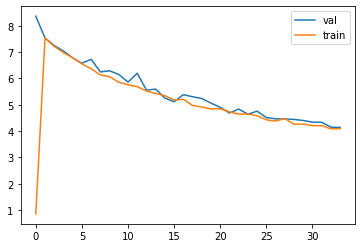


Iteration 200, loss = 4.2713
Checking accuracy on validation set
Got 690 / 1000 correct (69.00)


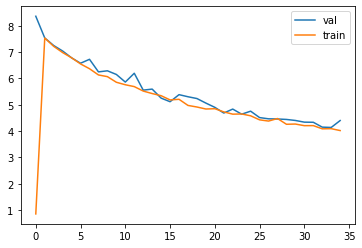


Iteration 300, loss = 4.1617
Checking accuracy on validation set
Got 631 / 1000 correct (63.10)


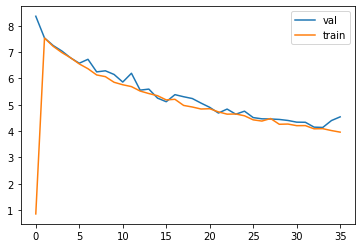


Iteration 400, loss = 3.9452
Checking accuracy on validation set
Got 690 / 1000 correct (69.00)


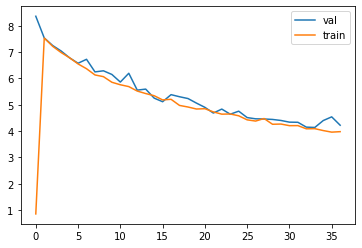


Iteration 500, loss = 3.8743
Checking accuracy on validation set
Got 722 / 1000 correct (72.20)


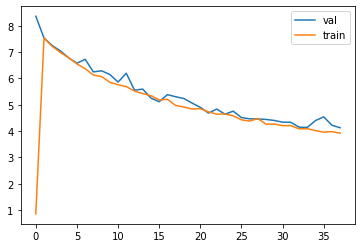


Iteration 600, loss = 3.8015
Checking accuracy on validation set
Got 735 / 1000 correct (73.50)


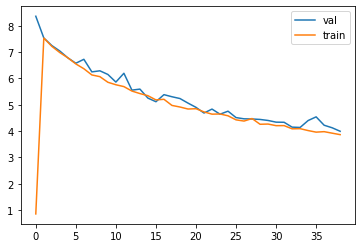


Iteration 700, loss = 3.8286
Checking accuracy on validation set
Got 758 / 1000 correct (75.80)


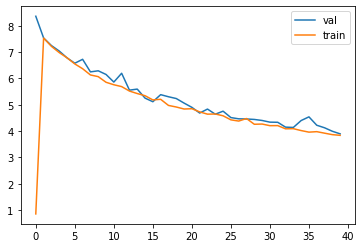


epoch  5
Iteration 0, loss = 3.6147
Checking accuracy on validation set
Got 729 / 1000 correct (72.90)


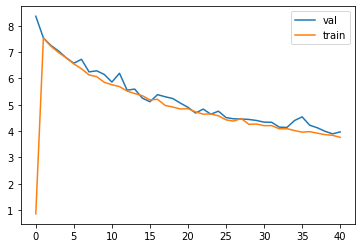


Iteration 100, loss = 3.5210
Checking accuracy on validation set
Got 807 / 1000 correct (80.70)


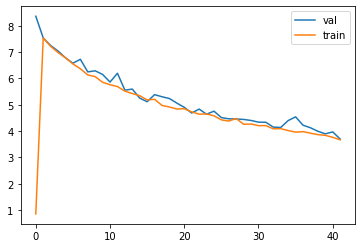


Iteration 200, loss = 3.6467
Checking accuracy on validation set
Got 724 / 1000 correct (72.40)


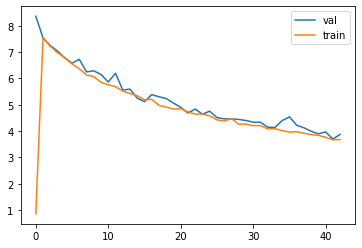


Iteration 300, loss = 3.7613
Checking accuracy on validation set
Got 667 / 1000 correct (66.70)


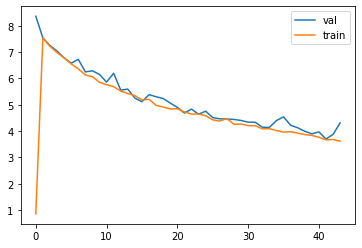


Iteration 400, loss = 3.5593
Checking accuracy on validation set
Got 730 / 1000 correct (73.00)


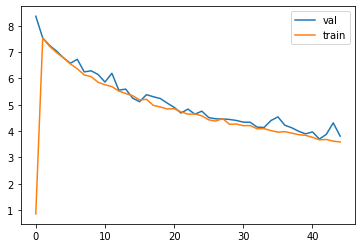


Iteration 500, loss = 3.4390
Checking accuracy on validation set
Got 744 / 1000 correct (74.40)


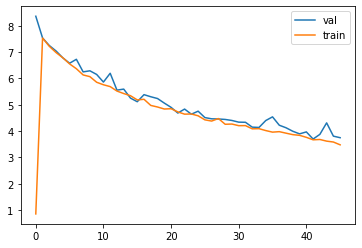


Iteration 600, loss = 3.4111
Checking accuracy on validation set
Got 703 / 1000 correct (70.30)


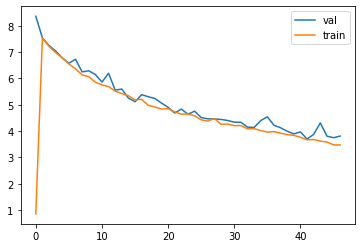


Iteration 700, loss = 3.6343
Checking accuracy on validation set
Got 640 / 1000 correct (64.00)


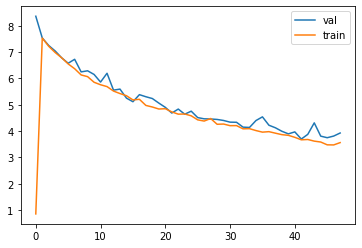


epoch  6
Iteration 0, loss = 3.5852
Checking accuracy on validation set
Got 750 / 1000 correct (75.00)


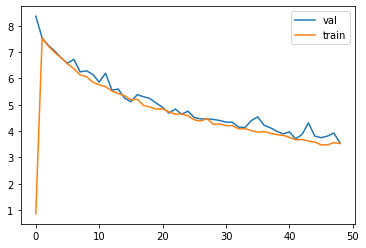


Iteration 100, loss = 3.3005
Checking accuracy on validation set
Got 748 / 1000 correct (74.80)


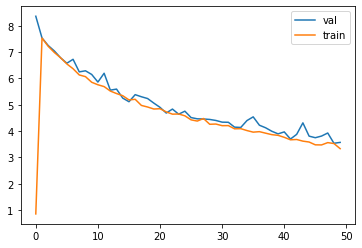


Iteration 200, loss = 3.4861
Checking accuracy on validation set
Got 709 / 1000 correct (70.90)


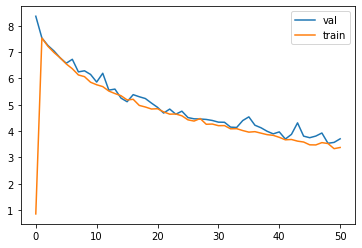


Iteration 300, loss = 3.5695
Checking accuracy on validation set
Got 803 / 1000 correct (80.30)


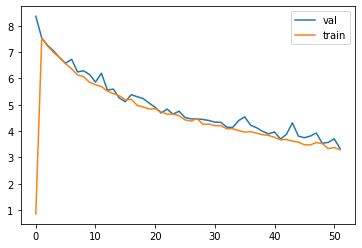


Iteration 400, loss = 3.0875
Checking accuracy on validation set
Got 808 / 1000 correct (80.80)


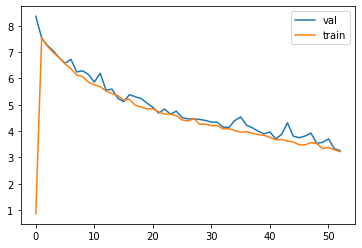


Iteration 500, loss = 3.2472
Checking accuracy on validation set
Got 771 / 1000 correct (77.10)


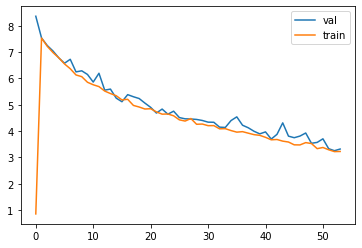


Iteration 600, loss = 3.6491
Checking accuracy on validation set
Got 720 / 1000 correct (72.00)


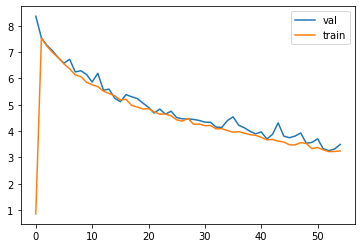


Iteration 700, loss = 3.2509
Checking accuracy on validation set
Got 726 / 1000 correct (72.60)


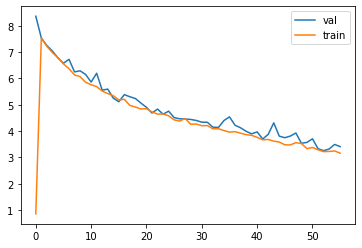


epoch  7
Iteration 0, loss = 3.0121
Checking accuracy on validation set
Got 748 / 1000 correct (74.80)


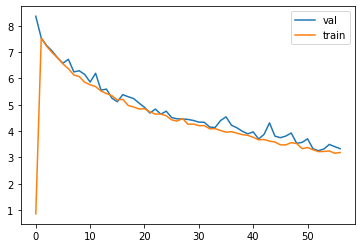


Iteration 100, loss = 3.2479
Checking accuracy on validation set
Got 736 / 1000 correct (73.60)


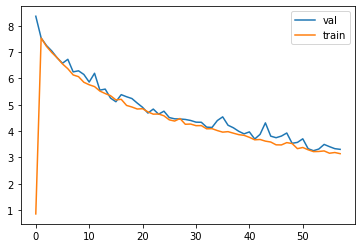


Iteration 200, loss = 3.1303
Checking accuracy on validation set
Got 743 / 1000 correct (74.30)


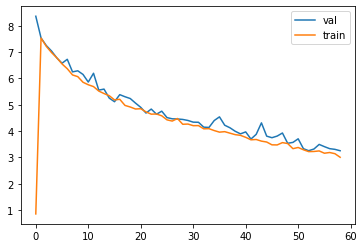


Iteration 300, loss = 2.9672
Checking accuracy on validation set
Got 776 / 1000 correct (77.60)


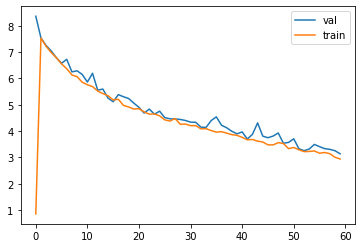


Iteration 400, loss = 3.1835
Checking accuracy on validation set
Got 732 / 1000 correct (73.20)


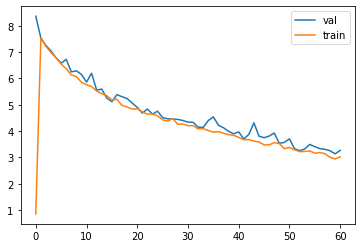


Iteration 500, loss = 2.9459
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)


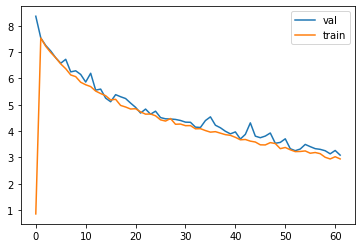


Iteration 600, loss = 3.0256
Checking accuracy on validation set
Got 692 / 1000 correct (69.20)


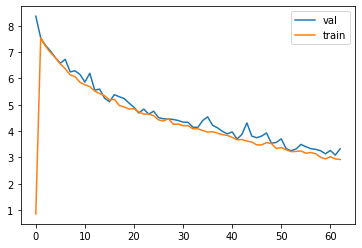


Iteration 700, loss = 2.7137
Checking accuracy on validation set
Got 763 / 1000 correct (76.30)


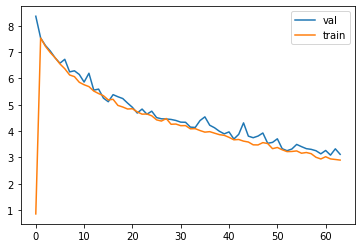


epoch  8
Iteration 0, loss = 2.7984
Checking accuracy on validation set
Got 759 / 1000 correct (75.90)


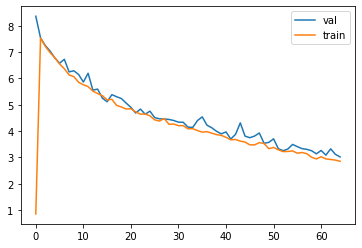


Iteration 100, loss = 2.6756
Checking accuracy on validation set
Got 749 / 1000 correct (74.90)


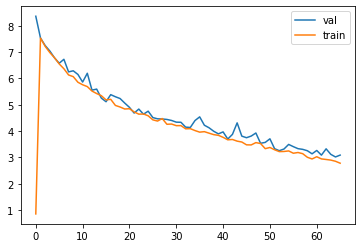


Iteration 200, loss = 2.7396
Checking accuracy on validation set
Got 801 / 1000 correct (80.10)


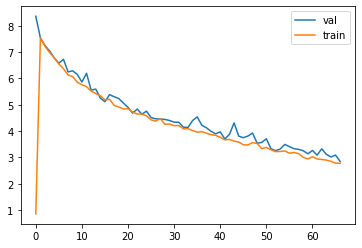


Iteration 300, loss = 2.7845
Checking accuracy on validation set
Got 760 / 1000 correct (76.00)


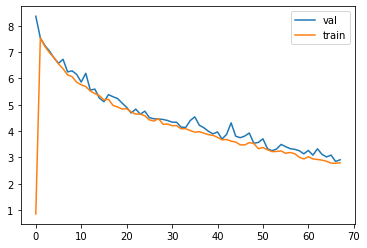


Iteration 400, loss = 2.6296
Checking accuracy on validation set
Got 781 / 1000 correct (78.10)


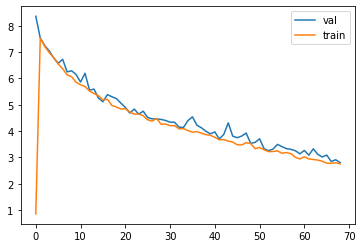


Iteration 500, loss = 2.7233
Checking accuracy on validation set
Got 784 / 1000 correct (78.40)


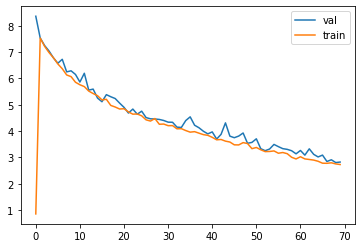


Iteration 600, loss = 2.7858
Checking accuracy on validation set
Got 771 / 1000 correct (77.10)


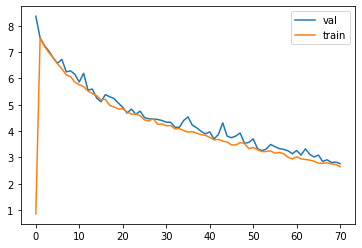


Iteration 700, loss = 2.5544
Checking accuracy on validation set
Got 774 / 1000 correct (77.40)


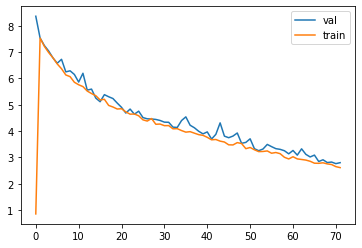


epoch  9
Iteration 0, loss = 2.5153
Checking accuracy on validation set
Got 773 / 1000 correct (77.30)


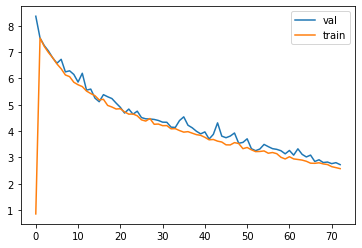


Iteration 100, loss = 2.4427
Checking accuracy on validation set
Got 806 / 1000 correct (80.60)


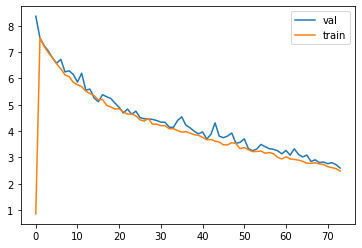


Iteration 200, loss = 2.8169
Checking accuracy on validation set
Got 752 / 1000 correct (75.20)


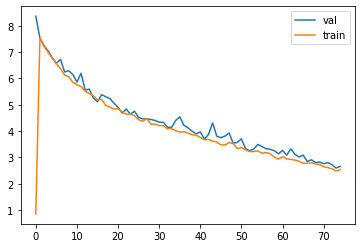


Iteration 300, loss = 2.4635
Checking accuracy on validation set
Got 674 / 1000 correct (67.40)


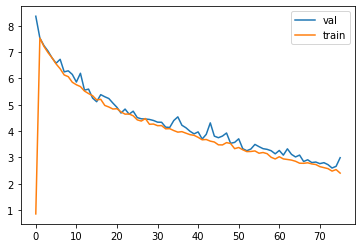


Iteration 400, loss = 2.5078
Checking accuracy on validation set
Got 793 / 1000 correct (79.30)


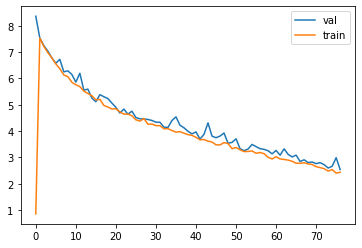


Iteration 500, loss = 2.2118
Checking accuracy on validation set
Got 795 / 1000 correct (79.50)


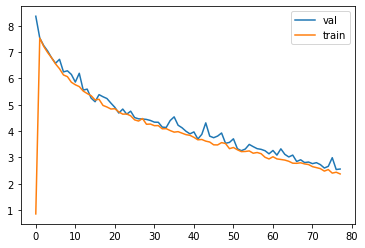


Iteration 600, loss = 2.5559
Checking accuracy on validation set
Got 779 / 1000 correct (77.90)


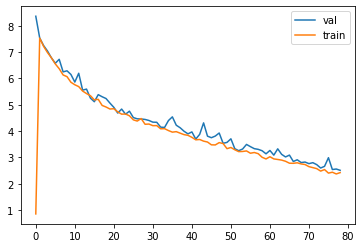


Iteration 700, loss = 2.2064
Checking accuracy on validation set
Got 804 / 1000 correct (80.40)


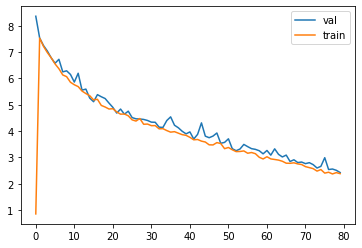


Wed Oct  7 10:18:03 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P0    58W / 250W |  14209MiB / 16280MiB |     97%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+------

In [60]:
# Another model
model = None
optimizer = None
k = 1
channel_1  = int(128)
channel_2  = int(128)
channel_3  = int(128)

channel_4  = int(256)
channel_5  = int(256)
channel_6  = int(256)

channel_7  = int(256)
channel_8  = int(256)
channel_9  = int(256)

channel_10 = int(512)
channel_11 = int(512)
channel_12 = int(512)

channel_13 = int(512)
channel_14 = int(512)
channel_15 = int(1024)

channel_16 = int(1024)

# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
def flatten(x):
    N = x.shape[0] # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image
    
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3,         out_channels=channel_1, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_1),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_2, out_channels=channel_3, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_3),
    nn.LeakyReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_3, out_channels=channel_4, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_4),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.LeakyReLU(),


    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.LeakyReLU(),


    nn.Conv2d(in_channels=channel_5, out_channels=channel_6, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_6),
    nn.LeakyReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_6, out_channels=channel_7, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_7),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_7, out_channels=channel_8, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_8),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_8, out_channels=channel_9, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_9),
    nn.LeakyReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_9, out_channels=channel_10, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_10),
    nn.LeakyReLU(),
    
    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_11, out_channels=channel_12, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_12),
    nn.LeakyReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_12, out_channels=channel_13, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_13),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_14, out_channels=channel_15, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_15),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_15, out_channels=channel_16, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_16),
    nn.LeakyReLU(),

    nn.MaxPool2d(2),

    Flatten(),
    nn.Linear(channel_16, 10)
)

# you can use Nesterov momentum in optim.SGD
learning_rate = 1e-4

optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=0.01)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

# You should get at least 70% accuracy
!nvidia-smi
train_part(model, optimizer, epochs=10, ld=1e-2)
!nvidia-smi

In [61]:
best_model = model
check_accuracy_part34(loader_test, best_model)

Checking accuracy on test set
Got 7878 / 10000 correct (78.78)


0.6663035361250494

Wed Oct  7 10:23:35 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P0    34W / 250W |  14209MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

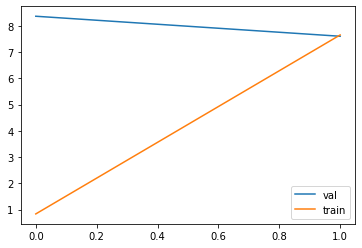


Iteration 200, loss = 7.3974
Checking accuracy on validation set
Got 414 / 1000 correct (41.40)


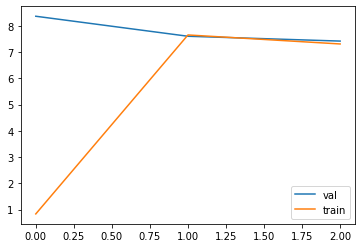


Iteration 300, loss = 7.1643
Checking accuracy on validation set
Got 385 / 1000 correct (38.50)


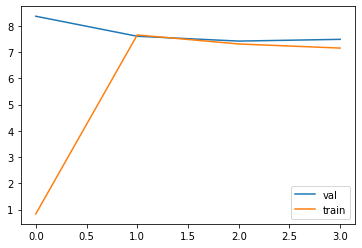


Iteration 400, loss = 6.9576
Checking accuracy on validation set
Got 493 / 1000 correct (49.30)


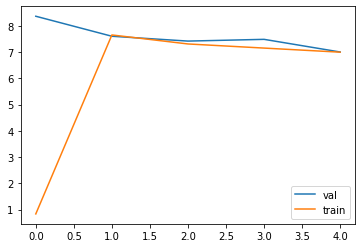


Iteration 500, loss = 6.6912
Checking accuracy on validation set
Got 520 / 1000 correct (52.00)


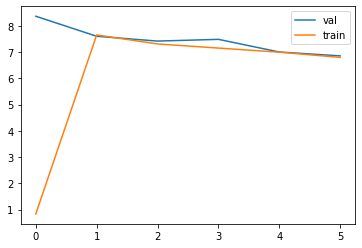


Iteration 600, loss = 6.8191
Checking accuracy on validation set
Got 582 / 1000 correct (58.20)


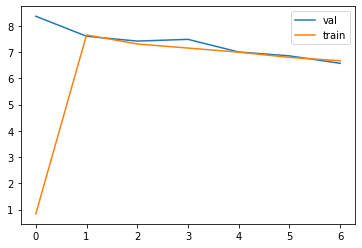


Iteration 700, loss = 6.4194
Checking accuracy on validation set
Got 549 / 1000 correct (54.90)


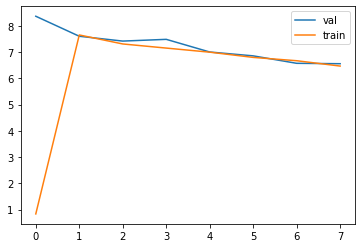


epoch  1
Iteration 0, loss = 6.3687
Checking accuracy on validation set
Got 584 / 1000 correct (58.40)


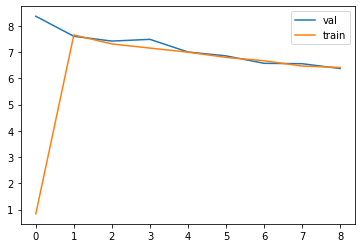


Iteration 100, loss = 5.8719
Checking accuracy on validation set
Got 596 / 1000 correct (59.60)


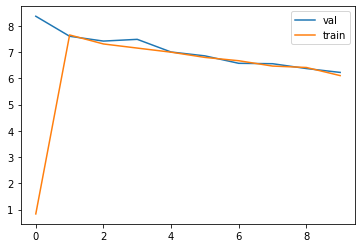


Iteration 200, loss = 6.0457
Checking accuracy on validation set
Got 577 / 1000 correct (57.70)


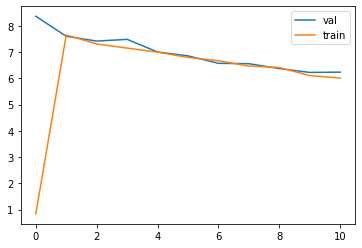


Iteration 300, loss = 6.1803
Checking accuracy on validation set
Got 578 / 1000 correct (57.80)


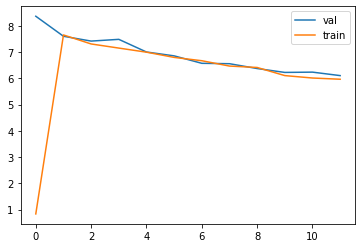


Iteration 400, loss = 5.8311
Checking accuracy on validation set
Got 627 / 1000 correct (62.70)


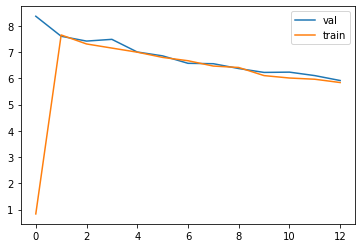


Iteration 500, loss = 5.7312
Checking accuracy on validation set
Got 636 / 1000 correct (63.60)


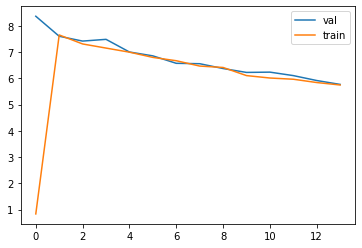


Iteration 600, loss = 5.3314
Checking accuracy on validation set
Got 652 / 1000 correct (65.20)


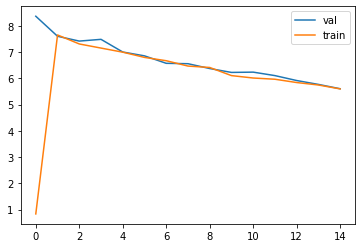


Iteration 700, loss = 5.4433
Checking accuracy on validation set
Got 654 / 1000 correct (65.40)


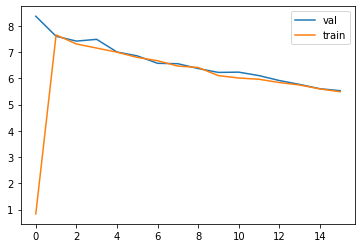


epoch  2
Iteration 0, loss = 5.3273
Checking accuracy on validation set
Got 631 / 1000 correct (63.10)


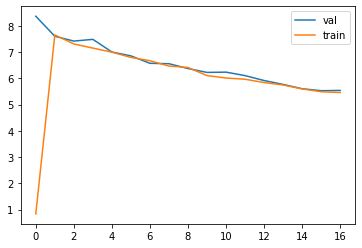


Iteration 100, loss = 5.6093
Checking accuracy on validation set
Got 623 / 1000 correct (62.30)


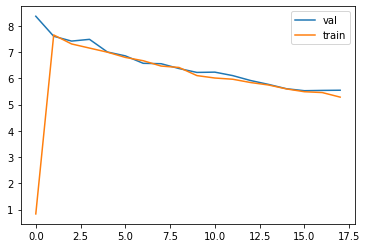


Iteration 200, loss = 5.2995
Checking accuracy on validation set
Got 686 / 1000 correct (68.60)


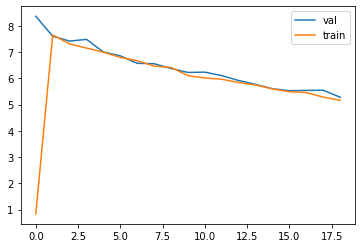


Iteration 300, loss = 5.0868
Checking accuracy on validation set
Got 602 / 1000 correct (60.20)


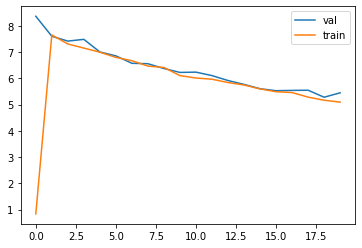


Iteration 400, loss = 5.0033
Checking accuracy on validation set
Got 630 / 1000 correct (63.00)


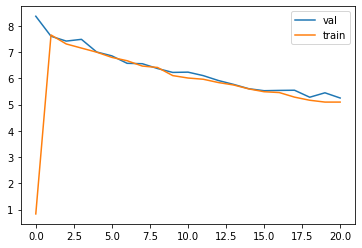


Iteration 500, loss = 4.9812
Checking accuracy on validation set
Got 664 / 1000 correct (66.40)


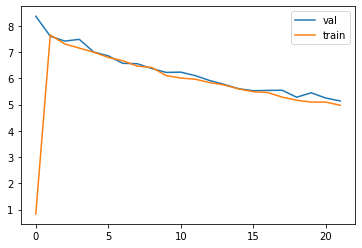


Iteration 600, loss = 4.7905
Checking accuracy on validation set
Got 624 / 1000 correct (62.40)


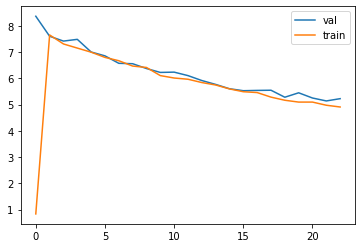


Iteration 700, loss = 4.7931
Checking accuracy on validation set
Got 723 / 1000 correct (72.30)


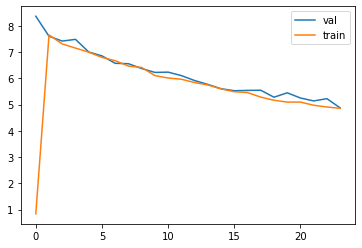


epoch  3
Iteration 0, loss = 4.7255
Checking accuracy on validation set
Got 728 / 1000 correct (72.80)


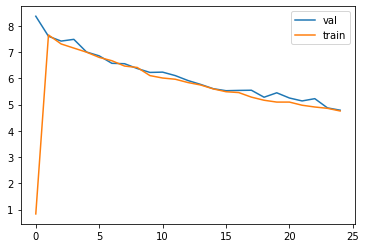


Iteration 100, loss = 4.4620
Checking accuracy on validation set
Got 741 / 1000 correct (74.10)


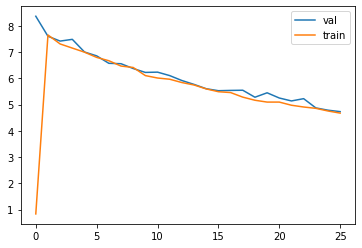


Iteration 200, loss = 4.8048
Checking accuracy on validation set
Got 684 / 1000 correct (68.40)


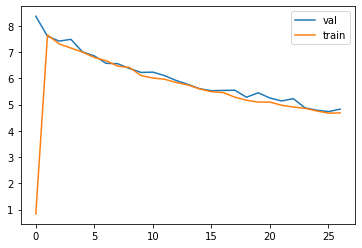


Iteration 300, loss = 4.5582
Checking accuracy on validation set
Got 708 / 1000 correct (70.80)


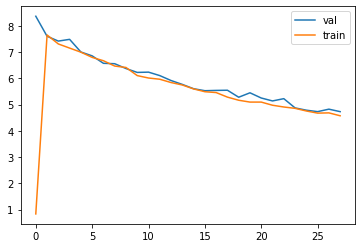


Iteration 400, loss = 4.4256
Checking accuracy on validation set
Got 712 / 1000 correct (71.20)


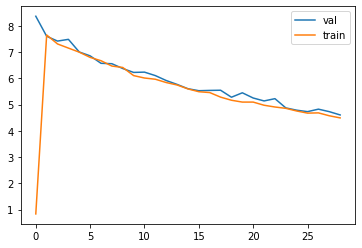


Iteration 500, loss = 4.4945
Checking accuracy on validation set
Got 640 / 1000 correct (64.00)


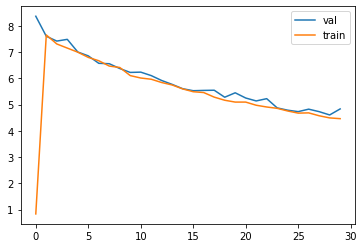


Iteration 600, loss = 4.5913
Checking accuracy on validation set
Got 683 / 1000 correct (68.30)


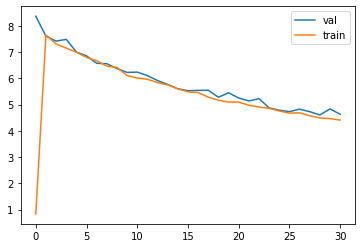


Iteration 700, loss = 4.3262
Checking accuracy on validation set
Got 723 / 1000 correct (72.30)


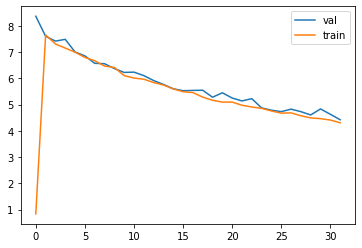


epoch  4
Iteration 0, loss = 4.2381
Checking accuracy on validation set
Got 689 / 1000 correct (68.90)


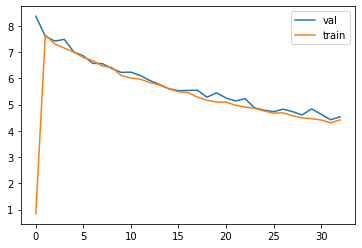


Iteration 100, loss = 4.0377
Checking accuracy on validation set
Got 711 / 1000 correct (71.10)


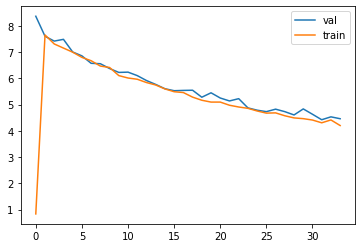


Iteration 200, loss = 4.1159
Checking accuracy on validation set
Got 614 / 1000 correct (61.40)


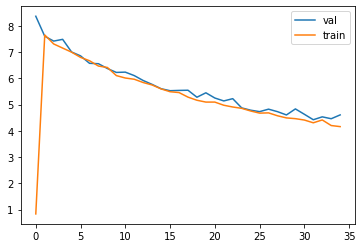


Iteration 300, loss = 4.1957
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)


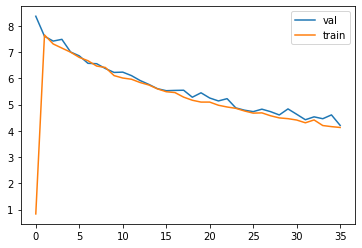


Iteration 400, loss = 3.9496
Checking accuracy on validation set
Got 740 / 1000 correct (74.00)


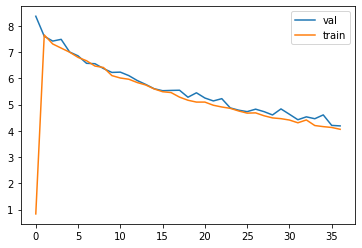


Iteration 500, loss = 4.2469
Checking accuracy on validation set
Got 678 / 1000 correct (67.80)


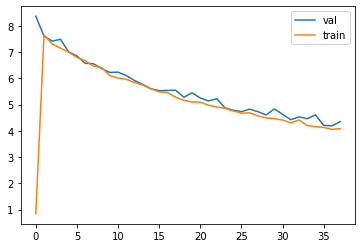


Iteration 600, loss = 3.5205
Checking accuracy on validation set
Got 697 / 1000 correct (69.70)


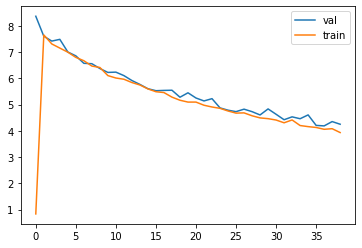


Iteration 700, loss = 4.1506
Checking accuracy on validation set
Got 740 / 1000 correct (74.00)


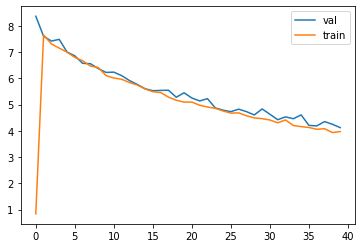


epoch  5
Iteration 0, loss = 3.8501
Checking accuracy on validation set
Got 766 / 1000 correct (76.60)


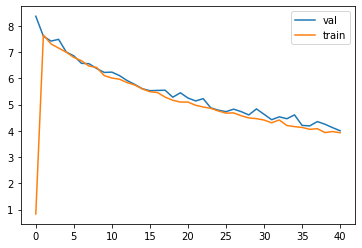


Iteration 100, loss = 3.9492
Checking accuracy on validation set
Got 749 / 1000 correct (74.90)


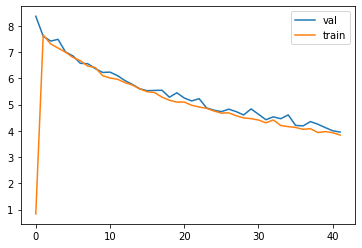


Iteration 200, loss = 3.7956
Checking accuracy on validation set
Got 735 / 1000 correct (73.50)


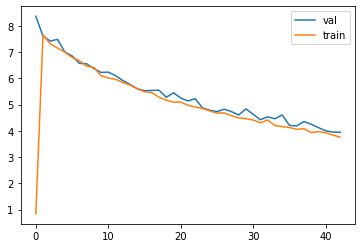


Iteration 300, loss = 3.7217
Checking accuracy on validation set
Got 723 / 1000 correct (72.30)


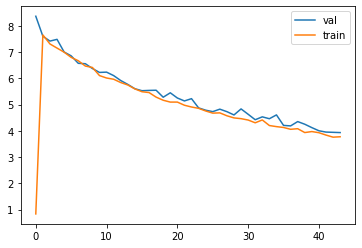


Iteration 400, loss = 3.6989
Checking accuracy on validation set
Got 755 / 1000 correct (75.50)


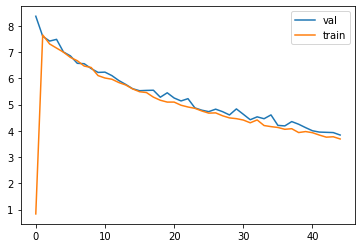


Iteration 500, loss = 3.8378
Checking accuracy on validation set
Got 766 / 1000 correct (76.60)


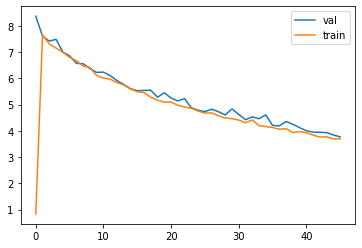


Iteration 600, loss = 3.7287
Checking accuracy on validation set
Got 720 / 1000 correct (72.00)


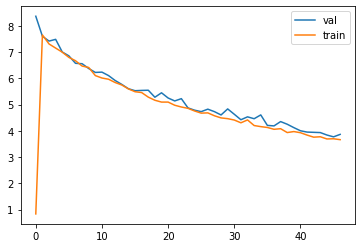


Iteration 700, loss = 3.5168
Checking accuracy on validation set
Got 720 / 1000 correct (72.00)


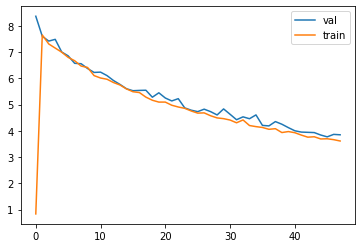


epoch  6
Iteration 0, loss = 3.3918
Checking accuracy on validation set
Got 739 / 1000 correct (73.90)


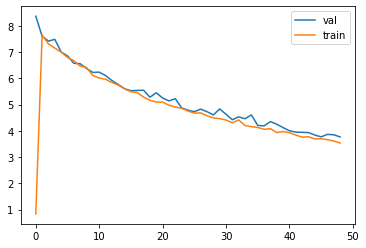


Iteration 100, loss = 3.5759
Checking accuracy on validation set
Got 746 / 1000 correct (74.60)


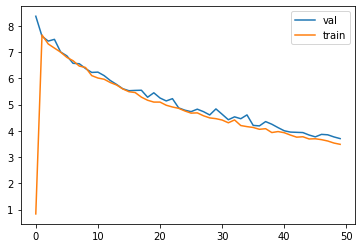


Iteration 200, loss = 3.5689
Checking accuracy on validation set
Got 764 / 1000 correct (76.40)


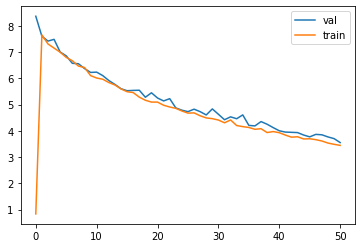


Iteration 300, loss = 3.2221
Checking accuracy on validation set
Got 737 / 1000 correct (73.70)


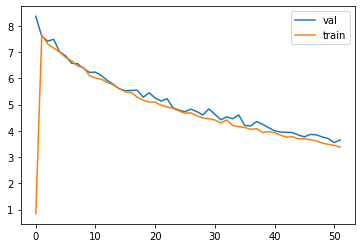


Iteration 400, loss = 3.3448
Checking accuracy on validation set
Got 736 / 1000 correct (73.60)


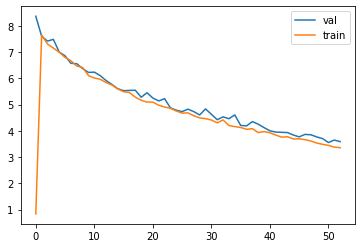


Iteration 500, loss = 3.2877
Checking accuracy on validation set
Got 732 / 1000 correct (73.20)


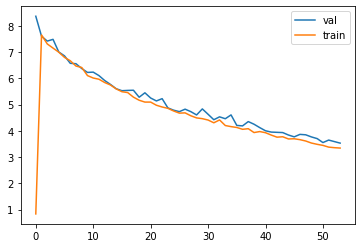


Iteration 600, loss = 3.4469
Checking accuracy on validation set
Got 751 / 1000 correct (75.10)


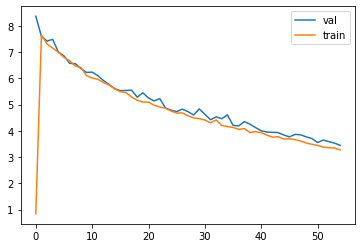


Iteration 700, loss = 3.4083
Checking accuracy on validation set
Got 734 / 1000 correct (73.40)


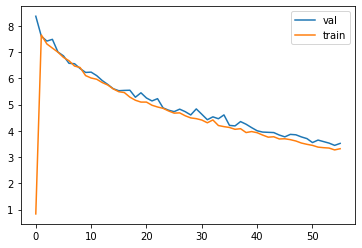


epoch  7
Iteration 0, loss = 3.2159
Checking accuracy on validation set
Got 745 / 1000 correct (74.50)


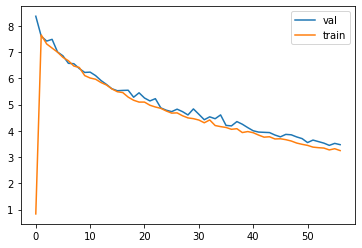


Iteration 100, loss = 3.1758
Checking accuracy on validation set
Got 657 / 1000 correct (65.70)


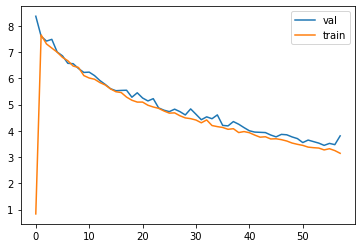


Iteration 200, loss = 3.1749
Checking accuracy on validation set
Got 685 / 1000 correct (68.50)


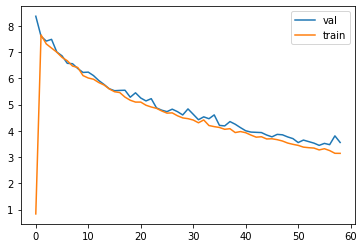


Iteration 300, loss = 3.1751
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)


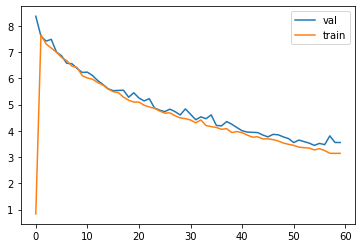


Iteration 400, loss = 3.1020
Checking accuracy on validation set
Got 657 / 1000 correct (65.70)


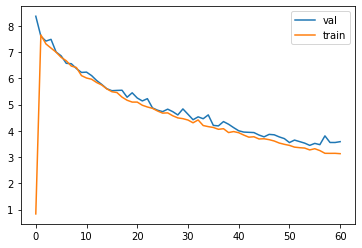


Iteration 500, loss = 2.9947
Checking accuracy on validation set
Got 707 / 1000 correct (70.70)


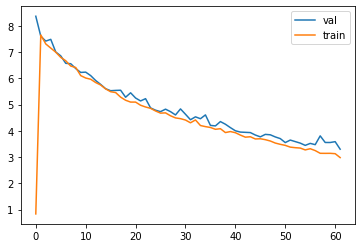


Iteration 600, loss = 3.0674
Checking accuracy on validation set
Got 538 / 1000 correct (53.80)


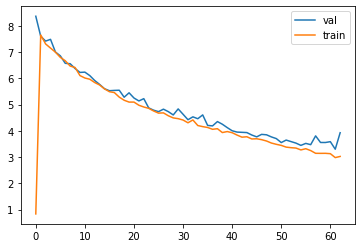


Iteration 700, loss = 3.0321
Checking accuracy on validation set
Got 594 / 1000 correct (59.40)


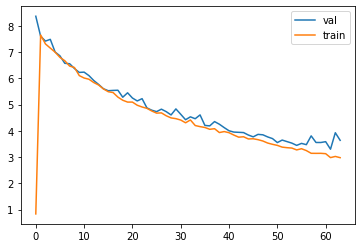


epoch  8
Iteration 0, loss = 2.9461
Checking accuracy on validation set
Got 652 / 1000 correct (65.20)


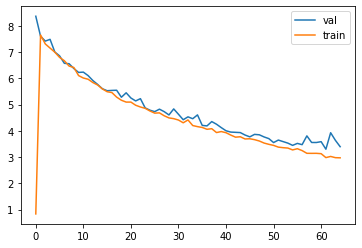


Iteration 100, loss = 3.0404
Checking accuracy on validation set
Got 644 / 1000 correct (64.40)


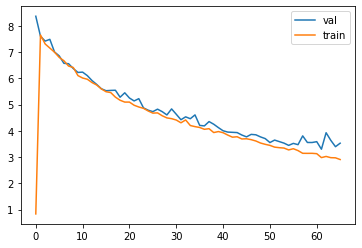


Iteration 200, loss = 2.8971
Checking accuracy on validation set
Got 378 / 1000 correct (37.80)


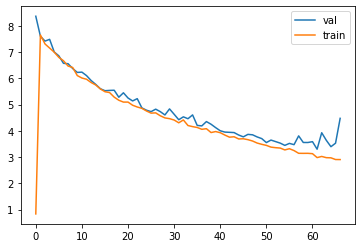


Iteration 300, loss = 2.5884
Checking accuracy on validation set
Got 580 / 1000 correct (58.00)


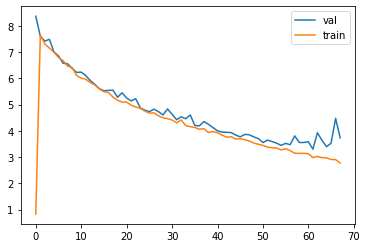


Iteration 400, loss = 2.9864
Checking accuracy on validation set
Got 641 / 1000 correct (64.10)


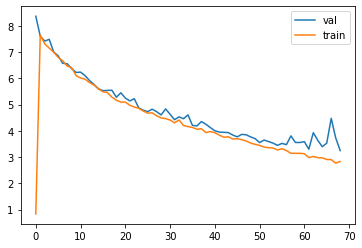


Iteration 500, loss = 2.7492
Checking accuracy on validation set
Got 632 / 1000 correct (63.20)


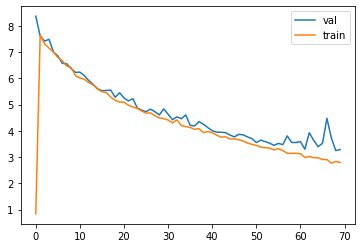


Iteration 600, loss = 2.7355
Checking accuracy on validation set
Got 577 / 1000 correct (57.70)


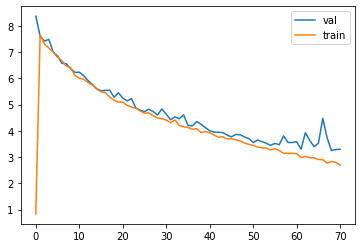


Iteration 700, loss = 2.6310
Checking accuracy on validation set
Got 411 / 1000 correct (41.10)


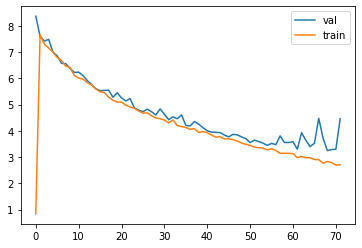


epoch  9
Iteration 0, loss = 2.4964
Checking accuracy on validation set
Got 701 / 1000 correct (70.10)


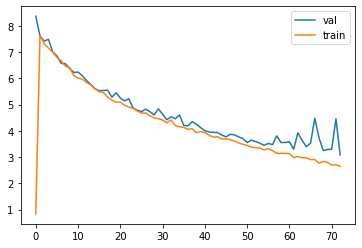


Iteration 100, loss = 2.5100
Checking accuracy on validation set
Got 645 / 1000 correct (64.50)


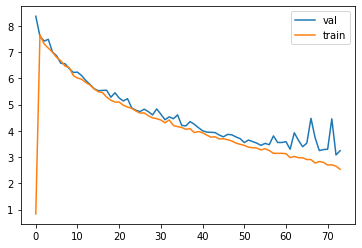


Iteration 200, loss = 2.6107
Checking accuracy on validation set
Got 511 / 1000 correct (51.10)


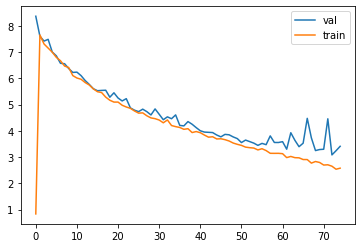


Iteration 300, loss = 2.2796
Checking accuracy on validation set
Got 301 / 1000 correct (30.10)


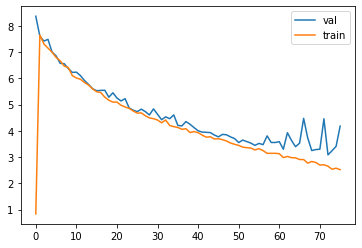


Iteration 400, loss = 2.3069
Checking accuracy on validation set
Got 323 / 1000 correct (32.30)


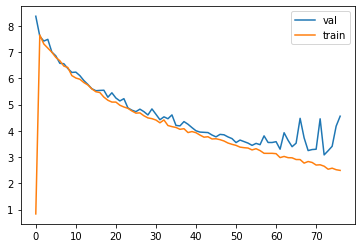


Iteration 500, loss = 2.5074
Checking accuracy on validation set
Got 375 / 1000 correct (37.50)


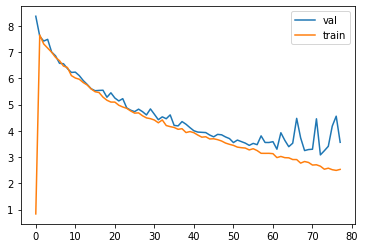


Iteration 600, loss = 2.2997
Checking accuracy on validation set
Got 753 / 1000 correct (75.30)


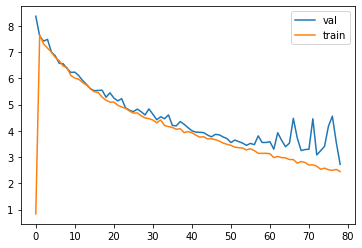


Iteration 700, loss = 2.7534
Checking accuracy on validation set
Got 274 / 1000 correct (27.40)


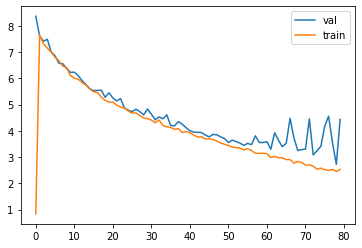


Wed Oct  7 10:33:46 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P0    56W / 250W |  14209MiB / 16280MiB |     79%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+------

In [62]:
# Another model
model = None
optimizer = None
k = 1
channel_1  = int(128)
channel_2  = int(128)
channel_3  = int(128)

channel_4  = int(256)
channel_5  = int(256)
channel_6  = int(256)

channel_7  = int(256)
channel_8  = int(256)
channel_9  = int(256)

channel_10 = int(512)
channel_11 = int(512)
channel_12 = int(512)

channel_13 = int(512)
channel_14 = int(512)
channel_15 = int(1024)

channel_16 = int(1024)

# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
def flatten(x):
    N = x.shape[0] # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image
    
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3,         out_channels=channel_1, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_1),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_2, out_channels=channel_3, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_3),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_3, out_channels=channel_4, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_4),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.LeakyReLU(),


    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.LeakyReLU(),


    nn.Conv2d(in_channels=channel_5, out_channels=channel_6, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_6),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_6, out_channels=channel_7, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_7),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_7, out_channels=channel_8, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_8),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_8, out_channels=channel_9, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_9),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_9, out_channels=channel_10, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_10),
    nn.LeakyReLU(),
    
    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_11, out_channels=channel_12, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_12),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_12, out_channels=channel_13, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_13),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_14, out_channels=channel_15, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_15),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_15, out_channels=channel_16, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_16),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    Flatten(),
    nn.Linear(channel_16, 10)
)

# you can use Nesterov momentum in optim.SGD
learning_rate = 1e-4

optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=0.01)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

# You should get at least 70% accuracy
!nvidia-smi
train_part(model, optimizer, epochs=10, ld=1e-2)
!nvidia-smi

In [63]:
best_model = model
check_accuracy_part34(loader_test, best_model)

Checking accuracy on test set
Got 5863 / 10000 correct (58.63)


1.4066237514945352

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Wed Oct  7 11:37:19 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P0    33W / 250W |  14243MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+---------------------

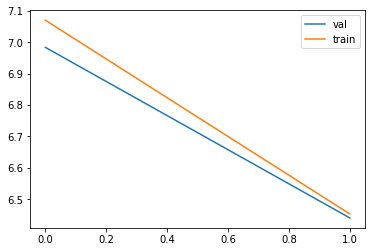

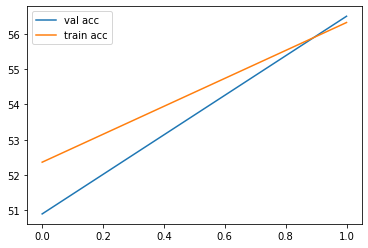


epoch  1
Iteration 0, loss = 6.2917
Checking accuracy on validation set
Got 580 / 1000 correct (58.00)
Checking accuracy on train set
Got 28702 / 49000 correct (58.58)


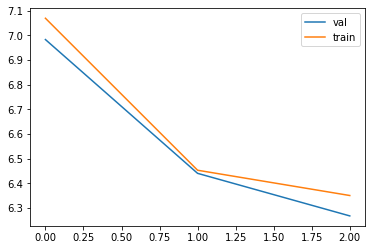

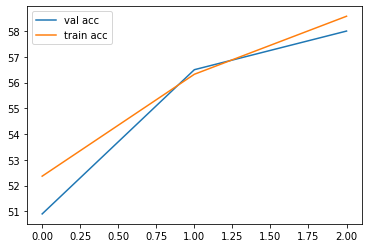


Iteration 350, loss = 5.6586
Checking accuracy on validation set
Got 627 / 1000 correct (62.70)
Checking accuracy on train set
Got 31432 / 49000 correct (64.15)


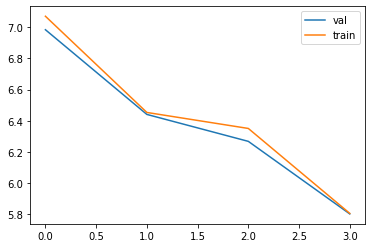

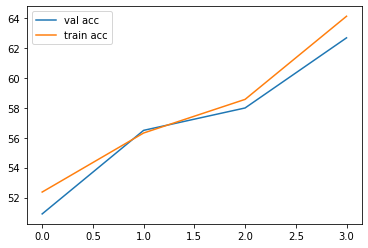


Iteration 700, loss = 5.3169
Checking accuracy on validation set
Got 624 / 1000 correct (62.40)
Checking accuracy on train set
Got 32457 / 49000 correct (66.24)


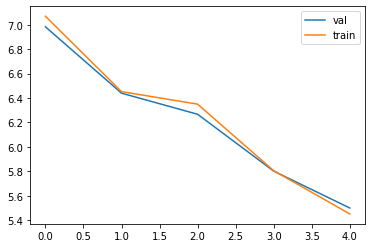

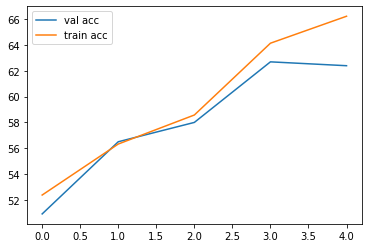


epoch  2
Iteration 0, loss = 4.9662
Checking accuracy on validation set
Got 696 / 1000 correct (69.60)
Checking accuracy on train set
Got 35041 / 49000 correct (71.51)


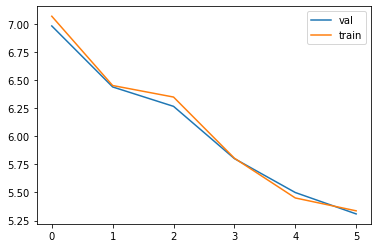

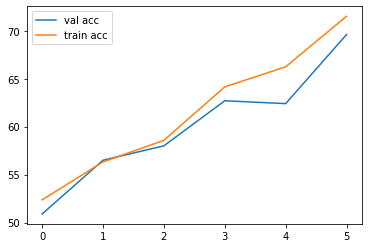


Iteration 350, loss = 5.1727
Checking accuracy on validation set
Got 679 / 1000 correct (67.90)
Checking accuracy on train set
Got 33893 / 49000 correct (69.17)


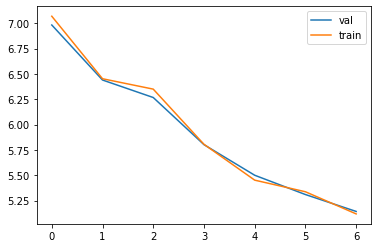

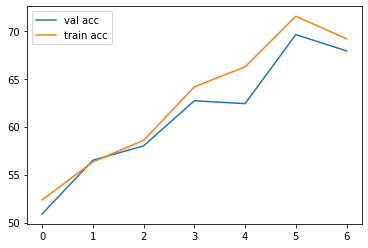


Iteration 700, loss = 4.6476
Checking accuracy on validation set
Got 678 / 1000 correct (67.80)
Checking accuracy on train set
Got 35078 / 49000 correct (71.59)


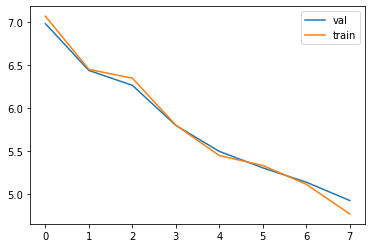

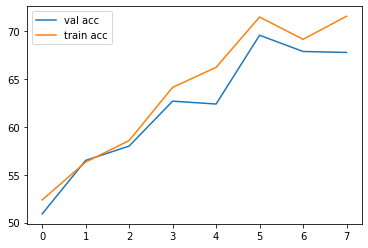


epoch  3
Iteration 0, loss = 4.5747
Checking accuracy on validation set
Got 682 / 1000 correct (68.20)
Checking accuracy on train set
Got 33753 / 49000 correct (68.88)


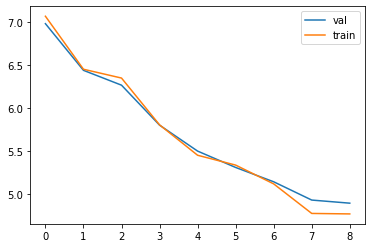

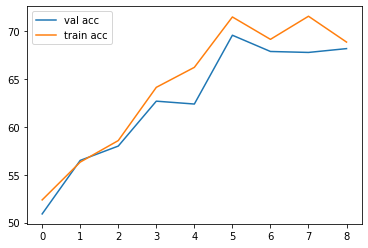


Iteration 350, loss = 4.4497
Checking accuracy on validation set
Got 752 / 1000 correct (75.20)
Checking accuracy on train set
Got 37191 / 49000 correct (75.90)


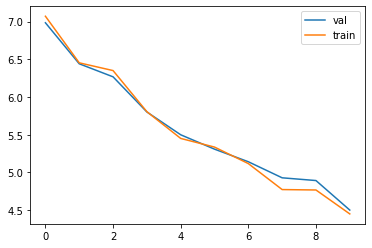

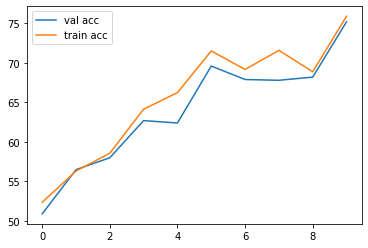


Iteration 700, loss = 4.2621
Checking accuracy on validation set
Got 708 / 1000 correct (70.80)
Checking accuracy on train set
Got 35850 / 49000 correct (73.16)


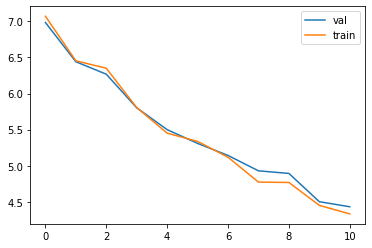

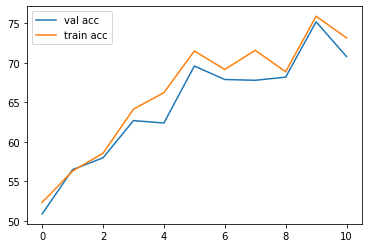


epoch  4
Iteration 0, loss = 4.2342
Checking accuracy on validation set
Got 664 / 1000 correct (66.40)
Checking accuracy on train set
Got 34665 / 49000 correct (70.74)


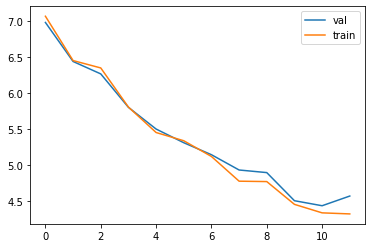

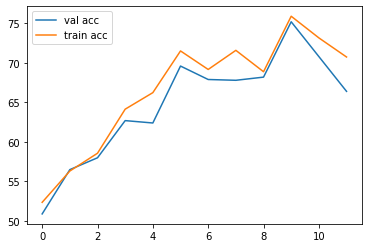


Iteration 350, loss = 3.9414
Checking accuracy on validation set
Got 737 / 1000 correct (73.70)
Checking accuracy on train set
Got 37061 / 49000 correct (75.63)


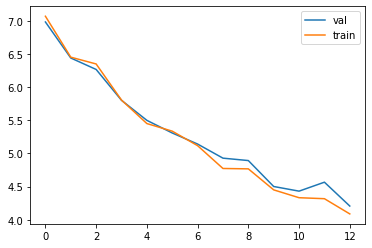

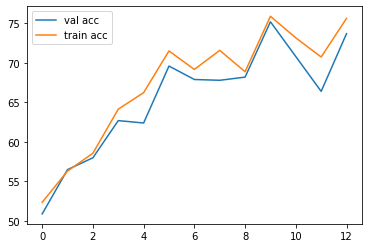


Iteration 700, loss = 3.8448
Checking accuracy on validation set
Got 684 / 1000 correct (68.40)
Checking accuracy on train set
Got 35170 / 49000 correct (71.78)


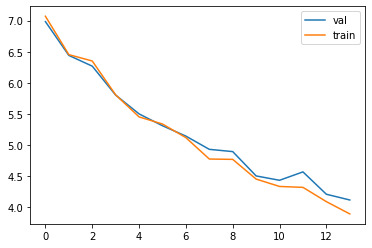

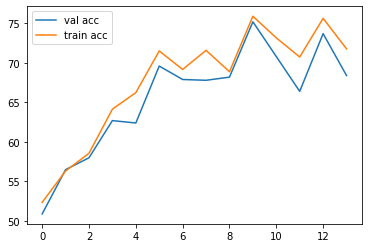


epoch  5
Iteration 0, loss = 3.8898
Checking accuracy on validation set
Got 756 / 1000 correct (75.60)
Checking accuracy on train set
Got 38113 / 49000 correct (77.78)


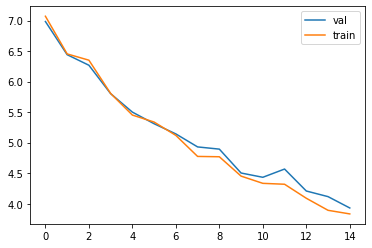

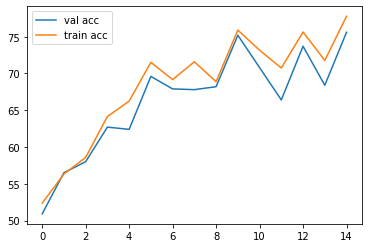


Iteration 350, loss = 3.6337
Checking accuracy on validation set
Got 790 / 1000 correct (79.00)
Checking accuracy on train set
Got 40273 / 49000 correct (82.19)


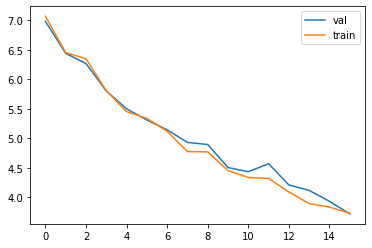

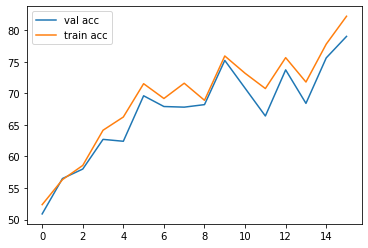


Iteration 700, loss = 3.4046
Checking accuracy on validation set
Got 740 / 1000 correct (74.00)
Checking accuracy on train set
Got 38914 / 49000 correct (79.42)


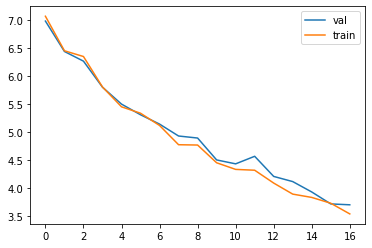

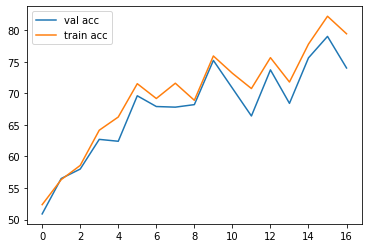


epoch  6
Iteration 0, loss = 3.4531
Checking accuracy on validation set
Got 723 / 1000 correct (72.30)
Checking accuracy on train set
Got 37415 / 49000 correct (76.36)


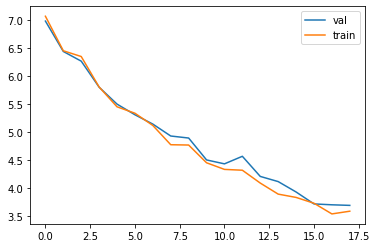

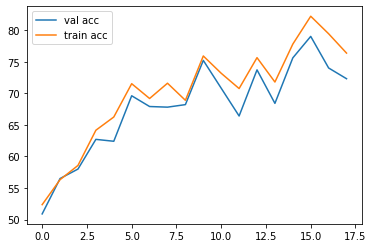


Iteration 350, loss = 3.2823
Checking accuracy on validation set
Got 713 / 1000 correct (71.30)
Checking accuracy on train set
Got 36603 / 49000 correct (74.70)


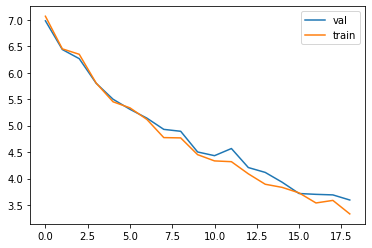

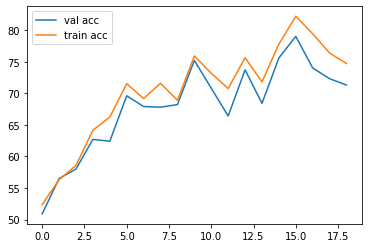


Iteration 700, loss = 3.3180
Checking accuracy on validation set
Got 744 / 1000 correct (74.40)
Checking accuracy on train set
Got 38796 / 49000 correct (79.18)


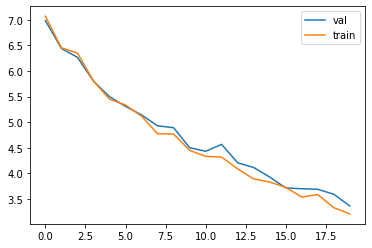

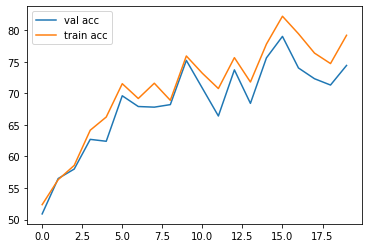


epoch  7
Iteration 0, loss = 3.2673
Checking accuracy on validation set
Got 757 / 1000 correct (75.70)
Checking accuracy on train set
Got 38162 / 49000 correct (77.88)


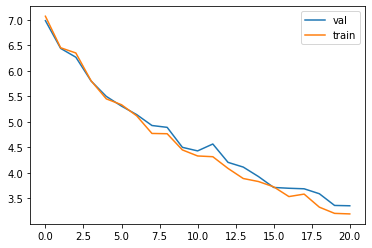

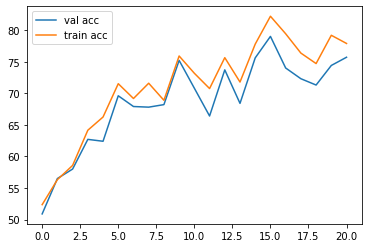


Iteration 350, loss = 3.1001
Checking accuracy on validation set
Got 708 / 1000 correct (70.80)
Checking accuracy on train set
Got 36986 / 49000 correct (75.48)


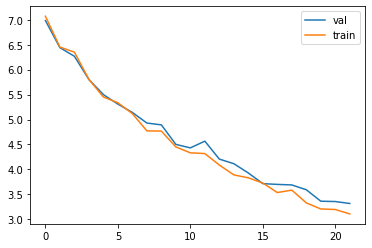

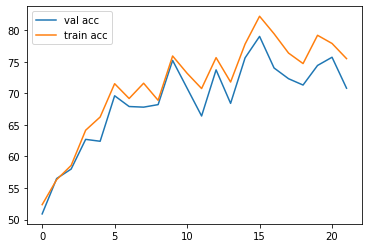


Iteration 700, loss = 2.7544
Checking accuracy on validation set
Got 764 / 1000 correct (76.40)
Checking accuracy on train set
Got 38848 / 49000 correct (79.28)


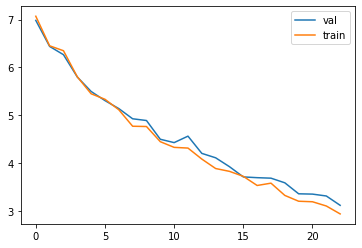

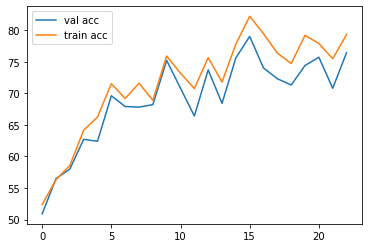


epoch  8
Iteration 0, loss = 2.8496
Checking accuracy on validation set
Got 744 / 1000 correct (74.40)
Checking accuracy on train set
Got 38495 / 49000 correct (78.56)


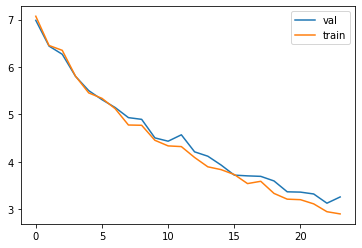

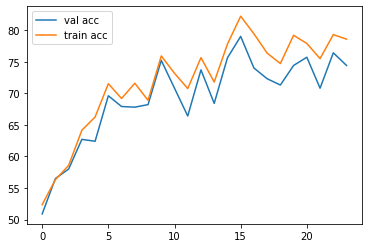


Iteration 350, loss = 2.6566
Checking accuracy on validation set
Got 658 / 1000 correct (65.80)
Checking accuracy on train set
Got 33460 / 49000 correct (68.29)


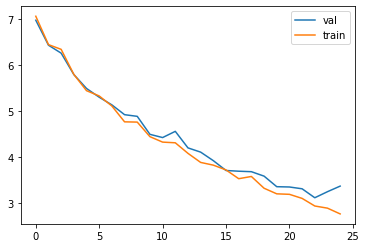

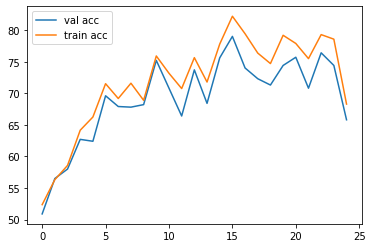


Iteration 700, loss = 2.7805
Checking accuracy on validation set
Got 686 / 1000 correct (68.60)
Checking accuracy on train set
Got 35602 / 49000 correct (72.66)


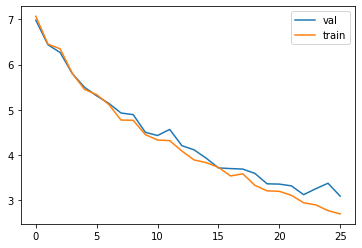

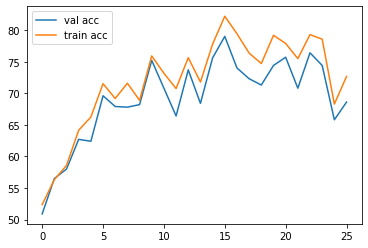


epoch  9
Iteration 0, loss = 2.4693
Checking accuracy on validation set
Got 352 / 1000 correct (35.20)
Checking accuracy on train set
Got 17074 / 49000 correct (34.84)


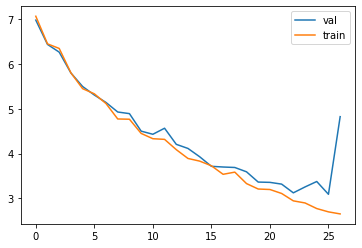

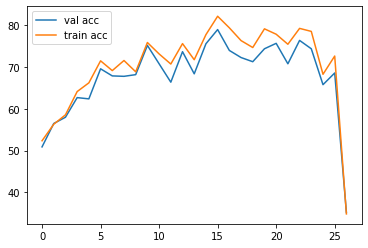


Iteration 350, loss = 2.4159
Checking accuracy on validation set
Got 699 / 1000 correct (69.90)
Checking accuracy on train set
Got 35448 / 49000 correct (72.34)


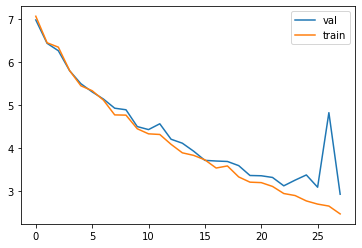

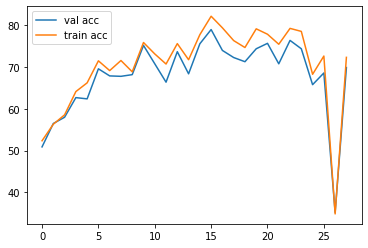


Iteration 700, loss = 2.3209
Checking accuracy on validation set
Got 735 / 1000 correct (73.50)
Checking accuracy on train set
Got 38920 / 49000 correct (79.43)


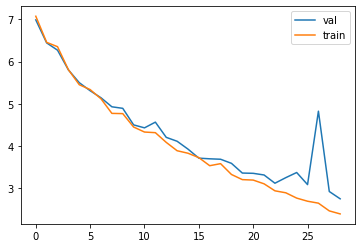

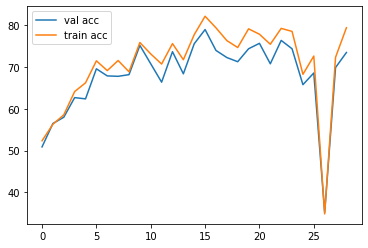


epoch  10
Iteration 0, loss = 2.3291
Checking accuracy on validation set
Got 676 / 1000 correct (67.60)
Checking accuracy on train set
Got 35738 / 49000 correct (72.93)


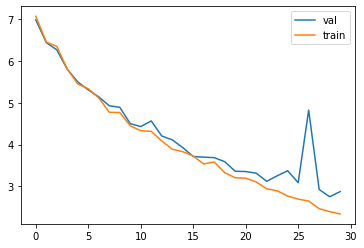

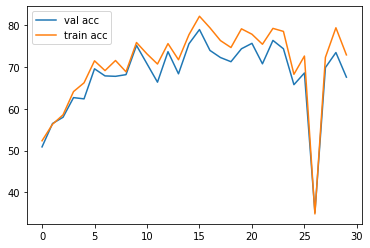


Iteration 350, loss = 2.6067
Checking accuracy on validation set
Got 542 / 1000 correct (54.20)
Checking accuracy on train set
Got 26449 / 49000 correct (53.98)


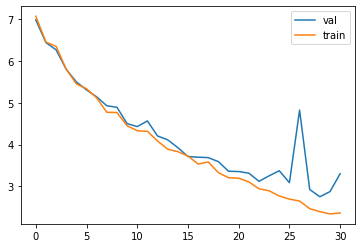

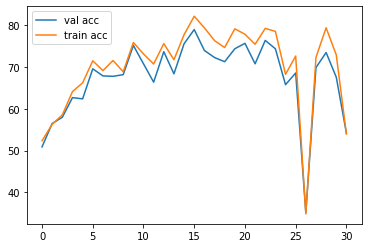


Iteration 700, loss = 2.1988
Checking accuracy on validation set
Got 645 / 1000 correct (64.50)
Checking accuracy on train set
Got 33617 / 49000 correct (68.61)


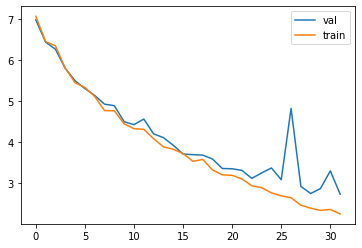

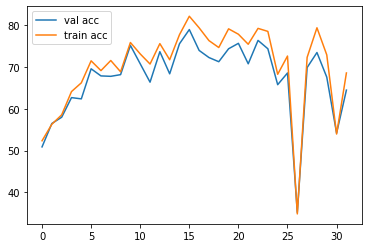


epoch  11
Iteration 0, loss = 2.0351
Checking accuracy on validation set
Got 654 / 1000 correct (65.40)
Checking accuracy on train set
Got 33407 / 49000 correct (68.18)


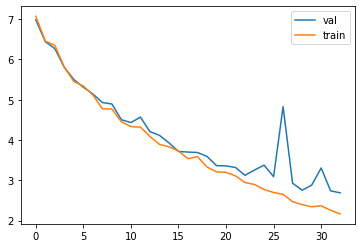

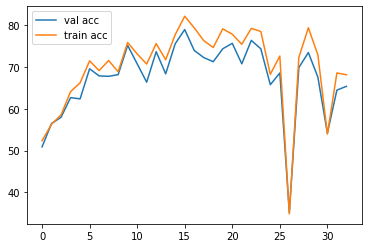


Iteration 350, loss = 1.9561
Checking accuracy on validation set
Got 652 / 1000 correct (65.20)
Checking accuracy on train set
Got 34869 / 49000 correct (71.16)


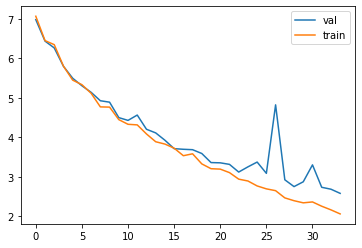

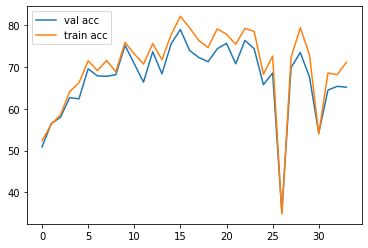


Iteration 700, loss = 1.9844
Checking accuracy on validation set
Got 766 / 1000 correct (76.60)
Checking accuracy on train set
Got 40867 / 49000 correct (83.40)


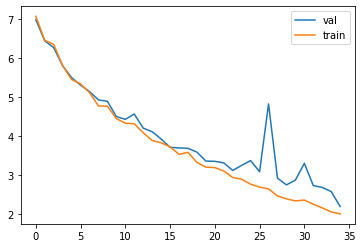

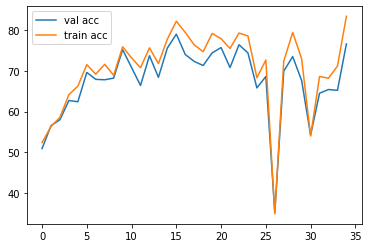


epoch  12
Iteration 0, loss = 1.8319
Checking accuracy on validation set
Got 564 / 1000 correct (56.40)
Checking accuracy on train set
Got 28940 / 49000 correct (59.06)


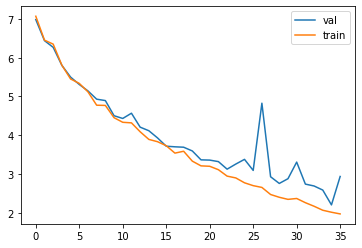

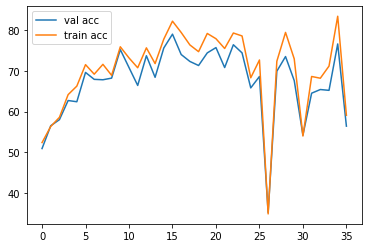


Iteration 350, loss = 1.8779
Checking accuracy on validation set
Got 733 / 1000 correct (73.30)
Checking accuracy on train set
Got 38029 / 49000 correct (77.61)


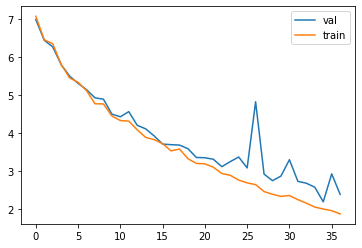

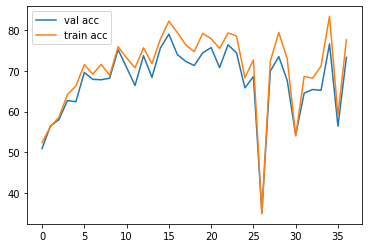


Iteration 700, loss = 1.8138
Checking accuracy on validation set
Got 789 / 1000 correct (78.90)
Checking accuracy on train set
Got 40804 / 49000 correct (83.27)


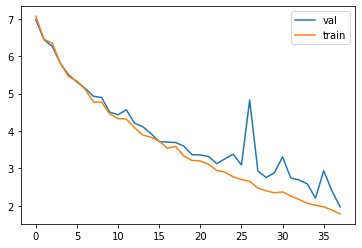

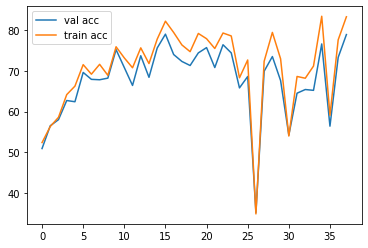


epoch  13
Iteration 0, loss = 1.7106
Checking accuracy on validation set
Got 642 / 1000 correct (64.20)
Checking accuracy on train set
Got 33774 / 49000 correct (68.93)


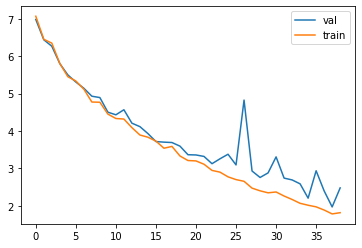

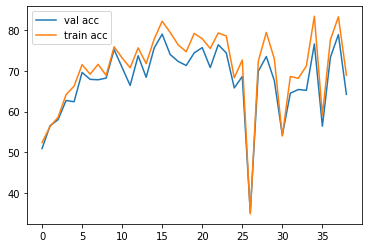


Iteration 350, loss = 1.5650
Checking accuracy on validation set
Got 754 / 1000 correct (75.40)
Checking accuracy on train set
Got 37899 / 49000 correct (77.34)


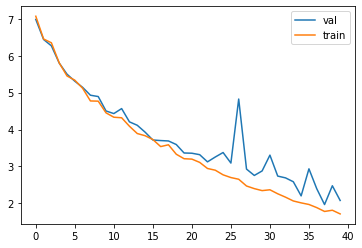

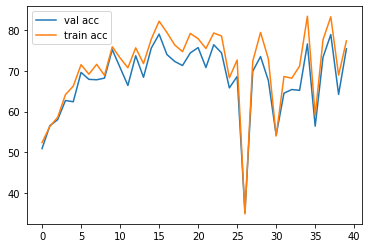


Iteration 700, loss = 1.5784
Checking accuracy on validation set
Got 722 / 1000 correct (72.20)
Checking accuracy on train set
Got 37468 / 49000 correct (76.47)


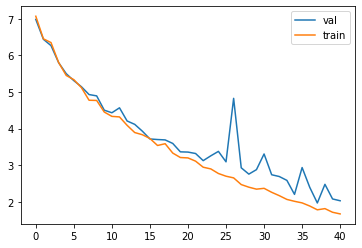

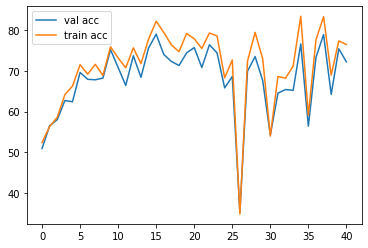


epoch  14
Iteration 0, loss = 1.5834
Checking accuracy on validation set
Got 760 / 1000 correct (76.00)
Checking accuracy on train set
Got 40768 / 49000 correct (83.20)


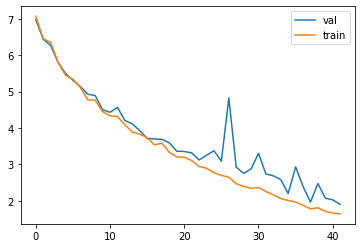

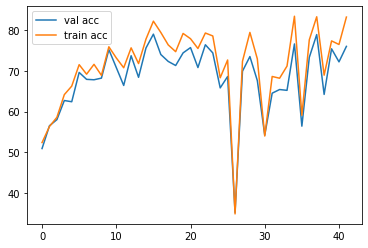


Iteration 350, loss = 1.2764
Checking accuracy on validation set
Got 788 / 1000 correct (78.80)
Checking accuracy on train set
Got 40516 / 49000 correct (82.69)


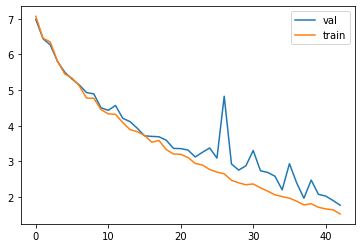

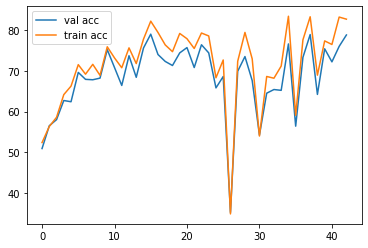


Iteration 700, loss = 1.5620
Checking accuracy on validation set
Got 784 / 1000 correct (78.40)
Checking accuracy on train set
Got 41081 / 49000 correct (83.84)


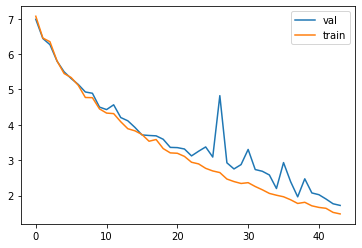

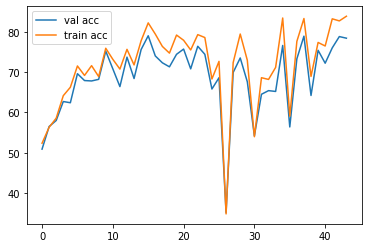


epoch  15
Iteration 0, loss = 1.4056
Checking accuracy on validation set
Got 792 / 1000 correct (79.20)
Checking accuracy on train set
Got 41579 / 49000 correct (84.86)


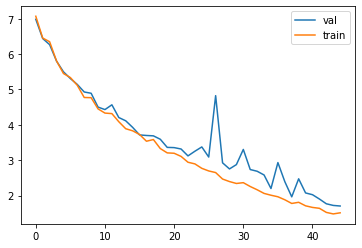

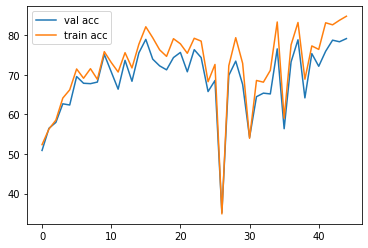


Iteration 350, loss = 1.4432
Checking accuracy on validation set
Got 761 / 1000 correct (76.10)
Checking accuracy on train set
Got 40855 / 49000 correct (83.38)


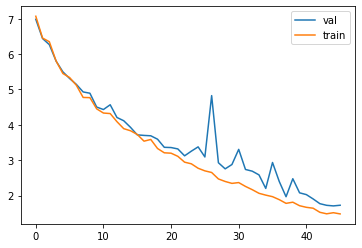

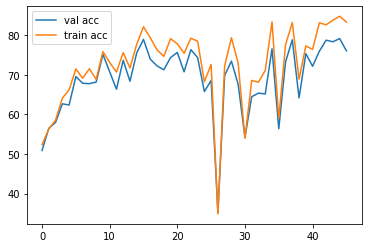


Iteration 700, loss = 1.2758
Checking accuracy on validation set
Got 826 / 1000 correct (82.60)
Checking accuracy on train set
Got 43106 / 49000 correct (87.97)


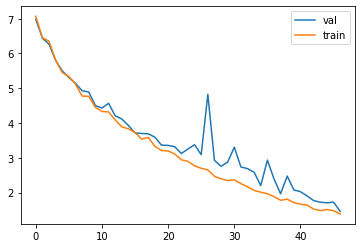

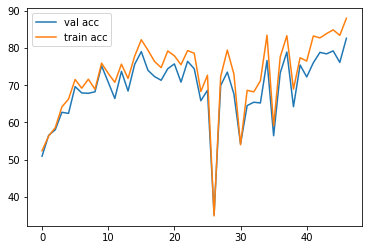


epoch  16
Iteration 0, loss = 1.3314
Checking accuracy on validation set
Got 800 / 1000 correct (80.00)
Checking accuracy on train set
Got 42178 / 49000 correct (86.08)


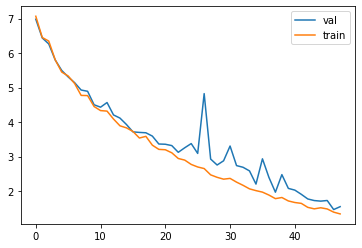

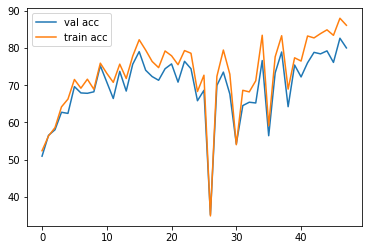


Iteration 350, loss = 1.1721
Checking accuracy on validation set
Got 773 / 1000 correct (77.30)
Checking accuracy on train set
Got 40609 / 49000 correct (82.88)


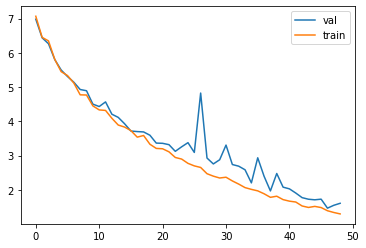

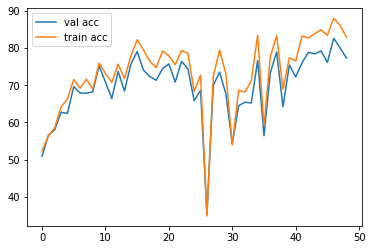


Iteration 700, loss = 1.0501
Checking accuracy on validation set
Got 842 / 1000 correct (84.20)
Checking accuracy on train set
Got 44566 / 49000 correct (90.95)


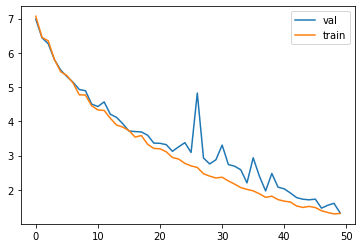

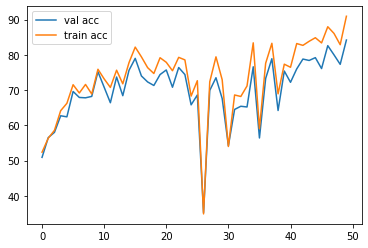


epoch  17
Iteration 0, loss = 1.2622
Checking accuracy on validation set
Got 811 / 1000 correct (81.10)
Checking accuracy on train set
Got 43146 / 49000 correct (88.05)


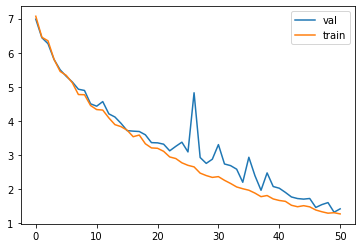

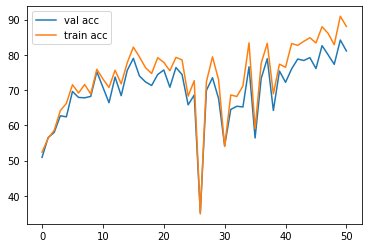


Iteration 350, loss = 1.1780
Checking accuracy on validation set
Got 815 / 1000 correct (81.50)
Checking accuracy on train set
Got 43399 / 49000 correct (88.57)


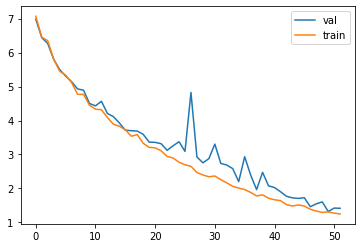

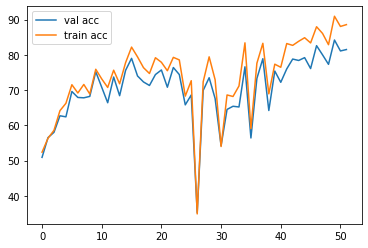


Iteration 700, loss = 1.4578
Checking accuracy on validation set
Got 800 / 1000 correct (80.00)
Checking accuracy on train set
Got 42264 / 49000 correct (86.25)


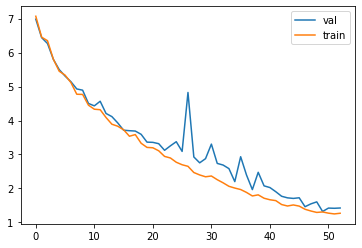

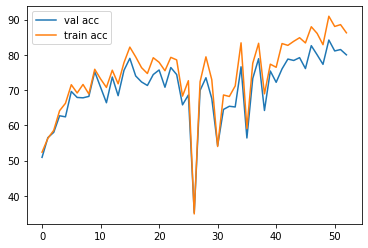


epoch  18
Iteration 0, loss = 1.2803
Checking accuracy on validation set
Got 824 / 1000 correct (82.40)
Checking accuracy on train set
Got 43997 / 49000 correct (89.79)


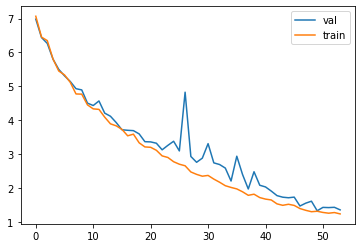

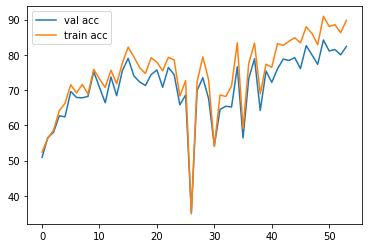


Iteration 350, loss = 1.4210
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)
Checking accuracy on train set
Got 42152 / 49000 correct (86.02)


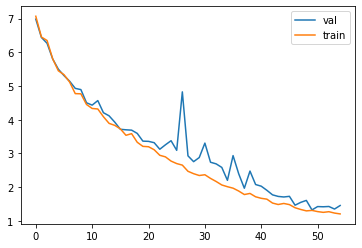

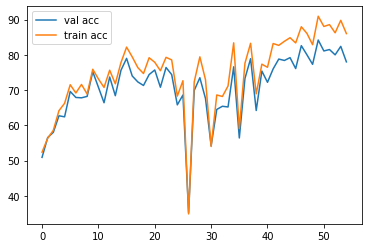


Iteration 700, loss = 1.2460
Checking accuracy on validation set
Got 831 / 1000 correct (83.10)
Checking accuracy on train set
Got 44596 / 49000 correct (91.01)


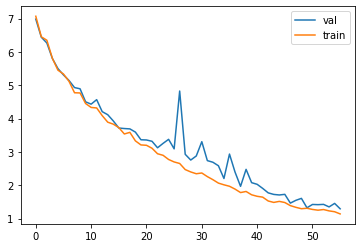

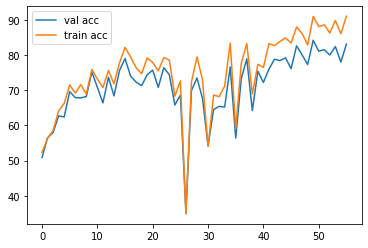


epoch  19
Iteration 0, loss = 1.1287
Checking accuracy on validation set
Got 826 / 1000 correct (82.60)
Checking accuracy on train set
Got 44233 / 49000 correct (90.27)


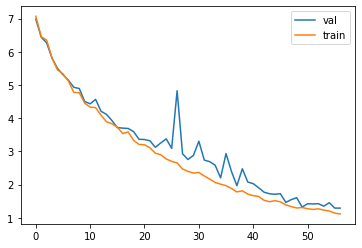

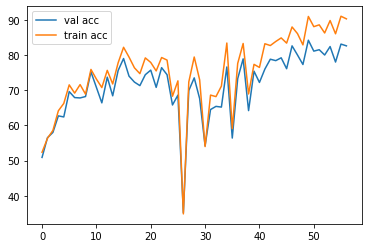


Iteration 350, loss = 1.1243
Checking accuracy on validation set
Got 811 / 1000 correct (81.10)
Checking accuracy on train set
Got 43315 / 49000 correct (88.40)


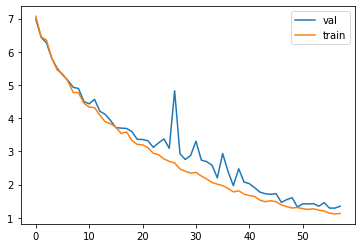

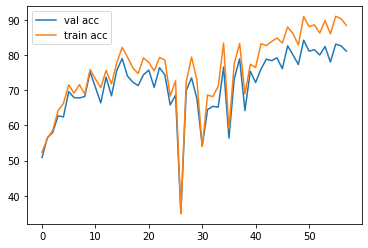


Iteration 700, loss = 1.1559
Checking accuracy on validation set
Got 823 / 1000 correct (82.30)
Checking accuracy on train set
Got 43530 / 49000 correct (88.84)


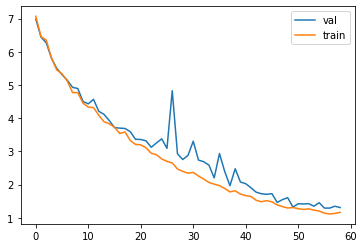

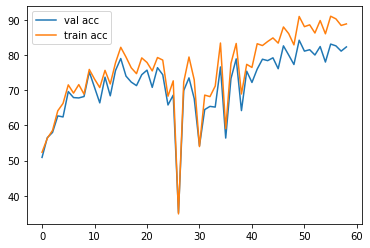


Wed Oct  7 12:24:31 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   73C    P0    57W / 250W |  14243MiB / 16280MiB |     92%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+------

(0.6252834620369467, 81.02000000000001)

In [79]:
# Another model

import torch
# assert '.'.join(torch.__version__.split('.')[:2]) == '1.4'
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler

import torchvision.datasets as dset
import torchvision.transforms as T

import numpy as np

NUM_TRAIN = 49000

# The torchvision.transforms package provides tools for preprocessing data
# and for performing data augmentation; here we set up a transform to
# preprocess the data by subtracting the mean RGB value and dividing by the
# standard deviation of each RGB value; we've hardcoded the mean and std.
transform = T.Compose([
                T.ToTensor(),
                T.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
            ])

# We set up a Dataset object for each split (train / val / test); Datasets load
# training examples one at a time, so we wrap each Dataset in a DataLoader which
# iterates through the Dataset and forms minibatches. We divide the CIFAR-10
# training set into train and val sets by passing a Sampler object to the
# DataLoader telling how it should sample from the underlying Dataset.
cifar10_train = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                             transform=transform)
loader_train = DataLoader(cifar10_train, batch_size=64, 
                          sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN)))

cifar10_val = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                           transform=transform)
loader_val = DataLoader(cifar10_val, batch_size=64, 
                        sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN, 50000)))

cifar10_test = dset.CIFAR10('./cs231n/datasets', train=False, download=True, 
                            transform=transform)
loader_test = DataLoader(cifar10_test, batch_size=64)
!nvidia-smi

USE_GPU = True

dtype = torch.float32 # we will be using float throughout this tutorial

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

# Constant to control how frequently we print train loss

print('using device:', device)
!nvidia-smi

import matplotlib.pyplot as plt
from statistics import mean 
import torch.nn.functional as F  # useful stateless functions

def check_accuracy_part34(loader, model, train_part=False):
    if train_part==False:
      if loader.dataset.train:
          print('Checking accuracy on validation set')
      else:
          print('Checking accuracy on test set')   
    else:
       print('Checking accuracy on train set')
    num_correct = 0
    num_samples = 0
    model.eval()  # set model to evaluation mode

    batch_loss = []
    with torch.no_grad():
        for x, y in loader:
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)
            scores = model(x)
            _, preds = scores.max(1)
            num_correct += (preds == y).sum()
            num_samples += preds.size(0)
            # print(nn.CrossEntropyLoss()(scores, y).type)
            # print(nn.CrossEntropyLoss()(scores, y))

            batch_loss.append(nn.CrossEntropyLoss()(scores, y).item())

        acc = float(num_correct) / num_samples

        print('Got %d / %d correct (%.2f)' % (num_correct, num_samples, 100 * acc))
        return sum(batch_loss)/len(batch_loss), 100 * acc, 
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

def train_part(model, optimizer, epochs=1, ld=0.01, print_every = 100):
    """
    Train a model on CIFAR-10 using the PyTorch Module API.
    
    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model
    - epochs: (Optional) A Python integer giving the number of epochs to train for
    
    Returns: Nothing, but prints model accuracies during training.
    """

    trainning_loss = []
    val_loss = []
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    ave_trainning_loss = 0.0

    train_acc_hist = []
    val_acc_hist  = []
    for e in range(epochs):
        print("epoch ", e)
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            loss = nn.CrossEntropyLoss()(scores, y)

            l2_reg = 0.0
            for param in model.parameters():
                l2_reg += torch.norm(param, 2)
            loss += ld*l2_reg

            ave_trainning_loss = loss.item()*0.1 + 0.9*ave_trainning_loss

            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            # This is the backwards pass: compute the gradient of the loss with
            # respect to each  parameter of the model.
            loss.backward()


            # Actually update the parameters of the model using the gradients
            # computed by the backwards pass.
            optimizer.step()

            if t % print_every == 0:
                print('Iteration %d, loss = %.4f' % (t, loss.item()))
                # print('Valid loss = ', val_loss)
                val_loss_, val_acc = check_accuracy_part34(loader_val, model)
                _, train_acc  = check_accuracy_part34(loader_train, model, train_part=True)
                trainning_loss.append(ave_trainning_loss)
                val_loss.append(val_loss_ + ld*l2_reg)

                train_acc_hist.append(train_acc)
                val_acc_hist.append(val_acc)

                # print(trainning_loss)
                # print(val_loss)
                if len(val_loss) > 2:
                  plt.plot(list(range(len(val_loss)-1)), val_loss[1:], label='val')
                  plt.plot(list(range(len(trainning_loss)-1)), trainning_loss[1:], label='train')
                  plt.legend()
                  plt.show()

                  plt.plot(list(range(len(val_acc_hist)-1)), val_acc_hist[1:], label='val acc')
                  plt.plot(list(range(len(train_acc_hist)-1)), train_acc_hist[1:], label='train acc')
                  plt.legend()
                  plt.show()
                print()


model = None
optimizer = None
k = 1
channel_1  = int(128)
channel_2  = int(128)
channel_3  = int(128)

channel_4  = int(256)
channel_5  = int(256)
channel_6  = int(256)

channel_7  = int(256)
channel_8  = int(256)
channel_9  = int(256)

channel_10 = int(512)
channel_11 = int(512)
channel_12 = int(512)

channel_13 = int(512)
channel_14 = int(512)
channel_15 = int(1024)

channel_16 = int(1024)

# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
def flatten(x):
    N = x.shape[0] # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image
    
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3,         out_channels=channel_1, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_1),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_2, out_channels=channel_3, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_3),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_3, out_channels=channel_4, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_4),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.LeakyReLU(),


    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.LeakyReLU(),


    nn.Conv2d(in_channels=channel_5, out_channels=channel_6, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_6),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_6, out_channels=channel_7, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_7),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_7, out_channels=channel_8, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_8),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_8, out_channels=channel_9, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_9),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_9, out_channels=channel_10, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_10),
    nn.LeakyReLU(),
    
    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_11, out_channels=channel_12, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_12),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_12, out_channels=channel_13, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_13),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_14, out_channels=channel_15, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_15),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_15, out_channels=channel_16, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_16),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    Flatten(),
    nn.Linear(channel_16, 10)
)

# you can use Nesterov momentum in optim.SGD
learning_rate = 1e-4

optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=0.01)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

# You should get at least 70% accuracy
!nvidia-smi
train_part(model, optimizer, epochs=20, ld=1e-2, print_every=350)
!nvidia-smi
best_model = model
check_accuracy_part34(loader_test, best_model)

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Wed Oct  7 13:47:22 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   44C    P0    39W / 250W |  13265MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+---------------------

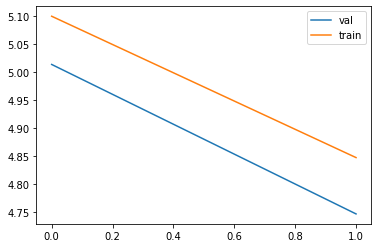

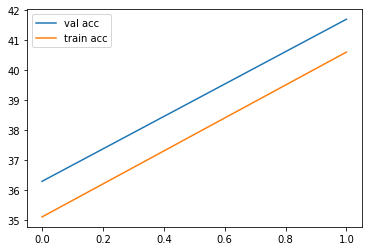


Iteration 600, loss = 4.6173
Checking accuracy on validation set
Got 444 / 1000 correct (44.40)
Checking accuracy on train set
Got 21530 / 49000 correct (43.94)


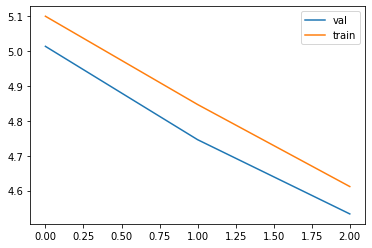

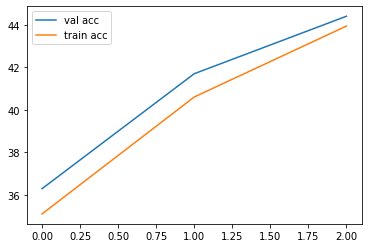


epoch  1
Iteration 0, loss = 4.2820
Checking accuracy on validation set
Got 479 / 1000 correct (47.90)
Checking accuracy on train set
Got 23688 / 49000 correct (48.34)


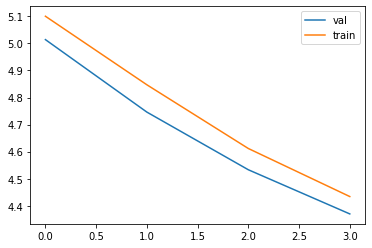

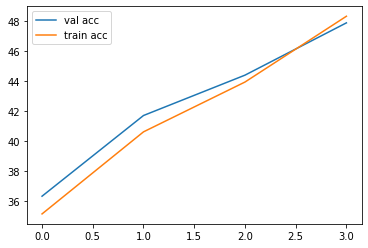


Iteration 200, loss = 3.9937
Checking accuracy on validation set
Got 490 / 1000 correct (49.00)
Checking accuracy on train set
Got 24483 / 49000 correct (49.97)


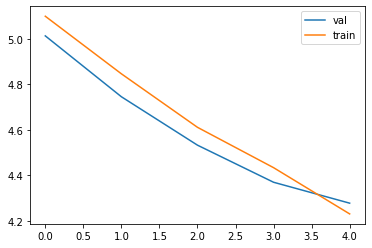

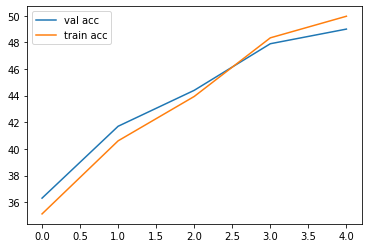


Iteration 400, loss = 4.1031
Checking accuracy on validation set
Got 489 / 1000 correct (48.90)
Checking accuracy on train set
Got 25509 / 49000 correct (52.06)


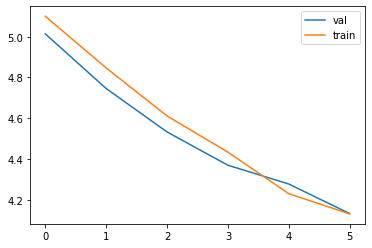

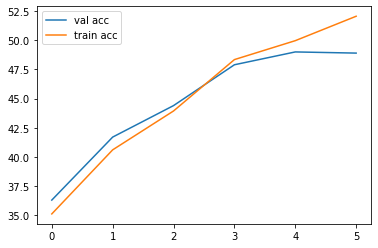


Iteration 600, loss = 3.9716
Checking accuracy on validation set
Got 508 / 1000 correct (50.80)
Checking accuracy on train set
Got 26207 / 49000 correct (53.48)


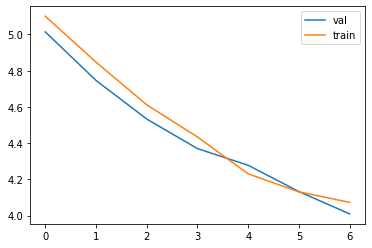

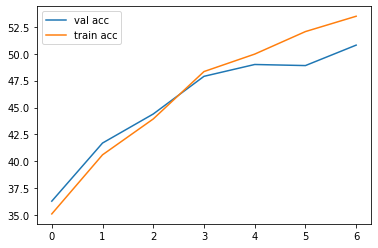


epoch  2
Iteration 0, loss = 3.8653
Checking accuracy on validation set
Got 549 / 1000 correct (54.90)
Checking accuracy on train set
Got 27217 / 49000 correct (55.54)


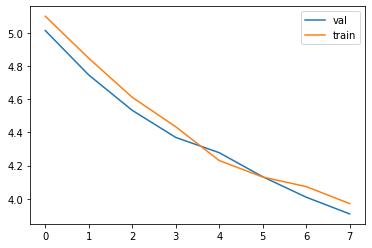

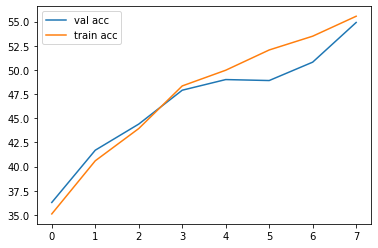


Iteration 200, loss = 3.7365
Checking accuracy on validation set
Got 532 / 1000 correct (53.20)
Checking accuracy on train set
Got 28299 / 49000 correct (57.75)


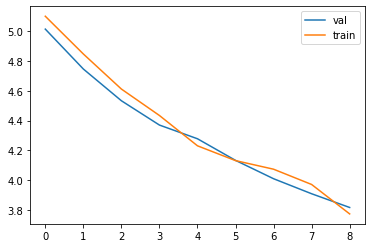

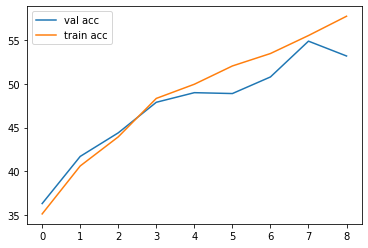


Iteration 400, loss = 3.4960
Checking accuracy on validation set
Got 549 / 1000 correct (54.90)
Checking accuracy on train set
Got 29020 / 49000 correct (59.22)


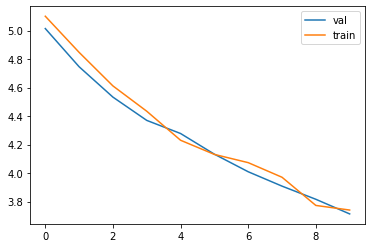

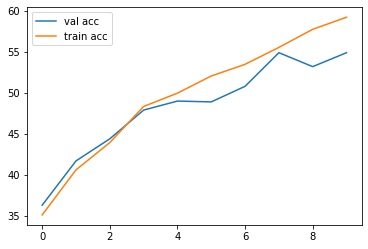


Iteration 600, loss = 3.6785
Checking accuracy on validation set
Got 569 / 1000 correct (56.90)
Checking accuracy on train set
Got 29724 / 49000 correct (60.66)


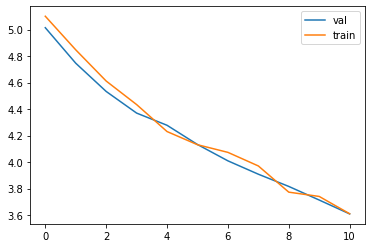

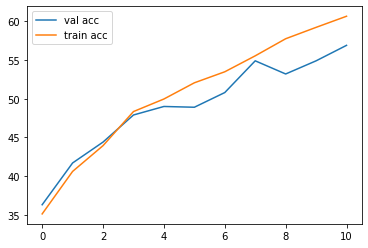


epoch  3
Iteration 0, loss = 3.6809
Checking accuracy on validation set
Got 572 / 1000 correct (57.20)
Checking accuracy on train set
Got 30265 / 49000 correct (61.77)


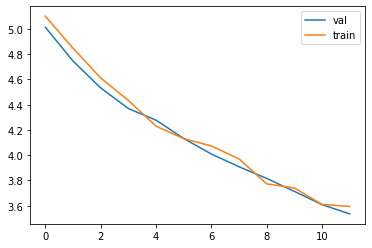

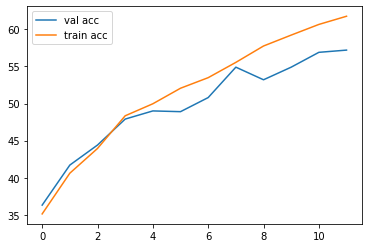


Iteration 200, loss = 3.5719
Checking accuracy on validation set
Got 572 / 1000 correct (57.20)
Checking accuracy on train set
Got 30199 / 49000 correct (61.63)


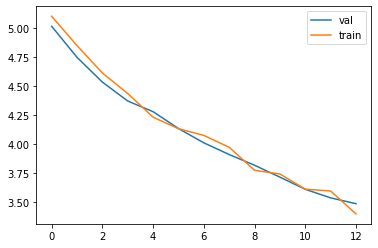

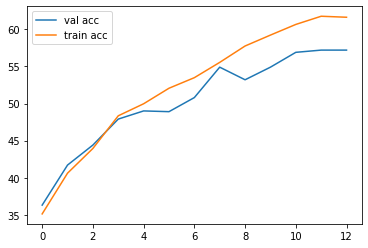


Iteration 400, loss = 3.2767
Checking accuracy on validation set
Got 593 / 1000 correct (59.30)
Checking accuracy on train set
Got 31652 / 49000 correct (64.60)


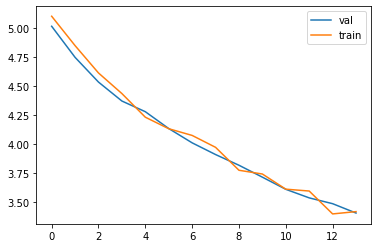

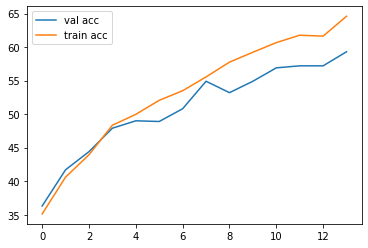


Iteration 600, loss = 3.1850
Checking accuracy on validation set
Got 604 / 1000 correct (60.40)
Checking accuracy on train set
Got 31675 / 49000 correct (64.64)


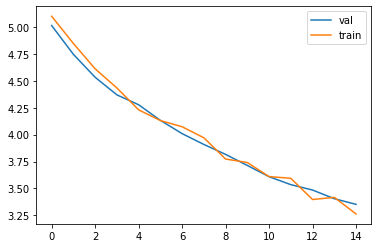

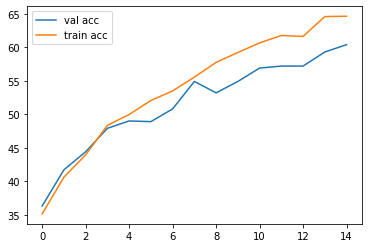


epoch  4
Iteration 0, loss = 3.3110
Checking accuracy on validation set
Got 614 / 1000 correct (61.40)
Checking accuracy on train set
Got 32593 / 49000 correct (66.52)


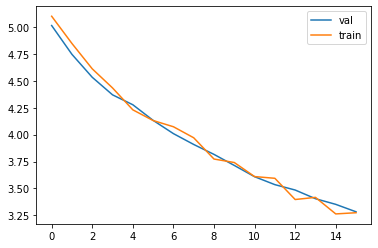

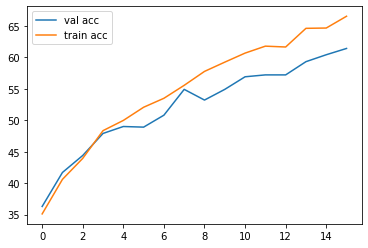


Iteration 200, loss = 3.2427
Checking accuracy on validation set
Got 600 / 1000 correct (60.00)
Checking accuracy on train set
Got 33390 / 49000 correct (68.14)


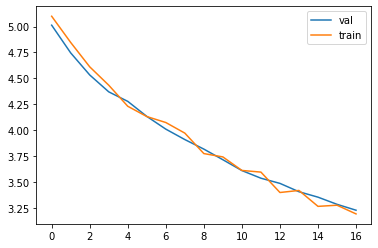

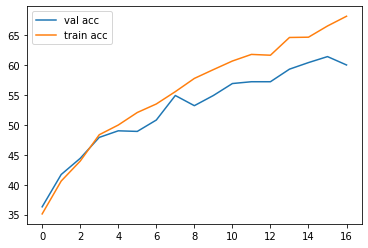


Iteration 400, loss = 2.8895
Checking accuracy on validation set
Got 608 / 1000 correct (60.80)
Checking accuracy on train set
Got 33255 / 49000 correct (67.87)


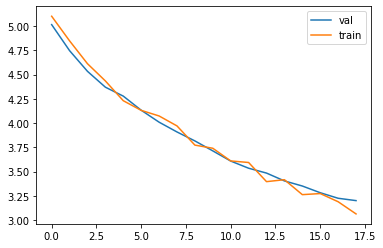

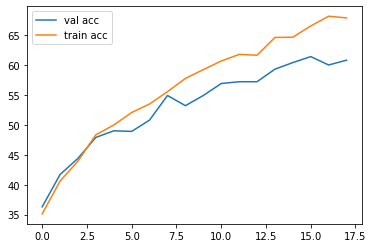


Iteration 600, loss = 2.9690
Checking accuracy on validation set
Got 623 / 1000 correct (62.30)
Checking accuracy on train set
Got 34829 / 49000 correct (71.08)


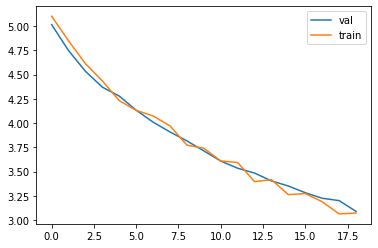

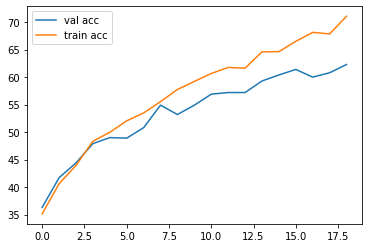


epoch  5
Iteration 0, loss = 3.0001
Checking accuracy on validation set
Got 633 / 1000 correct (63.30)
Checking accuracy on train set
Got 34743 / 49000 correct (70.90)


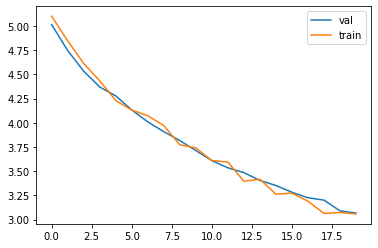

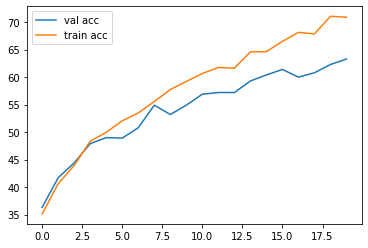


Iteration 200, loss = 2.9758
Checking accuracy on validation set
Got 614 / 1000 correct (61.40)
Checking accuracy on train set
Got 33306 / 49000 correct (67.97)


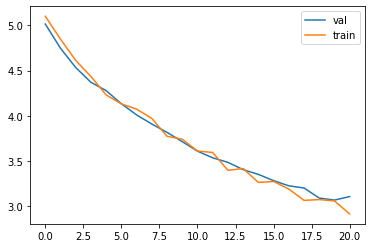

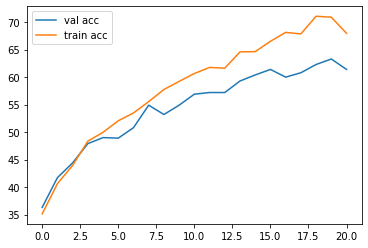


Iteration 400, loss = 2.6982
Checking accuracy on validation set
Got 624 / 1000 correct (62.40)
Checking accuracy on train set
Got 34884 / 49000 correct (71.19)


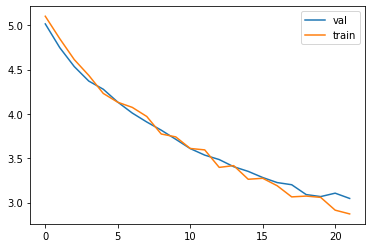

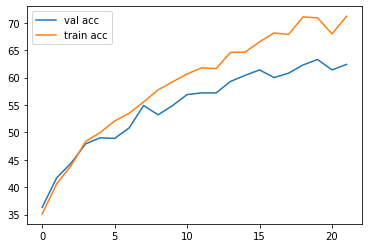


Iteration 600, loss = 3.1464
Checking accuracy on validation set
Got 638 / 1000 correct (63.80)
Checking accuracy on train set
Got 35915 / 49000 correct (73.30)


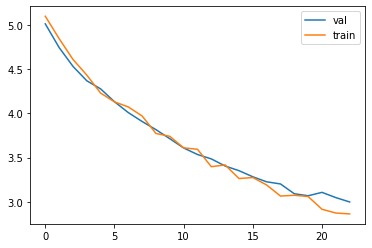

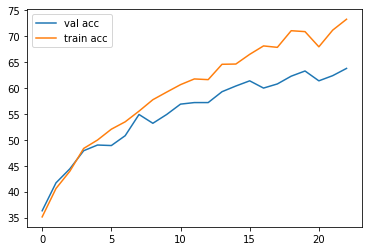


epoch  6
Iteration 0, loss = 2.8415
Checking accuracy on validation set
Got 625 / 1000 correct (62.50)
Checking accuracy on train set
Got 35630 / 49000 correct (72.71)


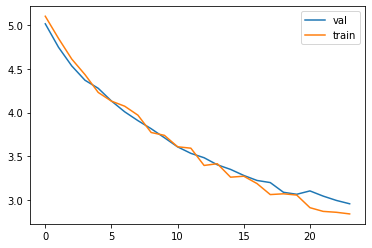

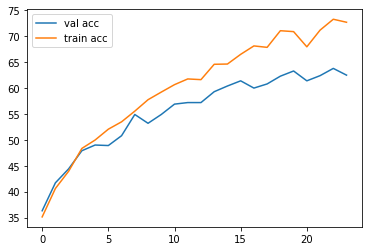


Iteration 200, loss = 2.6952
Checking accuracy on validation set
Got 644 / 1000 correct (64.40)
Checking accuracy on train set
Got 36930 / 49000 correct (75.37)


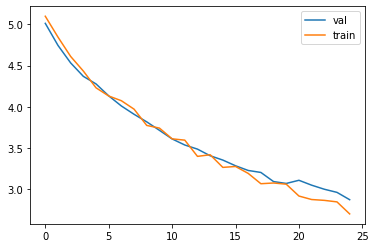

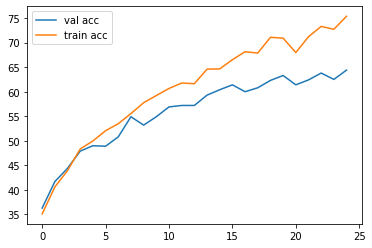


Iteration 400, loss = 2.7285
Checking accuracy on validation set
Got 627 / 1000 correct (62.70)
Checking accuracy on train set
Got 37255 / 49000 correct (76.03)


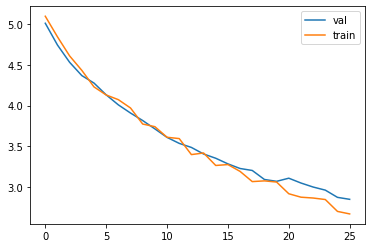

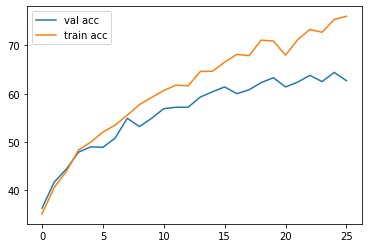


Iteration 600, loss = 2.5482
Checking accuracy on validation set
Got 652 / 1000 correct (65.20)
Checking accuracy on train set
Got 37937 / 49000 correct (77.42)


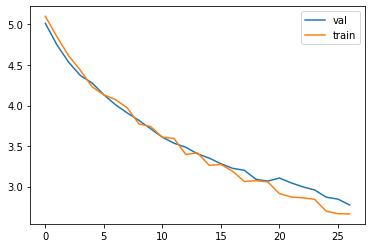

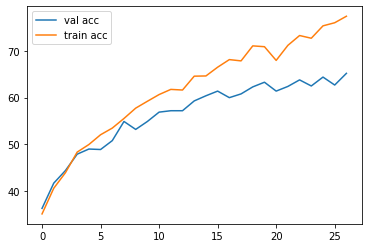


epoch  7
Iteration 0, loss = 2.7344
Checking accuracy on validation set
Got 673 / 1000 correct (67.30)
Checking accuracy on train set
Got 38248 / 49000 correct (78.06)


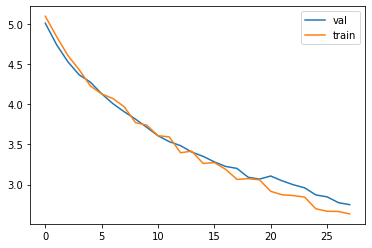

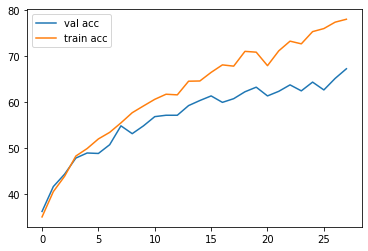


Iteration 200, loss = 2.6218
Checking accuracy on validation set
Got 660 / 1000 correct (66.00)
Checking accuracy on train set
Got 37359 / 49000 correct (76.24)


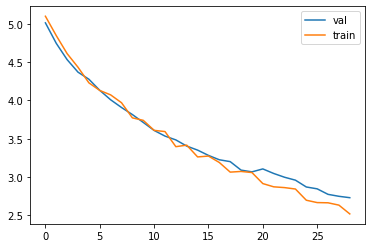

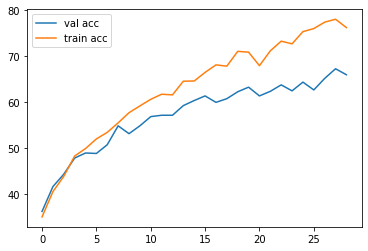


Iteration 400, loss = 2.5157
Checking accuracy on validation set
Got 690 / 1000 correct (69.00)
Checking accuracy on train set
Got 38890 / 49000 correct (79.37)


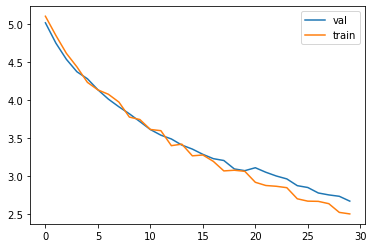

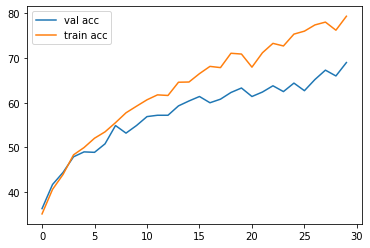


Iteration 600, loss = 2.5966
Checking accuracy on validation set
Got 660 / 1000 correct (66.00)
Checking accuracy on train set
Got 38194 / 49000 correct (77.95)


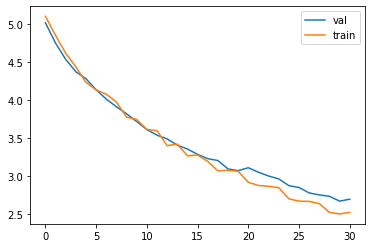

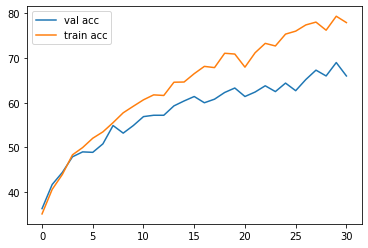


epoch  8
Iteration 0, loss = 2.2889
Checking accuracy on validation set
Got 681 / 1000 correct (68.10)
Checking accuracy on train set
Got 39186 / 49000 correct (79.97)


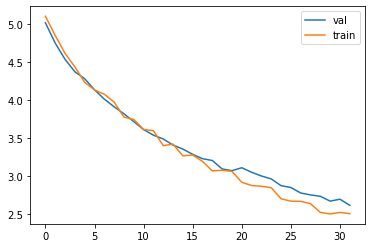

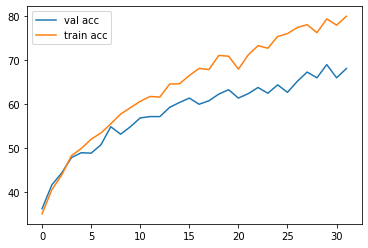


Iteration 200, loss = 2.3915
Checking accuracy on validation set
Got 659 / 1000 correct (65.90)
Checking accuracy on train set
Got 38144 / 49000 correct (77.84)


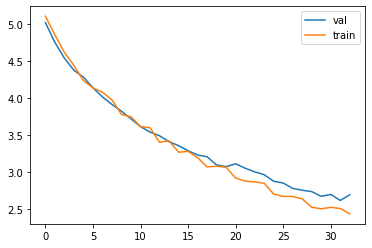

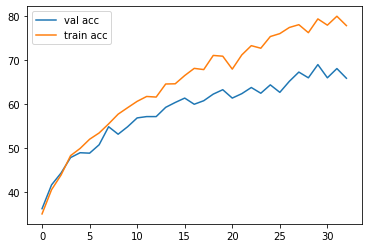


Iteration 400, loss = 2.4658
Checking accuracy on validation set
Got 654 / 1000 correct (65.40)
Checking accuracy on train set
Got 39807 / 49000 correct (81.24)


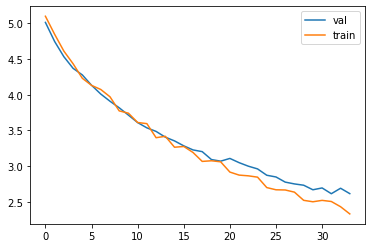

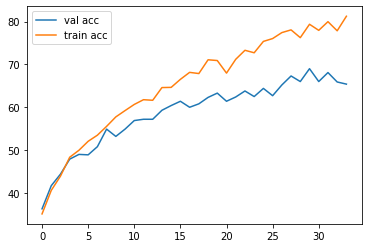


Iteration 600, loss = 2.2946
Checking accuracy on validation set
Got 663 / 1000 correct (66.30)
Checking accuracy on train set
Got 39227 / 49000 correct (80.06)


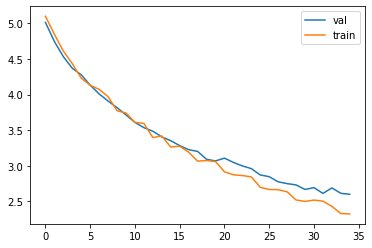

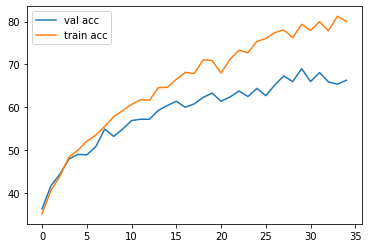


epoch  9
Iteration 0, loss = 2.1708
Checking accuracy on validation set
Got 679 / 1000 correct (67.90)
Checking accuracy on train set
Got 39457 / 49000 correct (80.52)


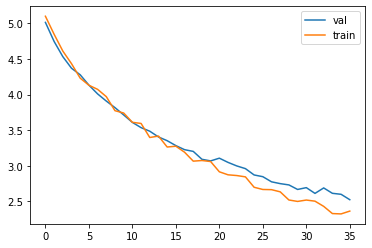

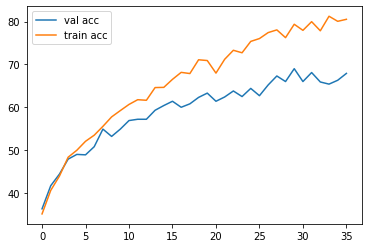


Iteration 200, loss = 2.4403
Checking accuracy on validation set
Got 675 / 1000 correct (67.50)
Checking accuracy on train set
Got 41184 / 49000 correct (84.05)


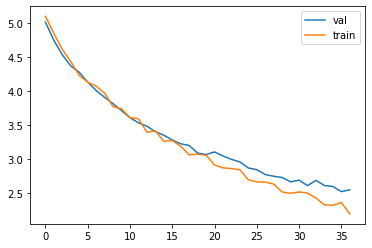

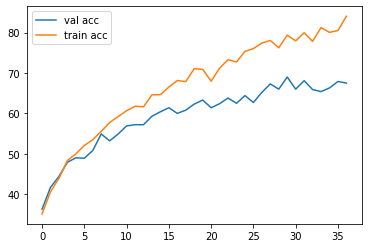


Iteration 400, loss = 2.5077
Checking accuracy on validation set
Got 675 / 1000 correct (67.50)
Checking accuracy on train set
Got 39953 / 49000 correct (81.54)


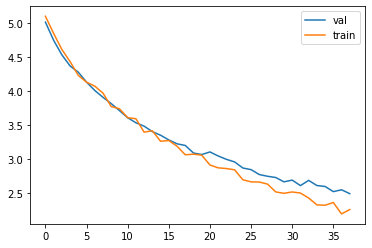

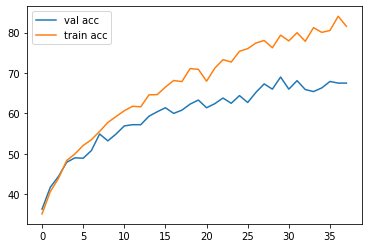


Iteration 600, loss = 2.2296
Checking accuracy on validation set
Got 695 / 1000 correct (69.50)
Checking accuracy on train set
Got 39722 / 49000 correct (81.07)


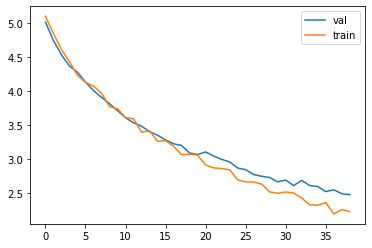

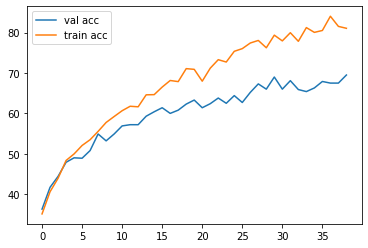


epoch  10
Iteration 0, loss = 2.0090
Checking accuracy on validation set
Got 685 / 1000 correct (68.50)
Checking accuracy on train set
Got 41230 / 49000 correct (84.14)


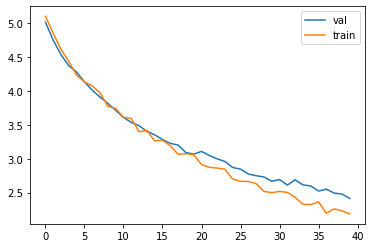

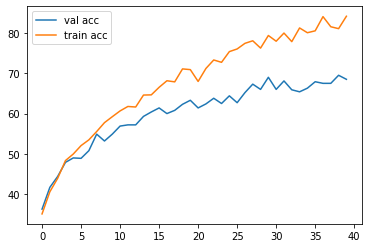


Iteration 200, loss = 2.0900
Checking accuracy on validation set
Got 683 / 1000 correct (68.30)
Checking accuracy on train set
Got 41035 / 49000 correct (83.74)


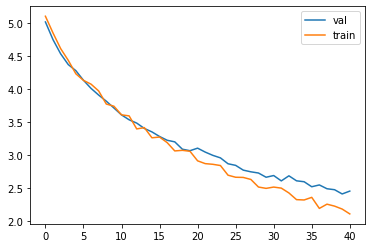

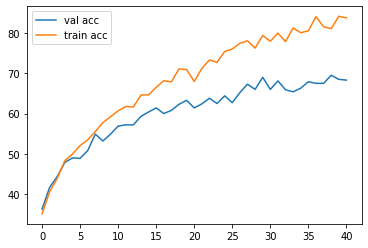


Iteration 400, loss = 1.9522
Checking accuracy on validation set
Got 691 / 1000 correct (69.10)
Checking accuracy on train set
Got 41598 / 49000 correct (84.89)


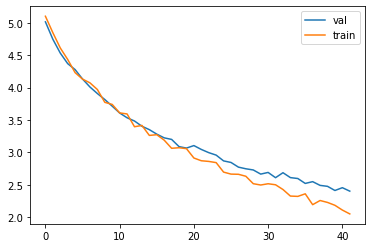

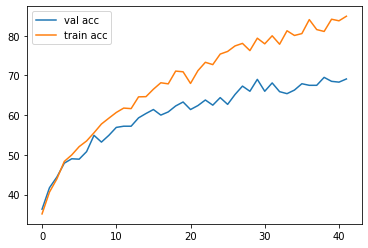


Iteration 600, loss = 2.0918
Checking accuracy on validation set
Got 685 / 1000 correct (68.50)
Checking accuracy on train set
Got 40951 / 49000 correct (83.57)


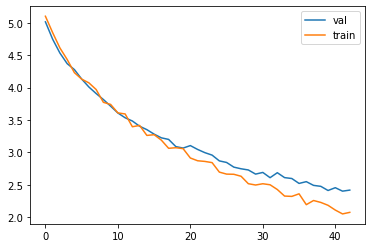

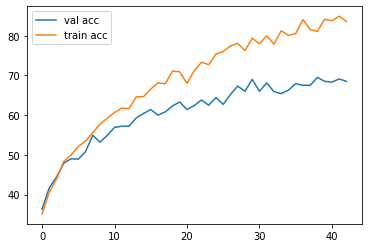


epoch  11
Iteration 0, loss = 1.9757
Checking accuracy on validation set
Got 689 / 1000 correct (68.90)
Checking accuracy on train set
Got 41601 / 49000 correct (84.90)


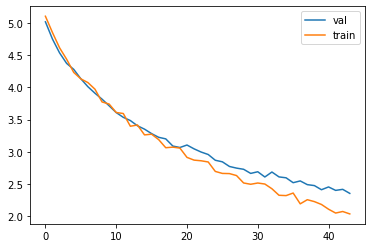

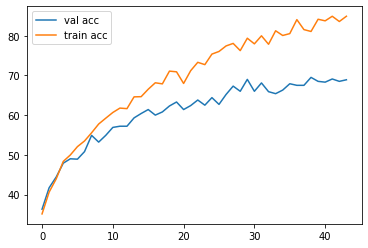


Iteration 200, loss = 1.8378
Checking accuracy on validation set
Got 667 / 1000 correct (66.70)
Checking accuracy on train set
Got 41817 / 49000 correct (85.34)


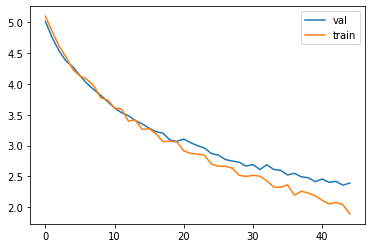

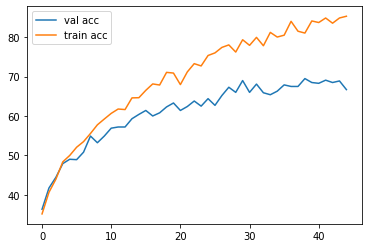


Iteration 400, loss = 1.9103
Checking accuracy on validation set
Got 678 / 1000 correct (67.80)
Checking accuracy on train set
Got 42129 / 49000 correct (85.98)


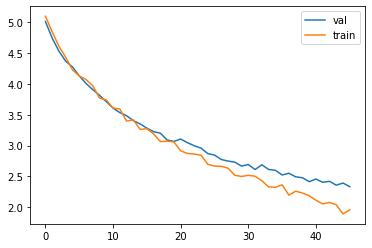

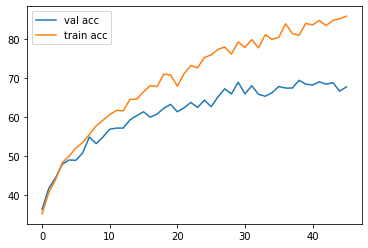


Iteration 600, loss = 1.9602
Checking accuracy on validation set
Got 683 / 1000 correct (68.30)
Checking accuracy on train set
Got 41844 / 49000 correct (85.40)


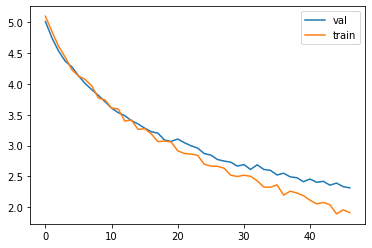

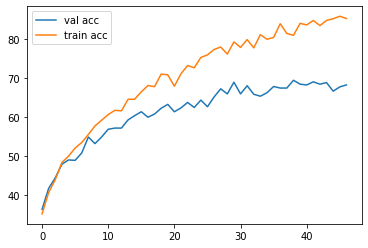


epoch  12
Iteration 0, loss = 1.9094
Checking accuracy on validation set
Got 701 / 1000 correct (70.10)
Checking accuracy on train set
Got 42685 / 49000 correct (87.11)


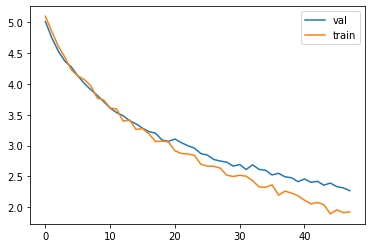

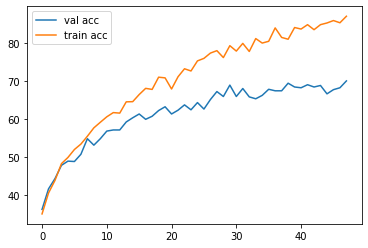


Iteration 200, loss = 1.9047
Checking accuracy on validation set
Got 698 / 1000 correct (69.80)
Checking accuracy on train set
Got 43219 / 49000 correct (88.20)


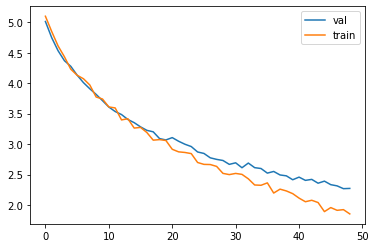

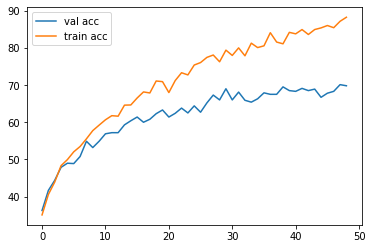


Iteration 400, loss = 1.8525
Checking accuracy on validation set
Got 666 / 1000 correct (66.60)
Checking accuracy on train set
Got 42386 / 49000 correct (86.50)


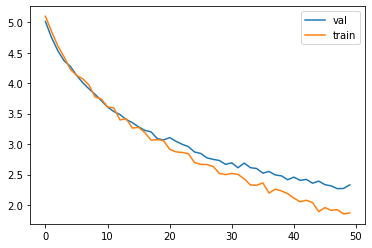

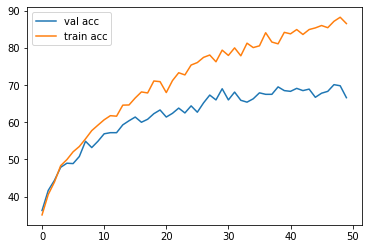


Iteration 600, loss = 1.7735
Checking accuracy on validation set
Got 687 / 1000 correct (68.70)
Checking accuracy on train set
Got 43039 / 49000 correct (87.83)


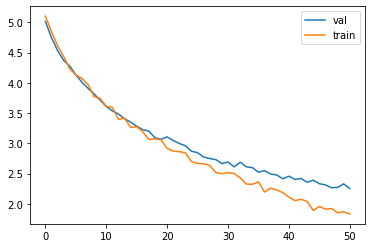

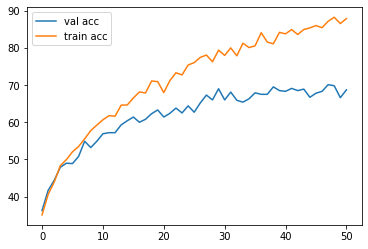


epoch  13
Iteration 0, loss = 1.6097
Checking accuracy on validation set
Got 697 / 1000 correct (69.70)
Checking accuracy on train set
Got 42820 / 49000 correct (87.39)


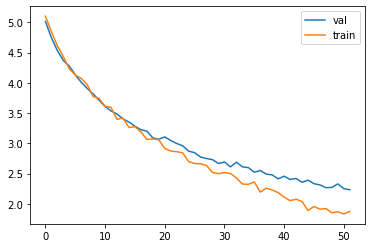

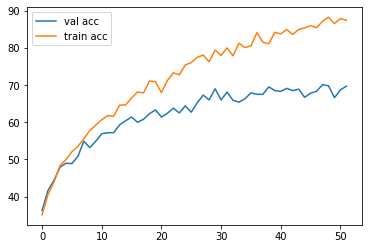


Iteration 200, loss = 1.6667
Checking accuracy on validation set
Got 691 / 1000 correct (69.10)
Checking accuracy on train set
Got 43810 / 49000 correct (89.41)


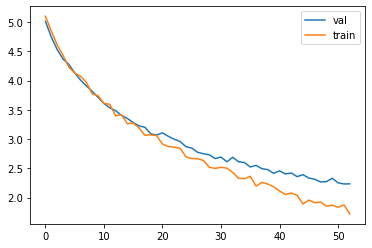

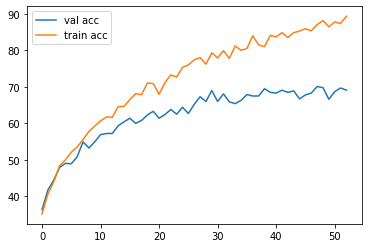


Iteration 400, loss = 1.8840
Checking accuracy on validation set
Got 695 / 1000 correct (69.50)
Checking accuracy on train set
Got 43812 / 49000 correct (89.41)


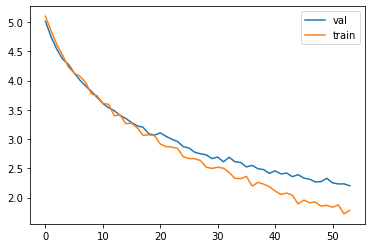

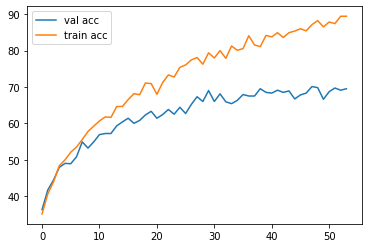


Iteration 600, loss = 1.6749
Checking accuracy on validation set
Got 673 / 1000 correct (67.30)
Checking accuracy on train set
Got 43065 / 49000 correct (87.89)


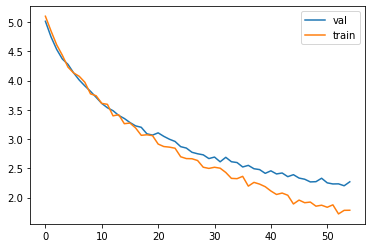

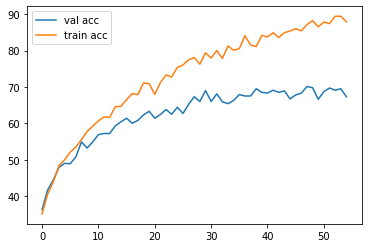


epoch  14
Iteration 0, loss = 1.6452
Checking accuracy on validation set
Got 664 / 1000 correct (66.40)
Checking accuracy on train set
Got 43506 / 49000 correct (88.79)


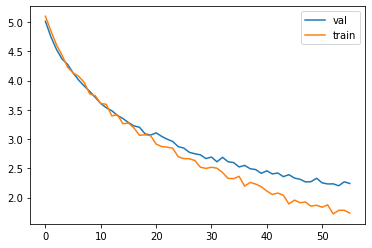

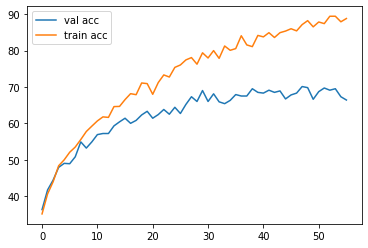


Iteration 200, loss = 1.5496
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)
Checking accuracy on train set
Got 43684 / 49000 correct (89.15)


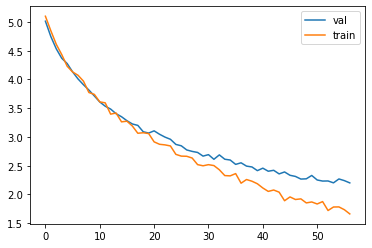

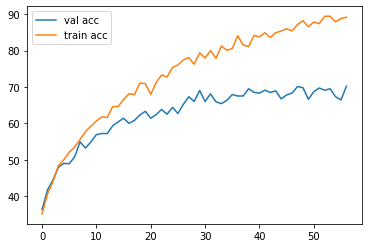


Iteration 400, loss = 1.6692
Checking accuracy on validation set
Got 682 / 1000 correct (68.20)
Checking accuracy on train set
Got 43358 / 49000 correct (88.49)


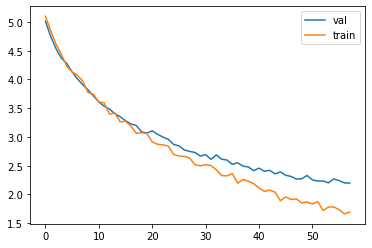

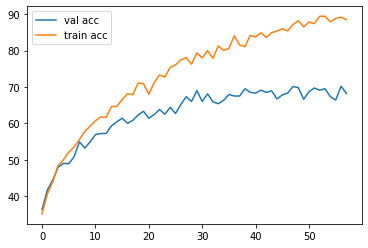


Iteration 600, loss = 1.5854
Checking accuracy on validation set
Got 697 / 1000 correct (69.70)
Checking accuracy on train set
Got 43396 / 49000 correct (88.56)


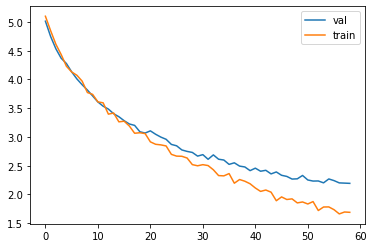

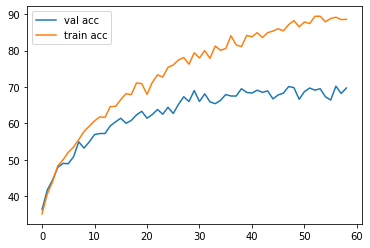


epoch  15
Iteration 0, loss = 1.5369
Checking accuracy on validation set
Got 720 / 1000 correct (72.00)
Checking accuracy on train set
Got 43631 / 49000 correct (89.04)


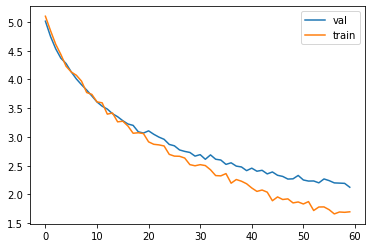

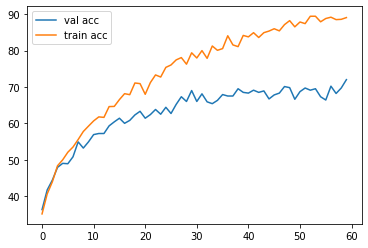


Iteration 200, loss = 1.7619
Checking accuracy on validation set
Got 686 / 1000 correct (68.60)
Checking accuracy on train set
Got 43202 / 49000 correct (88.17)


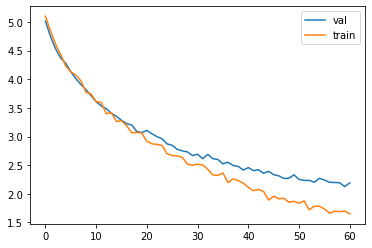

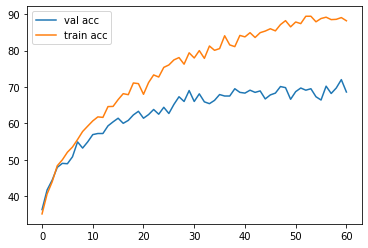


Iteration 400, loss = 1.6511
Checking accuracy on validation set
Got 685 / 1000 correct (68.50)
Checking accuracy on train set
Got 43588 / 49000 correct (88.96)


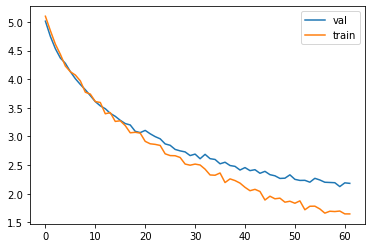

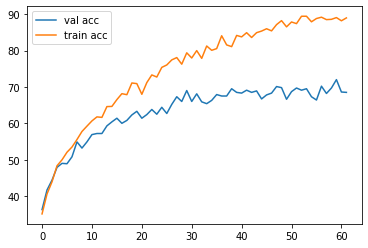


Iteration 600, loss = 1.7101
Checking accuracy on validation set
Got 680 / 1000 correct (68.00)
Checking accuracy on train set
Got 43962 / 49000 correct (89.72)


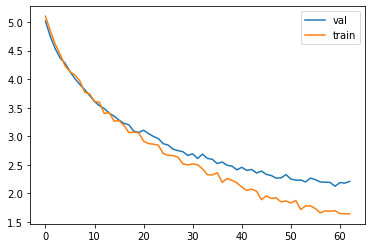

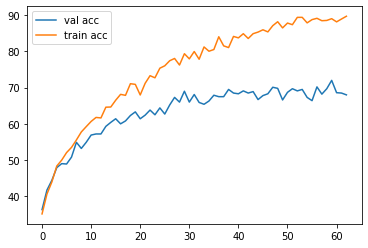


epoch  16
Iteration 0, loss = 1.4279
Checking accuracy on validation set
Got 715 / 1000 correct (71.50)
Checking accuracy on train set
Got 45030 / 49000 correct (91.90)


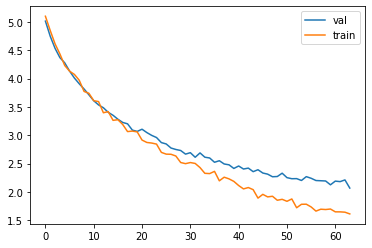

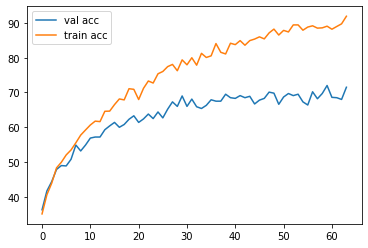


Iteration 200, loss = 1.5603
Checking accuracy on validation set
Got 701 / 1000 correct (70.10)
Checking accuracy on train set
Got 44141 / 49000 correct (90.08)


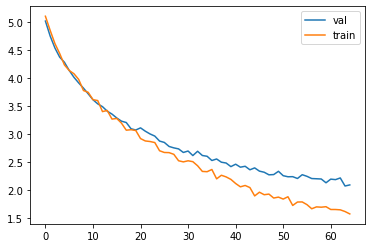

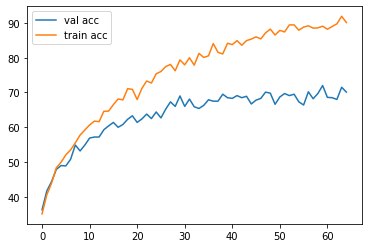


Iteration 400, loss = 1.7111
Checking accuracy on validation set
Got 685 / 1000 correct (68.50)
Checking accuracy on train set
Got 43450 / 49000 correct (88.67)


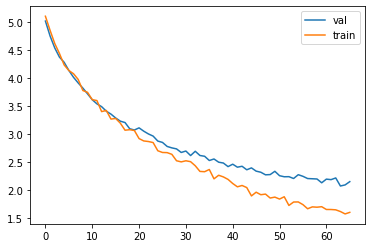

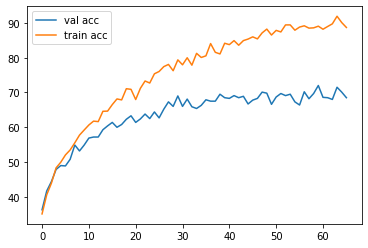


Iteration 600, loss = 1.7507
Checking accuracy on validation set
Got 694 / 1000 correct (69.40)
Checking accuracy on train set
Got 44145 / 49000 correct (90.09)


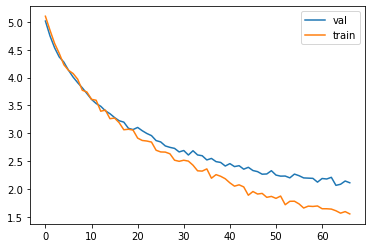

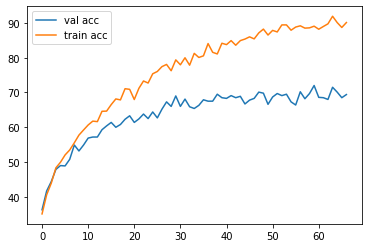


epoch  17
Iteration 0, loss = 1.5073
Checking accuracy on validation set
Got 709 / 1000 correct (70.90)
Checking accuracy on train set
Got 45010 / 49000 correct (91.86)


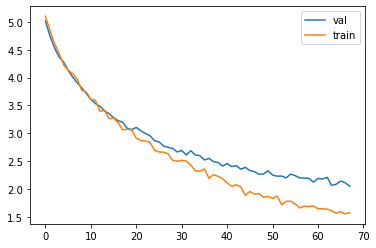

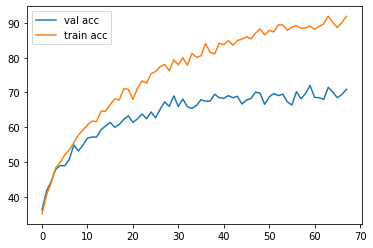


Iteration 200, loss = 1.2768
Checking accuracy on validation set
Got 677 / 1000 correct (67.70)
Checking accuracy on train set
Got 43966 / 49000 correct (89.73)


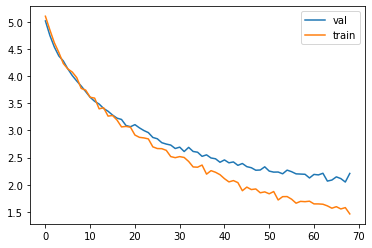

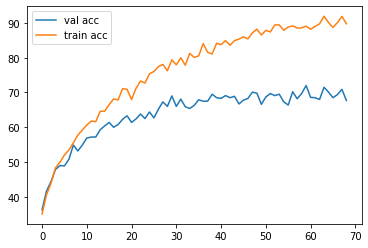


Iteration 400, loss = 1.5586
Checking accuracy on validation set
Got 682 / 1000 correct (68.20)
Checking accuracy on train set
Got 44140 / 49000 correct (90.08)


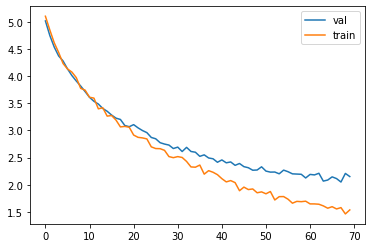

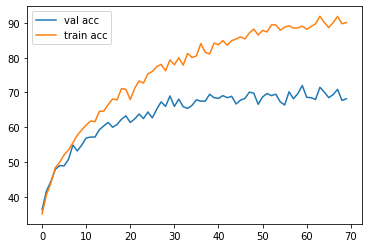


Iteration 600, loss = 1.5057
Checking accuracy on validation set
Got 712 / 1000 correct (71.20)
Checking accuracy on train set
Got 45268 / 49000 correct (92.38)


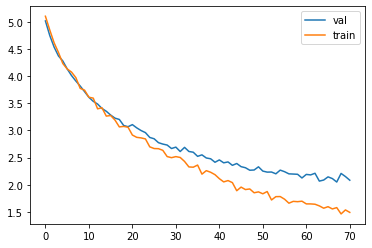

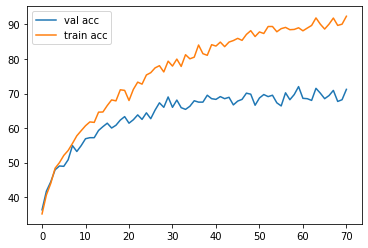


epoch  18
Iteration 0, loss = 1.5526
Checking accuracy on validation set
Got 710 / 1000 correct (71.00)
Checking accuracy on train set
Got 45061 / 49000 correct (91.96)


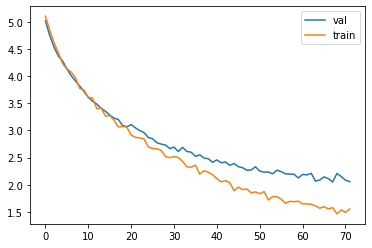

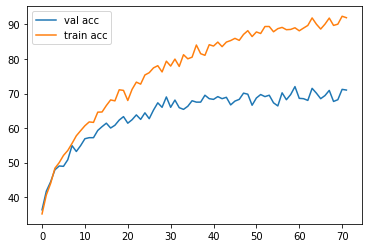


Iteration 200, loss = 1.4869
Checking accuracy on validation set
Got 699 / 1000 correct (69.90)
Checking accuracy on train set
Got 44630 / 49000 correct (91.08)


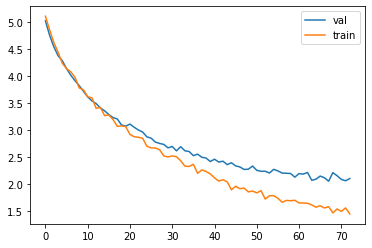

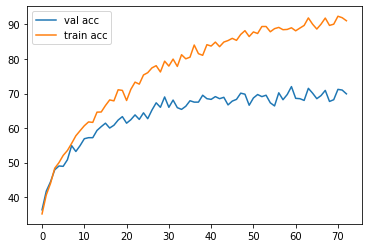


Iteration 400, loss = 1.5202
Checking accuracy on validation set
Got 688 / 1000 correct (68.80)
Checking accuracy on train set
Got 45473 / 49000 correct (92.80)


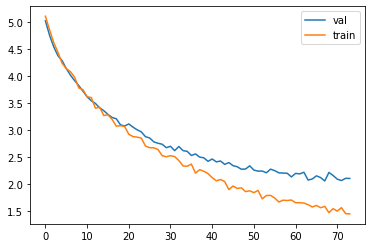

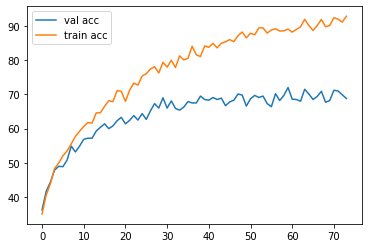


Iteration 600, loss = 1.3718
Checking accuracy on validation set
Got 684 / 1000 correct (68.40)
Checking accuracy on train set
Got 44953 / 49000 correct (91.74)


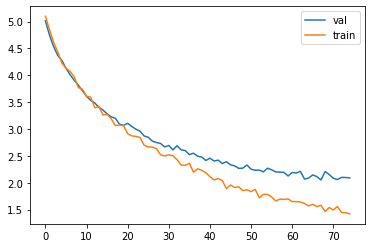

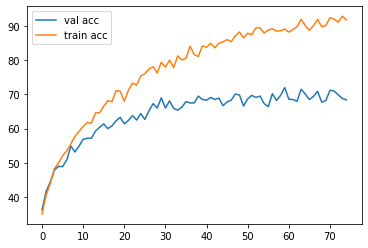


epoch  19
Iteration 0, loss = 1.5299
Checking accuracy on validation set
Got 696 / 1000 correct (69.60)
Checking accuracy on train set
Got 45099 / 49000 correct (92.04)


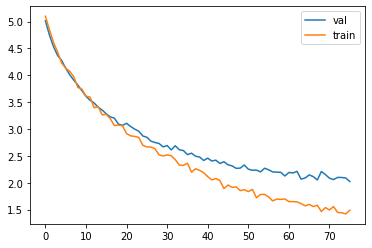

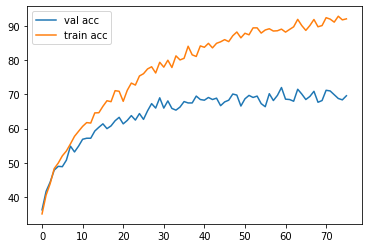


Iteration 200, loss = 1.4277
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)
Checking accuracy on train set
Got 45184 / 49000 correct (92.21)


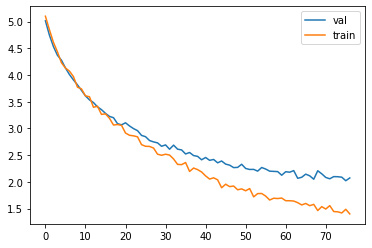

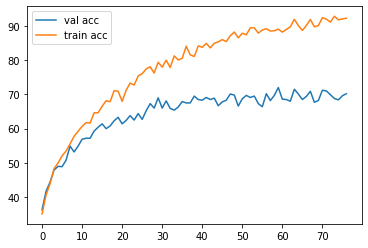


Iteration 400, loss = 1.4975
Checking accuracy on validation set
Got 696 / 1000 correct (69.60)
Checking accuracy on train set
Got 44783 / 49000 correct (91.39)


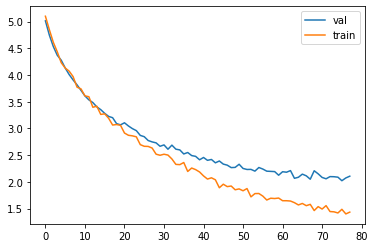

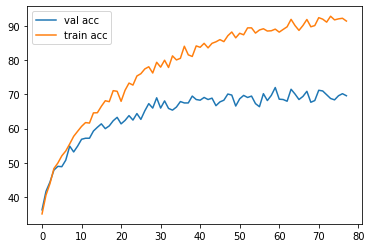


Iteration 600, loss = 1.4266
Checking accuracy on validation set
Got 697 / 1000 correct (69.70)
Checking accuracy on train set
Got 45490 / 49000 correct (92.84)


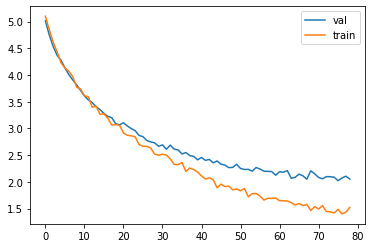

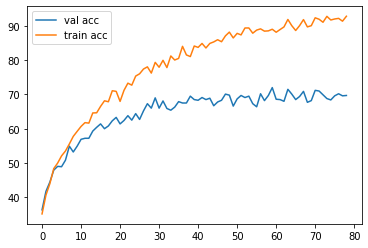


epoch  20
Iteration 0, loss = 1.2950
Checking accuracy on validation set
Got 706 / 1000 correct (70.60)
Checking accuracy on train set
Got 45077 / 49000 correct (91.99)


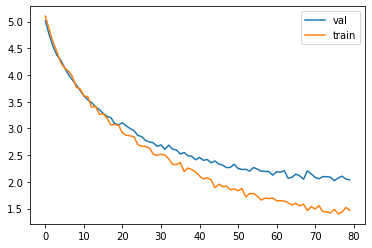

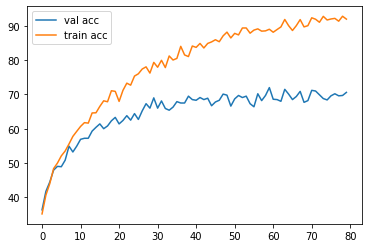


Iteration 200, loss = 1.2197
Checking accuracy on validation set
Got 693 / 1000 correct (69.30)
Checking accuracy on train set
Got 45066 / 49000 correct (91.97)


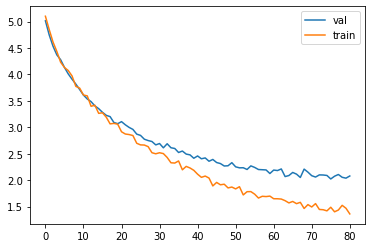

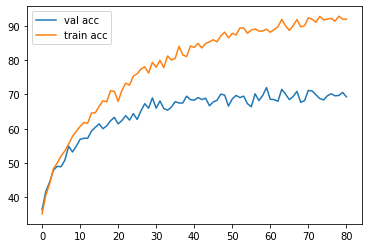


Iteration 400, loss = 1.4268
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)
Checking accuracy on train set
Got 45570 / 49000 correct (93.00)


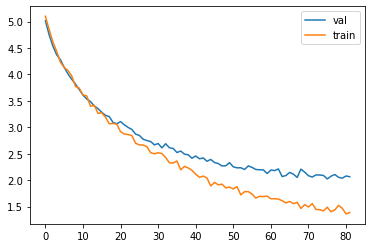

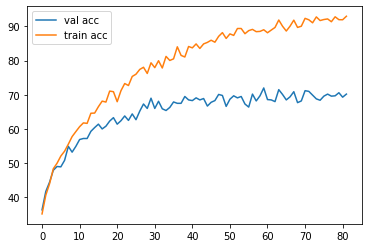


Iteration 600, loss = 1.5691
Checking accuracy on validation set
Got 691 / 1000 correct (69.10)
Checking accuracy on train set
Got 45368 / 49000 correct (92.59)


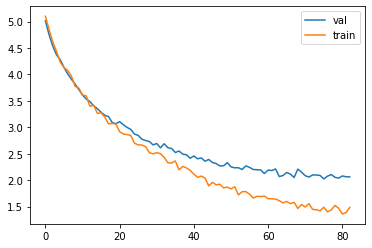

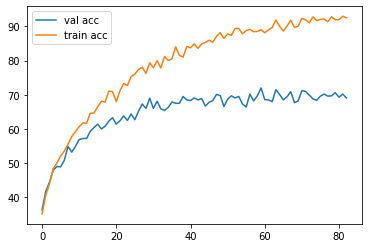


epoch  21
Iteration 0, loss = 1.3227
Checking accuracy on validation set
Got 709 / 1000 correct (70.90)
Checking accuracy on train set
Got 45981 / 49000 correct (93.84)


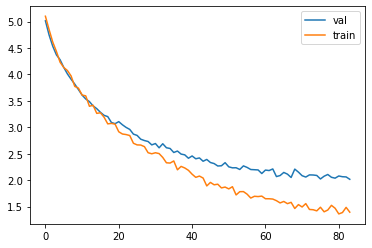

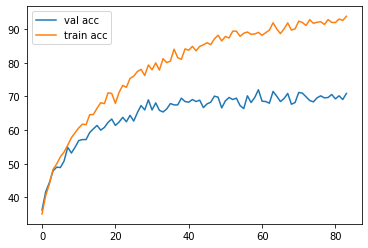


Iteration 200, loss = 1.2482
Checking accuracy on validation set
Got 688 / 1000 correct (68.80)
Checking accuracy on train set
Got 44684 / 49000 correct (91.19)


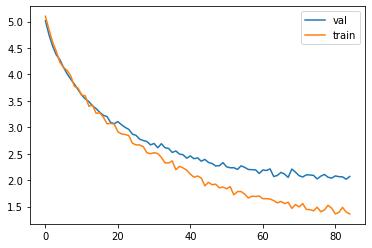

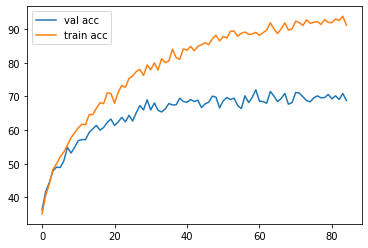


Iteration 400, loss = 1.5538
Checking accuracy on validation set
Got 723 / 1000 correct (72.30)
Checking accuracy on train set
Got 45642 / 49000 correct (93.15)


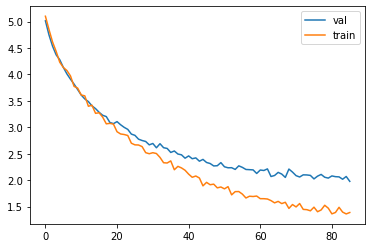

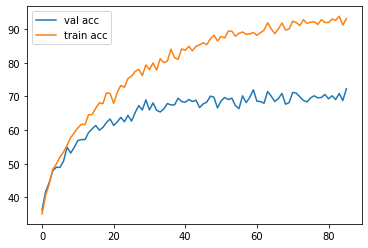


Iteration 600, loss = 1.5541
Checking accuracy on validation set
Got 707 / 1000 correct (70.70)
Checking accuracy on train set
Got 45837 / 49000 correct (93.54)


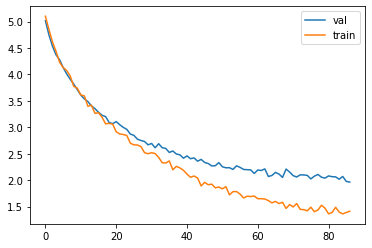

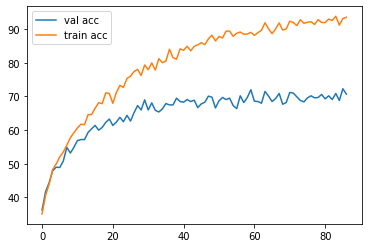


epoch  22
Iteration 0, loss = 1.3060
Checking accuracy on validation set
Got 709 / 1000 correct (70.90)
Checking accuracy on train set
Got 46049 / 49000 correct (93.98)


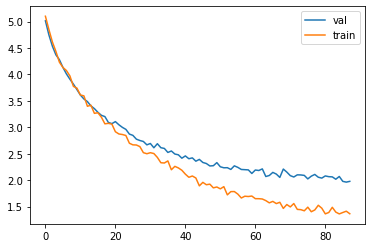

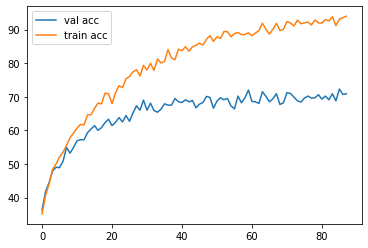


Iteration 200, loss = 1.3159
Checking accuracy on validation set
Got 701 / 1000 correct (70.10)
Checking accuracy on train set
Got 46035 / 49000 correct (93.95)


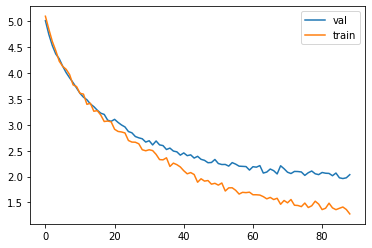

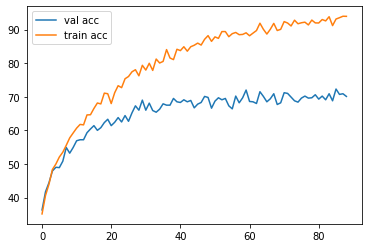


Iteration 400, loss = 1.2589
Checking accuracy on validation set
Got 686 / 1000 correct (68.60)
Checking accuracy on train set
Got 45642 / 49000 correct (93.15)


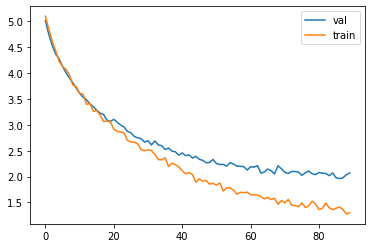

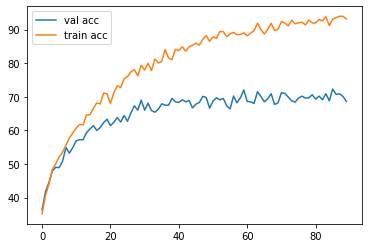


Iteration 600, loss = 1.5199
Checking accuracy on validation set
Got 698 / 1000 correct (69.80)
Checking accuracy on train set
Got 45650 / 49000 correct (93.16)


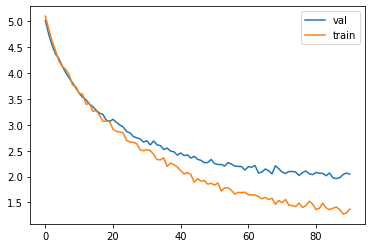

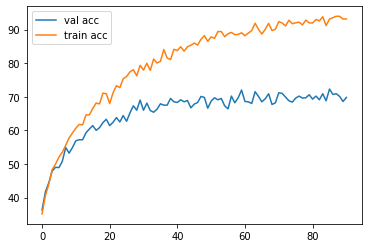


epoch  23
Iteration 0, loss = 1.1620
Checking accuracy on validation set
Got 696 / 1000 correct (69.60)
Checking accuracy on train set
Got 46116 / 49000 correct (94.11)


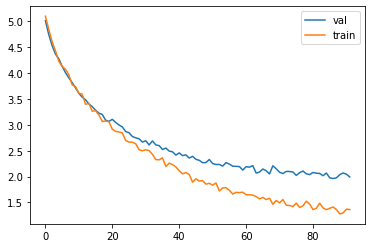

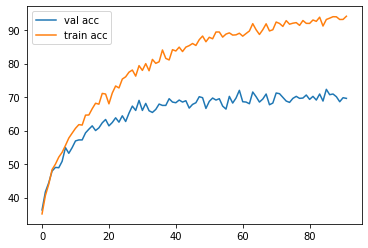


Iteration 200, loss = 1.3538
Checking accuracy on validation set
Got 686 / 1000 correct (68.60)
Checking accuracy on train set
Got 45611 / 49000 correct (93.08)


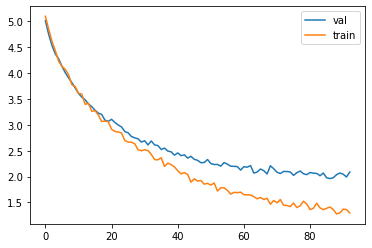

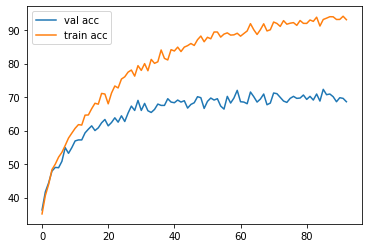


Iteration 400, loss = 1.3708
Checking accuracy on validation set
Got 689 / 1000 correct (68.90)
Checking accuracy on train set
Got 44911 / 49000 correct (91.66)


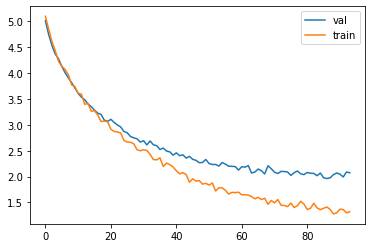

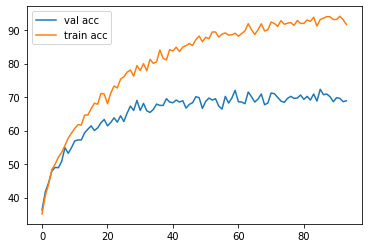


Iteration 600, loss = 1.3679
Checking accuracy on validation set
Got 689 / 1000 correct (68.90)
Checking accuracy on train set
Got 45186 / 49000 correct (92.22)


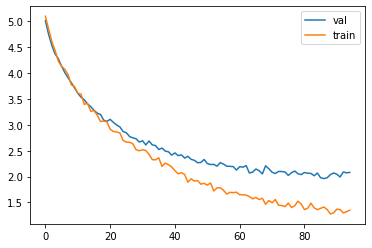

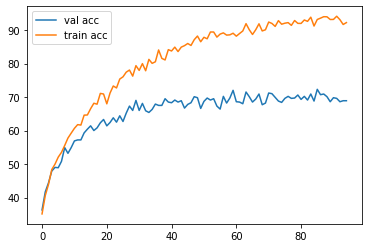


epoch  24
Iteration 0, loss = 1.1568
Checking accuracy on validation set
Got 687 / 1000 correct (68.70)
Checking accuracy on train set
Got 44748 / 49000 correct (91.32)


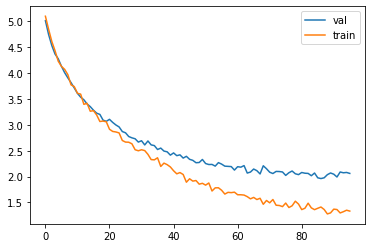

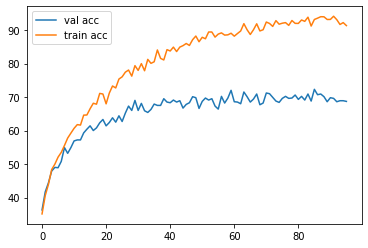


Iteration 200, loss = 1.2786
Checking accuracy on validation set
Got 687 / 1000 correct (68.70)
Checking accuracy on train set
Got 46371 / 49000 correct (94.63)


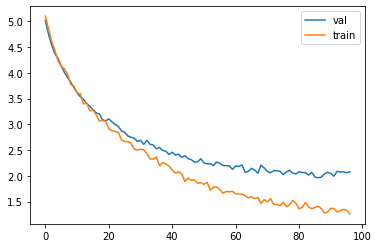

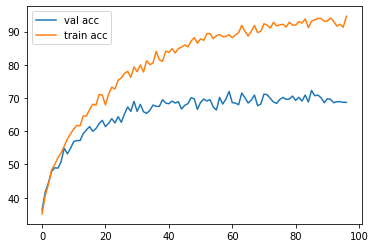


Iteration 400, loss = 1.3122
Checking accuracy on validation set
Got 680 / 1000 correct (68.00)
Checking accuracy on train set
Got 45473 / 49000 correct (92.80)


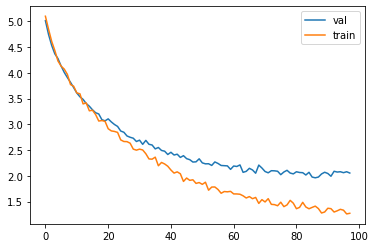

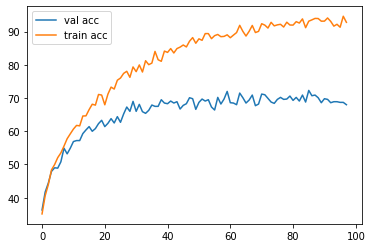


Iteration 600, loss = 1.1490
Checking accuracy on validation set
Got 711 / 1000 correct (71.10)
Checking accuracy on train set
Got 45790 / 49000 correct (93.45)


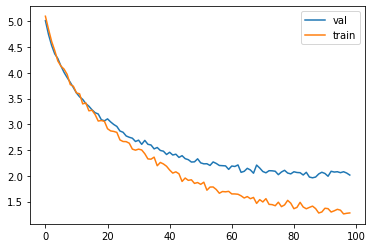

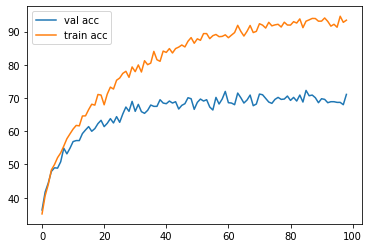


epoch  25
Iteration 0, loss = 1.2129
Checking accuracy on validation set
Got 680 / 1000 correct (68.00)
Checking accuracy on train set
Got 45199 / 49000 correct (92.24)


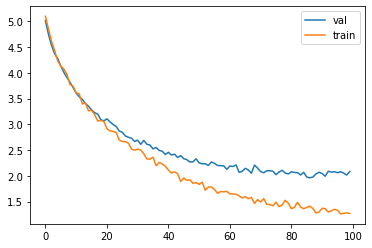

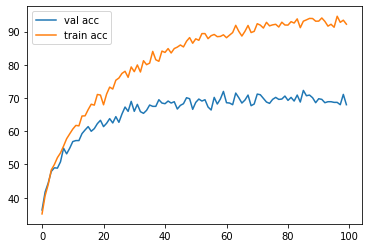


Iteration 200, loss = 1.2176
Checking accuracy on validation set
Got 698 / 1000 correct (69.80)
Checking accuracy on train set
Got 45384 / 49000 correct (92.62)


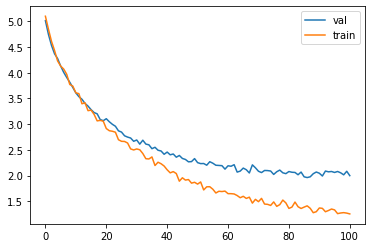

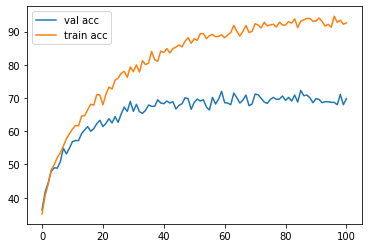


Iteration 400, loss = 1.3556
Checking accuracy on validation set
Got 701 / 1000 correct (70.10)
Checking accuracy on train set
Got 45805 / 49000 correct (93.48)


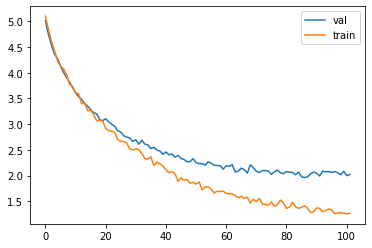

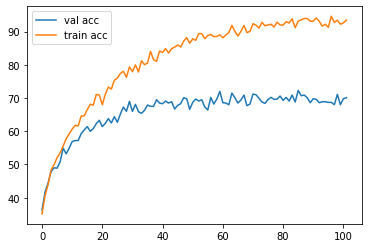


Iteration 600, loss = 1.3074
Checking accuracy on validation set
Got 694 / 1000 correct (69.40)
Checking accuracy on train set
Got 45788 / 49000 correct (93.44)


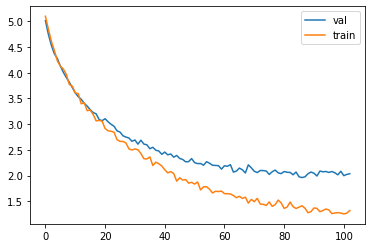

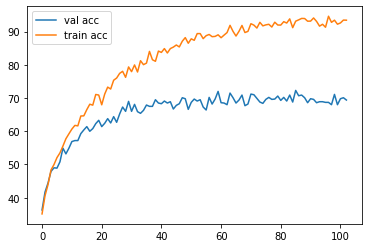


epoch  26
Iteration 0, loss = 1.1416
Checking accuracy on validation set
Got 690 / 1000 correct (69.00)
Checking accuracy on train set
Got 45846 / 49000 correct (93.56)


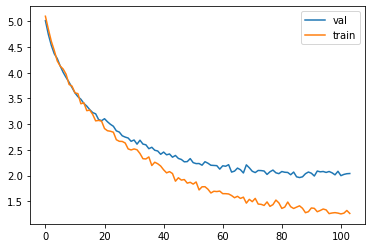

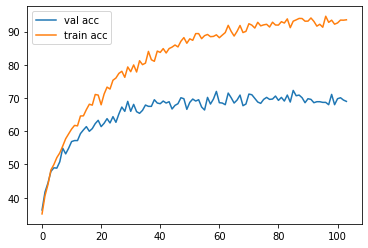


Iteration 200, loss = 1.3949
Checking accuracy on validation set
Got 695 / 1000 correct (69.50)
Checking accuracy on train set
Got 45427 / 49000 correct (92.71)


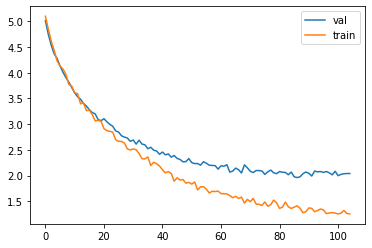

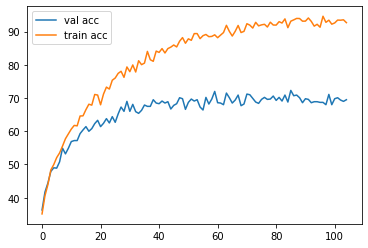


Iteration 400, loss = 1.1771
Checking accuracy on validation set
Got 689 / 1000 correct (68.90)
Checking accuracy on train set
Got 46387 / 49000 correct (94.67)


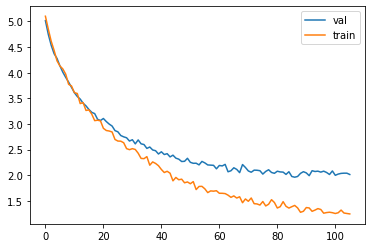

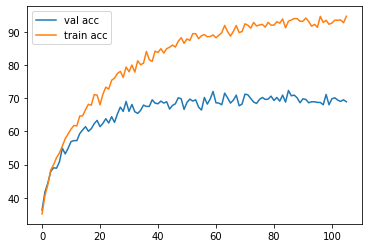


Iteration 600, loss = 1.3062
Checking accuracy on validation set
Got 685 / 1000 correct (68.50)
Checking accuracy on train set
Got 45718 / 49000 correct (93.30)


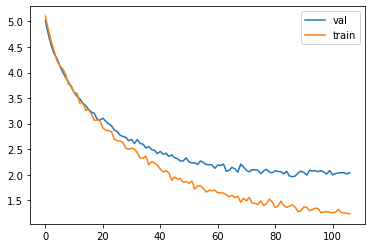

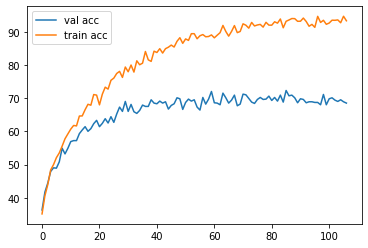


epoch  27
Iteration 0, loss = 1.2644
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)
Checking accuracy on train set
Got 45789 / 49000 correct (93.45)


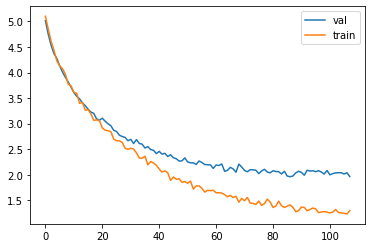

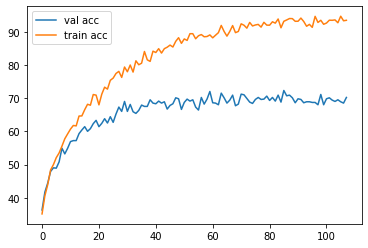


Iteration 200, loss = 1.0892
Checking accuracy on validation set
Got 706 / 1000 correct (70.60)
Checking accuracy on train set
Got 46299 / 49000 correct (94.49)


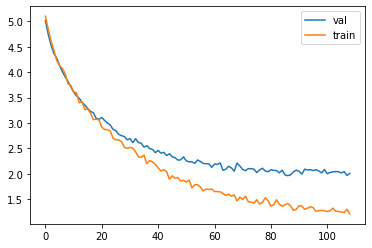

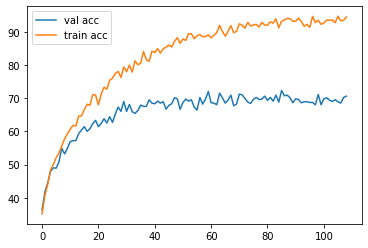


Iteration 400, loss = 1.0667
Checking accuracy on validation set
Got 706 / 1000 correct (70.60)
Checking accuracy on train set
Got 46099 / 49000 correct (94.08)


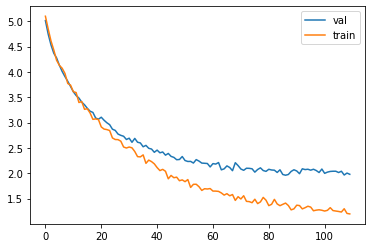

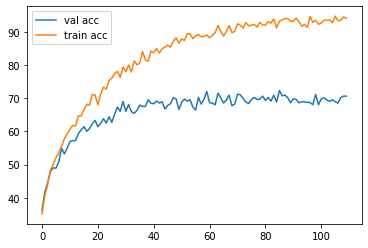


Iteration 600, loss = 1.2424
Checking accuracy on validation set
Got 709 / 1000 correct (70.90)
Checking accuracy on train set
Got 46286 / 49000 correct (94.46)


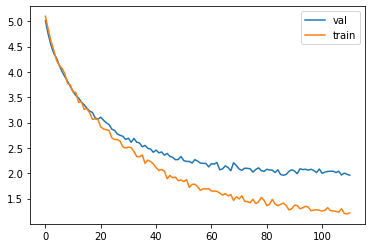

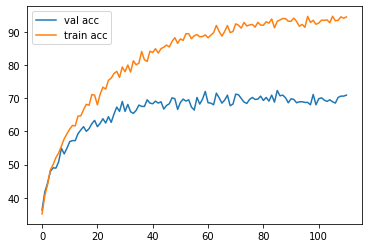


epoch  28
Iteration 0, loss = 1.0511
Checking accuracy on validation set
Got 694 / 1000 correct (69.40)
Checking accuracy on train set
Got 46385 / 49000 correct (94.66)


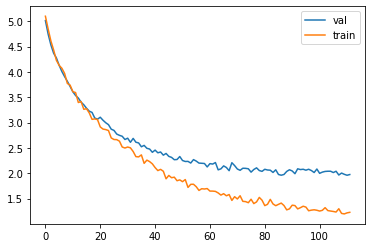

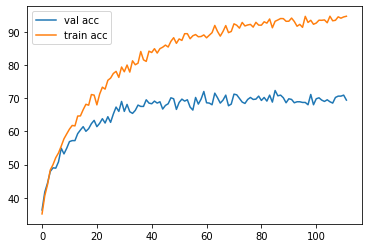


Iteration 200, loss = 1.0933
Checking accuracy on validation set
Got 709 / 1000 correct (70.90)
Checking accuracy on train set
Got 46284 / 49000 correct (94.46)


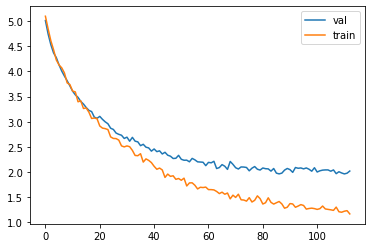

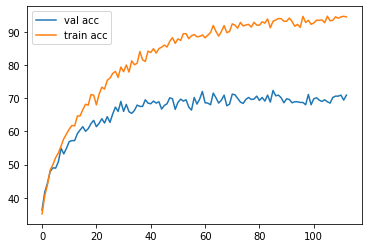


Iteration 400, loss = 1.1795
Checking accuracy on validation set
Got 708 / 1000 correct (70.80)
Checking accuracy on train set
Got 46319 / 49000 correct (94.53)


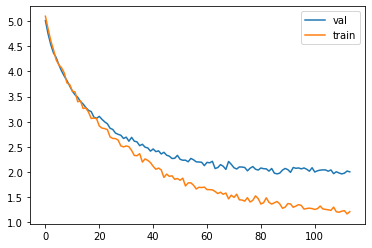

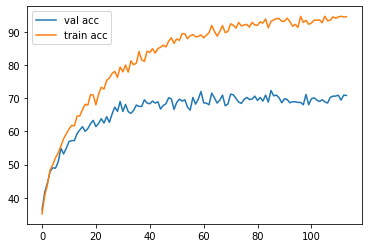


Iteration 600, loss = 1.1435
Checking accuracy on validation set
Got 719 / 1000 correct (71.90)
Checking accuracy on train set
Got 46503 / 49000 correct (94.90)


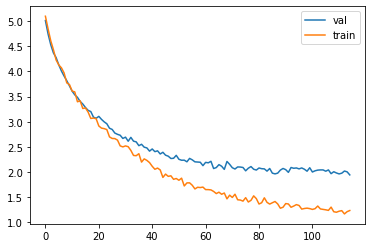

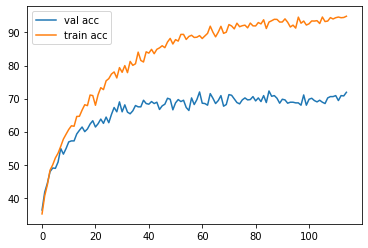


epoch  29
Iteration 0, loss = 1.2692
Checking accuracy on validation set
Got 690 / 1000 correct (69.00)
Checking accuracy on train set
Got 45543 / 49000 correct (92.94)


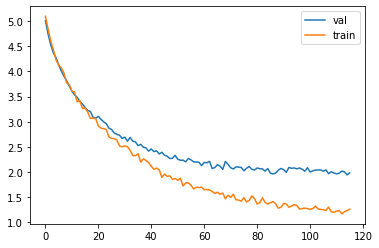

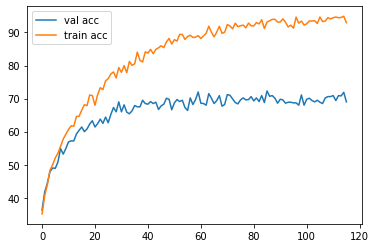


Iteration 200, loss = 1.1960
Checking accuracy on validation set
Got 714 / 1000 correct (71.40)
Checking accuracy on train set
Got 46397 / 49000 correct (94.69)


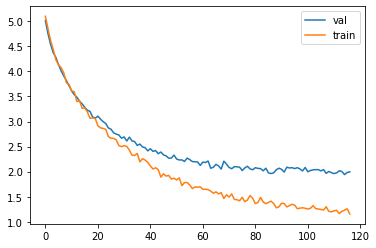

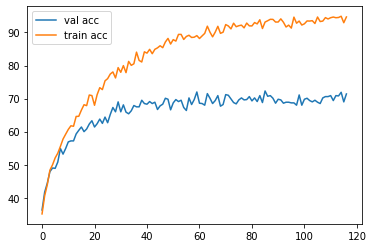


Iteration 400, loss = 1.3384
Checking accuracy on validation set
Got 709 / 1000 correct (70.90)
Checking accuracy on train set
Got 46389 / 49000 correct (94.67)


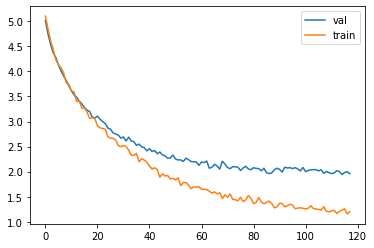

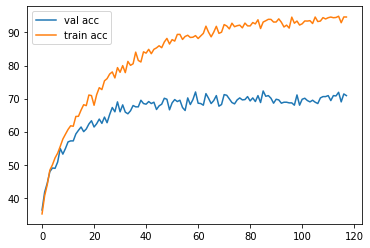


Iteration 600, loss = 1.2599
Checking accuracy on validation set
Got 689 / 1000 correct (68.90)
Checking accuracy on train set
Got 46198 / 49000 correct (94.28)


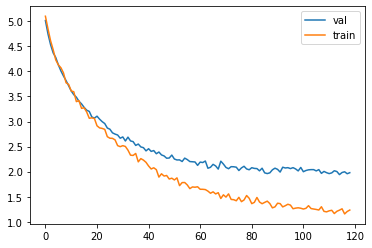

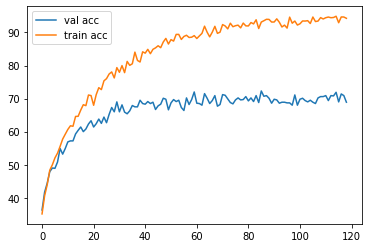


epoch  30
Iteration 0, loss = 1.1805
Checking accuracy on validation set
Got 698 / 1000 correct (69.80)
Checking accuracy on train set
Got 46437 / 49000 correct (94.77)


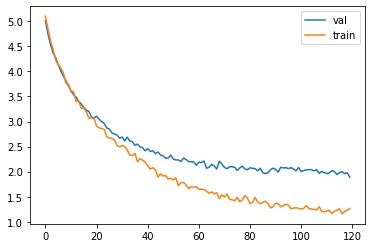

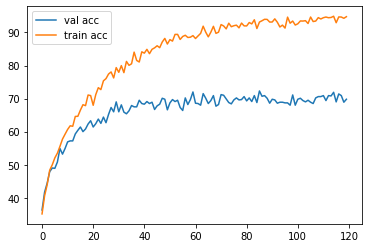


Iteration 200, loss = 1.1490
Checking accuracy on validation set
Got 712 / 1000 correct (71.20)
Checking accuracy on train set
Got 46482 / 49000 correct (94.86)


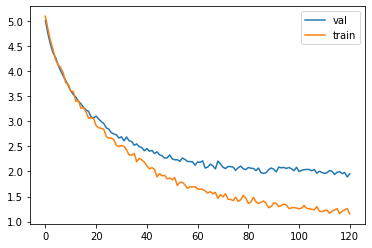

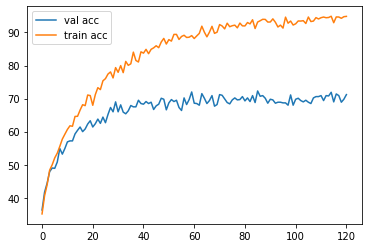


Iteration 400, loss = 1.1152
Checking accuracy on validation set
Got 713 / 1000 correct (71.30)
Checking accuracy on train set
Got 46358 / 49000 correct (94.61)


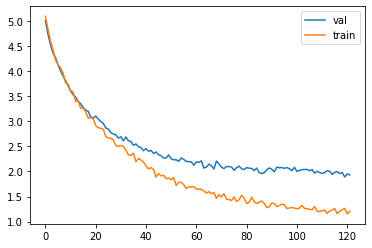

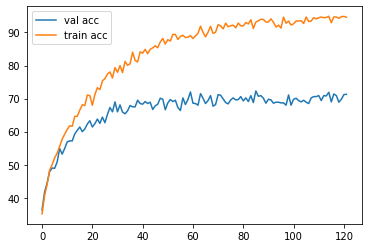


Iteration 600, loss = 1.2369
Checking accuracy on validation set
Got 716 / 1000 correct (71.60)
Checking accuracy on train set
Got 46581 / 49000 correct (95.06)


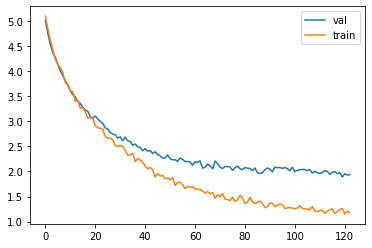

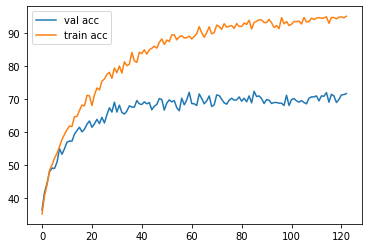


epoch  31
Iteration 0, loss = 1.4346
Checking accuracy on validation set
Got 718 / 1000 correct (71.80)
Checking accuracy on train set
Got 46213 / 49000 correct (94.31)


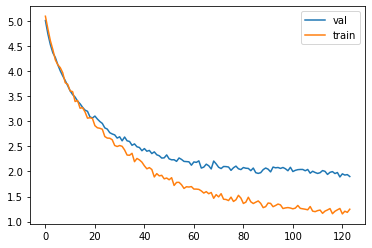

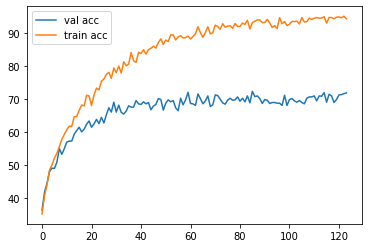


Iteration 200, loss = 1.1518
Checking accuracy on validation set
Got 699 / 1000 correct (69.90)
Checking accuracy on train set
Got 46814 / 49000 correct (95.54)


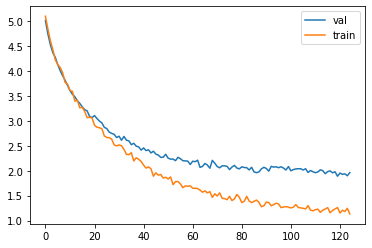

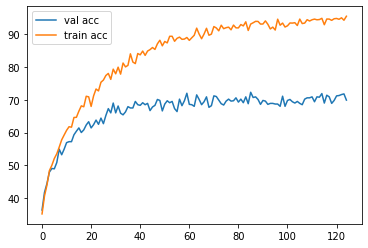


Iteration 400, loss = 1.2503
Checking accuracy on validation set
Got 698 / 1000 correct (69.80)
Checking accuracy on train set
Got 46308 / 49000 correct (94.51)


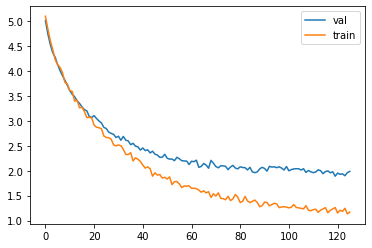

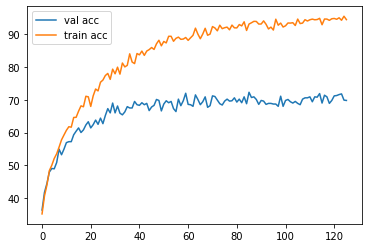


Iteration 600, loss = 1.1510
Checking accuracy on validation set
Got 716 / 1000 correct (71.60)
Checking accuracy on train set
Got 46662 / 49000 correct (95.23)


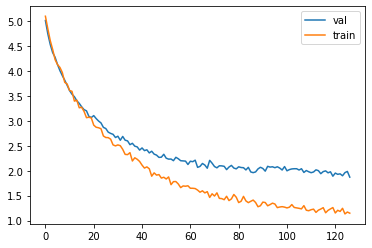

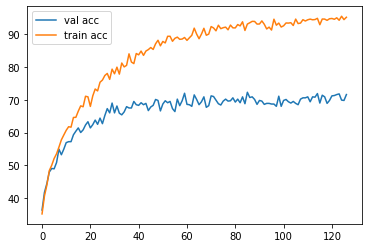


epoch  32
Iteration 0, loss = 1.0975
Checking accuracy on validation set
Got 732 / 1000 correct (73.20)
Checking accuracy on train set
Got 46768 / 49000 correct (95.44)


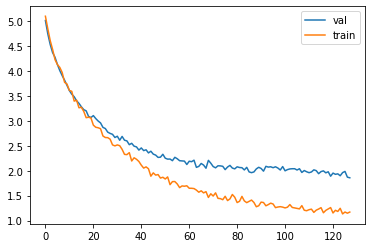

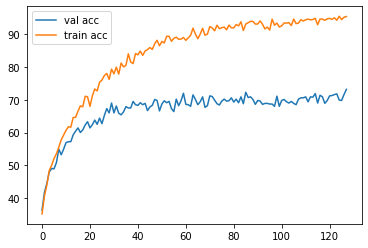


Iteration 200, loss = 1.0479
Checking accuracy on validation set
Got 715 / 1000 correct (71.50)
Checking accuracy on train set
Got 46409 / 49000 correct (94.71)


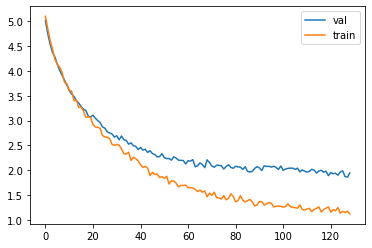

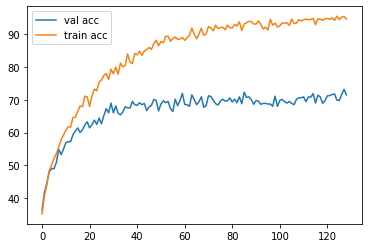


Iteration 400, loss = 1.1975
Checking accuracy on validation set
Got 708 / 1000 correct (70.80)
Checking accuracy on train set
Got 46205 / 49000 correct (94.30)


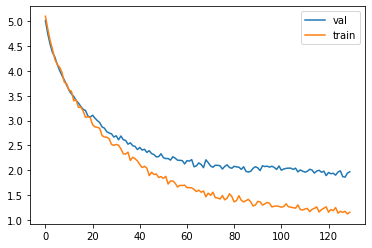

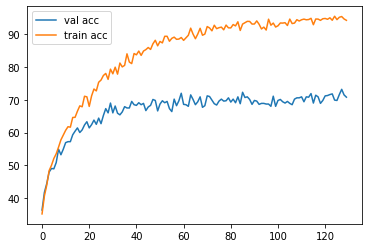


Iteration 600, loss = 1.3124
Checking accuracy on validation set
Got 685 / 1000 correct (68.50)
Checking accuracy on train set
Got 46021 / 49000 correct (93.92)


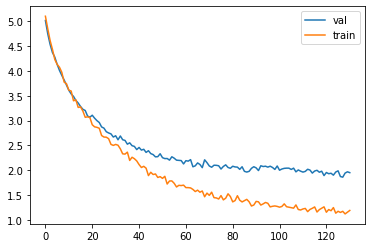

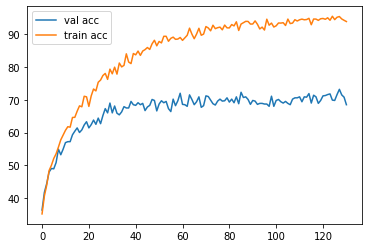


epoch  33
Iteration 0, loss = 1.1528
Checking accuracy on validation set
Got 704 / 1000 correct (70.40)
Checking accuracy on train set
Got 46607 / 49000 correct (95.12)


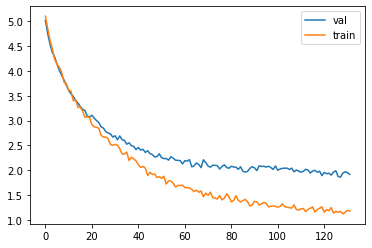

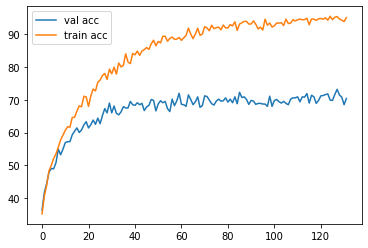


Iteration 200, loss = 1.1489
Checking accuracy on validation set
Got 727 / 1000 correct (72.70)
Checking accuracy on train set
Got 46823 / 49000 correct (95.56)


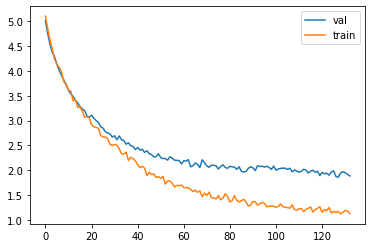

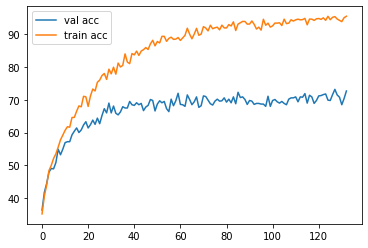


Iteration 400, loss = 1.1825
Checking accuracy on validation set
Got 694 / 1000 correct (69.40)
Checking accuracy on train set
Got 46114 / 49000 correct (94.11)


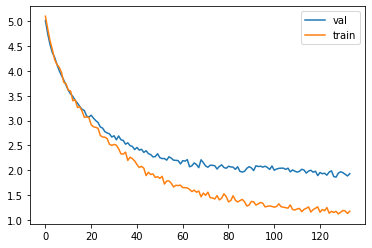

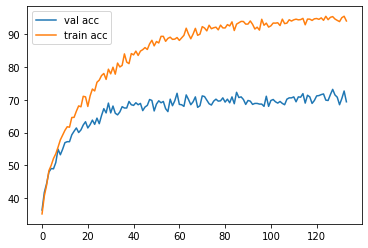


Iteration 600, loss = 1.2570
Checking accuracy on validation set
Got 700 / 1000 correct (70.00)
Checking accuracy on train set
Got 46393 / 49000 correct (94.68)


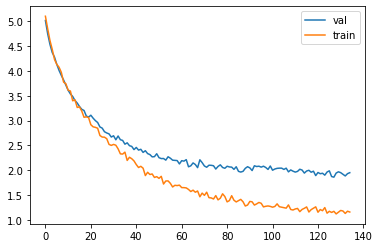

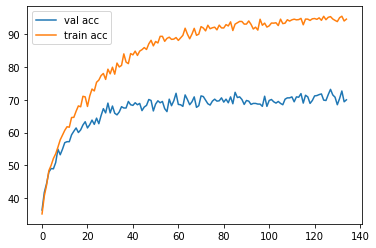


epoch  34
Iteration 0, loss = 0.9978
Checking accuracy on validation set
Got 705 / 1000 correct (70.50)
Checking accuracy on train set
Got 46841 / 49000 correct (95.59)


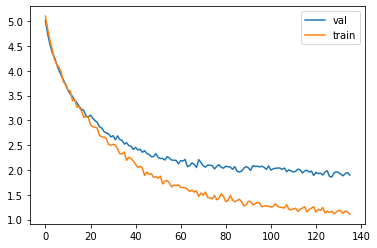

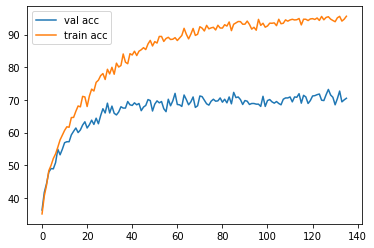


Iteration 200, loss = 1.0239
Checking accuracy on validation set
Got 722 / 1000 correct (72.20)
Checking accuracy on train set
Got 46959 / 49000 correct (95.83)


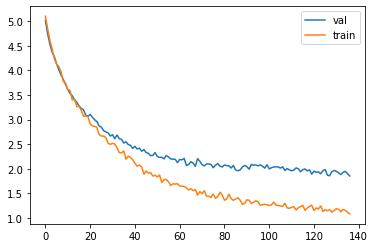

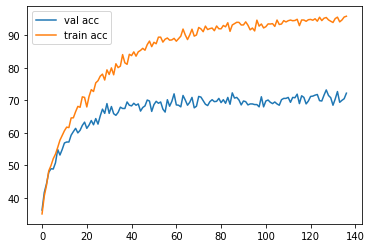


Iteration 400, loss = 1.0581
Checking accuracy on validation set
Got 698 / 1000 correct (69.80)
Checking accuracy on train set
Got 46307 / 49000 correct (94.50)


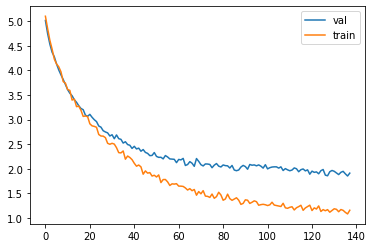

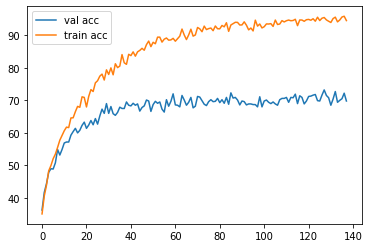


Iteration 600, loss = 1.2834
Checking accuracy on validation set
Got 710 / 1000 correct (71.00)
Checking accuracy on train set
Got 46210 / 49000 correct (94.31)


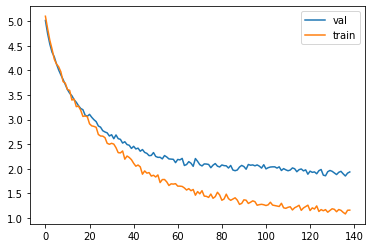

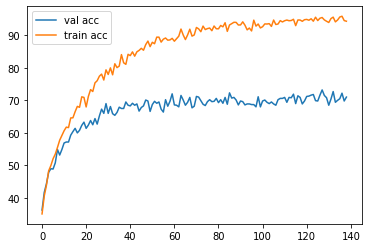


epoch  35
Iteration 0, loss = 1.1382
Checking accuracy on validation set
Got 707 / 1000 correct (70.70)
Checking accuracy on train set
Got 46227 / 49000 correct (94.34)


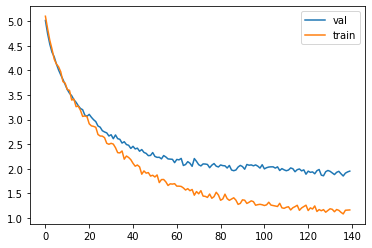

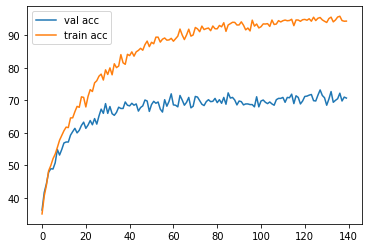


Iteration 200, loss = 1.1679
Checking accuracy on validation set
Got 720 / 1000 correct (72.00)
Checking accuracy on train set
Got 46332 / 49000 correct (94.56)


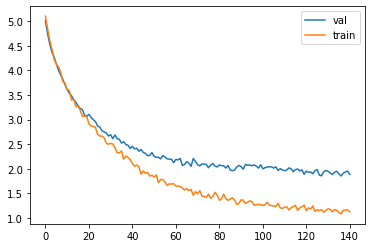

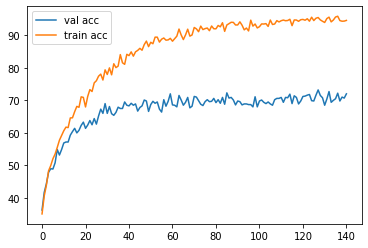


Iteration 400, loss = 1.2840
Checking accuracy on validation set
Got 715 / 1000 correct (71.50)
Checking accuracy on train set
Got 46151 / 49000 correct (94.19)


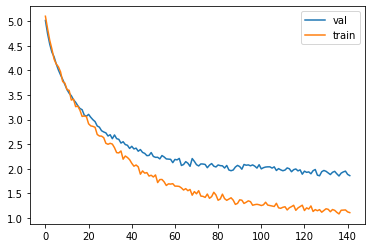

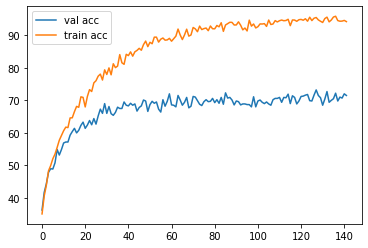


Iteration 600, loss = 1.0917
Checking accuracy on validation set
Got 705 / 1000 correct (70.50)
Checking accuracy on train set
Got 45565 / 49000 correct (92.99)


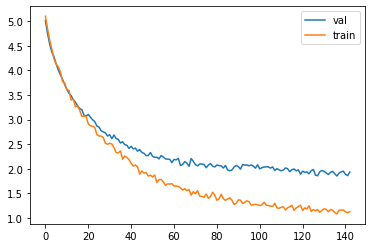

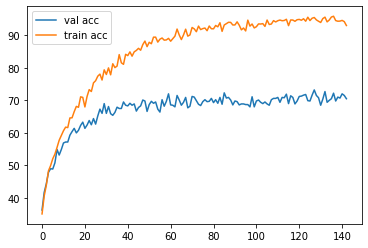


epoch  36
Iteration 0, loss = 1.0554
Checking accuracy on validation set
Got 698 / 1000 correct (69.80)
Checking accuracy on train set
Got 45858 / 49000 correct (93.59)


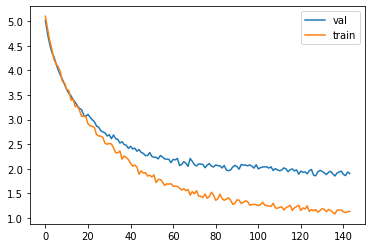

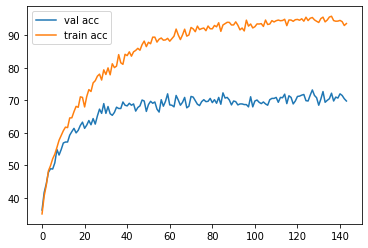


Iteration 200, loss = 0.9848
Checking accuracy on validation set
Got 722 / 1000 correct (72.20)
Checking accuracy on train set
Got 46445 / 49000 correct (94.79)


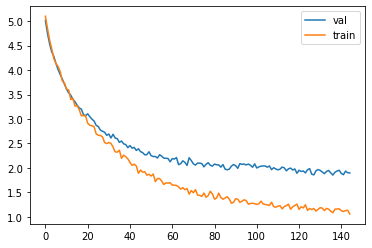

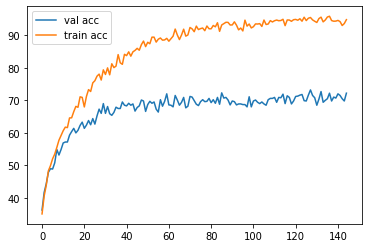


Iteration 400, loss = 1.1537
Checking accuracy on validation set
Got 709 / 1000 correct (70.90)
Checking accuracy on train set
Got 46952 / 49000 correct (95.82)


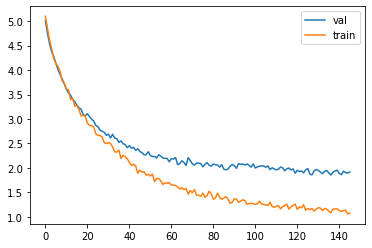

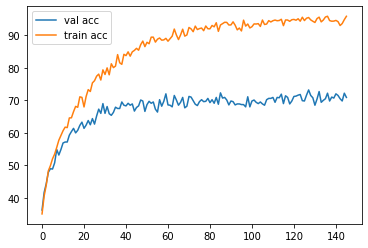


Iteration 600, loss = 1.1259
Checking accuracy on validation set
Got 715 / 1000 correct (71.50)
Checking accuracy on train set
Got 46503 / 49000 correct (94.90)


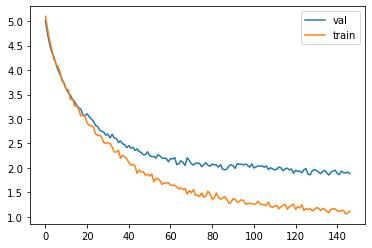

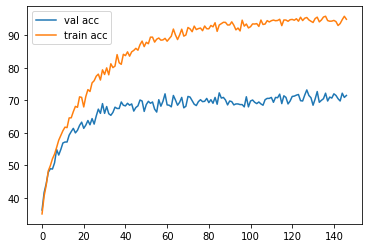


epoch  37
Iteration 0, loss = 1.0027
Checking accuracy on validation set
Got 723 / 1000 correct (72.30)
Checking accuracy on train set
Got 46842 / 49000 correct (95.60)


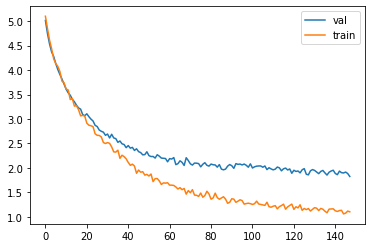

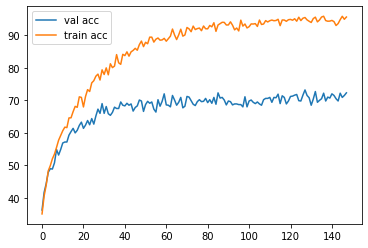


Iteration 200, loss = 1.0130
Checking accuracy on validation set
Got 720 / 1000 correct (72.00)
Checking accuracy on train set
Got 46881 / 49000 correct (95.68)


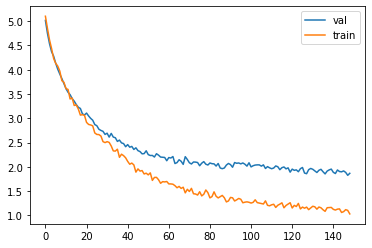

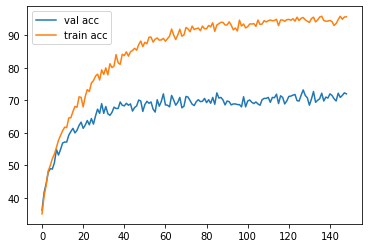


Iteration 400, loss = 0.9889
Checking accuracy on validation set
Got 716 / 1000 correct (71.60)
Checking accuracy on train set
Got 46672 / 49000 correct (95.25)


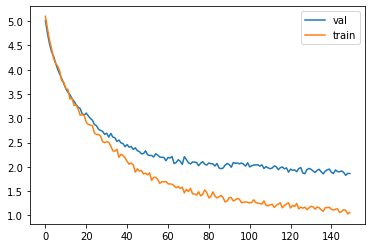

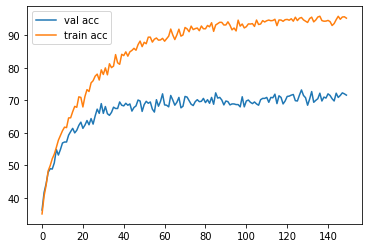


Iteration 600, loss = 1.0847
Checking accuracy on validation set
Got 709 / 1000 correct (70.90)
Checking accuracy on train set
Got 46677 / 49000 correct (95.26)


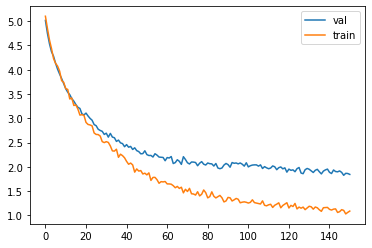

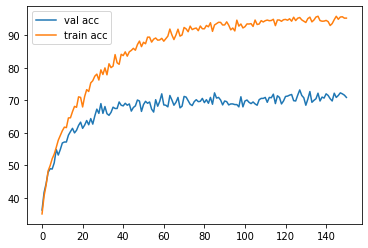


epoch  38
Iteration 0, loss = 1.0537
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)
Checking accuracy on train set
Got 46059 / 49000 correct (94.00)


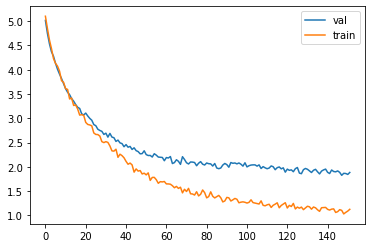

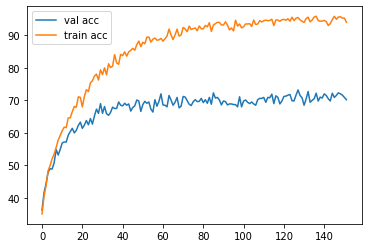


Iteration 200, loss = 1.0494
Checking accuracy on validation set
Got 724 / 1000 correct (72.40)
Checking accuracy on train set
Got 46494 / 49000 correct (94.89)


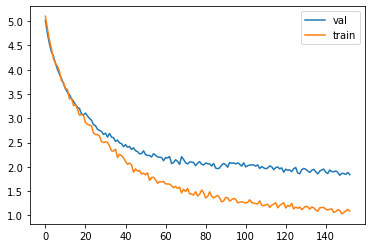

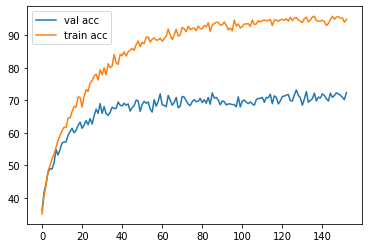


Iteration 400, loss = 1.0724
Checking accuracy on validation set
Got 719 / 1000 correct (71.90)
Checking accuracy on train set
Got 46707 / 49000 correct (95.32)


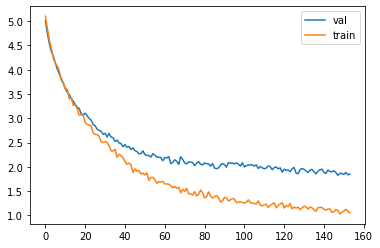

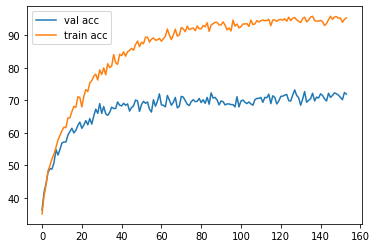


Iteration 600, loss = 1.0009
Checking accuracy on validation set
Got 707 / 1000 correct (70.70)
Checking accuracy on train set
Got 46412 / 49000 correct (94.72)


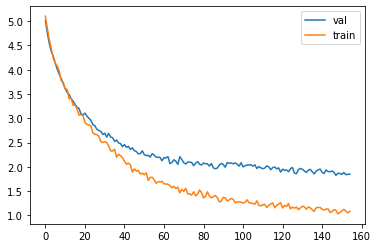

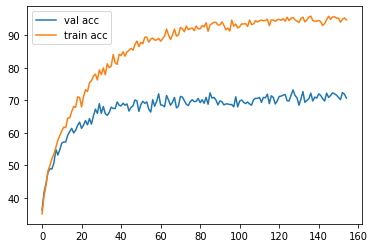


epoch  39
Iteration 0, loss = 0.9830
Checking accuracy on validation set
Got 725 / 1000 correct (72.50)
Checking accuracy on train set
Got 46374 / 49000 correct (94.64)


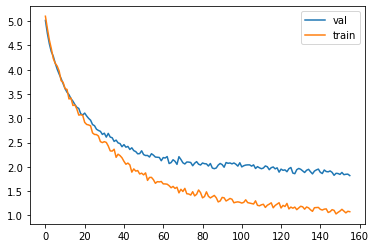

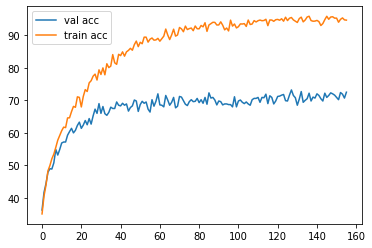


Iteration 200, loss = 1.0197
Checking accuracy on validation set
Got 707 / 1000 correct (70.70)
Checking accuracy on train set
Got 46831 / 49000 correct (95.57)


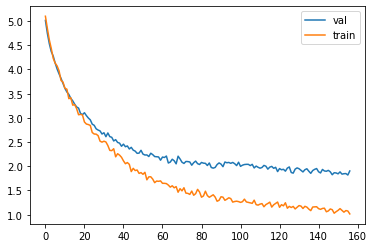

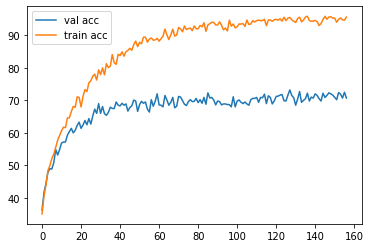


Iteration 400, loss = 0.9790
Checking accuracy on validation set
Got 706 / 1000 correct (70.60)
Checking accuracy on train set
Got 46981 / 49000 correct (95.88)


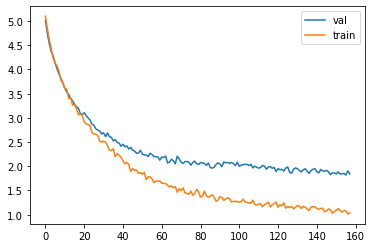

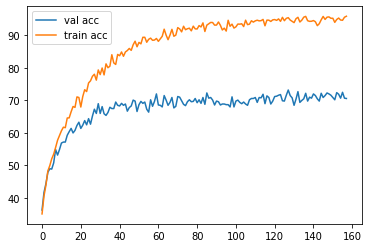


Iteration 600, loss = 1.1005
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)
Checking accuracy on train set
Got 46659 / 49000 correct (95.22)


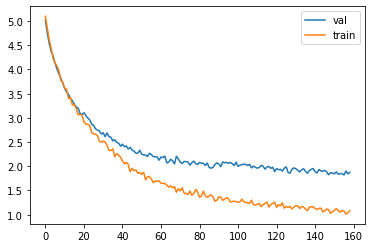

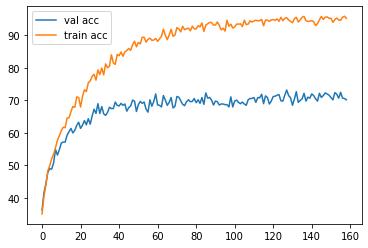


epoch  40
Iteration 0, loss = 1.1687
Checking accuracy on validation set
Got 697 / 1000 correct (69.70)
Checking accuracy on train set
Got 46512 / 49000 correct (94.92)


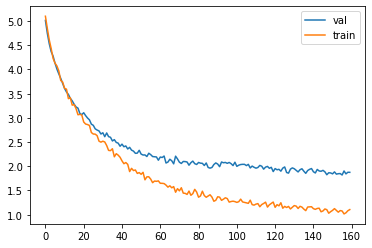

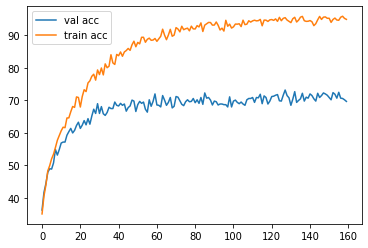


Iteration 200, loss = 1.0325
Checking accuracy on validation set
Got 728 / 1000 correct (72.80)
Checking accuracy on train set
Got 46972 / 49000 correct (95.86)


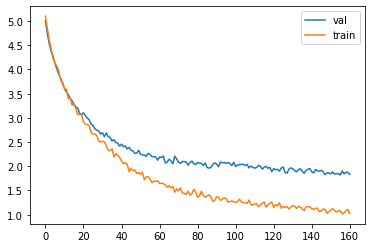

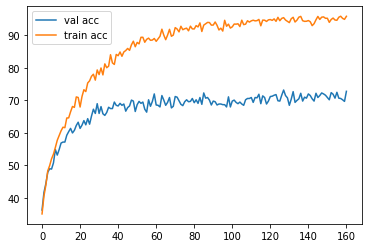


Iteration 400, loss = 1.1655
Checking accuracy on validation set
Got 700 / 1000 correct (70.00)
Checking accuracy on train set
Got 46432 / 49000 correct (94.76)


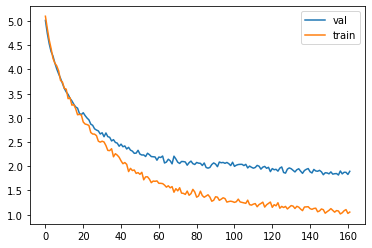

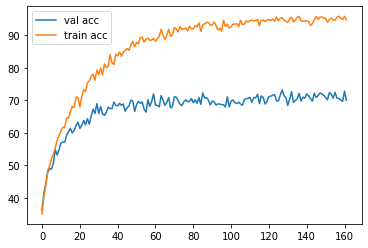


Iteration 600, loss = 1.0285
Checking accuracy on validation set
Got 728 / 1000 correct (72.80)
Checking accuracy on train set
Got 46657 / 49000 correct (95.22)


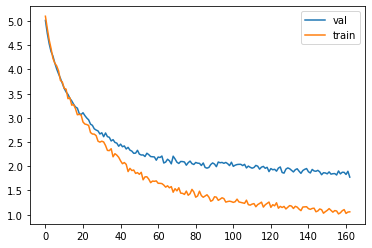

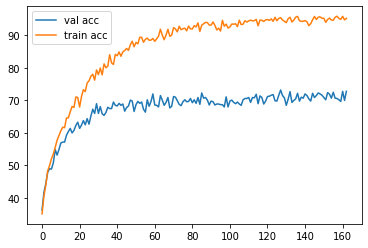


epoch  41
Iteration 0, loss = 0.9771
Checking accuracy on validation set
Got 706 / 1000 correct (70.60)
Checking accuracy on train set
Got 46211 / 49000 correct (94.31)


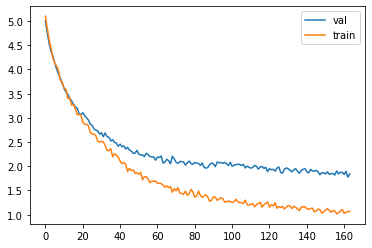

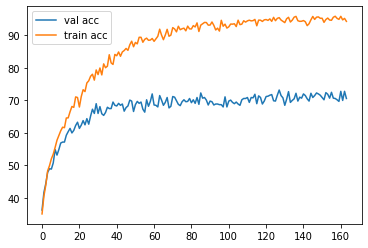


Iteration 200, loss = 1.0974
Checking accuracy on validation set
Got 732 / 1000 correct (73.20)
Checking accuracy on train set
Got 46677 / 49000 correct (95.26)


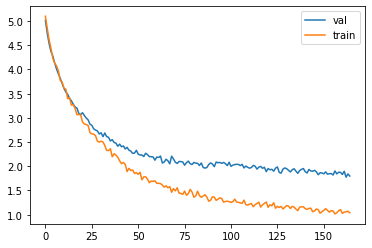

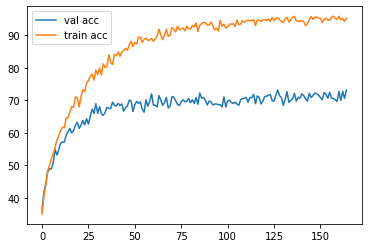


Iteration 400, loss = 1.0918
Checking accuracy on validation set
Got 704 / 1000 correct (70.40)
Checking accuracy on train set
Got 46839 / 49000 correct (95.59)


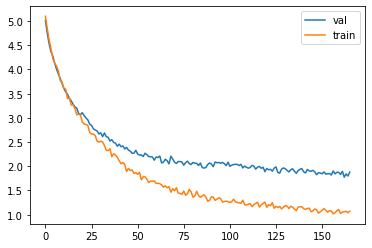

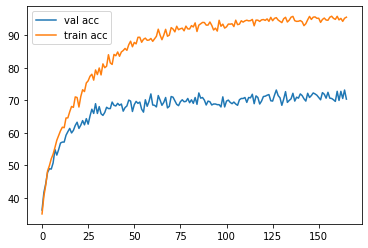


Iteration 600, loss = 1.0735
Checking accuracy on validation set
Got 722 / 1000 correct (72.20)
Checking accuracy on train set
Got 47120 / 49000 correct (96.16)


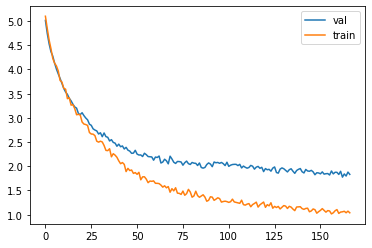

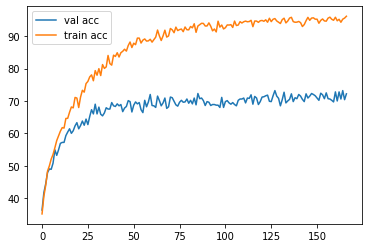


epoch  42
Iteration 0, loss = 1.1214
Checking accuracy on validation set
Got 717 / 1000 correct (71.70)
Checking accuracy on train set
Got 46608 / 49000 correct (95.12)


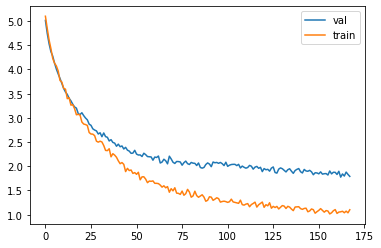

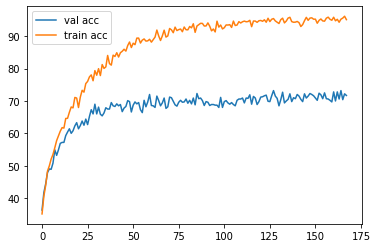


Iteration 200, loss = 0.9997
Checking accuracy on validation set
Got 717 / 1000 correct (71.70)
Checking accuracy on train set
Got 46830 / 49000 correct (95.57)


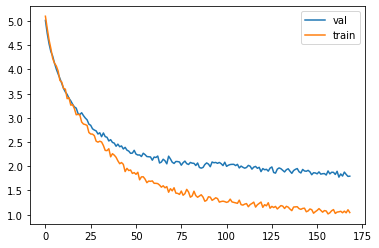

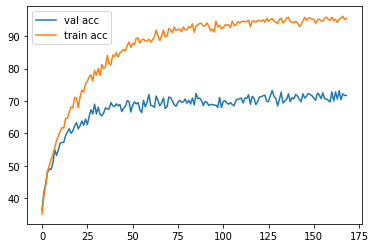


Iteration 400, loss = 0.9421
Checking accuracy on validation set
Got 721 / 1000 correct (72.10)
Checking accuracy on train set
Got 46593 / 49000 correct (95.09)


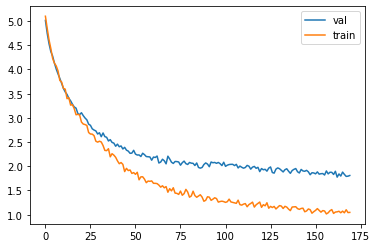

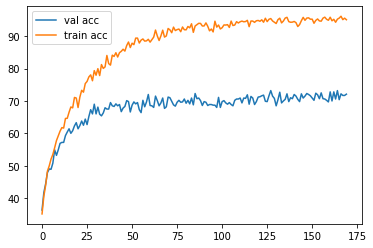


Iteration 600, loss = 0.9374
Checking accuracy on validation set
Got 724 / 1000 correct (72.40)
Checking accuracy on train set
Got 46938 / 49000 correct (95.79)


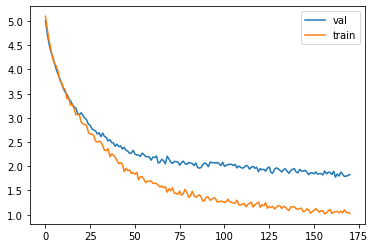

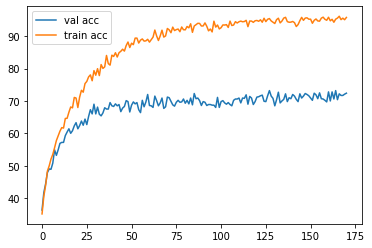


epoch  43
Iteration 0, loss = 0.9640
Checking accuracy on validation set
Got 720 / 1000 correct (72.00)
Checking accuracy on train set
Got 46605 / 49000 correct (95.11)


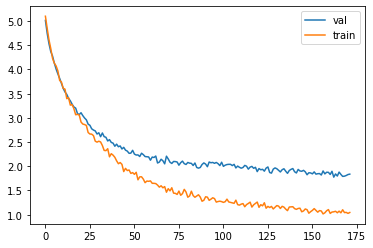

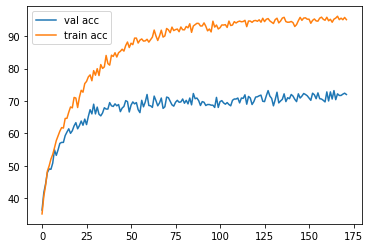


Iteration 200, loss = 0.9439
Checking accuracy on validation set
Got 712 / 1000 correct (71.20)
Checking accuracy on train set
Got 46624 / 49000 correct (95.15)


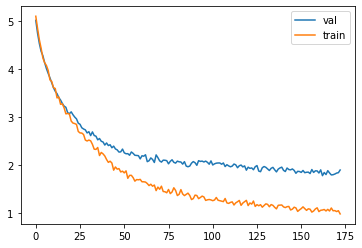

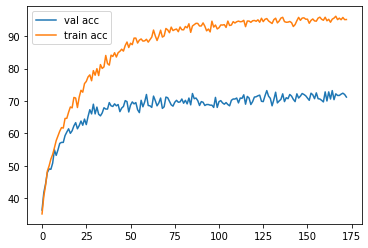


Iteration 400, loss = 0.9663
Checking accuracy on validation set
Got 714 / 1000 correct (71.40)
Checking accuracy on train set
Got 46783 / 49000 correct (95.48)


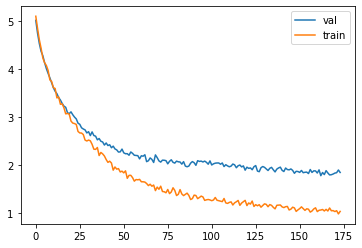

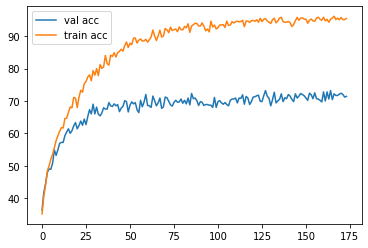


Iteration 600, loss = 1.1473
Checking accuracy on validation set
Got 712 / 1000 correct (71.20)
Checking accuracy on train set
Got 46901 / 49000 correct (95.72)


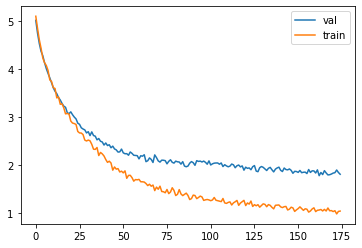

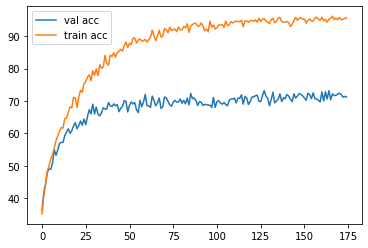


epoch  44
Iteration 0, loss = 0.9561
Checking accuracy on validation set
Got 717 / 1000 correct (71.70)
Checking accuracy on train set
Got 47163 / 49000 correct (96.25)


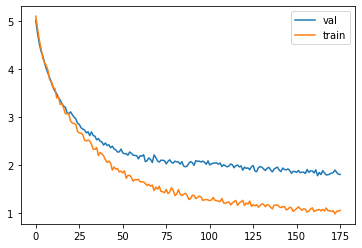

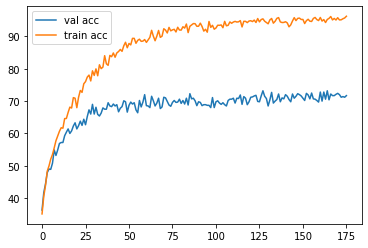


Iteration 200, loss = 0.9996
Checking accuracy on validation set
Got 711 / 1000 correct (71.10)
Checking accuracy on train set
Got 47182 / 49000 correct (96.29)


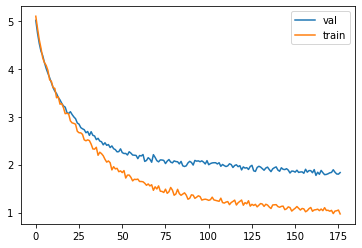

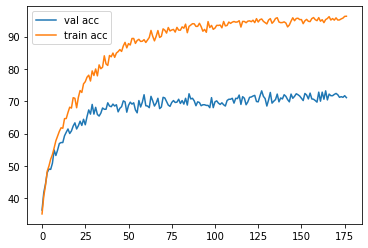


Iteration 400, loss = 1.0317
Checking accuracy on validation set
Got 708 / 1000 correct (70.80)
Checking accuracy on train set
Got 46460 / 49000 correct (94.82)


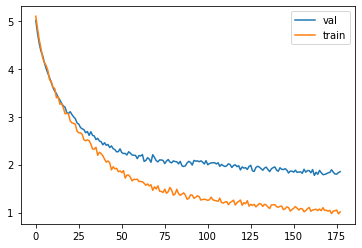

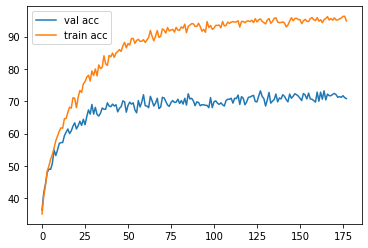


Iteration 600, loss = 1.0616
Checking accuracy on validation set
Got 706 / 1000 correct (70.60)
Checking accuracy on train set
Got 46609 / 49000 correct (95.12)


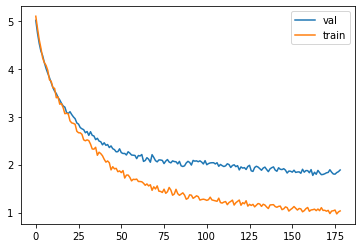

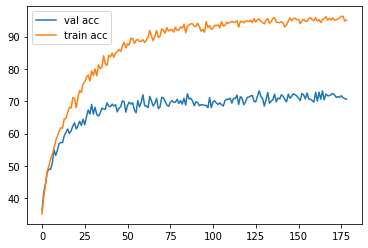


epoch  45
Iteration 0, loss = 0.9258
Checking accuracy on validation set
Got 714 / 1000 correct (71.40)
Checking accuracy on train set
Got 46752 / 49000 correct (95.41)


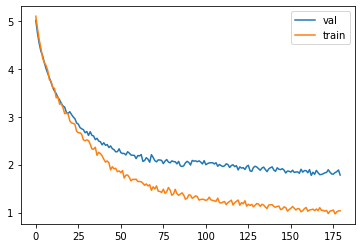

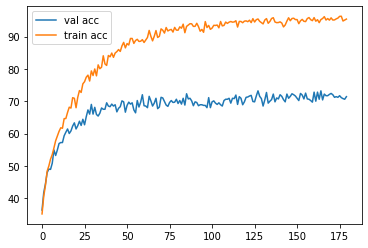


Iteration 200, loss = 0.9484
Checking accuracy on validation set
Got 703 / 1000 correct (70.30)
Checking accuracy on train set
Got 46936 / 49000 correct (95.79)


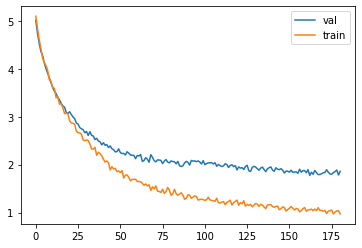

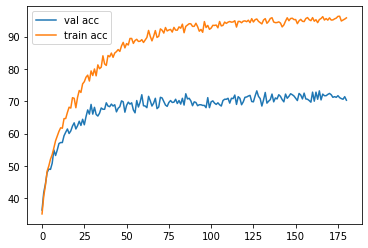


Iteration 400, loss = 0.9084
Checking accuracy on validation set
Got 707 / 1000 correct (70.70)
Checking accuracy on train set
Got 46543 / 49000 correct (94.99)


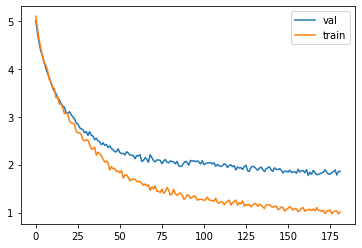

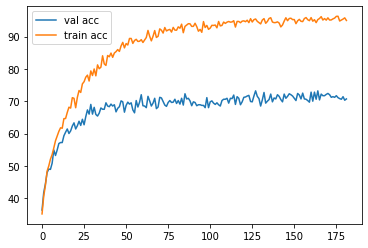


Iteration 600, loss = 0.9571
Checking accuracy on validation set
Got 724 / 1000 correct (72.40)
Checking accuracy on train set
Got 47114 / 49000 correct (96.15)


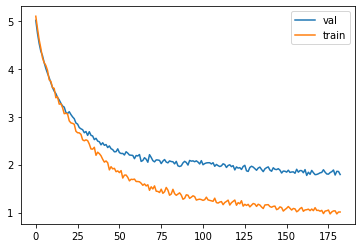

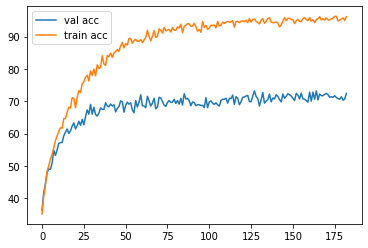


epoch  46
Iteration 0, loss = 0.8825
Checking accuracy on validation set
Got 735 / 1000 correct (73.50)
Checking accuracy on train set
Got 46858 / 49000 correct (95.63)


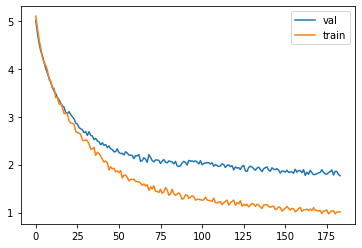

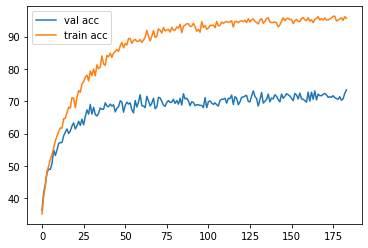


Iteration 200, loss = 0.9524
Checking accuracy on validation set
Got 721 / 1000 correct (72.10)
Checking accuracy on train set
Got 46874 / 49000 correct (95.66)


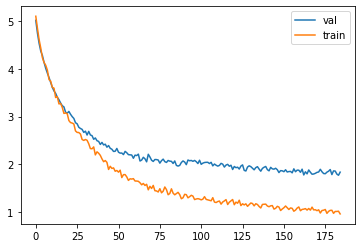

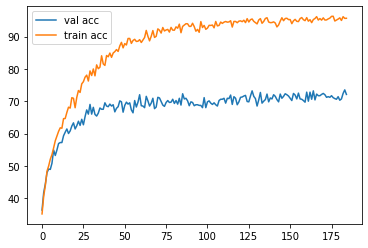


Iteration 400, loss = 0.9961
Checking accuracy on validation set
Got 739 / 1000 correct (73.90)
Checking accuracy on train set
Got 46896 / 49000 correct (95.71)


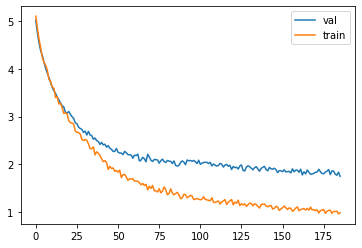

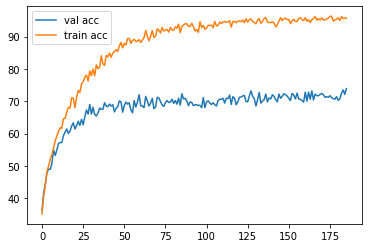


Iteration 600, loss = 1.0960
Checking accuracy on validation set
Got 717 / 1000 correct (71.70)
Checking accuracy on train set
Got 46619 / 49000 correct (95.14)


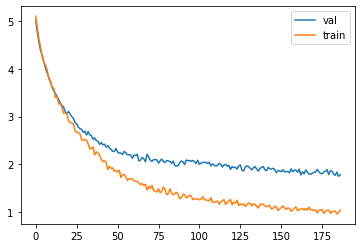

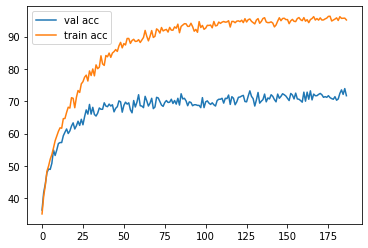


epoch  47
Iteration 0, loss = 1.0440
Checking accuracy on validation set
Got 726 / 1000 correct (72.60)
Checking accuracy on train set
Got 46976 / 49000 correct (95.87)


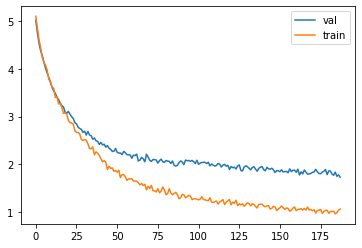

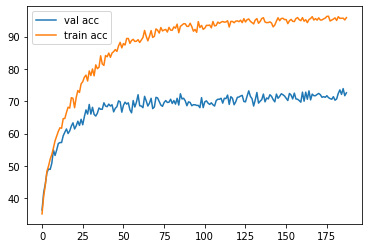


Iteration 200, loss = 1.0558
Checking accuracy on validation set
Got 711 / 1000 correct (71.10)
Checking accuracy on train set
Got 46615 / 49000 correct (95.13)


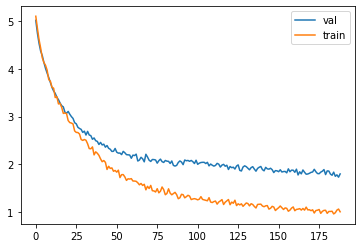

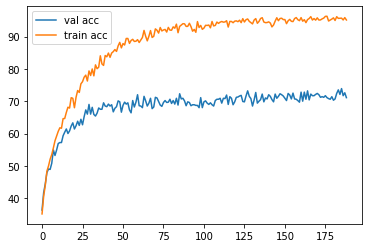


Iteration 400, loss = 0.9342
Checking accuracy on validation set
Got 717 / 1000 correct (71.70)
Checking accuracy on train set
Got 47257 / 49000 correct (96.44)


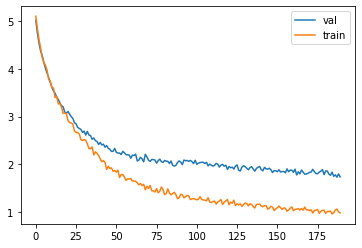

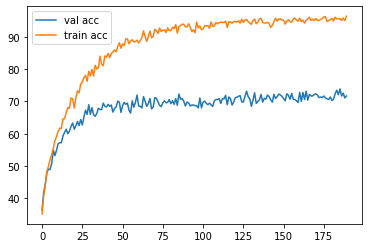


Iteration 600, loss = 1.0431
Checking accuracy on validation set
Got 739 / 1000 correct (73.90)
Checking accuracy on train set
Got 47079 / 49000 correct (96.08)


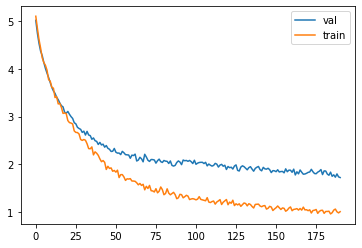

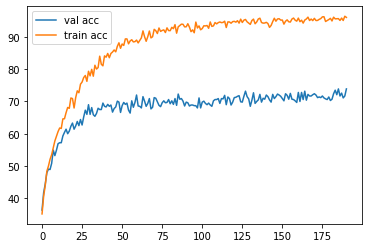


epoch  48
Iteration 0, loss = 0.9537
Checking accuracy on validation set
Got 731 / 1000 correct (73.10)
Checking accuracy on train set
Got 47038 / 49000 correct (96.00)


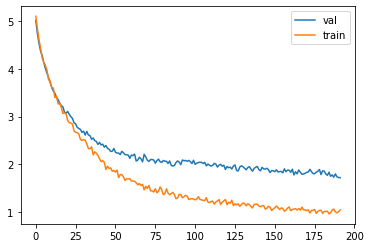

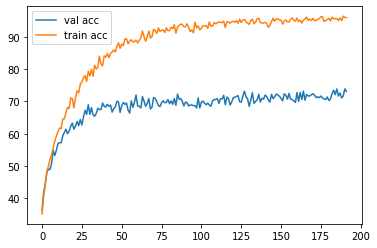


Iteration 200, loss = 0.9088
Checking accuracy on validation set
Got 710 / 1000 correct (71.00)
Checking accuracy on train set
Got 47193 / 49000 correct (96.31)


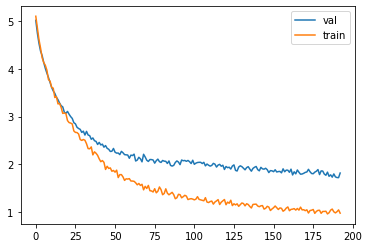

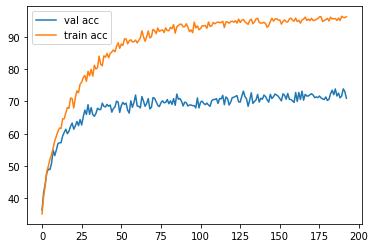


Iteration 400, loss = 0.8619
Checking accuracy on validation set
Got 733 / 1000 correct (73.30)
Checking accuracy on train set
Got 47090 / 49000 correct (96.10)


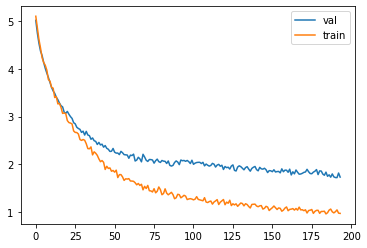

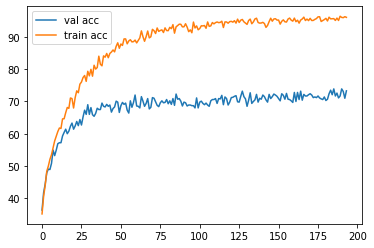


Iteration 600, loss = 1.0045
Checking accuracy on validation set
Got 732 / 1000 correct (73.20)
Checking accuracy on train set
Got 47002 / 49000 correct (95.92)


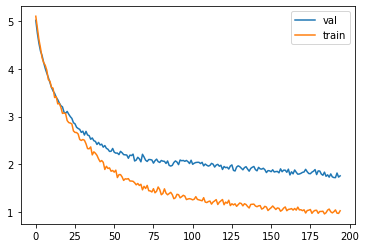

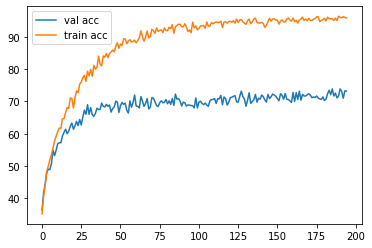


epoch  49
Iteration 0, loss = 0.9059
Checking accuracy on validation set
Got 721 / 1000 correct (72.10)
Checking accuracy on train set
Got 46796 / 49000 correct (95.50)


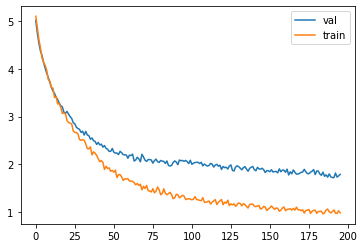

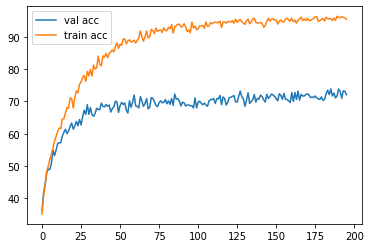


Iteration 200, loss = 1.0459
Checking accuracy on validation set
Got 733 / 1000 correct (73.30)
Checking accuracy on train set
Got 47416 / 49000 correct (96.77)


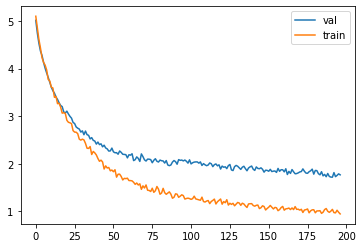

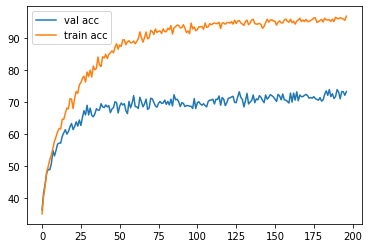


Iteration 400, loss = 0.8944
Checking accuracy on validation set
Got 735 / 1000 correct (73.50)
Checking accuracy on train set
Got 46935 / 49000 correct (95.79)


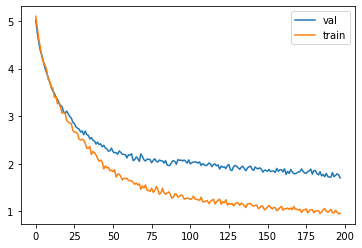

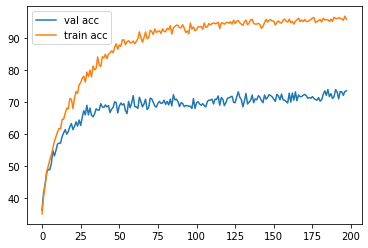


Iteration 600, loss = 0.9858
Checking accuracy on validation set
Got 734 / 1000 correct (73.40)
Checking accuracy on train set
Got 46941 / 49000 correct (95.80)


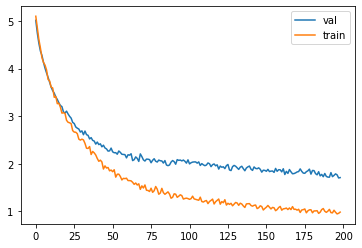

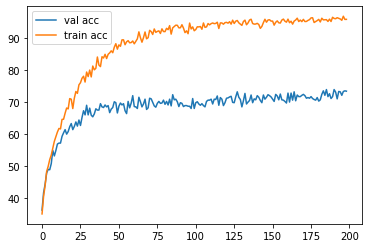


Wed Oct  7 14:48:29 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   45C    P0    40W / 250W |  13265MiB / 16280MiB |     39%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+------

(1.0803430475247133, 70.1)

In [85]:
# Another model

import torch
# assert '.'.join(torch.__version__.split('.')[:2]) == '1.4'
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler

import torchvision.datasets as dset
import torchvision.transforms as T

import numpy as np

NUM_TRAIN = 49000

# The torchvision.transforms package provides tools for preprocessing data
# and for performing data augmentation; here we set up a transform to
# preprocess the data by subtracting the mean RGB value and dividing by the
# standard deviation of each RGB value; we've hardcoded the mean and std.
transform = T.Compose([
                T.ToTensor(),
                T.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
            ])

# We set up a Dataset object for each split (train / val / test); Datasets load
# training examples one at a time, so we wrap each Dataset in a DataLoader which
# iterates through the Dataset and forms minibatches. We divide the CIFAR-10
# training set into train and val sets by passing a Sampler object to the
# DataLoader telling how it should sample from the underlying Dataset.
cifar10_train = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                             transform=transform)
loader_train = DataLoader(cifar10_train, batch_size=64, 
                          sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN)))

cifar10_val = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                           transform=transform)
loader_val = DataLoader(cifar10_val, batch_size=64, 
                        sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN, 50000)))

cifar10_test = dset.CIFAR10('./cs231n/datasets', train=False, download=True, 
                            transform=transform)
loader_test = DataLoader(cifar10_test, batch_size=64)
!nvidia-smi

USE_GPU = True

dtype = torch.float32 # we will be using float throughout this tutorial

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

# Constant to control how frequently we print train loss

print('using device:', device)
!nvidia-smi

import matplotlib.pyplot as plt
from statistics import mean 
import torch.nn.functional as F  # useful stateless functions

def check_accuracy_part34(loader, model, train_part=False):
    if train_part==False:
      if loader.dataset.train:
          print('Checking accuracy on validation set')
      else:
          print('Checking accuracy on test set')   
    else:
       print('Checking accuracy on train set')
    num_correct = 0
    num_samples = 0
    model.eval()  # set model to evaluation mode

    batch_loss = []
    with torch.no_grad():
        for x, y in loader:
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)
            scores = model(x)
            _, preds = scores.max(1)
            num_correct += (preds == y).sum()
            num_samples += preds.size(0)
            # print(nn.CrossEntropyLoss()(scores, y).type)
            # print(nn.CrossEntropyLoss()(scores, y))

            batch_loss.append(nn.CrossEntropyLoss()(scores, y).item())

        acc = float(num_correct) / num_samples

        print('Got %d / %d correct (%.2f)' % (num_correct, num_samples, 100 * acc))
        return sum(batch_loss)/len(batch_loss), 100 * acc, 
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

def train_part(model, optimizer, epochs=1, ld=0.01, print_every = 100):
    """
    Train a model on CIFAR-10 using the PyTorch Module API.
    
    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model
    - epochs: (Optional) A Python integer giving the number of epochs to train for
    
    Returns: Nothing, but prints model accuracies during training.
    """

    trainning_loss = []
    val_loss = []
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    ave_trainning_loss = 0.0

    train_acc_hist = []
    val_acc_hist  = []
    for e in range(epochs):
        print("epoch ", e)
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            loss = nn.CrossEntropyLoss()(scores, y)

            l2_reg = 0.0
            for param in model.parameters():
                l2_reg += torch.norm(param, 2)
            loss += ld*l2_reg

            ave_trainning_loss = loss.item()*0.1 + 0.9*ave_trainning_loss

            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            # This is the backwards pass: compute the gradient of the loss with
            # respect to each  parameter of the model.
            loss.backward()


            # Actually update the parameters of the model using the gradients
            # computed by the backwards pass.
            optimizer.step()

            if t % print_every == 0:
                print('Iteration %d, loss = %.4f' % (t, loss.item()))
                # print('Valid loss = ', val_loss)
                val_loss_, val_acc = check_accuracy_part34(loader_val, model)
                _, train_acc  = check_accuracy_part34(loader_train, model, train_part=True)
                trainning_loss.append(ave_trainning_loss)
                val_loss.append(val_loss_ + ld*l2_reg)

                train_acc_hist.append(train_acc)
                val_acc_hist.append(vGot 34743 / 49000 correct (70.90)al_acc)

                # print(trainning_loss)
                # print(val_loss)
                if len(val_loss) > 2:
                  plt.plot(list(range(len(val_loss)-1)), val_loss[1:], label='val')
                  plt.plot(list(range(len(trainning_loss)-1)), trainning_loss[1:], label='train')
                  plt.legend()
                  plt.show()

                  plt.plot(list(range(len(val_acc_hist)-1)), val_acc_hist[1:], label='val acc')
                  plt.plot(list(range(len(train_acc_hist)-1)), train_acc_hist[1:], label='train acc')
                  plt.legend()
                  plt.show()
                print()


model = None
optimizer = None

channel_1  = int(32)
channel_2  = int(32)
channel_3  = int(32)

channel_4  = int(32)
channel_5  = int(32)
channel_6  = int(32)

channel_7  = int(64)
channel_8  = int(64)
channel_9  = int(64)

channel_10 = int(128)
channel_11 = int(128)
channel_12 = int(128)

channel_13 = int(256)
channel_14 = int(256)
channel_15 = int(256)

channel_16 = int(512)

# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
def flatten(x):
    N = x.shape[0] # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image
    
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3,         out_channels=channel_1, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_1),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_2, out_channels=channel_3, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_3),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_3, out_channels=channel_4, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_4),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.LeakyReLU(),


    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.LeakyReLU(),


    nn.Conv2d(in_channels=channel_5, out_channels=channel_6, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_6),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_6, out_channels=channel_7, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_7),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_7, out_channels=channel_8, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_8),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_8, out_channels=channel_9, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_9),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_9, out_channels=channel_10, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_10),
    nn.LeakyReLU(),
    
    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_11, out_channels=channel_12, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_12),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_12, out_channels=channel_13, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_13),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_14, out_channels=channel_15, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_15),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_15, out_channels=channel_16, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_16),
    nn.LeakyReLU(),

    # nn.MaxPool2d(2),

    Flatten(),
    nn.Linear(channel_16, 1000),
    nn.Linear(1000, 10)
)

# you can use Nesterov momentum in optim.SGD
learning_rate = 1e-4

optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=0.01)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

# You should get at least 70% accuracy
!nvidia-smi
train_part(model, optimizer, epochs=50, ld=1e-2, print_every=200)
!nvidia-smi
best_model = model
check_accuracy_part34(loader_test, best_model)

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Wed Oct  7 15:54:49 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   73C    P0    73W / 149W |    573MiB / 11441MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+---------------------

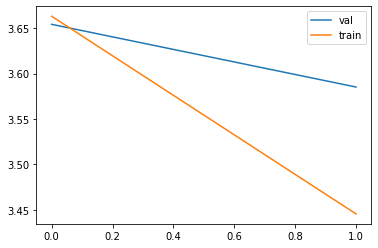

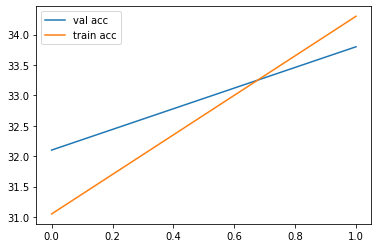


Iteration 600, loss = 3.1882
Checking accuracy on validation set
Got 458 / 1000 correct (45.80)
Checking accuracy on train set
Got 22214 / 49000 correct (45.33)


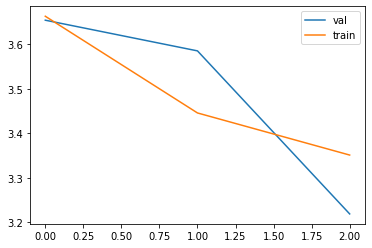

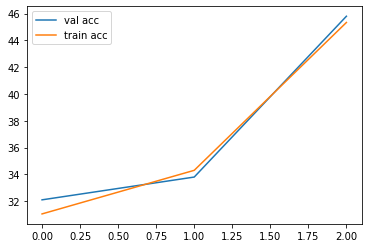


epoch  1
Iteration 0, loss = 3.0918
Checking accuracy on validation set
Got 482 / 1000 correct (48.20)
Checking accuracy on train set
Got 23716 / 49000 correct (48.40)


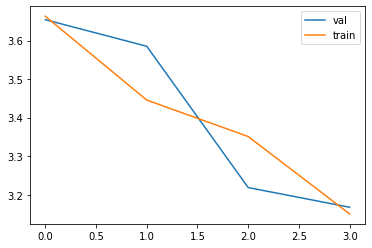

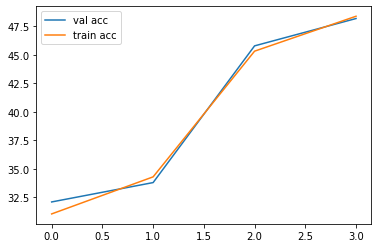


Iteration 200, loss = 3.1687
Checking accuracy on validation set
Got 515 / 1000 correct (51.50)
Checking accuracy on train set
Got 24923 / 49000 correct (50.86)


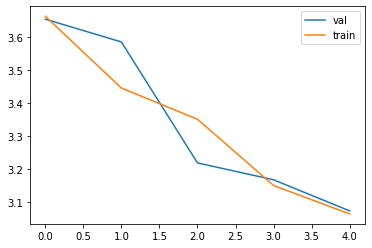

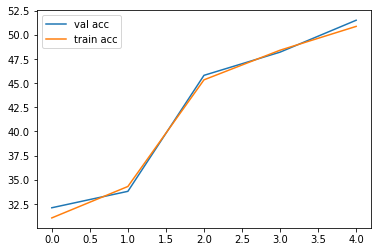


Iteration 400, loss = 2.8188
Checking accuracy on validation set
Got 525 / 1000 correct (52.50)
Checking accuracy on train set
Got 25539 / 49000 correct (52.12)


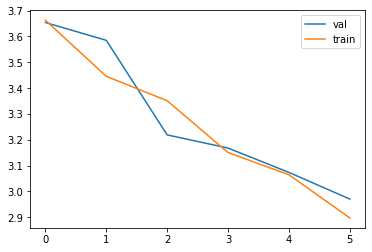

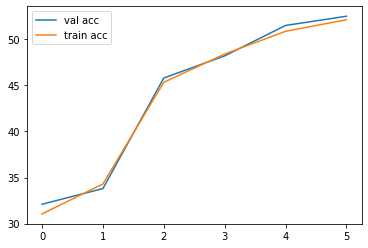


Iteration 600, loss = 2.8716
Checking accuracy on validation set
Got 500 / 1000 correct (50.00)
Checking accuracy on train set
Got 26290 / 49000 correct (53.65)


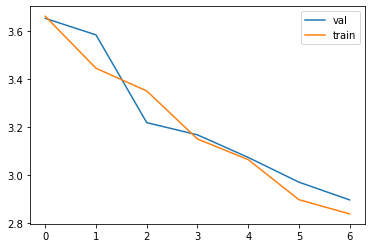

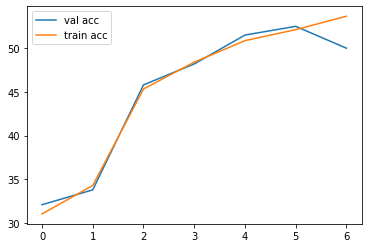


epoch  2
Iteration 0, loss = 2.5613
Checking accuracy on validation set
Got 539 / 1000 correct (53.90)
Checking accuracy on train set
Got 27964 / 49000 correct (57.07)


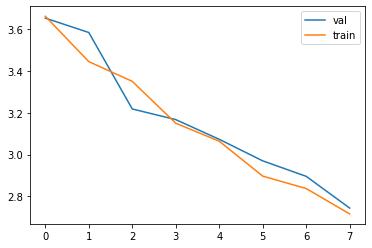

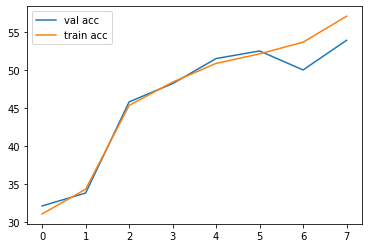


Iteration 200, loss = 2.5724
Checking accuracy on validation set
Got 570 / 1000 correct (57.00)
Checking accuracy on train set
Got 29133 / 49000 correct (59.46)


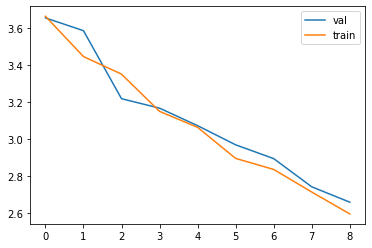

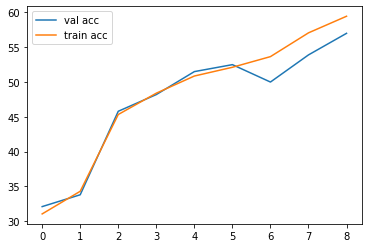


Iteration 400, loss = 2.5929
Checking accuracy on validation set
Got 588 / 1000 correct (58.80)
Checking accuracy on train set
Got 30148 / 49000 correct (61.53)


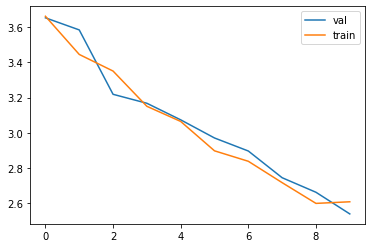

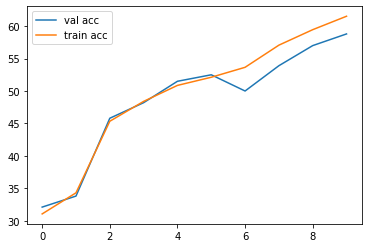


Iteration 600, loss = 2.5218
Checking accuracy on validation set
Got 602 / 1000 correct (60.20)
Checking accuracy on train set
Got 31219 / 49000 correct (63.71)


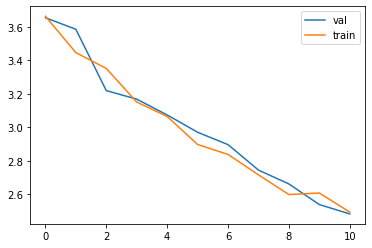

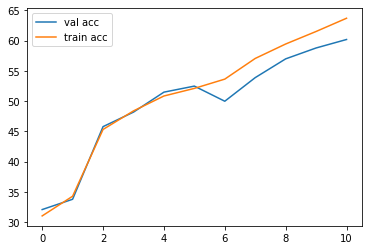


epoch  3
Iteration 0, loss = 2.4162
Checking accuracy on validation set
Got 616 / 1000 correct (61.60)
Checking accuracy on train set
Got 30985 / 49000 correct (63.23)


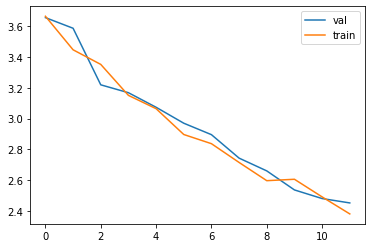

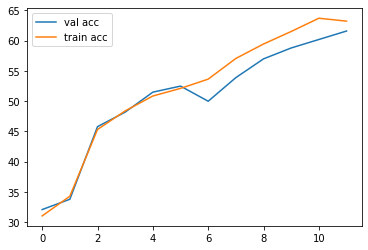


Iteration 200, loss = 2.1445
Checking accuracy on validation set
Got 642 / 1000 correct (64.20)
Checking accuracy on train set
Got 32463 / 49000 correct (66.25)


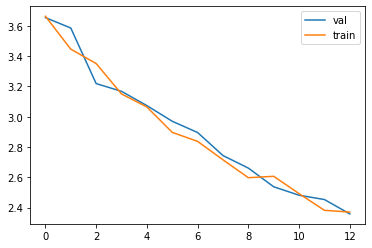

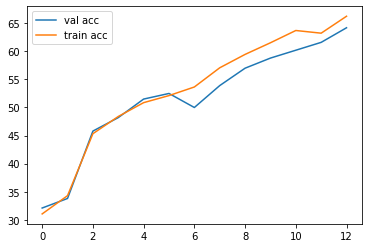


Iteration 400, loss = 2.2121
Checking accuracy on validation set
Got 642 / 1000 correct (64.20)
Checking accuracy on train set
Got 32699 / 49000 correct (66.73)


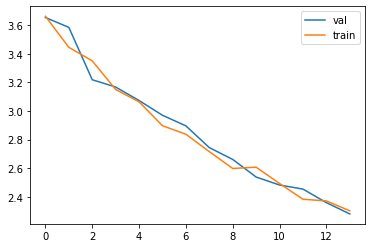

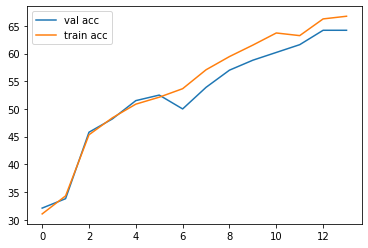


Iteration 600, loss = 2.3038
Checking accuracy on validation set
Got 668 / 1000 correct (66.80)
Checking accuracy on train set
Got 33158 / 49000 correct (67.67)


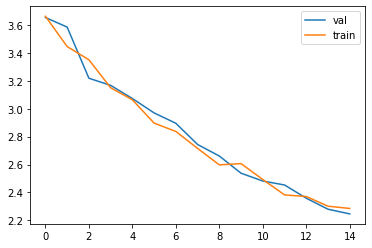

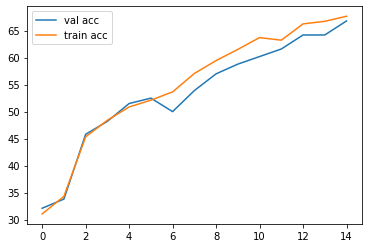


epoch  4
Iteration 0, loss = 2.2718
Checking accuracy on validation set
Got 645 / 1000 correct (64.50)
Checking accuracy on train set
Got 33450 / 49000 correct (68.27)


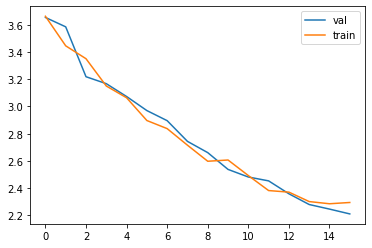

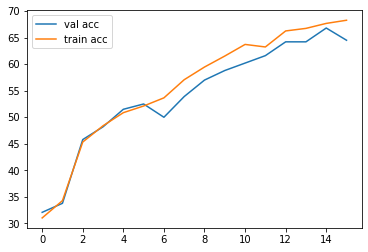


Iteration 200, loss = 2.0806
Checking accuracy on validation set
Got 660 / 1000 correct (66.00)
Checking accuracy on train set
Got 33706 / 49000 correct (68.79)


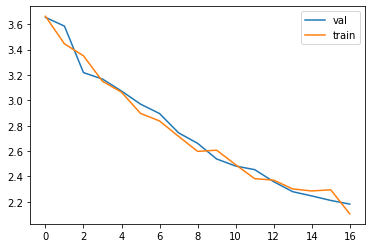

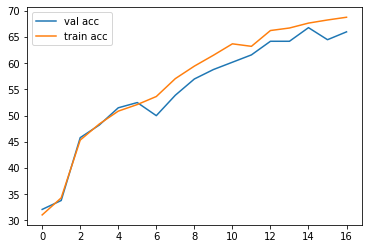


Iteration 400, loss = 2.1432
Checking accuracy on validation set
Got 671 / 1000 correct (67.10)
Checking accuracy on train set
Got 34486 / 49000 correct (70.38)


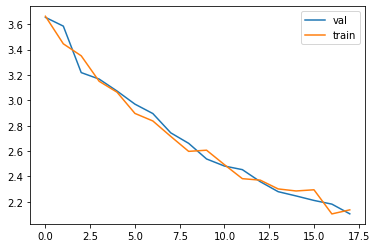

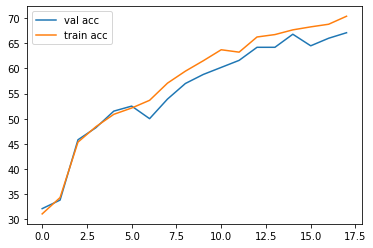


Iteration 600, loss = 2.0811
Checking accuracy on validation set
Got 703 / 1000 correct (70.30)
Checking accuracy on train set
Got 35584 / 49000 correct (72.62)


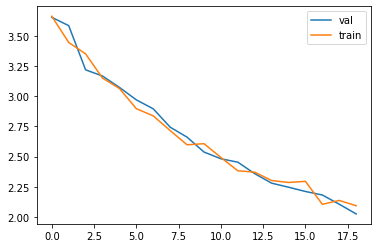

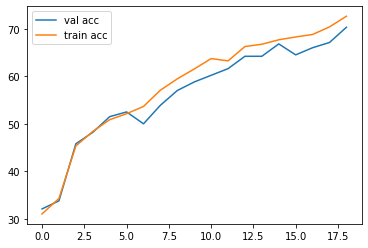


epoch  5
Iteration 0, loss = 1.9289
Checking accuracy on validation set
Got 699 / 1000 correct (69.90)
Checking accuracy on train set
Got 35629 / 49000 correct (72.71)


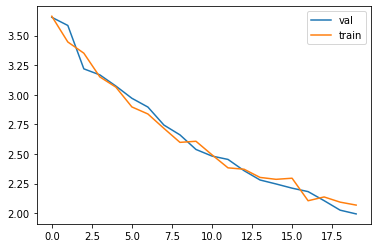

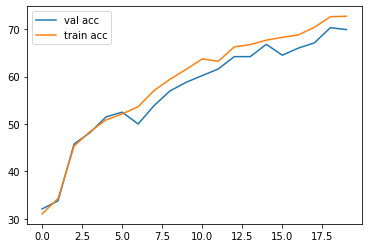


Iteration 200, loss = 2.1617
Checking accuracy on validation set
Got 686 / 1000 correct (68.60)
Checking accuracy on train set
Got 35341 / 49000 correct (72.12)


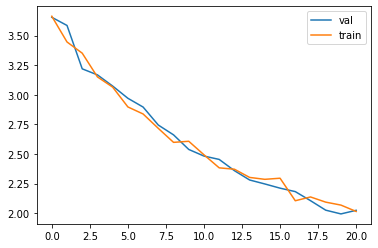

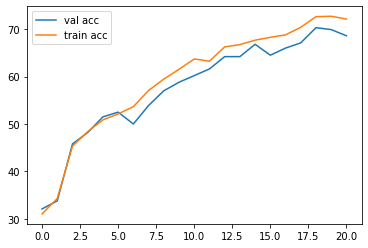


Iteration 400, loss = 1.8014
Checking accuracy on validation set
Got 689 / 1000 correct (68.90)
Checking accuracy on train set
Got 35926 / 49000 correct (73.32)


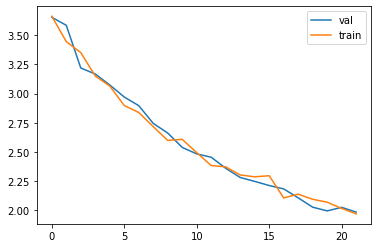

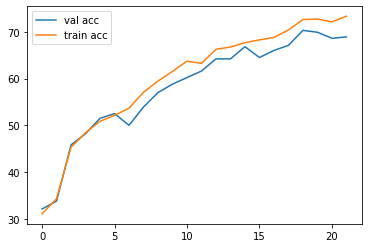


Iteration 600, loss = 1.9629
Checking accuracy on validation set
Got 711 / 1000 correct (71.10)
Checking accuracy on train set
Got 36847 / 49000 correct (75.20)


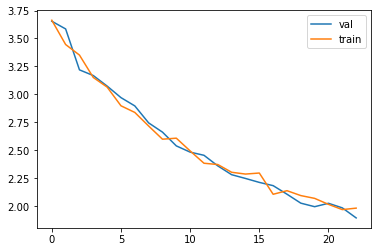

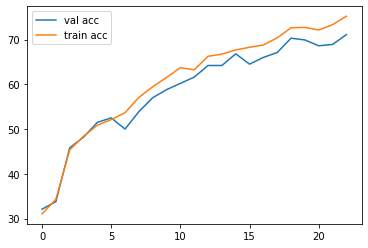


epoch  6
Iteration 0, loss = 1.9196
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)
Checking accuracy on train set
Got 36240 / 49000 correct (73.96)


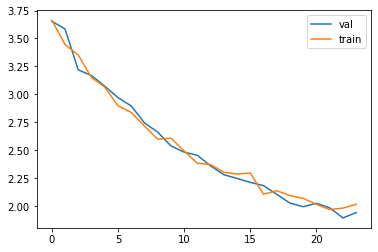

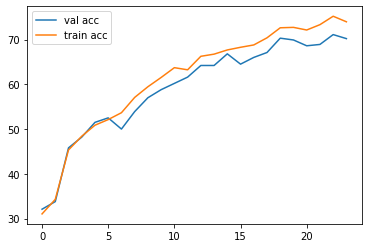


Iteration 200, loss = 1.9494
Checking accuracy on validation set
Got 717 / 1000 correct (71.70)
Checking accuracy on train set
Got 36783 / 49000 correct (75.07)


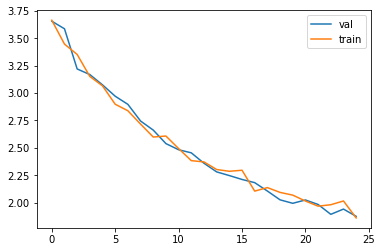

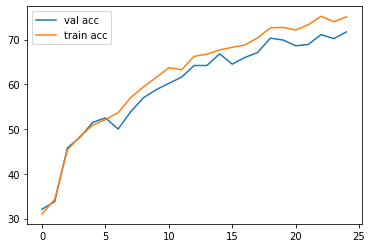


Iteration 400, loss = 2.0689
Checking accuracy on validation set
Got 711 / 1000 correct (71.10)
Checking accuracy on train set
Got 37273 / 49000 correct (76.07)


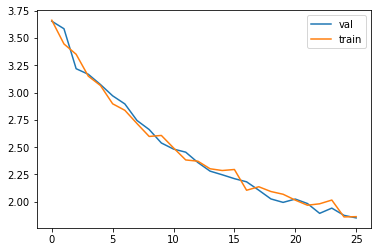

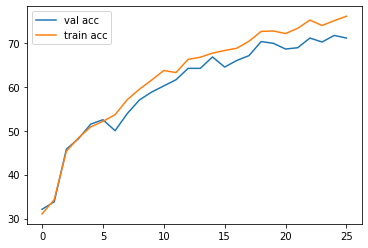


Iteration 600, loss = 1.9107
Checking accuracy on validation set
Got 700 / 1000 correct (70.00)
Checking accuracy on train set
Got 37343 / 49000 correct (76.21)


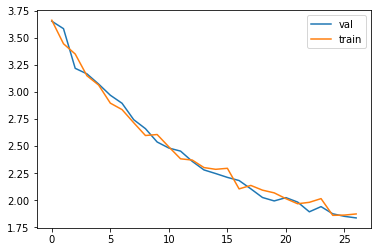

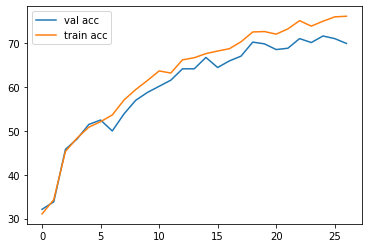


epoch  7
Iteration 0, loss = 1.7165
Checking accuracy on validation set
Got 713 / 1000 correct (71.30)
Checking accuracy on train set
Got 37432 / 49000 correct (76.39)


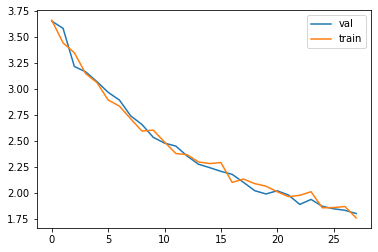

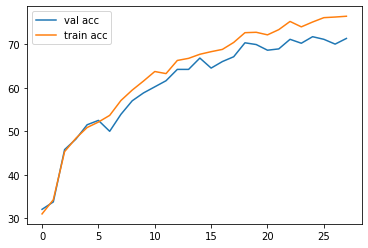


Iteration 200, loss = 1.7695
Checking accuracy on validation set
Got 704 / 1000 correct (70.40)
Checking accuracy on train set
Got 37784 / 49000 correct (77.11)


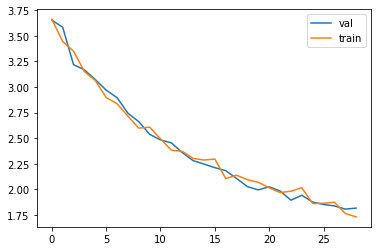

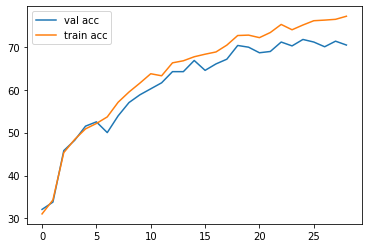


Iteration 400, loss = 1.5121
Checking accuracy on validation set
Got 732 / 1000 correct (73.20)
Checking accuracy on train set
Got 38505 / 49000 correct (78.58)


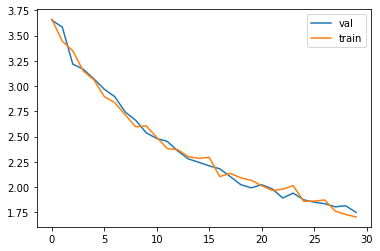

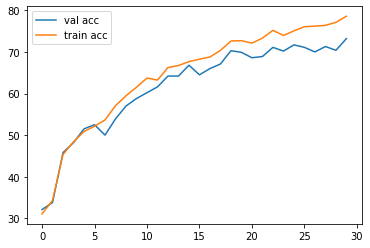


Iteration 600, loss = 1.5749
Checking accuracy on validation set
Got 749 / 1000 correct (74.90)
Checking accuracy on train set
Got 39117 / 49000 correct (79.83)


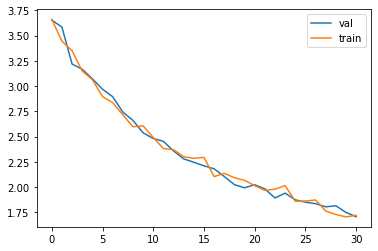

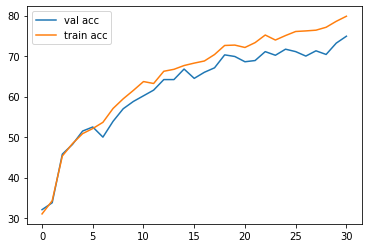


epoch  8
Iteration 0, loss = 1.5375
Checking accuracy on validation set
Got 693 / 1000 correct (69.30)
Checking accuracy on train set
Got 36777 / 49000 correct (75.06)


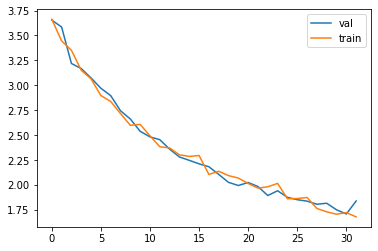

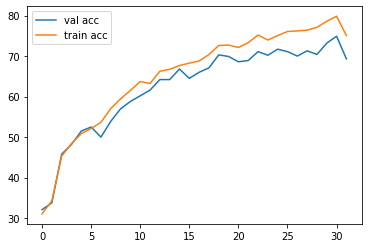


Iteration 200, loss = 1.4730
Checking accuracy on validation set
Got 740 / 1000 correct (74.00)
Checking accuracy on train set
Got 39046 / 49000 correct (79.69)


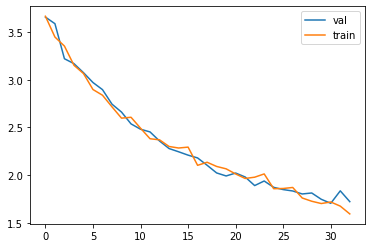

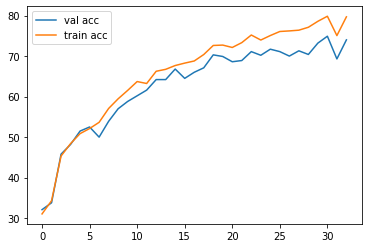


Iteration 400, loss = 1.6338
Checking accuracy on validation set
Got 713 / 1000 correct (71.30)
Checking accuracy on train set
Got 37861 / 49000 correct (77.27)


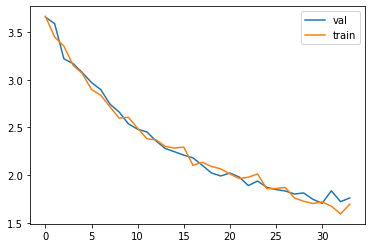

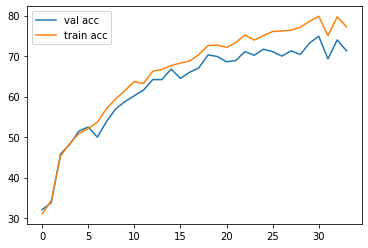


Iteration 600, loss = 1.4604
Checking accuracy on validation set
Got 732 / 1000 correct (73.20)
Checking accuracy on train set
Got 39274 / 49000 correct (80.15)


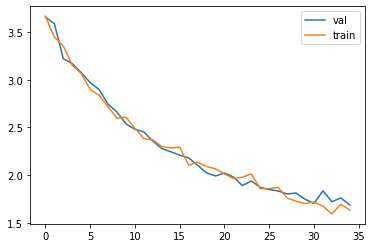

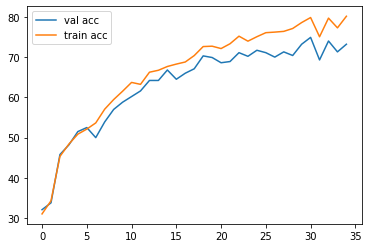


epoch  9
Iteration 0, loss = 1.5860
Checking accuracy on validation set
Got 742 / 1000 correct (74.20)
Checking accuracy on train set
Got 39072 / 49000 correct (79.74)


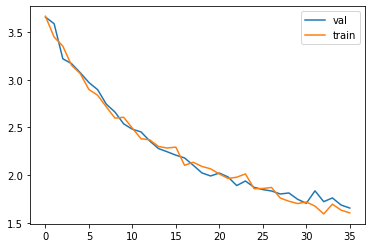

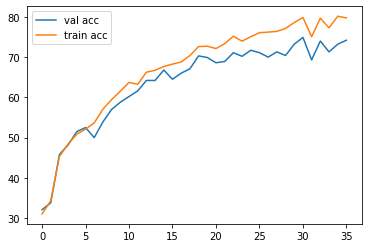


Iteration 200, loss = 1.8032
Checking accuracy on validation set
Got 753 / 1000 correct (75.30)
Checking accuracy on train set
Got 39844 / 49000 correct (81.31)


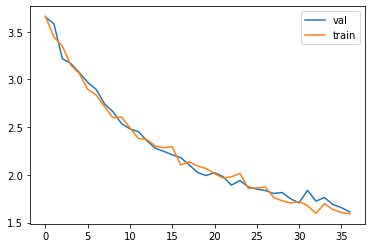

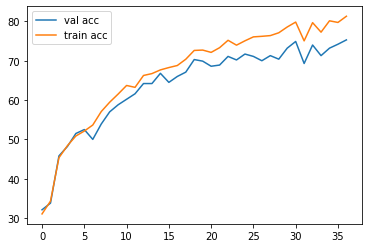


Iteration 400, loss = 1.5997
Checking accuracy on validation set
Got 743 / 1000 correct (74.30)
Checking accuracy on train set
Got 39905 / 49000 correct (81.44)


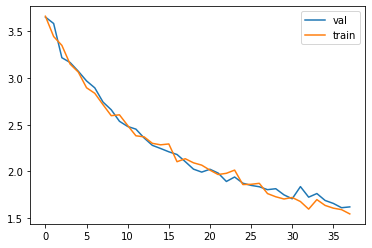

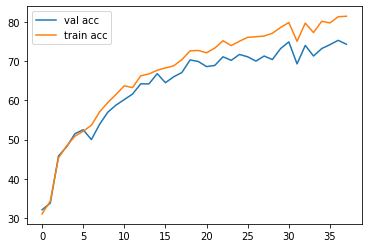


Iteration 600, loss = 1.5988
Checking accuracy on validation set
Got 750 / 1000 correct (75.00)
Checking accuracy on train set
Got 39845 / 49000 correct (81.32)


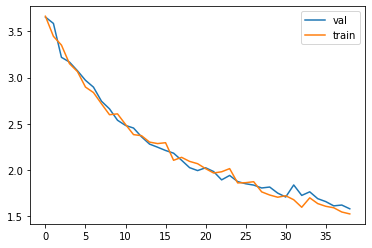

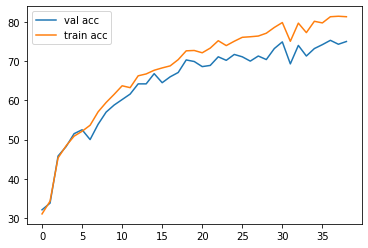


epoch  10
Iteration 0, loss = 1.3097
Checking accuracy on validation set
Got 762 / 1000 correct (76.20)
Checking accuracy on train set
Got 40343 / 49000 correct (82.33)


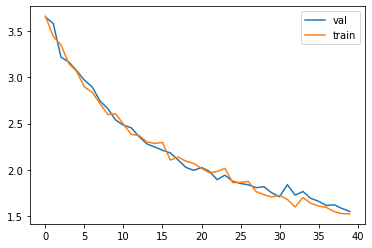

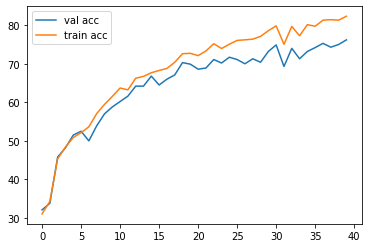


Iteration 200, loss = 1.5030
Checking accuracy on validation set
Got 743 / 1000 correct (74.30)
Checking accuracy on train set
Got 39936 / 49000 correct (81.50)


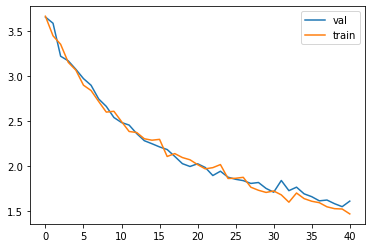

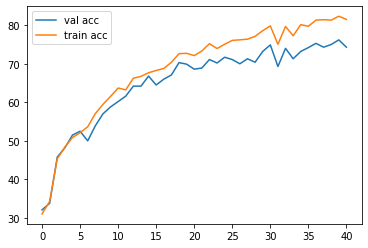


Iteration 400, loss = 1.4255
Checking accuracy on validation set
Got 761 / 1000 correct (76.10)
Checking accuracy on train set
Got 40409 / 49000 correct (82.47)


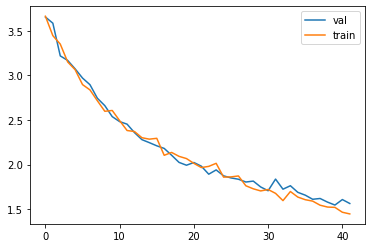

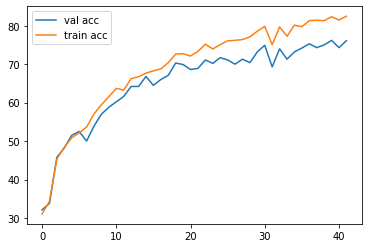


Iteration 600, loss = 1.4792
Checking accuracy on validation set
Got 755 / 1000 correct (75.50)
Checking accuracy on train set
Got 39969 / 49000 correct (81.57)


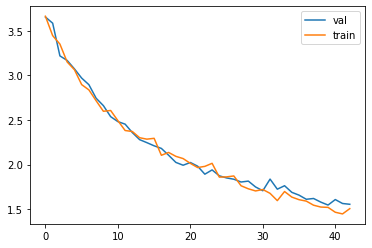

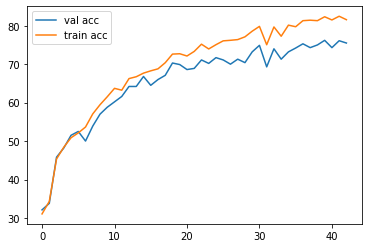


epoch  11
Iteration 0, loss = 1.5242
Checking accuracy on validation set
Got 756 / 1000 correct (75.60)
Checking accuracy on train set
Got 40393 / 49000 correct (82.43)


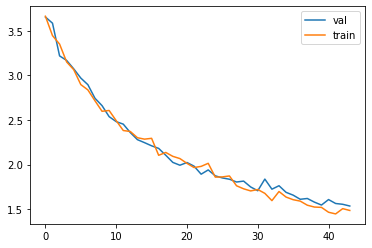

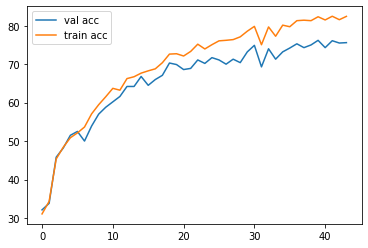


Iteration 200, loss = 1.2496
Checking accuracy on validation set
Got 743 / 1000 correct (74.30)
Checking accuracy on train set
Got 39938 / 49000 correct (81.51)


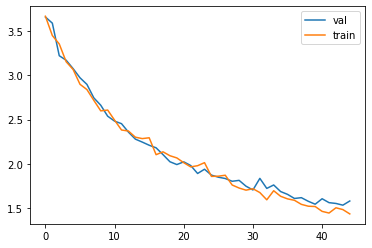

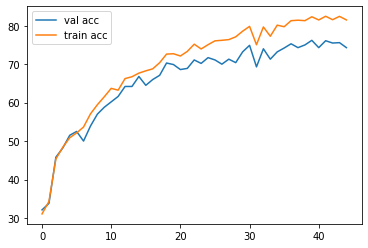


Iteration 400, loss = 1.5460
Checking accuracy on validation set
Got 756 / 1000 correct (75.60)
Checking accuracy on train set
Got 40411 / 49000 correct (82.47)


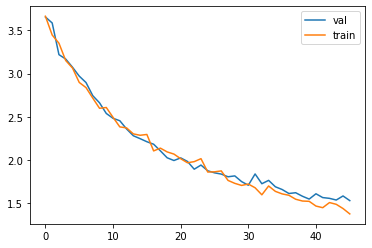

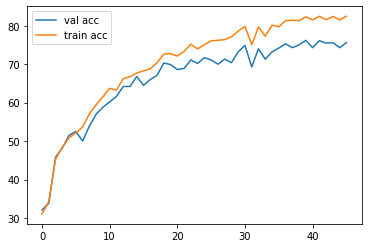


Iteration 600, loss = 1.3387
Checking accuracy on validation set
Got 740 / 1000 correct (74.00)
Checking accuracy on train set
Got 40114 / 49000 correct (81.87)


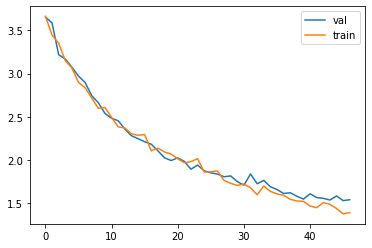

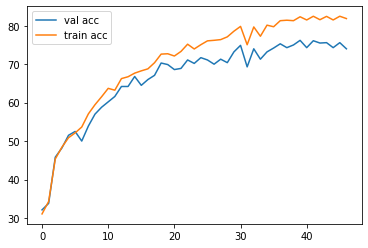


epoch  12
Iteration 0, loss = 1.4232
Checking accuracy on validation set
Got 744 / 1000 correct (74.40)
Checking accuracy on train set
Got 40317 / 49000 correct (82.28)


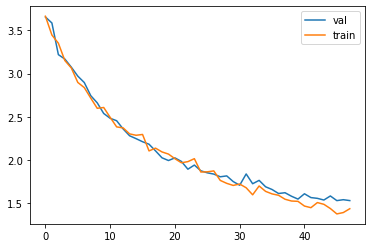

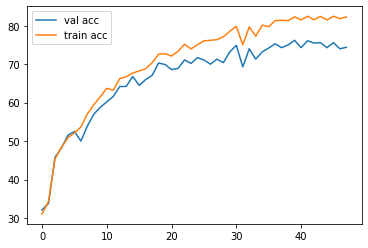


Iteration 200, loss = 1.5741
Checking accuracy on validation set
Got 750 / 1000 correct (75.00)
Checking accuracy on train set
Got 41294 / 49000 correct (84.27)


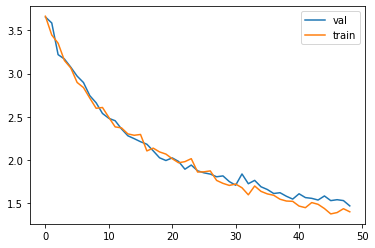

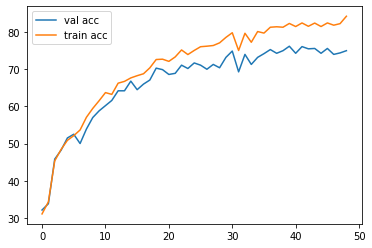


Iteration 400, loss = 1.3354
Checking accuracy on validation set
Got 775 / 1000 correct (77.50)
Checking accuracy on train set
Got 41353 / 49000 correct (84.39)


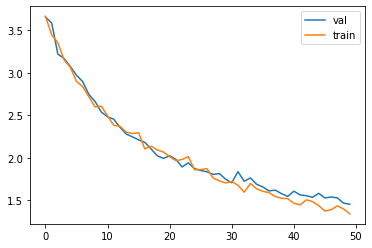

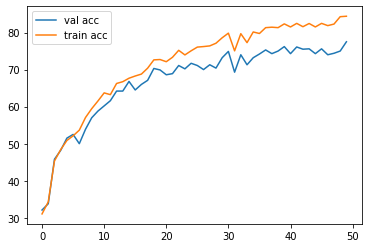


Iteration 600, loss = 1.3546
Checking accuracy on validation set
Got 747 / 1000 correct (74.70)
Checking accuracy on train set
Got 41589 / 49000 correct (84.88)


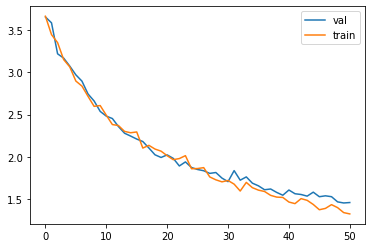

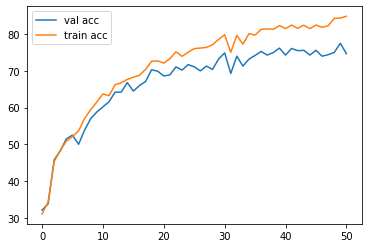


epoch  13
Iteration 0, loss = 1.1877
Checking accuracy on validation set
Got 766 / 1000 correct (76.60)
Checking accuracy on train set
Got 41663 / 49000 correct (85.03)


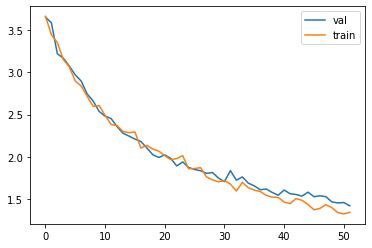

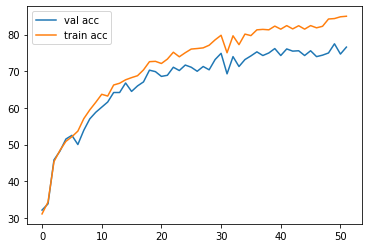


Iteration 200, loss = 1.3587
Checking accuracy on validation set
Got 748 / 1000 correct (74.80)
Checking accuracy on train set
Got 41342 / 49000 correct (84.37)


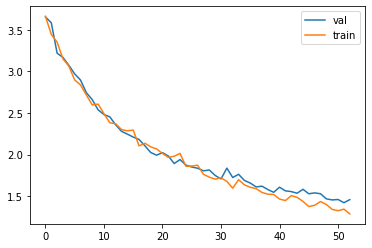

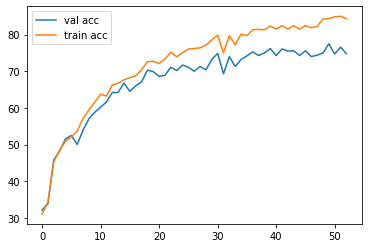


Iteration 400, loss = 1.2918
Checking accuracy on validation set
Got 741 / 1000 correct (74.10)
Checking accuracy on train set
Got 40910 / 49000 correct (83.49)


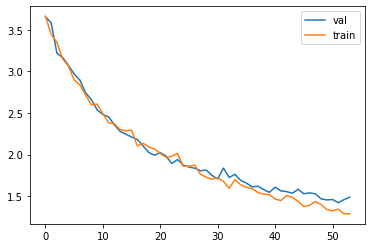

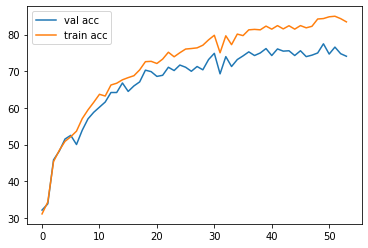


Iteration 600, loss = 1.2024
Checking accuracy on validation set
Got 773 / 1000 correct (77.30)
Checking accuracy on train set
Got 42017 / 49000 correct (85.75)


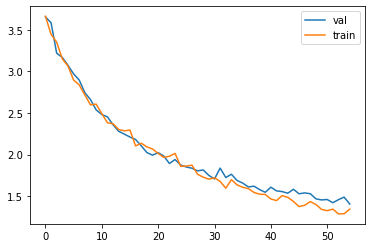

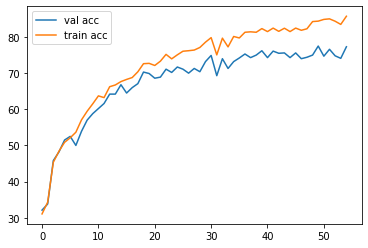


epoch  14
Iteration 0, loss = 1.0133
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)
Checking accuracy on train set
Got 42183 / 49000 correct (86.09)


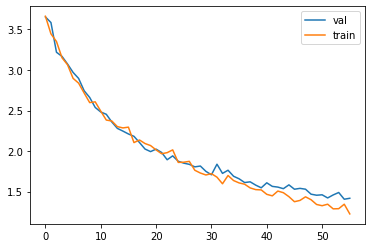

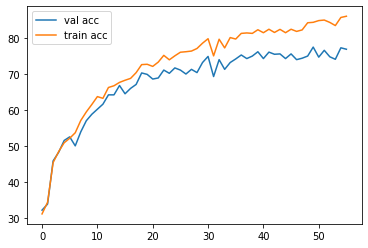


Iteration 200, loss = 1.2337
Checking accuracy on validation set
Got 777 / 1000 correct (77.70)
Checking accuracy on train set
Got 42616 / 49000 correct (86.97)


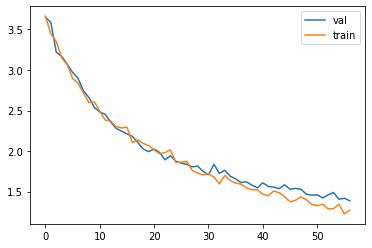

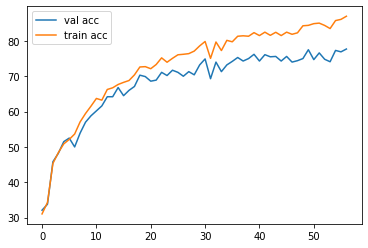


Iteration 400, loss = 1.0423
Checking accuracy on validation set
Got 765 / 1000 correct (76.50)
Checking accuracy on train set
Got 41831 / 49000 correct (85.37)


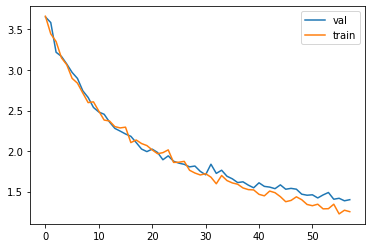

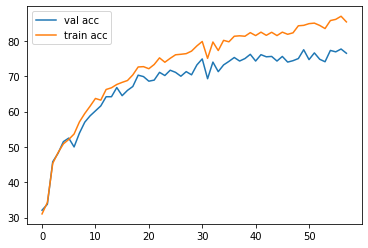


Iteration 600, loss = 1.1815
Checking accuracy on validation set
Got 768 / 1000 correct (76.80)
Checking accuracy on train set
Got 42465 / 49000 correct (86.66)


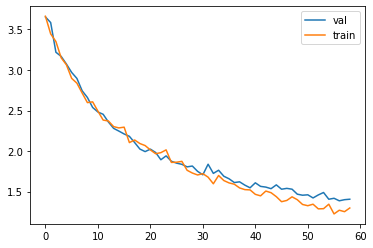

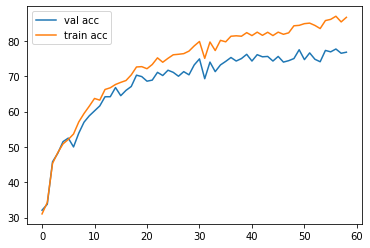


epoch  15
Iteration 0, loss = 1.3081
Checking accuracy on validation set
Got 762 / 1000 correct (76.20)
Checking accuracy on train set
Got 41583 / 49000 correct (84.86)


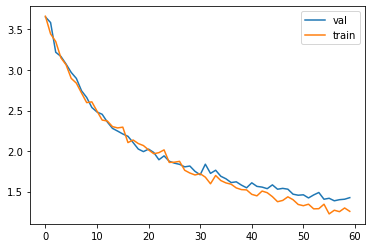

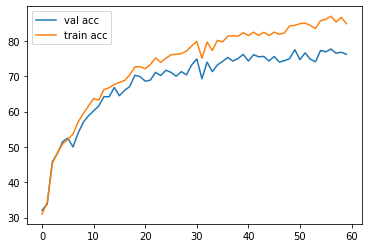


Iteration 200, loss = 1.3209
Checking accuracy on validation set
Got 784 / 1000 correct (78.40)
Checking accuracy on train set
Got 43150 / 49000 correct (88.06)


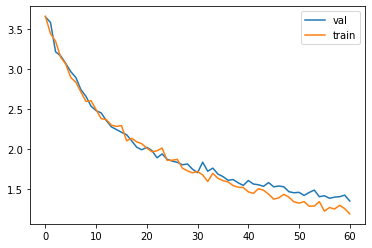

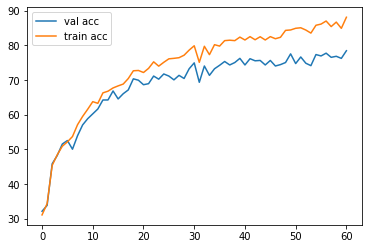


Iteration 400, loss = 1.3159
Checking accuracy on validation set
Got 775 / 1000 correct (77.50)
Checking accuracy on train set
Got 42732 / 49000 correct (87.21)


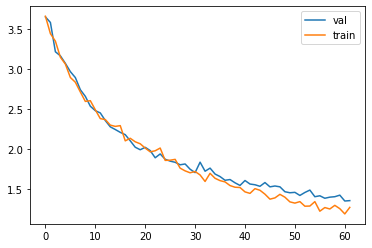

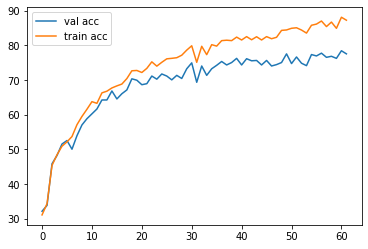


Iteration 600, loss = 1.1136
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)
Checking accuracy on train set
Got 42541 / 49000 correct (86.82)


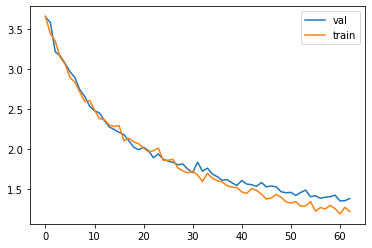

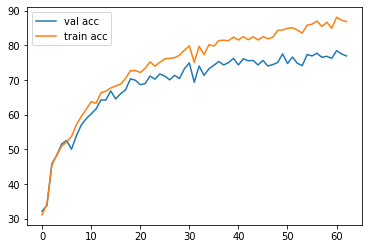


epoch  16
Iteration 0, loss = 1.1542
Checking accuracy on validation set
Got 779 / 1000 correct (77.90)
Checking accuracy on train set
Got 42754 / 49000 correct (87.25)


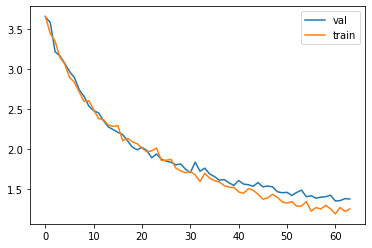

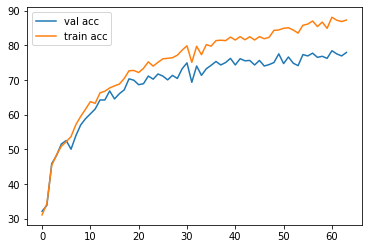


Iteration 200, loss = 1.3123
Checking accuracy on validation set
Got 759 / 1000 correct (75.90)
Checking accuracy on train set
Got 43039 / 49000 correct (87.83)


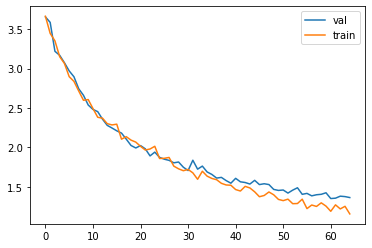

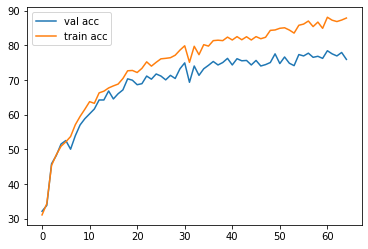


Iteration 400, loss = 1.0710
Checking accuracy on validation set
Got 755 / 1000 correct (75.50)
Checking accuracy on train set
Got 42542 / 49000 correct (86.82)


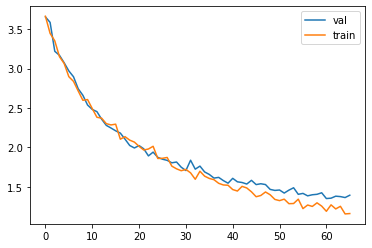

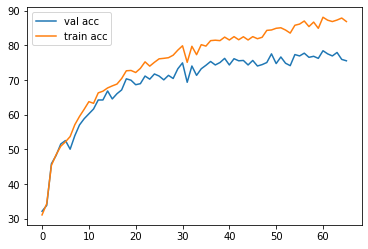


Iteration 600, loss = 1.1097
Checking accuracy on validation set
Got 774 / 1000 correct (77.40)
Checking accuracy on train set
Got 43036 / 49000 correct (87.83)


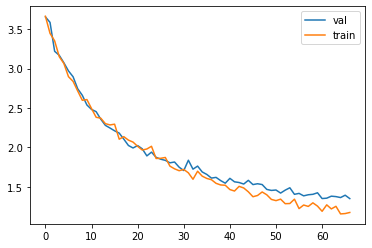

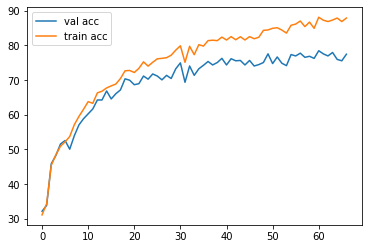


epoch  17
Iteration 0, loss = 1.0441
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)
Checking accuracy on train set
Got 42630 / 49000 correct (87.00)


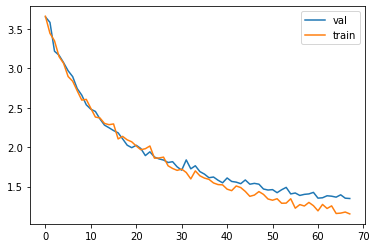

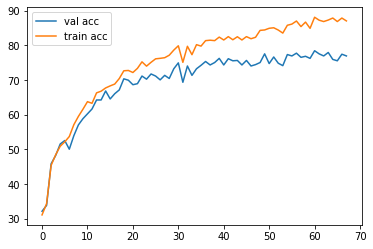


Iteration 200, loss = 1.2334
Checking accuracy on validation set
Got 772 / 1000 correct (77.20)
Checking accuracy on train set
Got 43688 / 49000 correct (89.16)


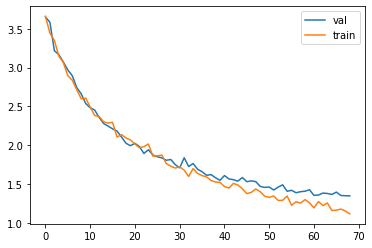

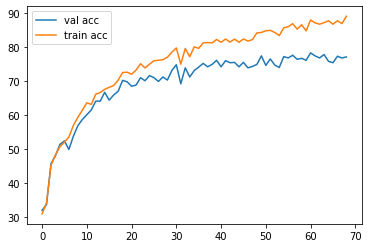


Iteration 400, loss = 0.9813
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)
Checking accuracy on train set
Got 43676 / 49000 correct (89.13)


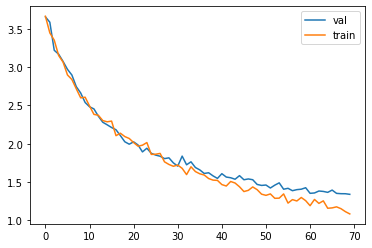

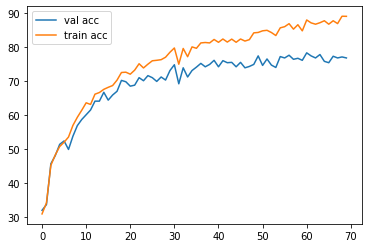


Iteration 600, loss = 0.9477
Checking accuracy on validation set
Got 764 / 1000 correct (76.40)
Checking accuracy on train set
Got 43581 / 49000 correct (88.94)


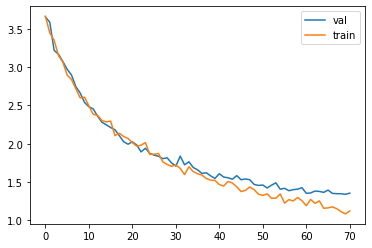

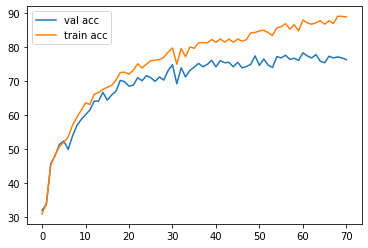


epoch  18
Iteration 0, loss = 1.0491
Checking accuracy on validation set
Got 759 / 1000 correct (75.90)
Checking accuracy on train set
Got 43587 / 49000 correct (88.95)


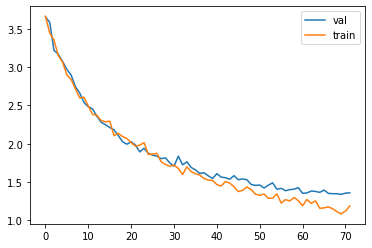

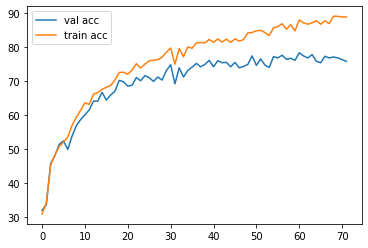


Iteration 200, loss = 0.9104
Checking accuracy on validation set
Got 767 / 1000 correct (76.70)
Checking accuracy on train set
Got 43658 / 49000 correct (89.10)


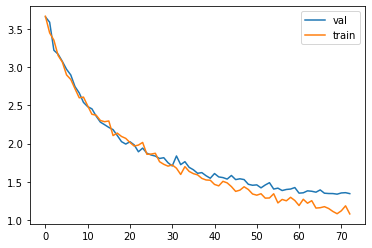

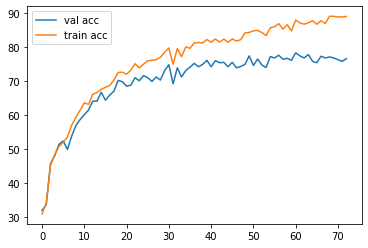


Iteration 400, loss = 1.0702
Checking accuracy on validation set
Got 767 / 1000 correct (76.70)
Checking accuracy on train set
Got 43618 / 49000 correct (89.02)


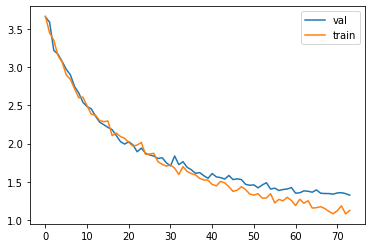

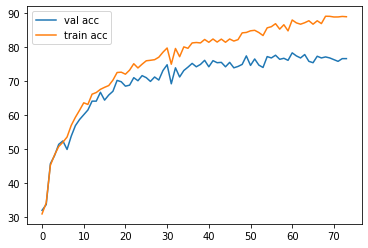


Iteration 600, loss = 1.1267
Checking accuracy on validation set
Got 728 / 1000 correct (72.80)
Checking accuracy on train set
Got 42102 / 49000 correct (85.92)


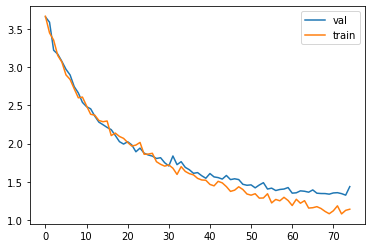

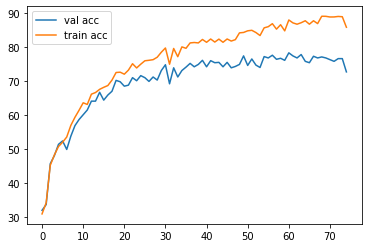


epoch  19
Iteration 0, loss = 1.0995
Checking accuracy on validation set
Got 767 / 1000 correct (76.70)
Checking accuracy on train set
Got 43701 / 49000 correct (89.19)


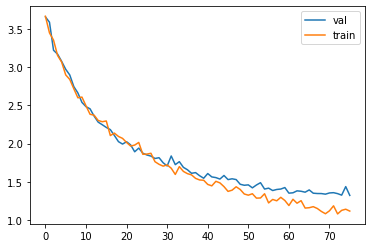

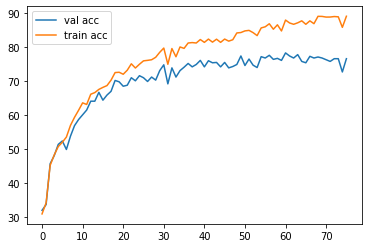


Iteration 200, loss = 1.2182
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)
Checking accuracy on train set
Got 43840 / 49000 correct (89.47)


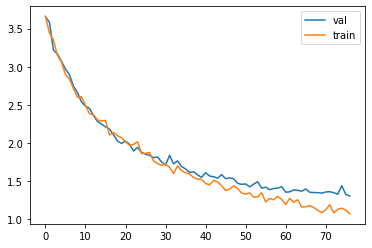

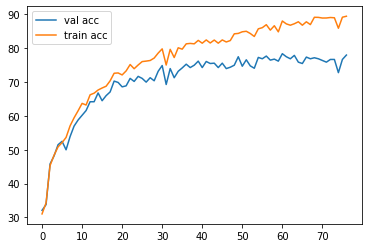


Iteration 400, loss = 0.9503
Checking accuracy on validation set
Got 757 / 1000 correct (75.70)
Checking accuracy on train set
Got 43802 / 49000 correct (89.39)


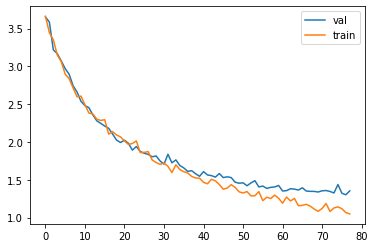

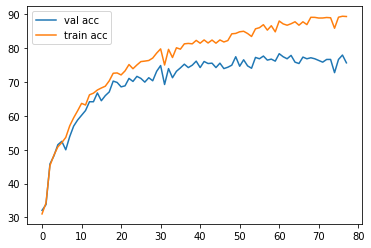


Iteration 600, loss = 1.0138
Checking accuracy on validation set
Got 783 / 1000 correct (78.30)
Checking accuracy on train set
Got 44129 / 49000 correct (90.06)


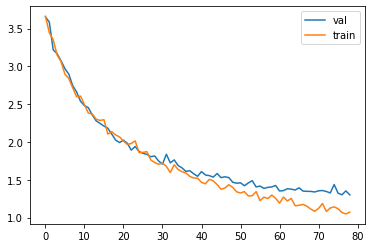

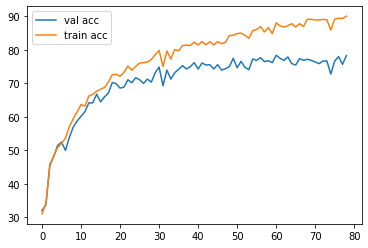


epoch  20
Iteration 0, loss = 1.0593
Checking accuracy on validation set
Got 779 / 1000 correct (77.90)
Checking accuracy on train set
Got 44356 / 49000 correct (90.52)


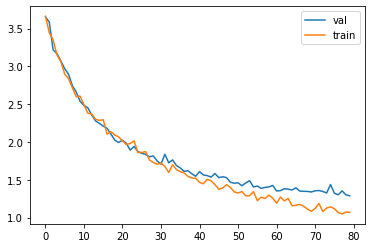

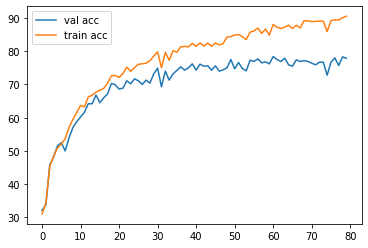


Iteration 200, loss = 0.9292
Checking accuracy on validation set
Got 761 / 1000 correct (76.10)
Checking accuracy on train set
Got 43699 / 49000 correct (89.18)


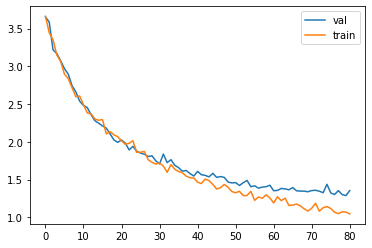

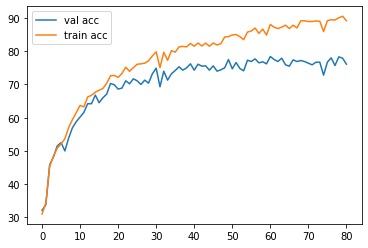


Iteration 400, loss = 0.9350
Checking accuracy on validation set
Got 774 / 1000 correct (77.40)
Checking accuracy on train set
Got 43530 / 49000 correct (88.84)


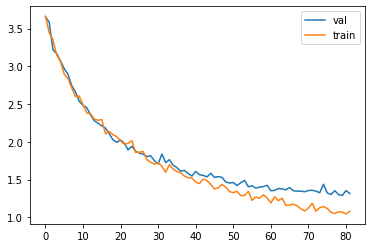

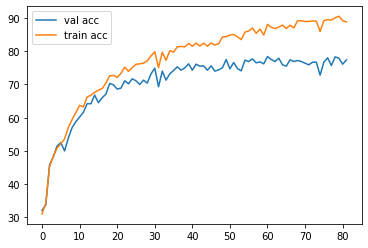


Iteration 600, loss = 1.0983
Checking accuracy on validation set
Got 758 / 1000 correct (75.80)
Checking accuracy on train set
Got 43098 / 49000 correct (87.96)


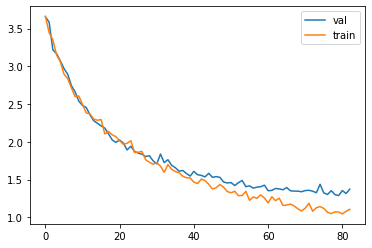

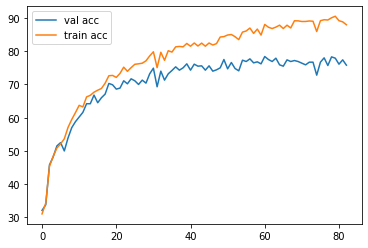


epoch  21
Iteration 0, loss = 1.0384
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)
Checking accuracy on train set
Got 44306 / 49000 correct (90.42)


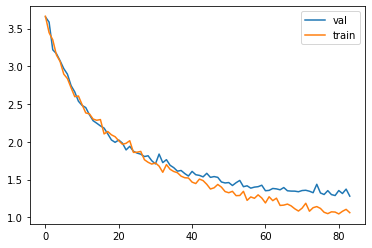

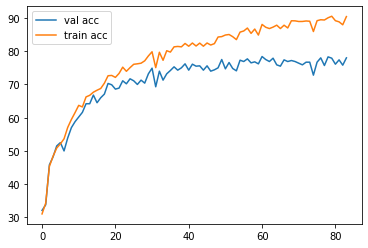


Iteration 200, loss = 1.0481
Checking accuracy on validation set
Got 762 / 1000 correct (76.20)
Checking accuracy on train set
Got 44116 / 49000 correct (90.03)


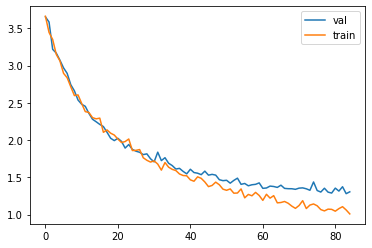

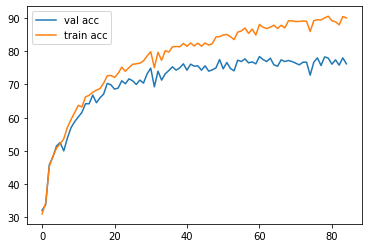


Iteration 400, loss = 0.9757
Checking accuracy on validation set
Got 760 / 1000 correct (76.00)
Checking accuracy on train set
Got 43803 / 49000 correct (89.39)


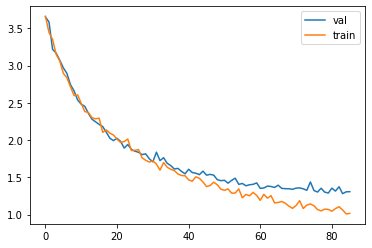

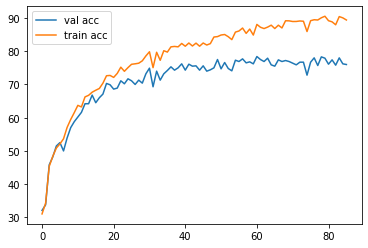


Iteration 600, loss = 1.0426
Checking accuracy on validation set
Got 772 / 1000 correct (77.20)
Checking accuracy on train set
Got 44829 / 49000 correct (91.49)


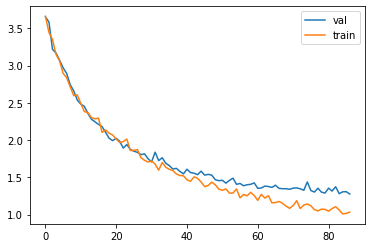

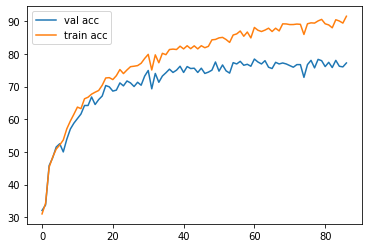


epoch  22
Iteration 0, loss = 1.1032
Checking accuracy on validation set
Got 770 / 1000 correct (77.00)
Checking accuracy on train set
Got 44235 / 49000 correct (90.28)


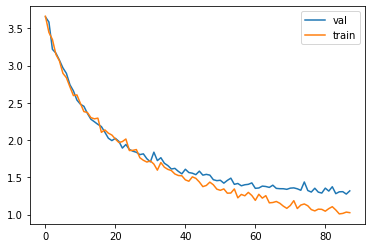

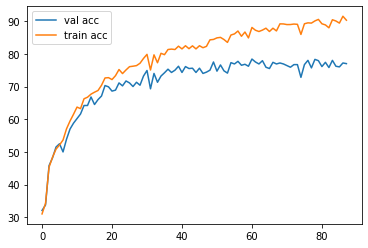


Iteration 200, loss = 0.9332
Checking accuracy on validation set
Got 763 / 1000 correct (76.30)
Checking accuracy on train set
Got 43737 / 49000 correct (89.26)


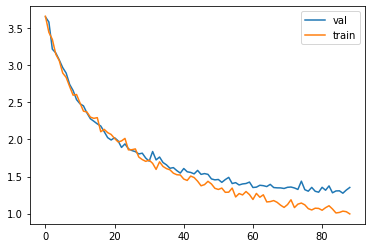

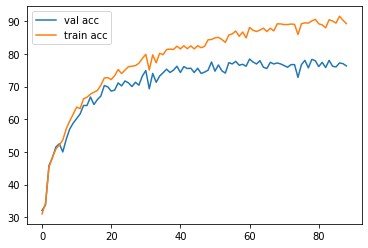


Iteration 400, loss = 0.8443
Checking accuracy on validation set
Got 767 / 1000 correct (76.70)
Checking accuracy on train set
Got 44109 / 49000 correct (90.02)


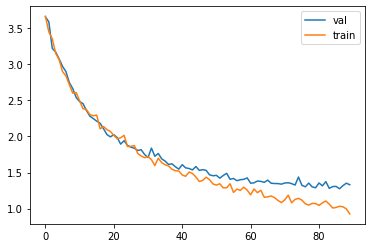

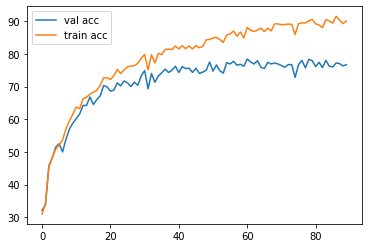


Iteration 600, loss = 0.9773
Checking accuracy on validation set
Got 787 / 1000 correct (78.70)
Checking accuracy on train set
Got 44877 / 49000 correct (91.59)


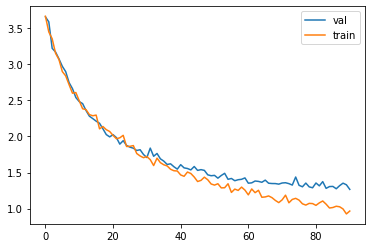

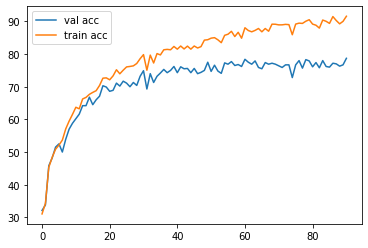


epoch  23
Iteration 0, loss = 1.1960
Checking accuracy on validation set
Got 778 / 1000 correct (77.80)
Checking accuracy on train set
Got 44004 / 49000 correct (89.80)


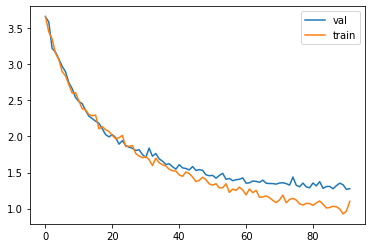

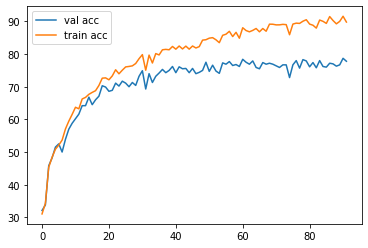


Iteration 200, loss = 0.9104
Checking accuracy on validation set
Got 774 / 1000 correct (77.40)
Checking accuracy on train set
Got 44790 / 49000 correct (91.41)


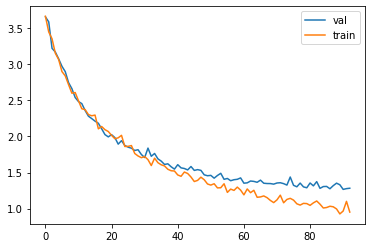

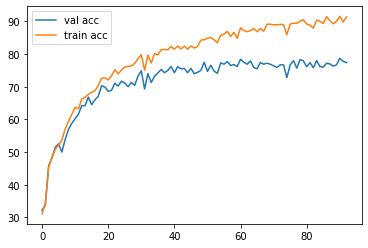


Iteration 400, loss = 1.0878
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)
Checking accuracy on train set
Got 44470 / 49000 correct (90.76)


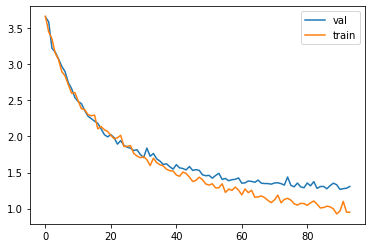

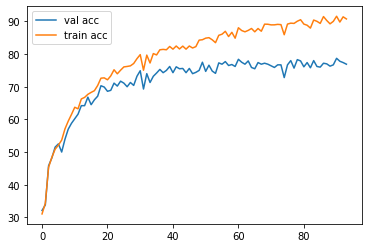


Iteration 600, loss = 0.8719
Checking accuracy on validation set
Got 784 / 1000 correct (78.40)
Checking accuracy on train set
Got 45136 / 49000 correct (92.11)


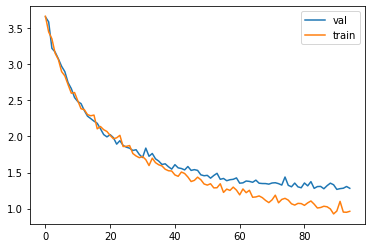

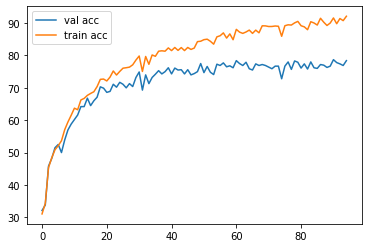


epoch  24
Iteration 0, loss = 1.0058
Checking accuracy on validation set
Got 773 / 1000 correct (77.30)
Checking accuracy on train set
Got 44850 / 49000 correct (91.53)


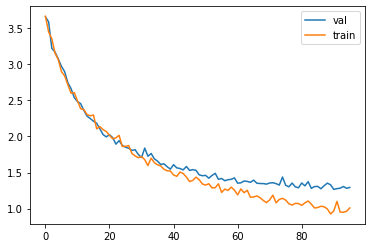

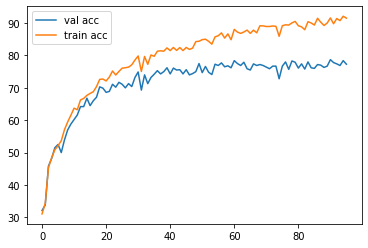


Iteration 200, loss = 0.9749
Checking accuracy on validation set
Got 779 / 1000 correct (77.90)
Checking accuracy on train set
Got 45283 / 49000 correct (92.41)


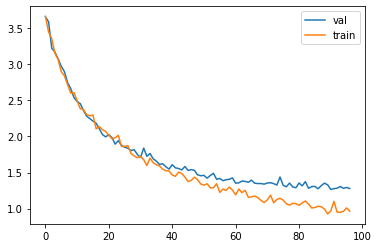

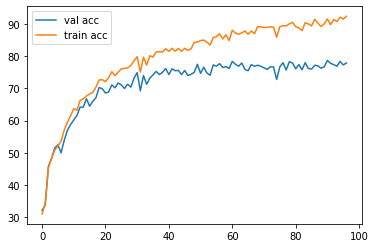


Iteration 400, loss = 0.9455
Checking accuracy on validation set
Got 776 / 1000 correct (77.60)
Checking accuracy on train set
Got 44866 / 49000 correct (91.56)


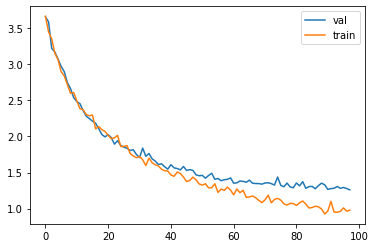

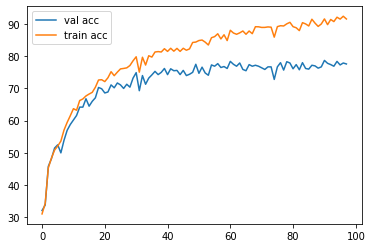


Iteration 600, loss = 0.8928
Checking accuracy on validation set
Got 784 / 1000 correct (78.40)
Checking accuracy on train set
Got 44898 / 49000 correct (91.63)


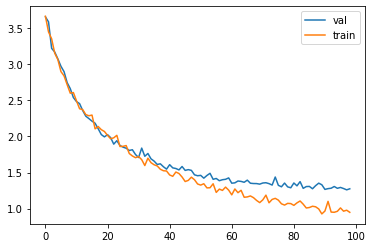

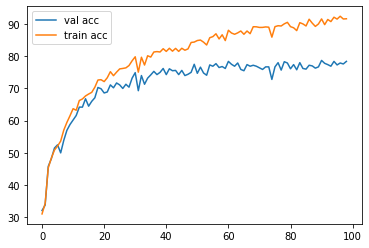


epoch  25
Iteration 0, loss = 0.9447
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)
Checking accuracy on train set
Got 44547 / 49000 correct (90.91)


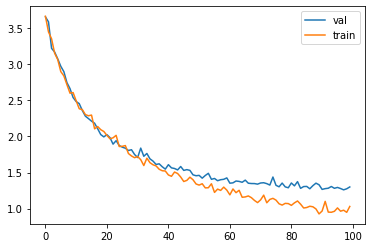

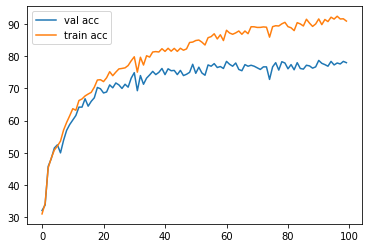


Iteration 200, loss = 0.9889
Checking accuracy on validation set
Got 761 / 1000 correct (76.10)
Checking accuracy on train set
Got 45094 / 49000 correct (92.03)


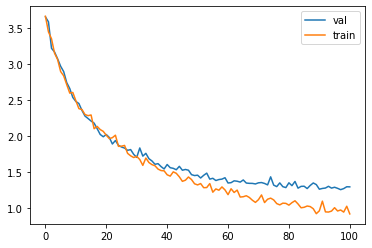

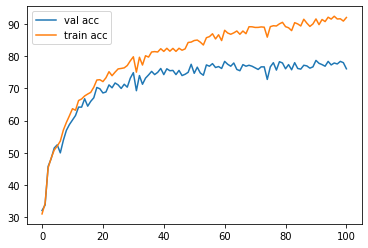


Iteration 400, loss = 1.0686
Checking accuracy on validation set
Got 788 / 1000 correct (78.80)
Checking accuracy on train set
Got 45389 / 49000 correct (92.63)


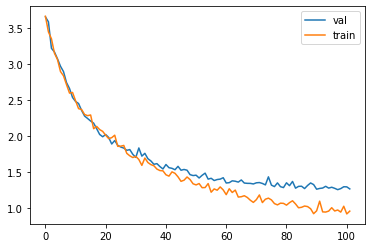

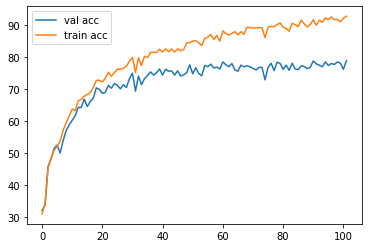


Iteration 600, loss = 1.0483
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)
Checking accuracy on train set
Got 45463 / 49000 correct (92.78)


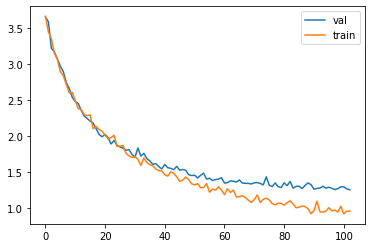

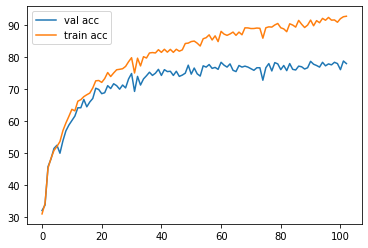


epoch  26
Iteration 0, loss = 0.8324
Checking accuracy on validation set
Got 767 / 1000 correct (76.70)
Checking accuracy on train set
Got 44594 / 49000 correct (91.01)


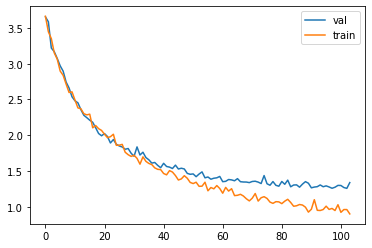

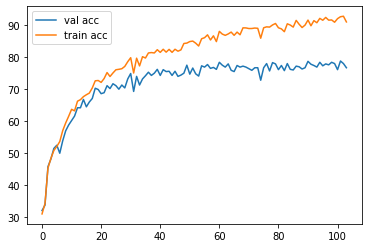


Iteration 200, loss = 1.0209
Checking accuracy on validation set
Got 768 / 1000 correct (76.80)
Checking accuracy on train set
Got 44892 / 49000 correct (91.62)


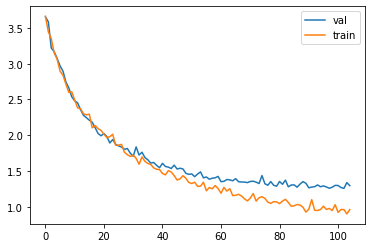

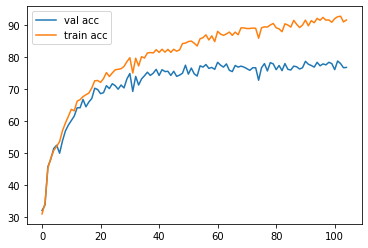


Iteration 400, loss = 0.8591
Checking accuracy on validation set
Got 762 / 1000 correct (76.20)
Checking accuracy on train set
Got 45225 / 49000 correct (92.30)


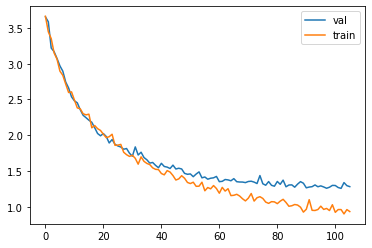

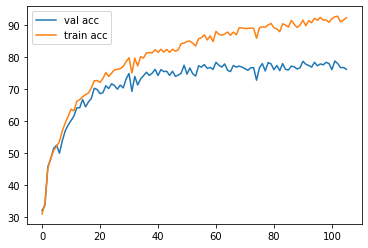


Iteration 600, loss = 1.1593
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)
Checking accuracy on train set
Got 45438 / 49000 correct (92.73)


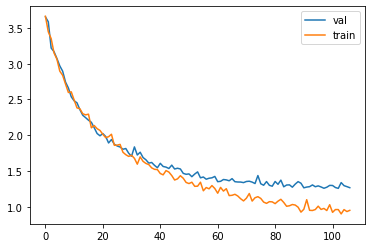

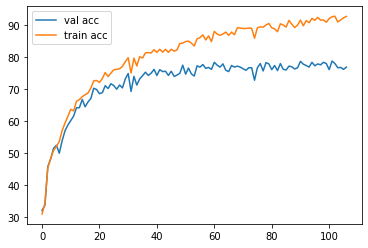


epoch  27
Iteration 0, loss = 0.9836
Checking accuracy on validation set
Got 783 / 1000 correct (78.30)
Checking accuracy on train set
Got 45906 / 49000 correct (93.69)


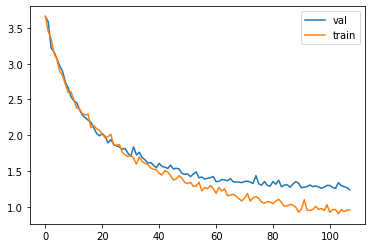

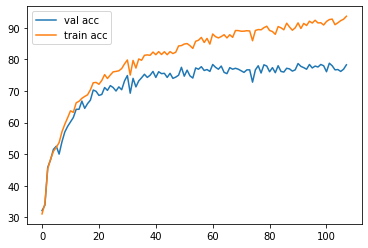


Iteration 200, loss = 0.9499
Checking accuracy on validation set
Got 768 / 1000 correct (76.80)
Checking accuracy on train set
Got 44966 / 49000 correct (91.77)


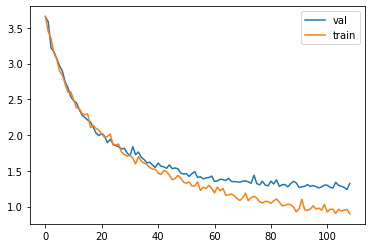

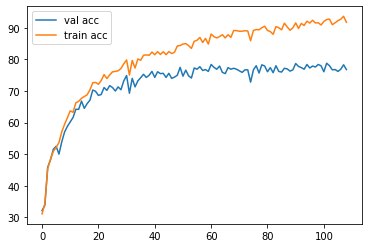


Iteration 400, loss = 0.9654
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)
Checking accuracy on train set
Got 45637 / 49000 correct (93.14)


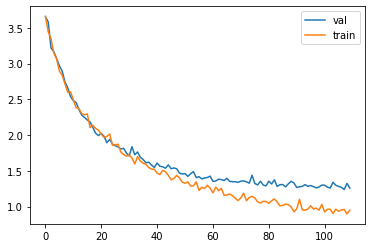

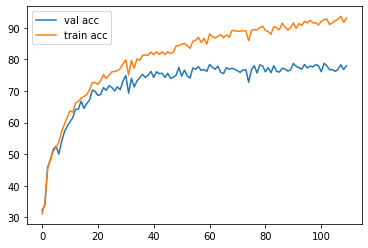


Iteration 600, loss = 0.9456
Checking accuracy on validation set
Got 789 / 1000 correct (78.90)
Checking accuracy on train set
Got 45836 / 49000 correct (93.54)


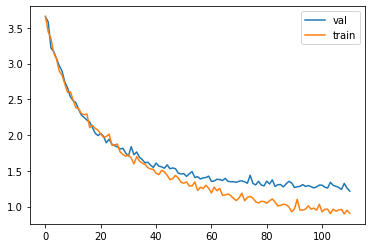

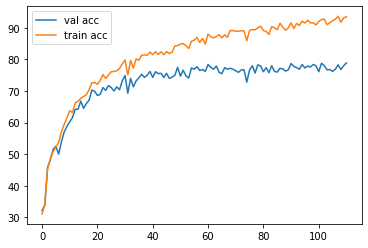


epoch  28
Iteration 0, loss = 0.8213
Checking accuracy on validation set
Got 779 / 1000 correct (77.90)
Checking accuracy on train set
Got 45784 / 49000 correct (93.44)


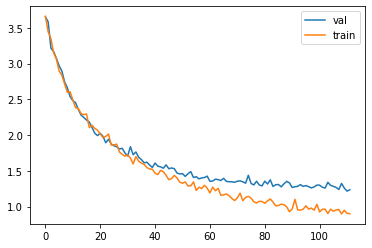

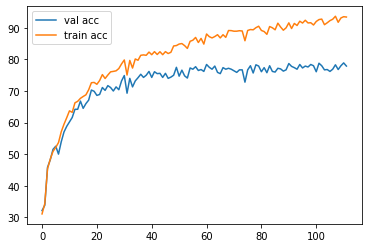


Iteration 200, loss = 0.7175
Checking accuracy on validation set
Got 774 / 1000 correct (77.40)
Checking accuracy on train set
Got 45292 / 49000 correct (92.43)


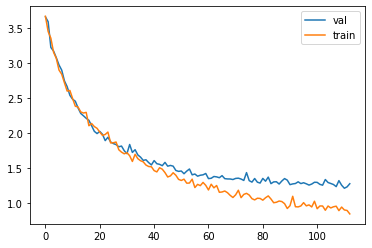

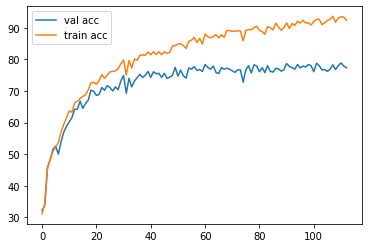


Iteration 400, loss = 0.8153
Checking accuracy on validation set
Got 787 / 1000 correct (78.70)
Checking accuracy on train set
Got 45330 / 49000 correct (92.51)


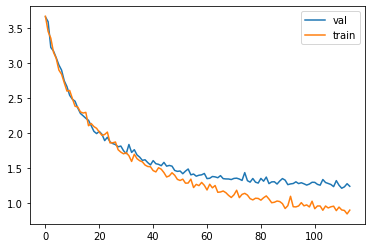

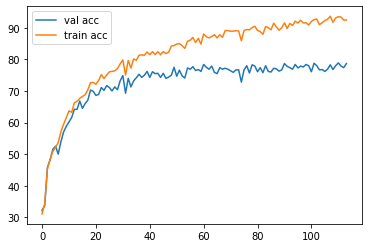


Iteration 600, loss = 0.8264
Checking accuracy on validation set
Got 782 / 1000 correct (78.20)
Checking accuracy on train set
Got 45757 / 49000 correct (93.38)


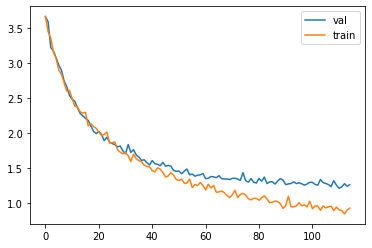

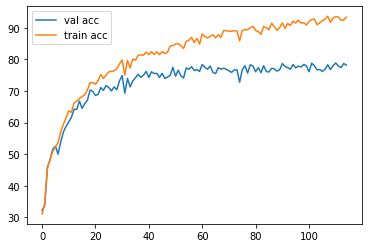


epoch  29
Iteration 0, loss = 0.8133
Checking accuracy on validation set
Got 759 / 1000 correct (75.90)
Checking accuracy on train set
Got 45386 / 49000 correct (92.62)


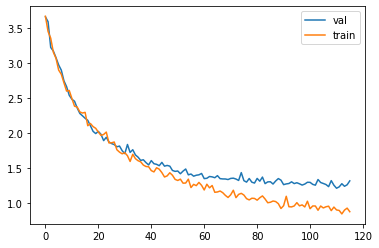

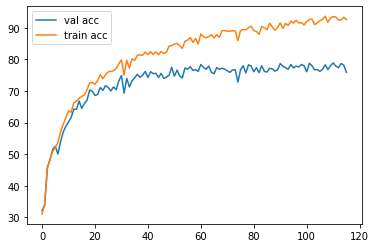


Iteration 200, loss = 0.7925
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)
Checking accuracy on train set
Got 45915 / 49000 correct (93.70)


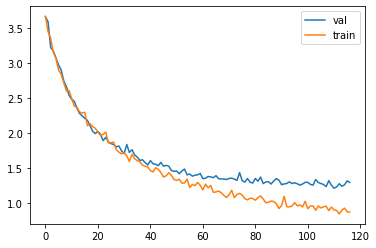

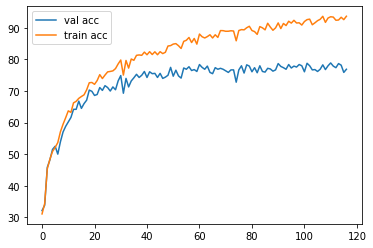


Iteration 400, loss = 0.7707
Checking accuracy on validation set
Got 772 / 1000 correct (77.20)
Checking accuracy on train set
Got 45785 / 49000 correct (93.44)


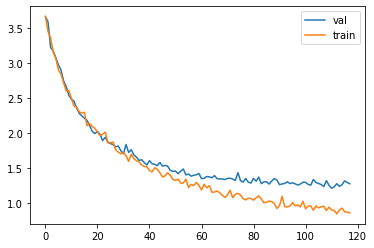

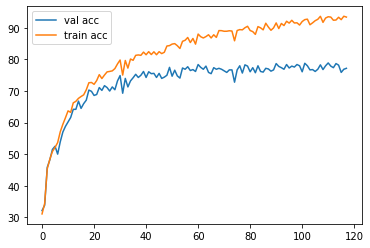


Iteration 600, loss = 0.7680
Checking accuracy on validation set
Got 766 / 1000 correct (76.60)
Checking accuracy on train set
Got 44908 / 49000 correct (91.65)


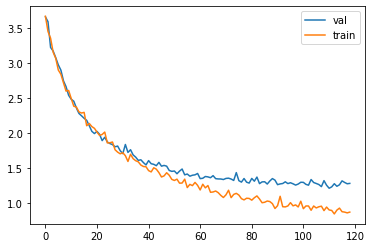

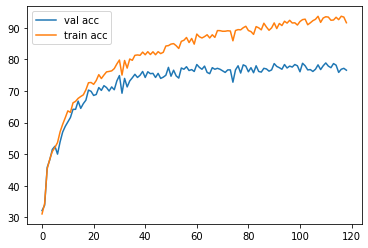


epoch  30
Iteration 0, loss = 0.7999
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)
Checking accuracy on train set
Got 46165 / 49000 correct (94.21)


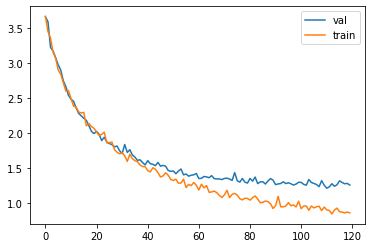

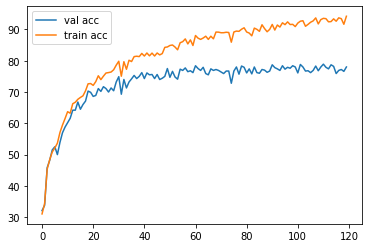


Iteration 200, loss = 0.9797
Checking accuracy on validation set
Got 761 / 1000 correct (76.10)
Checking accuracy on train set
Got 43890 / 49000 correct (89.57)


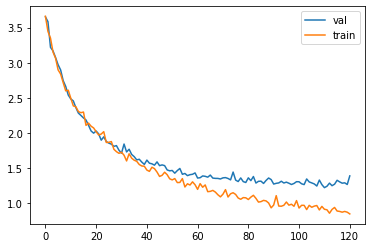

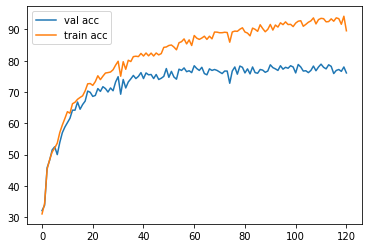


Iteration 400, loss = 0.8381
Checking accuracy on validation set
Got 765 / 1000 correct (76.50)
Checking accuracy on train set
Got 44802 / 49000 correct (91.43)


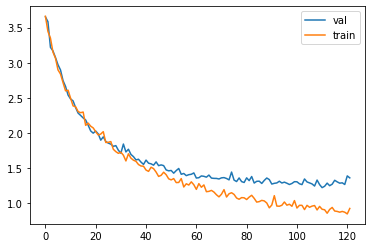

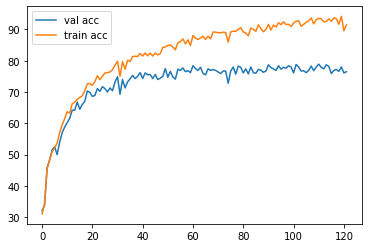


Iteration 600, loss = 0.8307
Checking accuracy on validation set
Got 789 / 1000 correct (78.90)
Checking accuracy on train set
Got 46529 / 49000 correct (94.96)


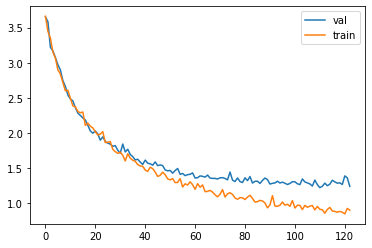

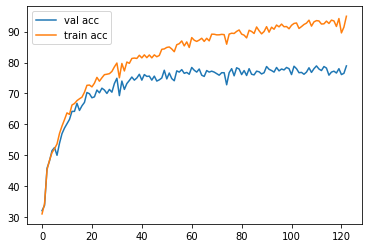


epoch  31
Iteration 0, loss = 0.7529
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)
Checking accuracy on train set
Got 46018 / 49000 correct (93.91)


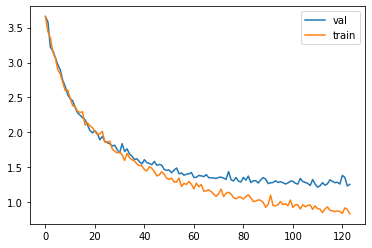

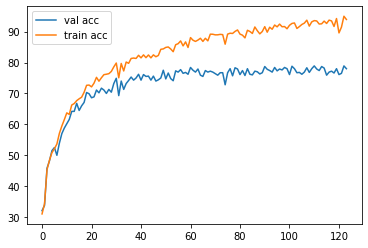


Iteration 200, loss = 0.9202
Checking accuracy on validation set
Got 766 / 1000 correct (76.60)
Checking accuracy on train set
Got 46059 / 49000 correct (94.00)


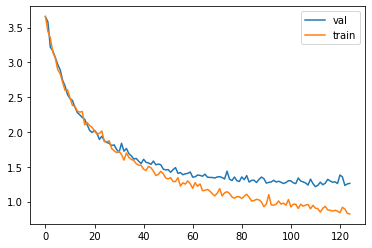

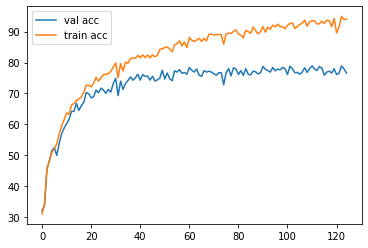


Iteration 400, loss = 1.0313
Checking accuracy on validation set
Got 783 / 1000 correct (78.30)
Checking accuracy on train set
Got 46210 / 49000 correct (94.31)


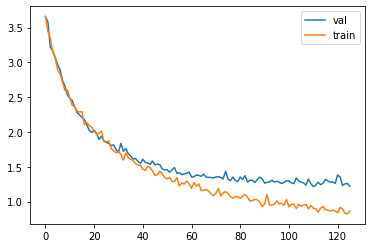

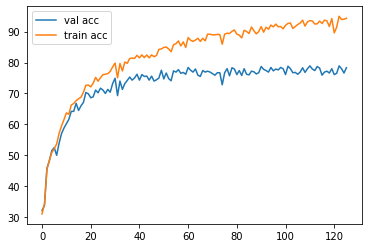


Iteration 600, loss = 0.6581
Checking accuracy on validation set
Got 781 / 1000 correct (78.10)
Checking accuracy on train set
Got 45807 / 49000 correct (93.48)


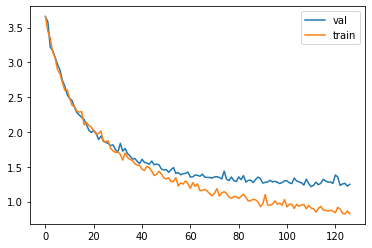

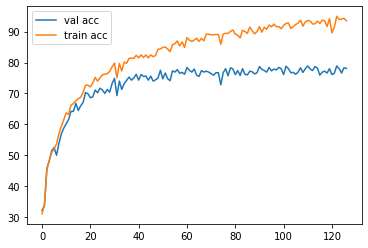


epoch  32
Iteration 0, loss = 0.7629
Checking accuracy on validation set
Got 779 / 1000 correct (77.90)
Checking accuracy on train set
Got 45790 / 49000 correct (93.45)


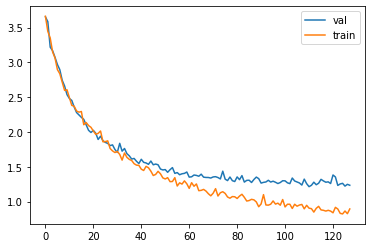

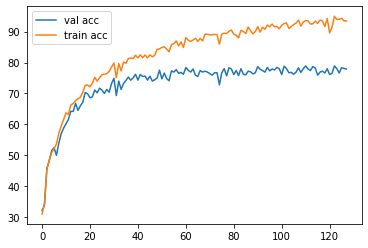


Iteration 200, loss = 0.8063
Checking accuracy on validation set
Got 785 / 1000 correct (78.50)
Checking accuracy on train set
Got 46242 / 49000 correct (94.37)


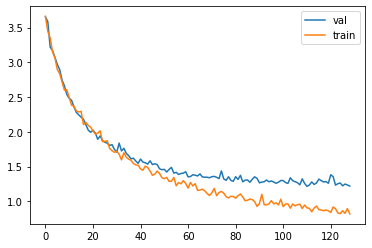

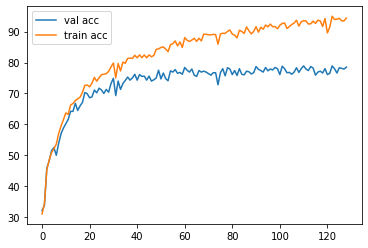


Iteration 400, loss = 0.8990
Checking accuracy on validation set
Got 766 / 1000 correct (76.60)
Checking accuracy on train set
Got 45593 / 49000 correct (93.05)


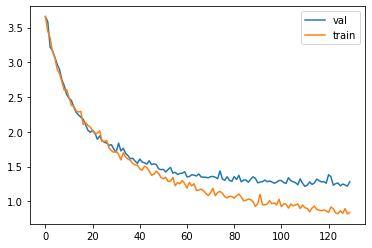

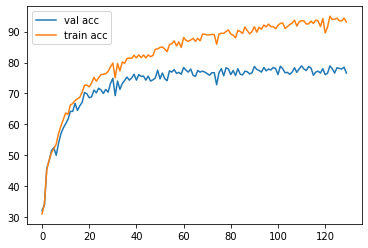


Iteration 600, loss = 0.8081
Checking accuracy on validation set
Got 765 / 1000 correct (76.50)
Checking accuracy on train set
Got 45942 / 49000 correct (93.76)


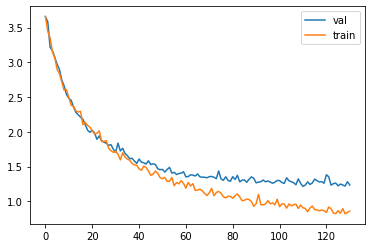

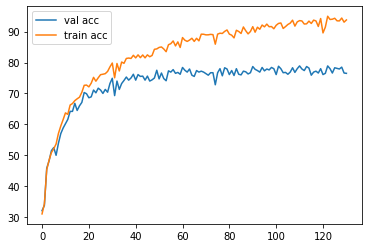


epoch  33
Iteration 0, loss = 0.7836
Checking accuracy on validation set
Got 775 / 1000 correct (77.50)
Checking accuracy on train set
Got 46253 / 49000 correct (94.39)


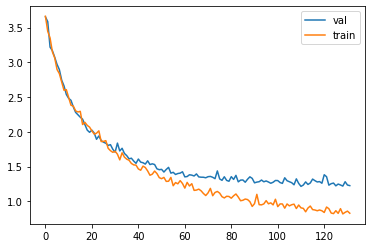

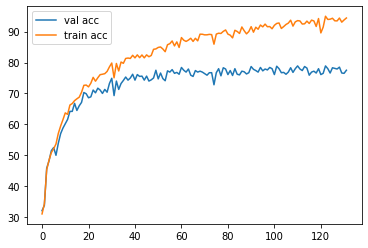


Iteration 200, loss = 0.7765
Checking accuracy on validation set
Got 798 / 1000 correct (79.80)
Checking accuracy on train set
Got 46282 / 49000 correct (94.45)


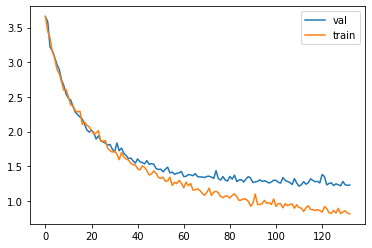

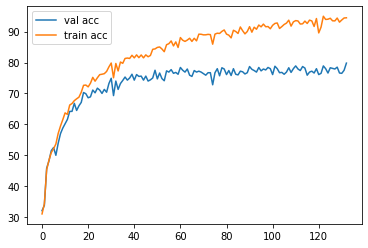


Iteration 400, loss = 0.9591
Checking accuracy on validation set
Got 762 / 1000 correct (76.20)
Checking accuracy on train set
Got 46218 / 49000 correct (94.32)


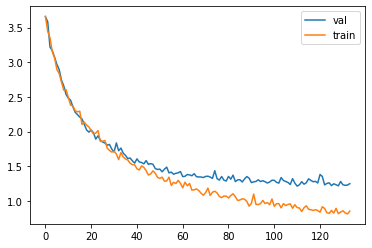

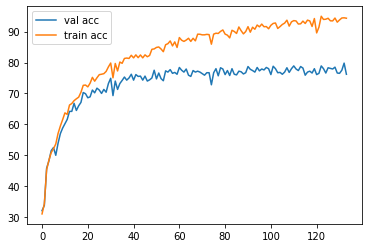


Iteration 600, loss = 0.7952
Checking accuracy on validation set
Got 782 / 1000 correct (78.20)
Checking accuracy on train set
Got 46674 / 49000 correct (95.25)


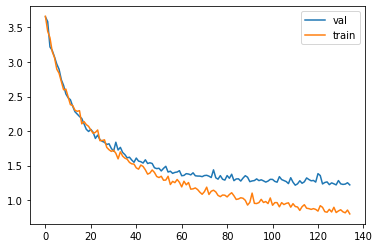

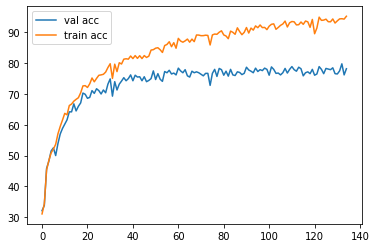


epoch  34
Iteration 0, loss = 0.9322
Checking accuracy on validation set
Got 774 / 1000 correct (77.40)
Checking accuracy on train set
Got 46148 / 49000 correct (94.18)


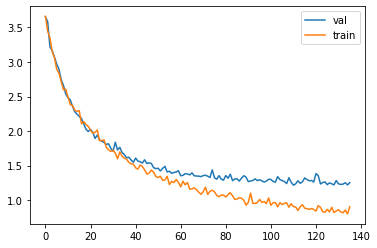

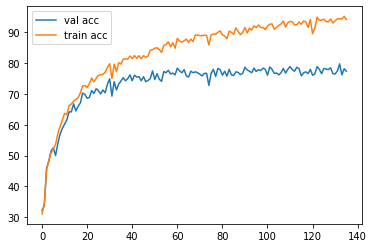


Iteration 200, loss = 0.6490
Checking accuracy on validation set
Got 773 / 1000 correct (77.30)
Checking accuracy on train set
Got 45794 / 49000 correct (93.46)


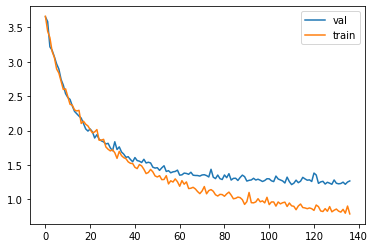

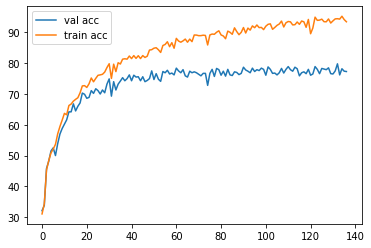


Iteration 400, loss = 0.8929
Checking accuracy on validation set
Got 775 / 1000 correct (77.50)
Checking accuracy on train set
Got 46261 / 49000 correct (94.41)


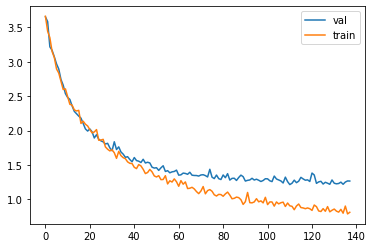

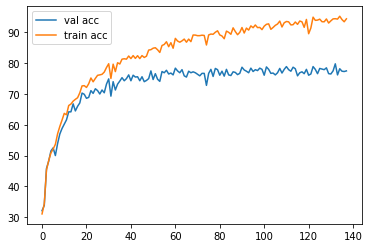


Iteration 600, loss = 0.7877
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)
Checking accuracy on train set
Got 46150 / 49000 correct (94.18)


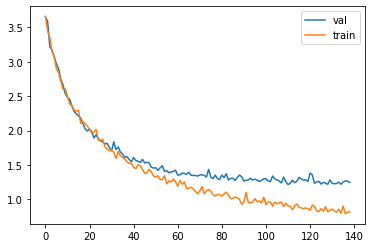

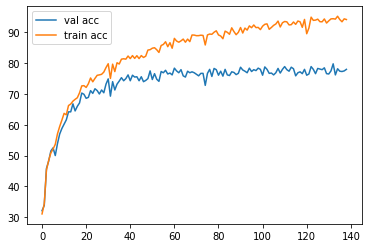


epoch  35
Iteration 0, loss = 0.7602
Checking accuracy on validation set
Got 767 / 1000 correct (76.70)
Checking accuracy on train set
Got 46307 / 49000 correct (94.50)


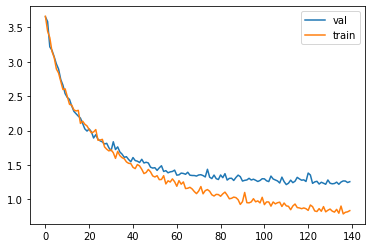

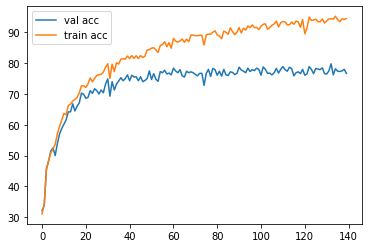


Iteration 200, loss = 0.8043
Checking accuracy on validation set
Got 765 / 1000 correct (76.50)
Checking accuracy on train set
Got 45955 / 49000 correct (93.79)


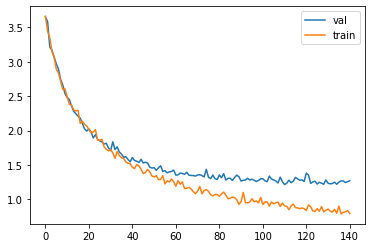

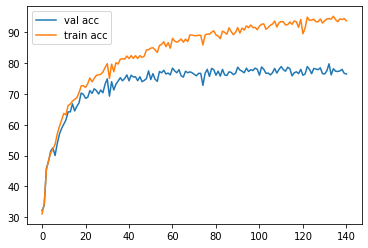


Iteration 400, loss = 0.7894
Checking accuracy on validation set
Got 765 / 1000 correct (76.50)
Checking accuracy on train set
Got 46183 / 49000 correct (94.25)


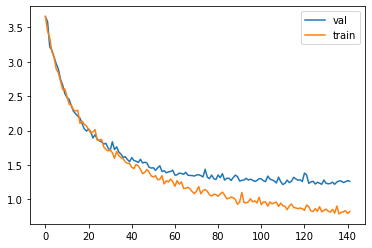

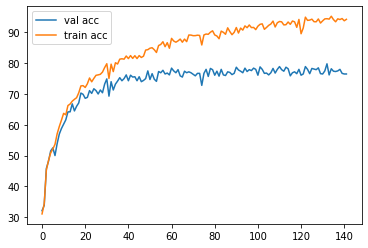


Iteration 600, loss = 0.8415
Checking accuracy on validation set
Got 786 / 1000 correct (78.60)
Checking accuracy on train set
Got 46848 / 49000 correct (95.61)


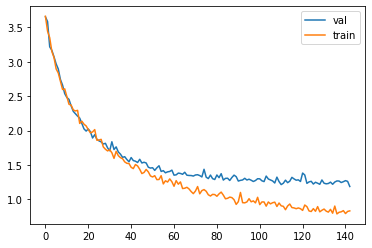

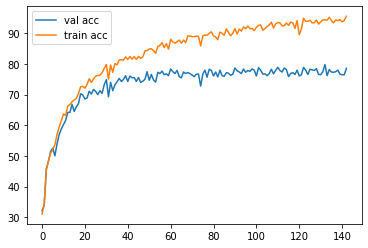


epoch  36
Iteration 0, loss = 0.7273
Checking accuracy on validation set
Got 761 / 1000 correct (76.10)
Checking accuracy on train set
Got 45599 / 49000 correct (93.06)


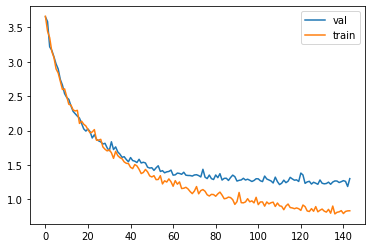

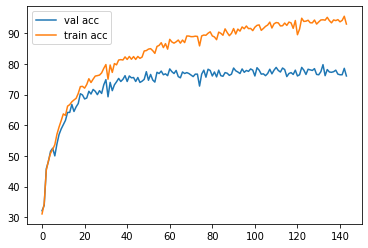


Iteration 200, loss = 0.7920
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)
Checking accuracy on train set
Got 46311 / 49000 correct (94.51)


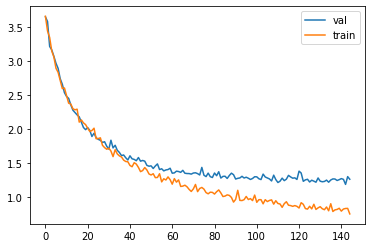

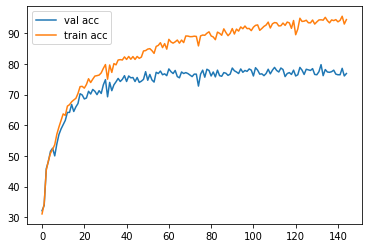


Iteration 400, loss = 0.6565
Checking accuracy on validation set
Got 776 / 1000 correct (77.60)
Checking accuracy on train set
Got 46187 / 49000 correct (94.26)


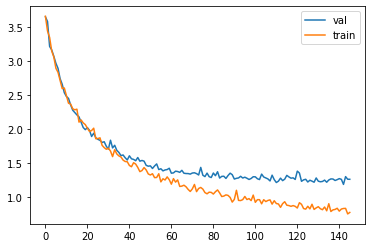

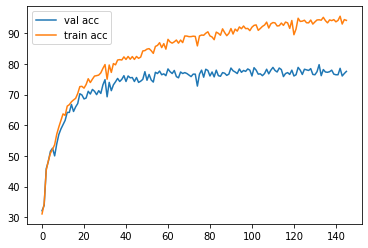


Iteration 600, loss = 1.1959
Checking accuracy on validation set
Got 768 / 1000 correct (76.80)
Checking accuracy on train set
Got 45038 / 49000 correct (91.91)


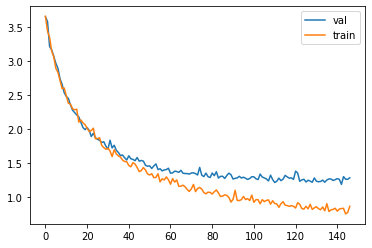

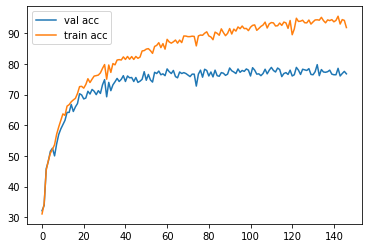


epoch  37
Iteration 0, loss = 0.6092
Checking accuracy on validation set
Got 762 / 1000 correct (76.20)
Checking accuracy on train set
Got 45877 / 49000 correct (93.63)


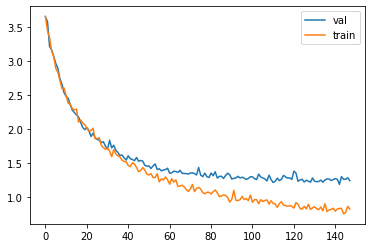

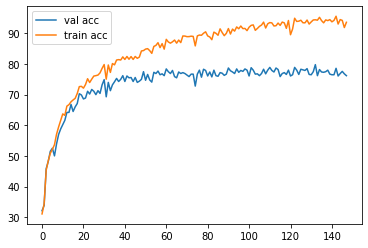


Iteration 200, loss = 0.8115
Checking accuracy on validation set
Got 766 / 1000 correct (76.60)
Checking accuracy on train set
Got 46367 / 49000 correct (94.63)


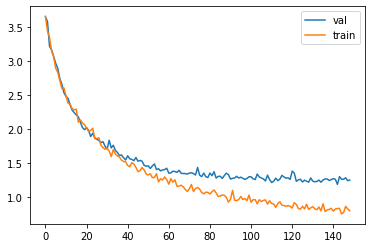

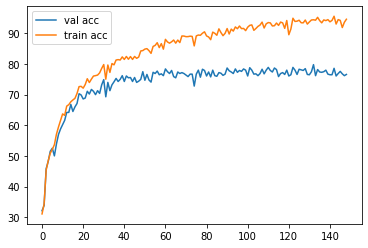


Iteration 400, loss = 0.6942
Checking accuracy on validation set
Got 775 / 1000 correct (77.50)
Checking accuracy on train set
Got 46421 / 49000 correct (94.74)


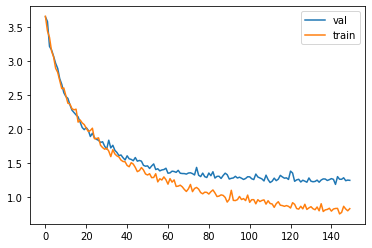

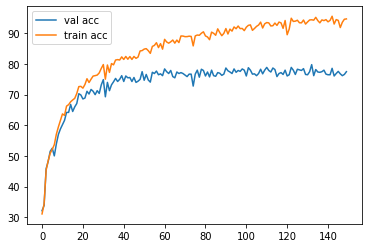


Iteration 600, loss = 0.7368
Checking accuracy on validation set
Got 768 / 1000 correct (76.80)
Checking accuracy on train set
Got 46328 / 49000 correct (94.55)


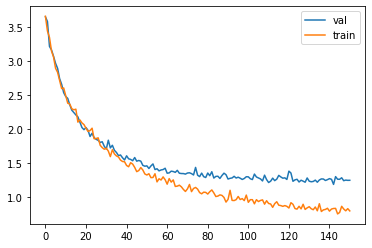

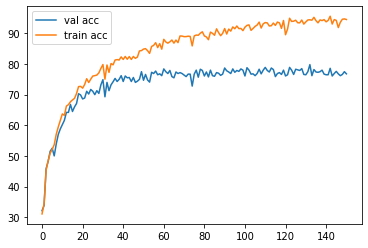


epoch  38
Iteration 0, loss = 0.9459
Checking accuracy on validation set
Got 767 / 1000 correct (76.70)
Checking accuracy on train set
Got 45742 / 49000 correct (93.35)


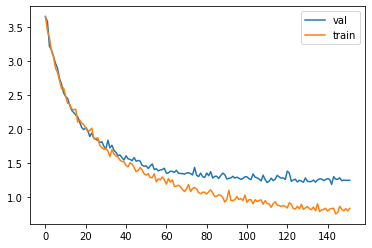

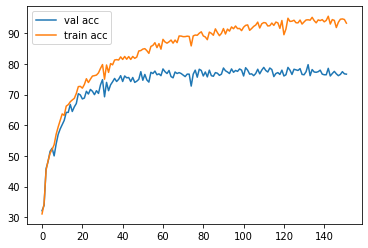


Iteration 200, loss = 0.7036
Checking accuracy on validation set
Got 765 / 1000 correct (76.50)
Checking accuracy on train set
Got 46026 / 49000 correct (93.93)


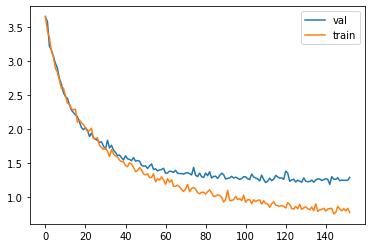

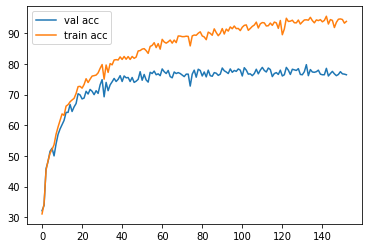


Iteration 400, loss = 0.6601
Checking accuracy on validation set
Got 779 / 1000 correct (77.90)
Checking accuracy on train set
Got 46379 / 49000 correct (94.65)


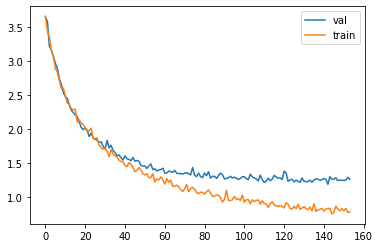

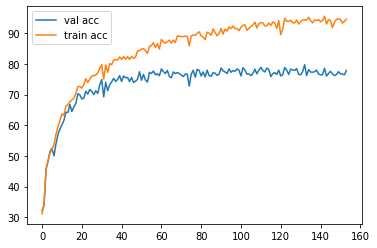


Iteration 600, loss = 0.7492
Checking accuracy on validation set
Got 788 / 1000 correct (78.80)
Checking accuracy on train set
Got 46657 / 49000 correct (95.22)


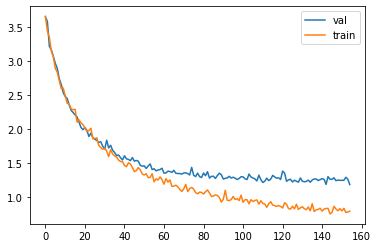

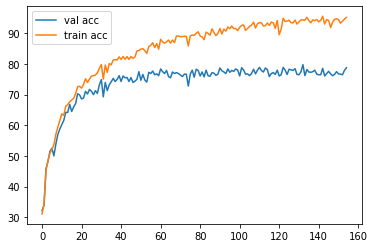


epoch  39
Iteration 0, loss = 0.9192
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)
Checking accuracy on train set
Got 45393 / 49000 correct (92.64)


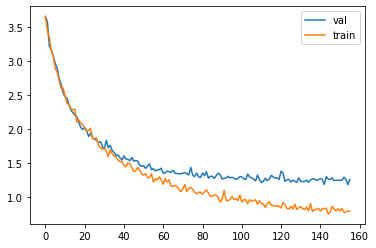

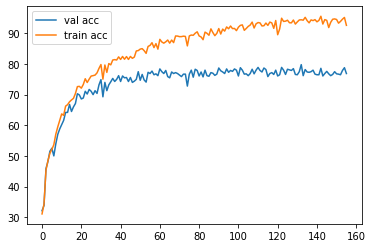


Iteration 200, loss = 0.9496
Checking accuracy on validation set
Got 763 / 1000 correct (76.30)
Checking accuracy on train set
Got 46507 / 49000 correct (94.91)


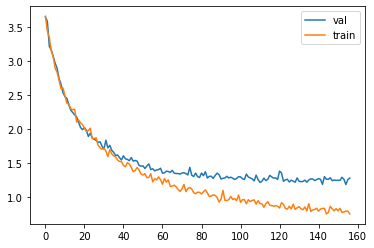

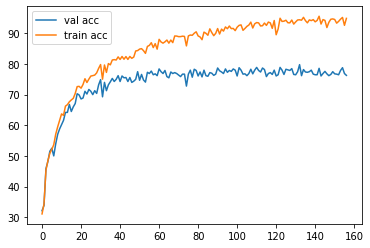


Iteration 400, loss = 0.7896
Checking accuracy on validation set
Got 767 / 1000 correct (76.70)
Checking accuracy on train set
Got 45772 / 49000 correct (93.41)


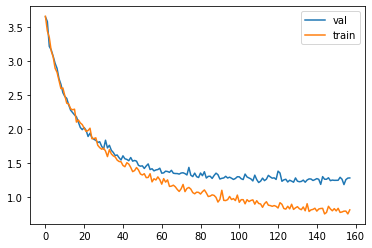

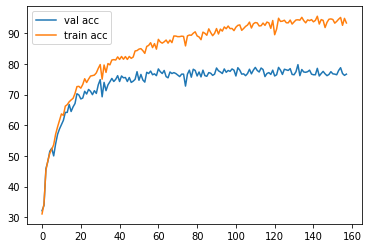


Iteration 600, loss = 1.1095
Checking accuracy on validation set
Got 786 / 1000 correct (78.60)
Checking accuracy on train set
Got 46764 / 49000 correct (95.44)


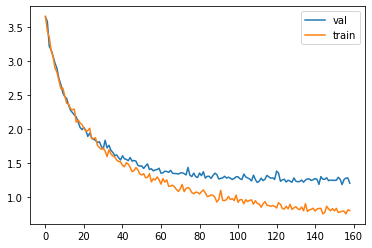

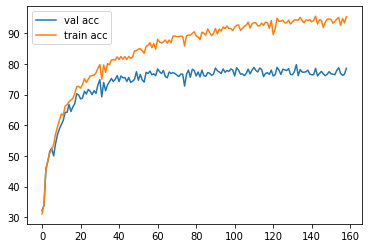


epoch  40
Iteration 0, loss = 0.6280
Checking accuracy on validation set
Got 776 / 1000 correct (77.60)
Checking accuracy on train set
Got 46777 / 49000 correct (95.46)


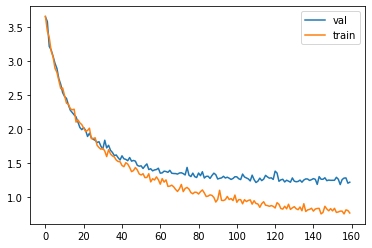

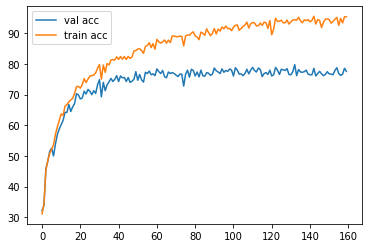


Iteration 200, loss = 0.7020
Checking accuracy on validation set
Got 782 / 1000 correct (78.20)
Checking accuracy on train set
Got 46620 / 49000 correct (95.14)


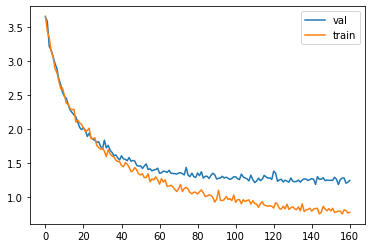

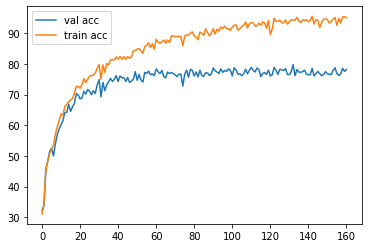


Iteration 400, loss = 1.0936
Checking accuracy on validation set
Got 782 / 1000 correct (78.20)
Checking accuracy on train set
Got 46862 / 49000 correct (95.64)


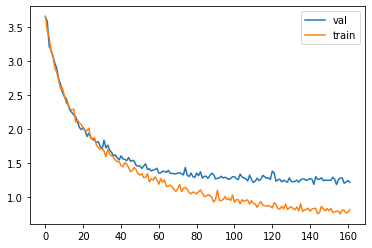

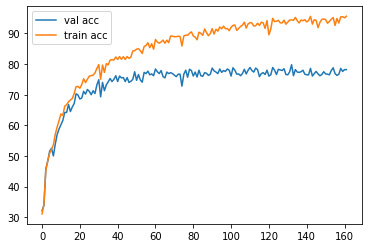


Iteration 600, loss = 0.7315
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)
Checking accuracy on train set
Got 46792 / 49000 correct (95.49)


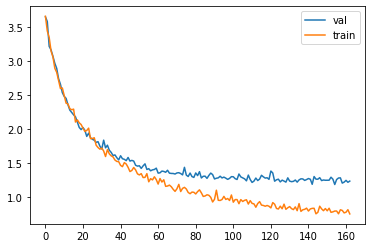

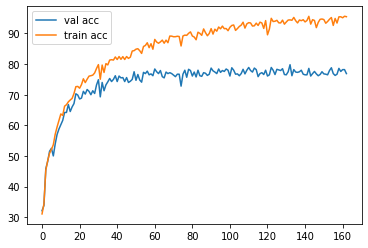


epoch  41
Iteration 0, loss = 0.9571
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)
Checking accuracy on train set
Got 45911 / 49000 correct (93.70)


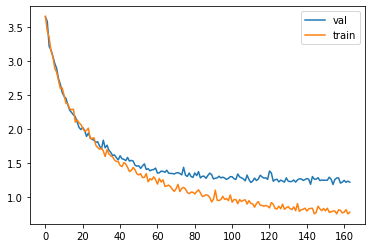

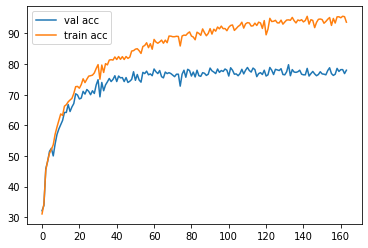


Iteration 200, loss = 0.7265
Checking accuracy on validation set
Got 763 / 1000 correct (76.30)
Checking accuracy on train set
Got 46710 / 49000 correct (95.33)


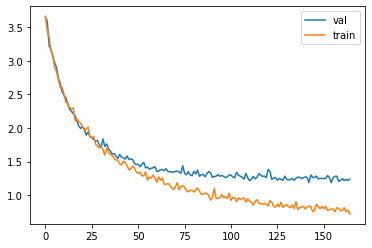

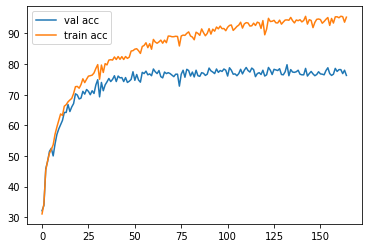


Iteration 400, loss = 0.6226
Checking accuracy on validation set
Got 769 / 1000 correct (76.90)
Checking accuracy on train set
Got 46997 / 49000 correct (95.91)


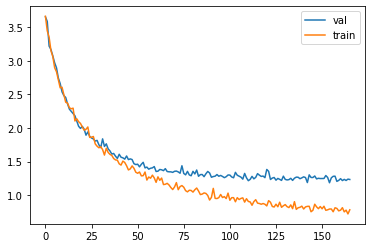

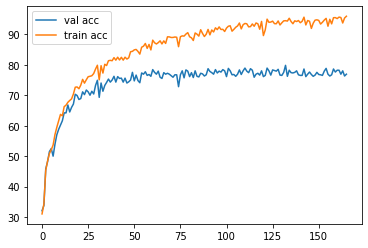


Iteration 600, loss = 0.7547
Checking accuracy on validation set
Got 789 / 1000 correct (78.90)
Checking accuracy on train set
Got 47242 / 49000 correct (96.41)


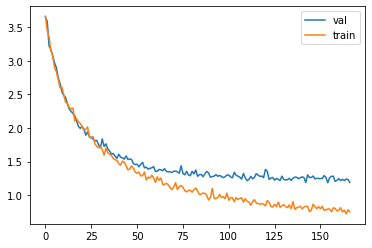

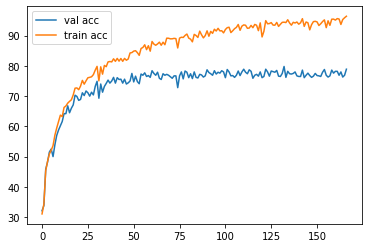


epoch  42
Iteration 0, loss = 0.6280
Checking accuracy on validation set
Got 782 / 1000 correct (78.20)
Checking accuracy on train set
Got 46795 / 49000 correct (95.50)


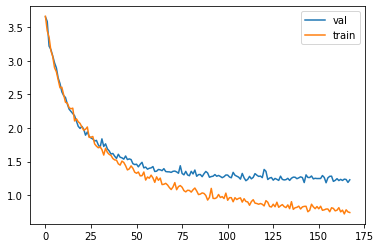

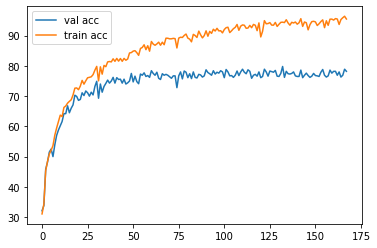


Iteration 200, loss = 0.7256
Checking accuracy on validation set
Got 781 / 1000 correct (78.10)
Checking accuracy on train set
Got 46942 / 49000 correct (95.80)


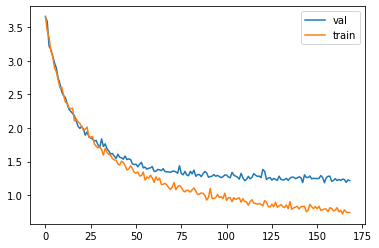

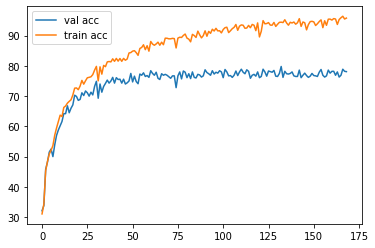


Iteration 400, loss = 0.8653
Checking accuracy on validation set
Got 763 / 1000 correct (76.30)
Checking accuracy on train set
Got 46895 / 49000 correct (95.70)


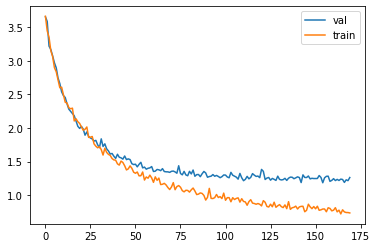

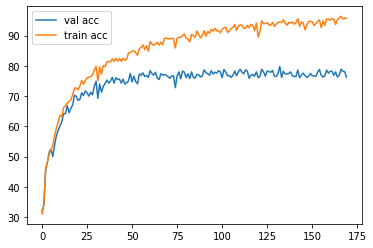


Iteration 600, loss = 0.9653
Checking accuracy on validation set
Got 752 / 1000 correct (75.20)
Checking accuracy on train set
Got 45923 / 49000 correct (93.72)


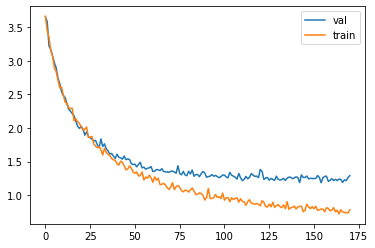

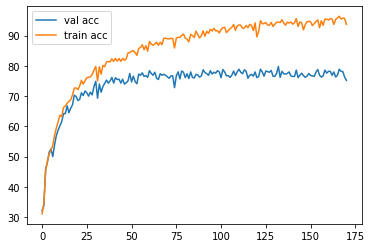


epoch  43
Iteration 0, loss = 0.6394
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)
Checking accuracy on train set
Got 46782 / 49000 correct (95.47)


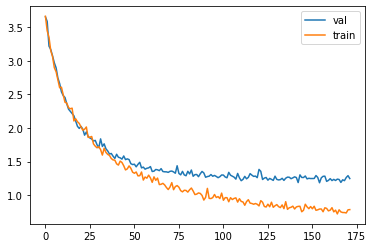

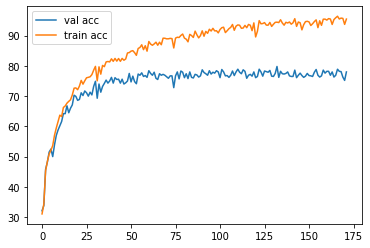


Iteration 200, loss = 0.7317
Checking accuracy on validation set
Got 772 / 1000 correct (77.20)
Checking accuracy on train set
Got 46339 / 49000 correct (94.57)


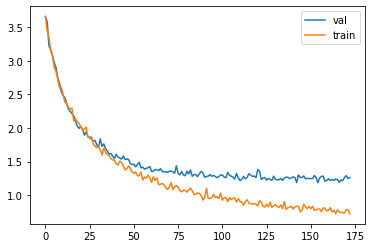

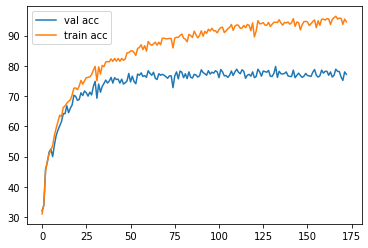


Iteration 400, loss = 0.6122
Checking accuracy on validation set
Got 772 / 1000 correct (77.20)
Checking accuracy on train set
Got 46795 / 49000 correct (95.50)


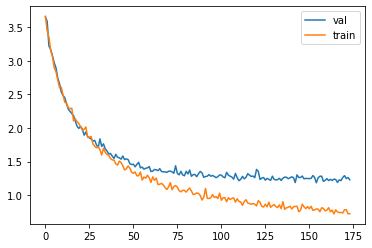

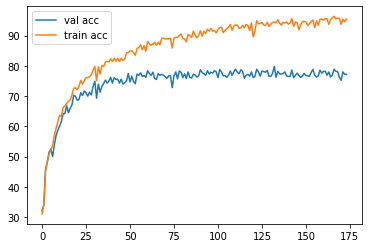


Iteration 600, loss = 0.6864
Checking accuracy on validation set
Got 759 / 1000 correct (75.90)
Checking accuracy on train set
Got 45997 / 49000 correct (93.87)


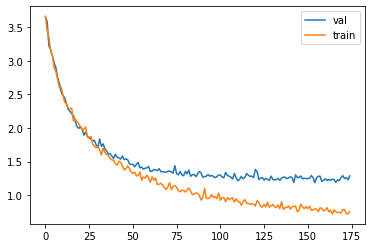

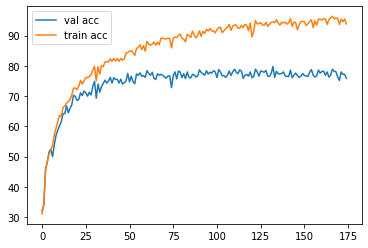


epoch  44
Iteration 0, loss = 0.7459
Checking accuracy on validation set
Got 788 / 1000 correct (78.80)
Checking accuracy on train set
Got 47107 / 49000 correct (96.14)


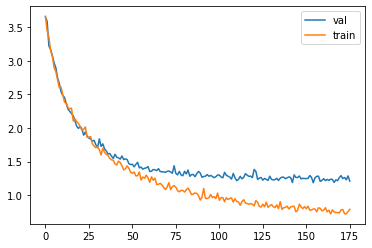

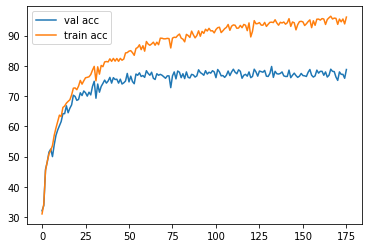


Iteration 200, loss = 0.7986
Checking accuracy on validation set
Got 777 / 1000 correct (77.70)
Checking accuracy on train set
Got 46735 / 49000 correct (95.38)


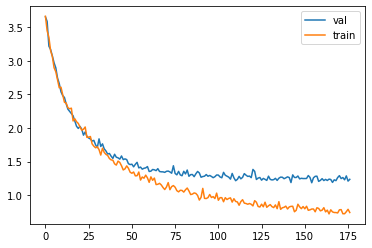

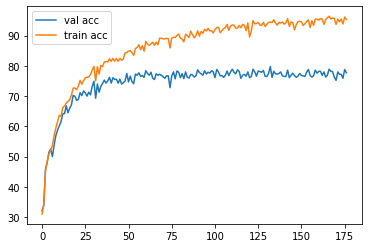


Iteration 400, loss = 0.6713
Checking accuracy on validation set
Got 783 / 1000 correct (78.30)
Checking accuracy on train set
Got 46942 / 49000 correct (95.80)


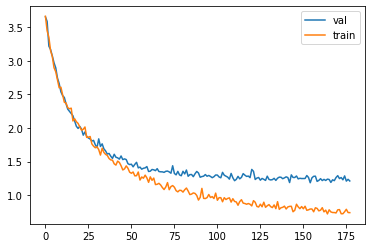

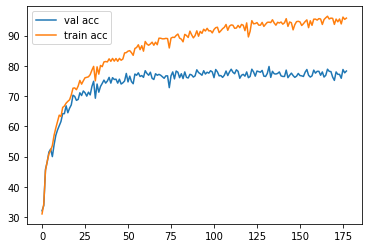


Iteration 600, loss = 0.6565
Checking accuracy on validation set
Got 777 / 1000 correct (77.70)
Checking accuracy on train set
Got 46998 / 49000 correct (95.91)


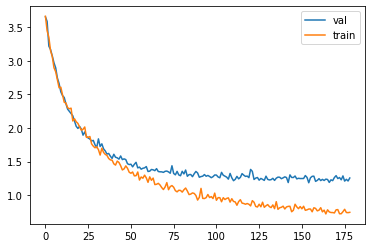

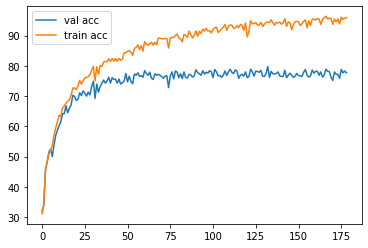


epoch  45
Iteration 0, loss = 0.7877
Checking accuracy on validation set
Got 779 / 1000 correct (77.90)
Checking accuracy on train set
Got 47142 / 49000 correct (96.21)


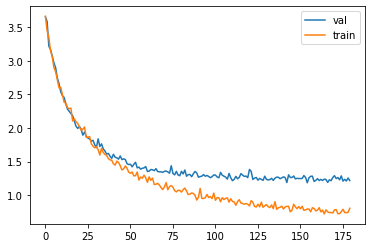

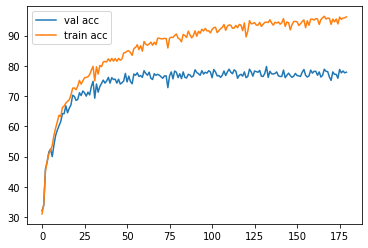


Iteration 200, loss = 0.8112
Checking accuracy on validation set
Got 765 / 1000 correct (76.50)
Checking accuracy on train set
Got 47072 / 49000 correct (96.07)


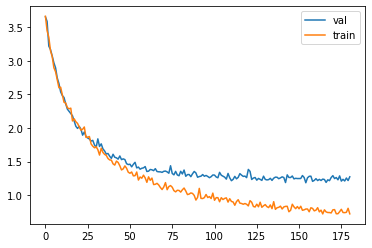

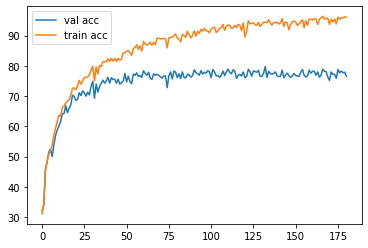


Iteration 400, loss = 0.7265
Checking accuracy on validation set
Got 788 / 1000 correct (78.80)
Checking accuracy on train set
Got 47258 / 49000 correct (96.44)


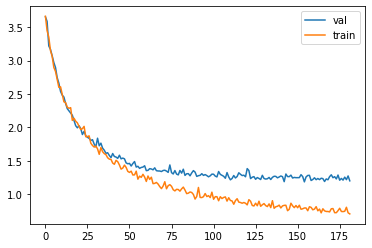

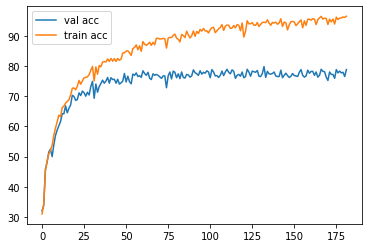


Iteration 600, loss = 0.7447
Checking accuracy on validation set
Got 781 / 1000 correct (78.10)
Checking accuracy on train set
Got 46909 / 49000 correct (95.73)


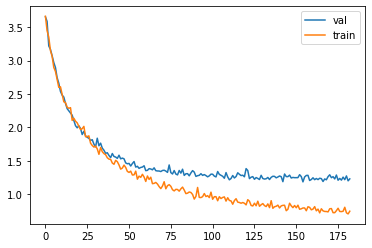

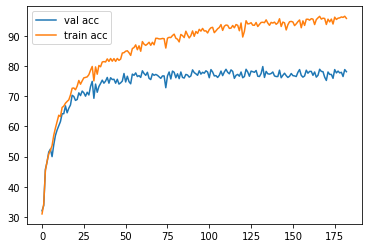


epoch  46
Iteration 0, loss = 0.6079
Checking accuracy on validation set
Got 786 / 1000 correct (78.60)
Checking accuracy on train set
Got 47130 / 49000 correct (96.18)


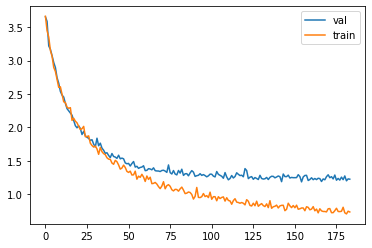

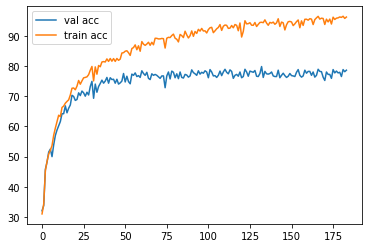


Iteration 200, loss = 0.6306
Checking accuracy on validation set
Got 784 / 1000 correct (78.40)
Checking accuracy on train set
Got 47237 / 49000 correct (96.40)


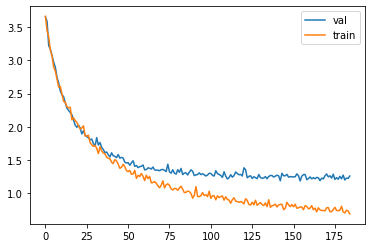

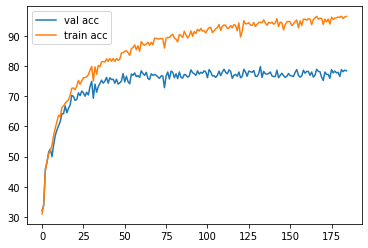


Iteration 400, loss = 0.8362
Checking accuracy on validation set
Got 781 / 1000 correct (78.10)
Checking accuracy on train set
Got 46755 / 49000 correct (95.42)


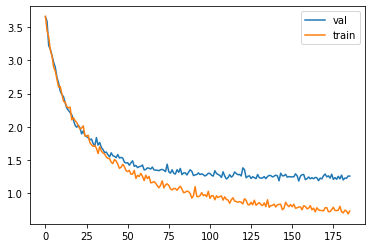

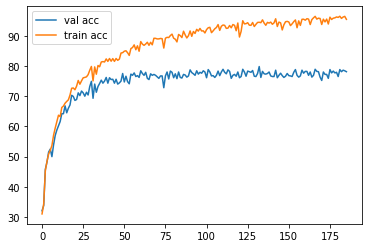


Iteration 600, loss = 0.7079
Checking accuracy on validation set
Got 768 / 1000 correct (76.80)
Checking accuracy on train set
Got 46606 / 49000 correct (95.11)


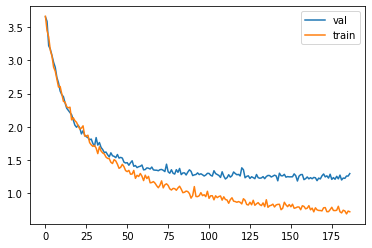

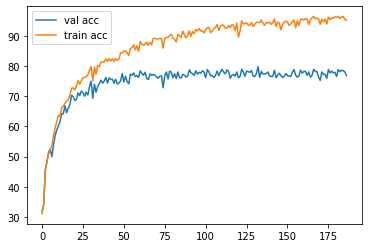


epoch  47
Iteration 0, loss = 0.6871
Checking accuracy on validation set
Got 761 / 1000 correct (76.10)
Checking accuracy on train set
Got 46786 / 49000 correct (95.48)


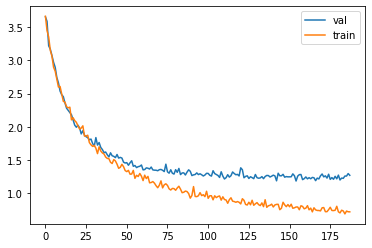

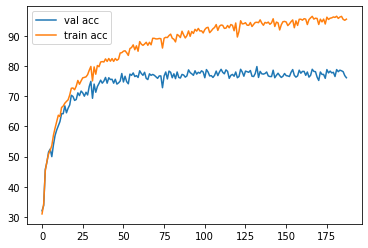


Iteration 200, loss = 0.7426
Checking accuracy on validation set
Got 780 / 1000 correct (78.00)
Checking accuracy on train set
Got 46510 / 49000 correct (94.92)


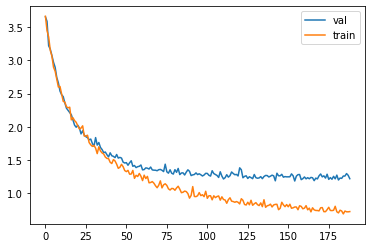

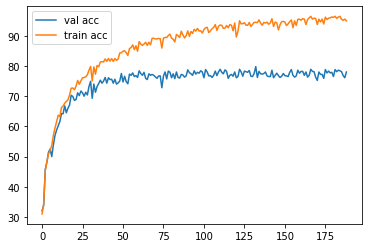


Iteration 400, loss = 0.6866
Checking accuracy on validation set
Got 773 / 1000 correct (77.30)
Checking accuracy on train set


KeyboardInterrupt: ignored

In [2]:
# Another model

import torch
# assert '.'.join(torch.__version__.split('.')[:2]) == '1.4'
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler

import torchvision.datasets as dset
import torchvision.transforms as T

import numpy as np

NUM_TRAIN = 49000

# The torchvision.transforms package provides tools for preprocessing data
# and for performing data augmentation; here we set up a transform to
# preprocess the data by subtracting the mean RGB value and dividing by the
# standard deviation of each RGB value; we've hardcoded the mean and std.
transform = T.Compose([
                T.ToTensor(),
                T.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
            ])

# We set up a Dataset object for each split (train / val / test); Datasets load
# training examples one at a time, so we wrap each Dataset in a DataLoader which
# iterates through the Dataset and forms minibatches. We divide the CIFAR-10
# training set into train and val sets by passing a Sampler object to the
# DataLoader telling how it should sample from the underlying Dataset.
cifar10_train = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                             transform=transform)
loader_train = DataLoader(cifar10_train, batch_size=64, 
                          sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN)))

cifar10_val = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                           transform=transform)
loader_val = DataLoader(cifar10_val, batch_size=64, 
                        sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN, 50000)))

cifar10_test = dset.CIFAR10('./cs231n/datasets', train=False, download=True, 
                            transform=transform)
loader_test = DataLoader(cifar10_test, batch_size=64)
!nvidia-smi

USE_GPU = True

dtype = torch.float32 # we will be using float throughout this tutorial

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

# Constant to control how frequently we print train loss

print('using device:', device)
!nvidia-smi

import matplotlib.pyplot as plt
from statistics import mean 
import torch.nn.functional as F  # useful stateless functions

def check_accuracy_part34(loader, model, train_part=False):
    if train_part==False:
      if loader.dataset.train:
          print('Checking accuracy on validation set')
      else:
          print('Checking accuracy on test set')   
    else:
       print('Checking accuracy on train set')
    num_correct = 0
    num_samples = 0
    model.eval()  # set model to evaluation mode

    batch_loss = []
    with torch.no_grad():
        for x, y in loader:
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)
            scores = model(x)
            _, preds = scores.max(1)
            num_correct += (preds == y).sum()
            num_samples += preds.size(0)
            # print(nn.CrossEntropyLoss()(scores, y).type)
            # print(nn.CrossEntropyLoss()(scores, y))

            batch_loss.append(nn.CrossEntropyLoss()(scores, y).item())

        acc = float(num_correct) / num_samples

        print('Got %d / %d correct (%.2f)' % (num_correct, num_samples, 100 * acc))
        return sum(batch_loss)/len(batch_loss), 100 * acc, 
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

def train_part(model, optimizer, epochs=1, ld=0.01, print_every = 100):
    """
    Train a model on CIFAR-10 using the PyTorch Module API.
    
    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model
    - epochs: (Optional) A Python integer giving the number of epochs to train for
    
    Returns: Nothing, but prints model accuracies during training.
    """

    trainning_loss = []
    val_loss = []
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    ave_trainning_loss = 0.0

    train_acc_hist = []
    val_acc_hist  = []
    for e in range(epochs):
        print("epoch ", e)
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            loss = nn.CrossEntropyLoss()(scores, y)

            l2_reg = 0.0
            for param in model.parameters():
                l2_reg += torch.norm(param, 2)
            loss += ld*l2_reg

            ave_trainning_loss = loss.item()*0.1 + 0.9*ave_trainning_loss

            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            # This is the backwards pass: compute the gradient of the loss with
            # respect to each  parameter of the model.
            loss.backward()


            # Actually update the parameters of the model using the gradients
            # computed by the backwards pass.
            optimizer.step()

            if t % print_every == 0:
                print('Iteration %d, loss = %.4f' % (t, loss.item()))
                # print('Valid loss = ', val_loss)
                val_loss_, val_acc = check_accuracy_part34(loader_val, model)
                _, train_acc  = check_accuracy_part34(loader_train, model, train_part=True)
                trainning_loss.append(ave_trainning_loss)
                val_loss.append(val_loss_ + ld*l2_reg)

                train_acc_hist.append(train_acc)
                val_acc_hist.append(val_acc)

                # print(trainning_loss)
                # print(val_loss)
                if len(val_loss) > 2:
                  plt.plot(list(range(len(val_loss)-1)), val_loss[1:], label='val')
                  plt.plot(list(range(len(trainning_loss)-1)), trainning_loss[1:], label='train')
                  plt.legend()
                  plt.show()

                  plt.plot(list(range(len(val_acc_hist)-1)), val_acc_hist[1:], label='val acc')
                  plt.plot(list(range(len(train_acc_hist)-1)), train_acc_hist[1:], label='train acc')
                  plt.legend()
                  plt.show()
                print()


model = None
optimizer = None

channel_1  = int(32)
channel_2  = int(32)
channel_3  = int(32)

channel_4  = int(32)
channel_5  = int(32)
channel_6  = int(32)

channel_7  = int(64)
channel_8  = int(64)
channel_9  = int(64)

channel_10 = int(128)
channel_11 = int(128)
channel_12 = int(128)

channel_13 = int(256)
channel_14 = int(256)
channel_15 = int(256)

channel_16 = int(512)

# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
def flatten(x):
    N = x.shape[0] # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image
    
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3,         out_channels=channel_1, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_1),
    nn.LeakyReLU(),
    # nn.Dropout2d(p=0.6),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.LeakyReLU(),
    # nn.Dropout2d(p=0.6),

    # nn.Conv2d(in_channels=channel_2, out_channels=channel_3, kernel_size=2, padding=0, stride=2),
    # nn.BatchNorm2d(num_features=channel_3),
    # nn.LeakyReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_3, out_channels=channel_4, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_4),
    nn.LeakyReLU(),
    # nn.Dropout2d(p=0.6),

    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.LeakyReLU(),
    # nn.Dropout2d(p=0.6),


    # nn.Conv2d(in_channels=channel_5, out_channels=channel_6, kernel_size=2, padding=0, stride=2),
    # nn.BatchNorm2d(num_features=channel_6),
    # nn.LeakyReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_6, out_channels=channel_7, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_7),
    nn.LeakyReLU(),
    # nn.Dropout2d(p=0.6),

    nn.Conv2d(in_channels=channel_7, out_channels=channel_8, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_8),
    nn.LeakyReLU(),
    # nn.Dropout2d(p=0.6),

    # nn.Conv2d(in_channels=channel_8, out_channels=channel_9, kernel_size=2, padding=0, stride=2),
    # nn.BatchNorm2d(num_features=channel_9),
    # nn.LeakyReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_9, out_channels=channel_10, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_10),
    nn.LeakyReLU(),
    nn.Dropout2d(p=0.6),

    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.LeakyReLU(),
    # nn.Dropout2d(p=0.6),

    # nn.Conv2d(in_channels=channel_11, out_channels=channel_12, kernel_size=2, padding=0, stride=2),
    # nn.BatchNorm2d(num_features=channel_12),
    # nn.LeakyReLU(),

    nn.MaxPool2d(2),

    nn.Conv2d(in_channels=channel_12, out_channels=channel_13, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_13),
    nn.LeakyReLU(),
    # nn.Dropout2d(p=0.6),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.LeakyReLU(),
    nn.Dropout2d(p=0.6),

    nn.Conv2d(in_channels=channel_14, out_channels=channel_15, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_15),
    nn.LeakyReLU(),
    # nn.Dropout2d(p=0.6),

    # nn.Conv2d(in_channels=channel_15, out_channels=channel_16, kernel_size=2, padding=0, stride=2),
    # nn.BatchNorm2d(num_features=channel_16),
    # nn.LeakyReLU(),

    nn.MaxPool2d(2),

    Flatten(),
    nn.Linear(channel_15, 1000),
    nn.Linear(1000, 10)
)

# you can use Nesterov momentum in optim.SGD
learning_rate = 1e-4

optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=0.01)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

# You should get at least 70% accuracy
!nvidia-smi
train_part(model, optimizer, epochs=50, ld=1e-2, print_every=200)
!nvidia-smi
best_model = model
check_accuracy_part34(loader_test, best_model)

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Wed Oct  7 18:26:17 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   73C    P0    87W / 149W |   1267MiB / 11441MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+---------------------

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/container.py:117: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


Got 98 / 1000 correct (9.80)
Checking accuracy on train set
Got 4902 / 49000 correct (10.00)

Iteration 200, loss = 2.4226
Checking accuracy on validation set
Got 181 / 1000 correct (18.10)
Checking accuracy on train set
Got 8951 / 49000 correct (18.27)

Iteration 400, loss = 2.3899
Checking accuracy on validation set
Got 256 / 1000 correct (25.60)
Checking accuracy on train set
Got 12998 / 49000 correct (26.53)


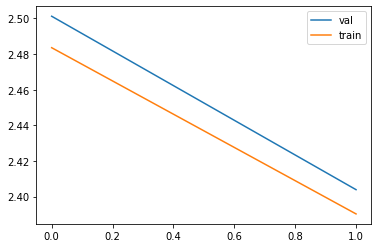

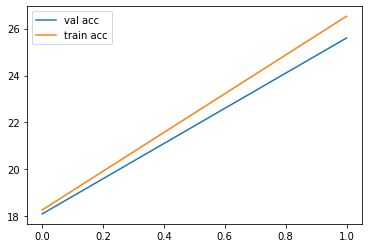


Iteration 600, loss = 2.3528
Checking accuracy on validation set
Got 384 / 1000 correct (38.40)
Checking accuracy on train set
Got 17376 / 49000 correct (35.46)


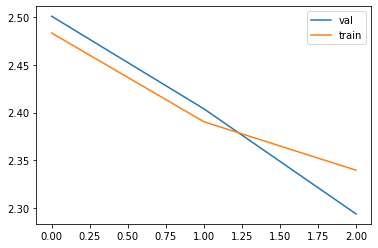

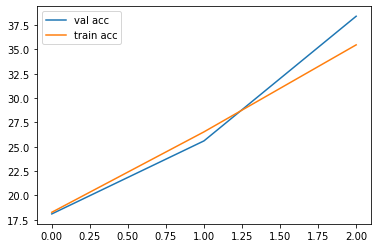


epoch  1
Iteration 0, loss = 2.3684
Checking accuracy on validation set
Got 386 / 1000 correct (38.60)
Checking accuracy on train set
Got 18346 / 49000 correct (37.44)


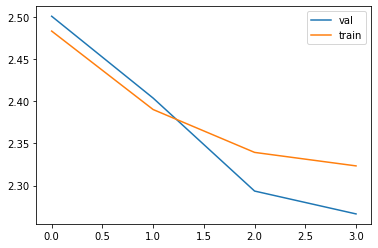

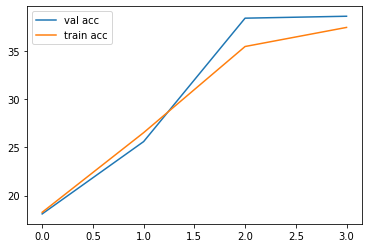


Iteration 200, loss = 2.2254
Checking accuracy on validation set
Got 403 / 1000 correct (40.30)
Checking accuracy on train set
Got 19191 / 49000 correct (39.17)


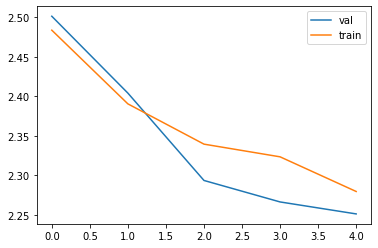

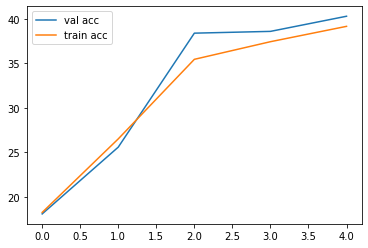


Iteration 400, loss = 2.2879
Checking accuracy on validation set
Got 450 / 1000 correct (45.00)
Checking accuracy on train set
Got 20080 / 49000 correct (40.98)


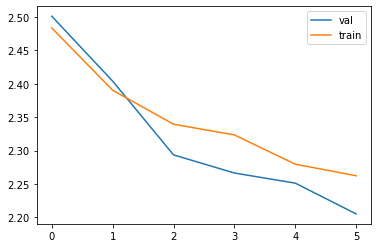

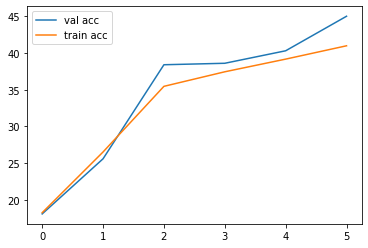


Iteration 600, loss = 2.2516
Checking accuracy on validation set
Got 436 / 1000 correct (43.60)
Checking accuracy on train set
Got 20641 / 49000 correct (42.12)


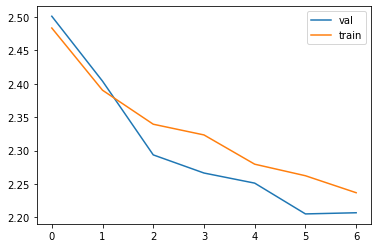

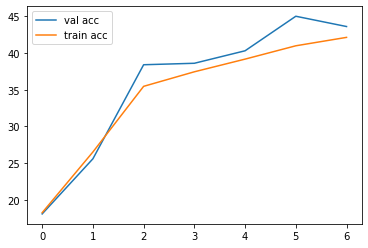


epoch  2
Iteration 0, loss = 2.2612
Checking accuracy on validation set
Got 469 / 1000 correct (46.90)
Checking accuracy on train set
Got 22022 / 49000 correct (44.94)


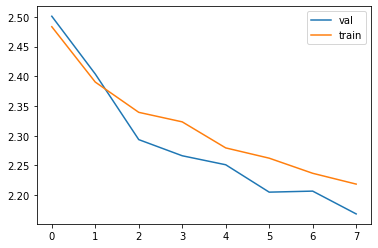

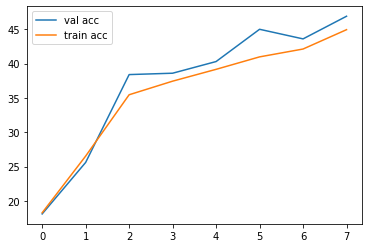


Iteration 200, loss = 2.2310
Checking accuracy on validation set
Got 460 / 1000 correct (46.00)
Checking accuracy on train set
Got 21325 / 49000 correct (43.52)


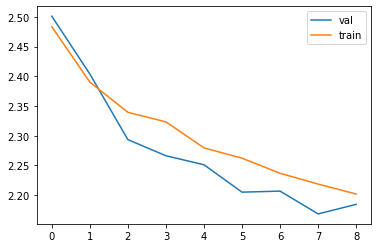

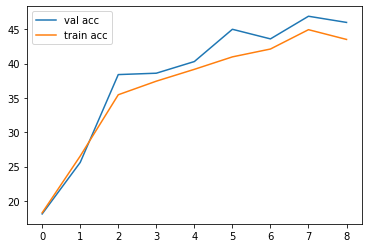


Iteration 400, loss = 2.1669
Checking accuracy on validation set
Got 474 / 1000 correct (47.40)
Checking accuracy on train set
Got 23146 / 49000 correct (47.24)


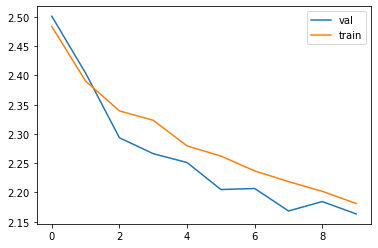

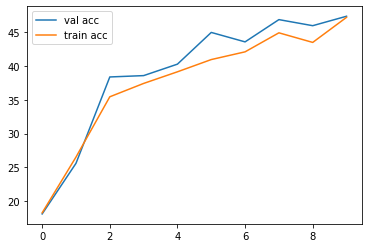


Iteration 600, loss = 2.2617
Checking accuracy on validation set
Got 478 / 1000 correct (47.80)
Checking accuracy on train set
Got 22659 / 49000 correct (46.24)


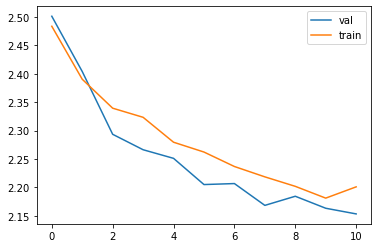

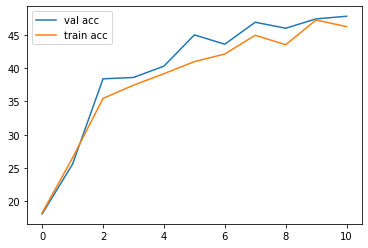


epoch  3
Iteration 0, loss = 2.3079
Checking accuracy on validation set
Got 476 / 1000 correct (47.60)
Checking accuracy on train set
Got 23199 / 49000 correct (47.34)


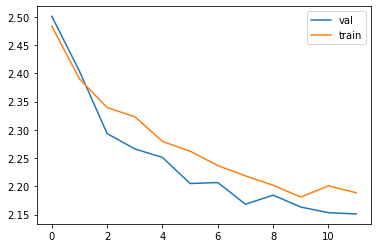

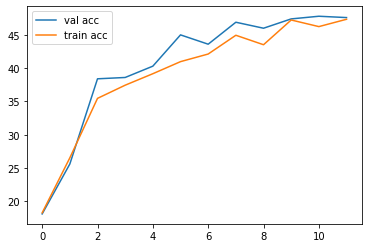


Iteration 200, loss = 2.1109
Checking accuracy on validation set
Got 478 / 1000 correct (47.80)
Checking accuracy on train set
Got 23941 / 49000 correct (48.86)


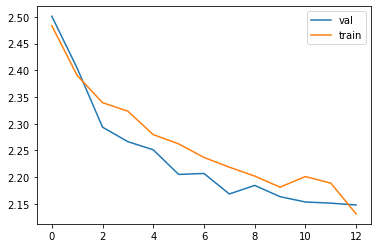

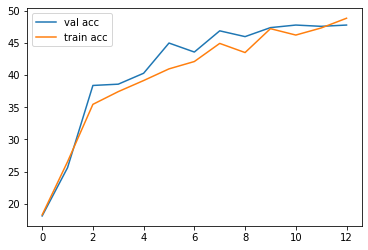


Iteration 400, loss = 2.1610
Checking accuracy on validation set
Got 509 / 1000 correct (50.90)
Checking accuracy on train set
Got 24153 / 49000 correct (49.29)


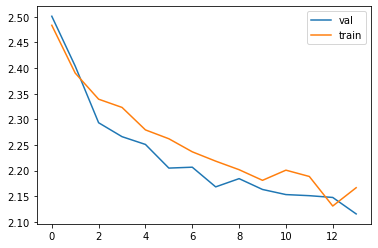

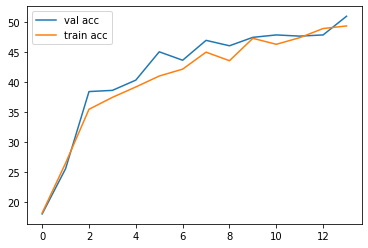


Iteration 600, loss = 2.1175
Checking accuracy on validation set
Got 505 / 1000 correct (50.50)
Checking accuracy on train set
Got 24945 / 49000 correct (50.91)


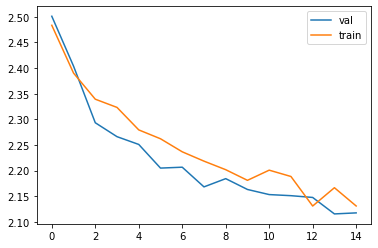

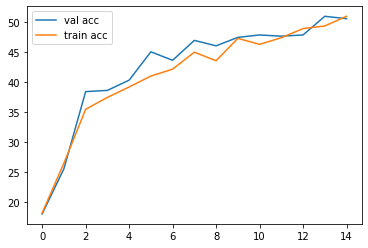


epoch  4
Iteration 0, loss = 2.1257
Checking accuracy on validation set
Got 514 / 1000 correct (51.40)
Checking accuracy on train set
Got 24475 / 49000 correct (49.95)


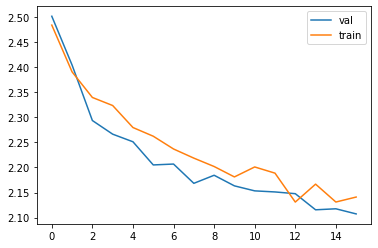

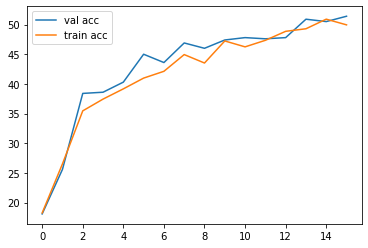


Iteration 200, loss = 2.0472
Checking accuracy on validation set
Got 511 / 1000 correct (51.10)
Checking accuracy on train set
Got 25308 / 49000 correct (51.65)


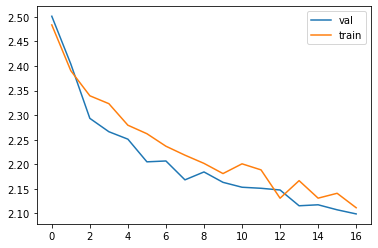

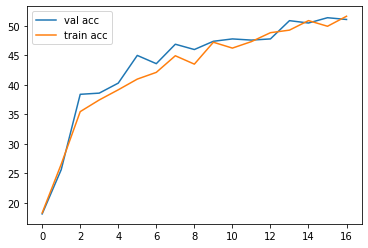


Iteration 400, loss = 2.0447
Checking accuracy on validation set
Got 532 / 1000 correct (53.20)
Checking accuracy on train set
Got 25868 / 49000 correct (52.79)


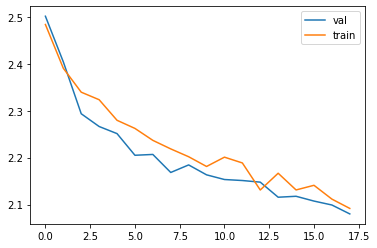

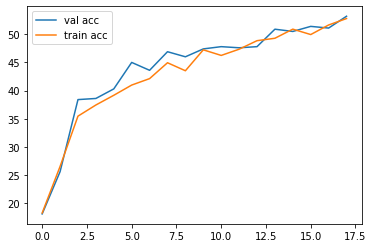


Iteration 600, loss = 2.1072
Checking accuracy on validation set
Got 517 / 1000 correct (51.70)
Checking accuracy on train set
Got 25915 / 49000 correct (52.89)


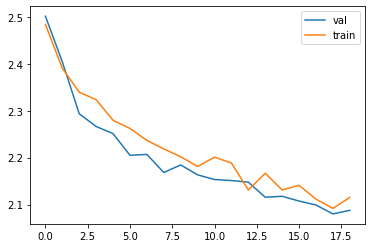

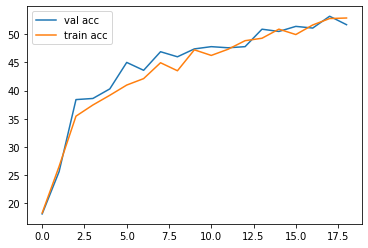


epoch  5
Iteration 0, loss = 2.0866
Checking accuracy on validation set
Got 547 / 1000 correct (54.70)
Checking accuracy on train set
Got 26766 / 49000 correct (54.62)


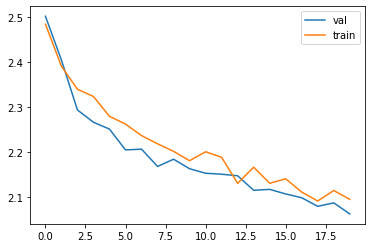

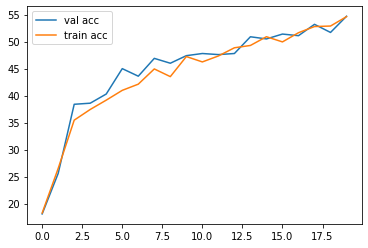


Iteration 200, loss = 2.0258
Checking accuracy on validation set
Got 564 / 1000 correct (56.40)
Checking accuracy on train set
Got 26687 / 49000 correct (54.46)


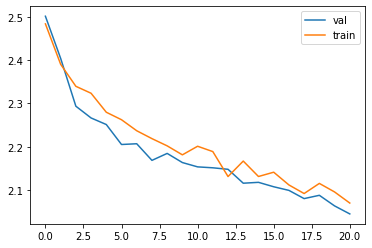

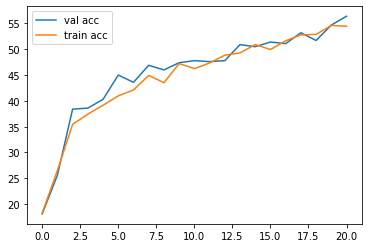


Iteration 400, loss = 1.9982
Checking accuracy on validation set
Got 554 / 1000 correct (55.40)
Checking accuracy on train set
Got 27282 / 49000 correct (55.68)


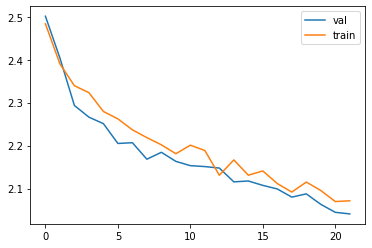

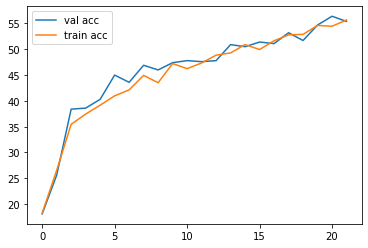


Iteration 600, loss = 2.0613
Checking accuracy on validation set
Got 547 / 1000 correct (54.70)
Checking accuracy on train set
Got 26333 / 49000 correct (53.74)


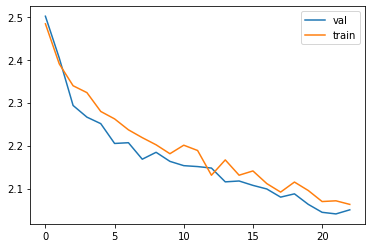

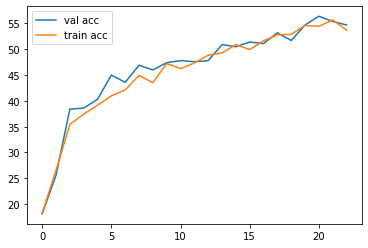


epoch  6
Iteration 0, loss = 2.0080
Checking accuracy on validation set
Got 562 / 1000 correct (56.20)
Checking accuracy on train set
Got 27880 / 49000 correct (56.90)


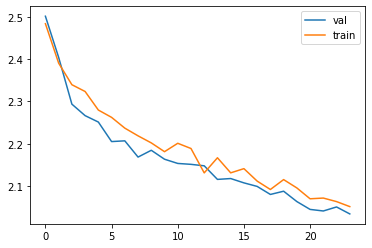

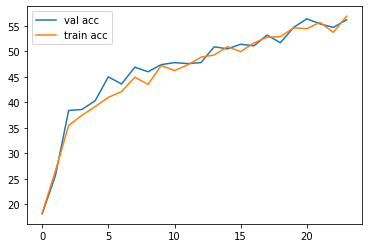


Iteration 200, loss = 2.0756
Checking accuracy on validation set
Got 550 / 1000 correct (55.00)
Checking accuracy on train set
Got 27739 / 49000 correct (56.61)


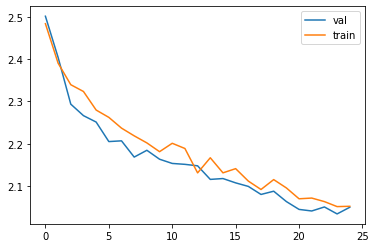

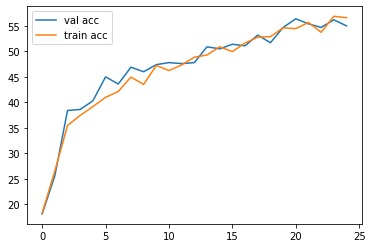


Iteration 400, loss = 2.0360
Checking accuracy on validation set
Got 561 / 1000 correct (56.10)
Checking accuracy on train set
Got 27700 / 49000 correct (56.53)


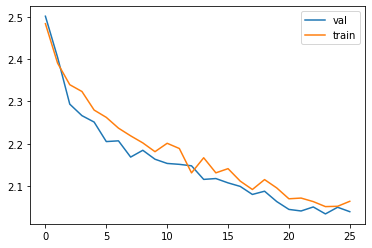

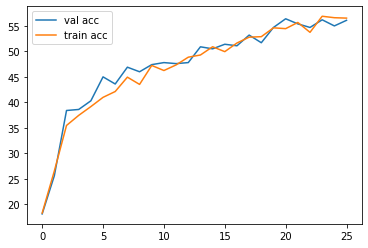


Iteration 600, loss = 2.1248
Checking accuracy on validation set
Got 562 / 1000 correct (56.20)
Checking accuracy on train set
Got 28033 / 49000 correct (57.21)


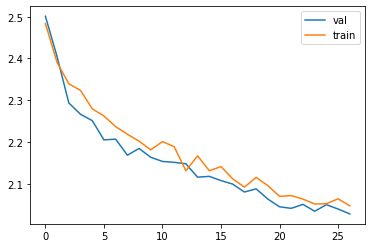

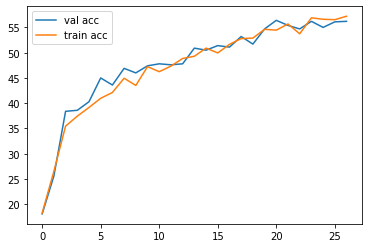


epoch  7
Iteration 0, loss = 2.1176
Checking accuracy on validation set
Got 561 / 1000 correct (56.10)
Checking accuracy on train set
Got 28699 / 49000 correct (58.57)


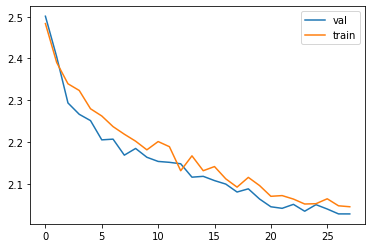

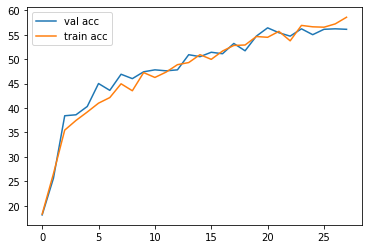


Iteration 200, loss = 2.1099
Checking accuracy on validation set
Got 582 / 1000 correct (58.20)
Checking accuracy on train set
Got 28918 / 49000 correct (59.02)


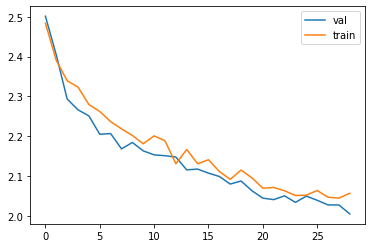

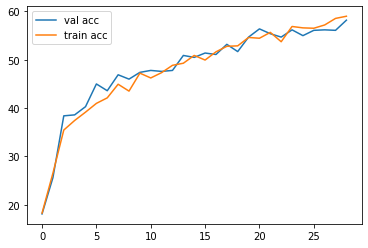


Iteration 400, loss = 1.9860
Checking accuracy on validation set
Got 552 / 1000 correct (55.20)
Checking accuracy on train set
Got 27677 / 49000 correct (56.48)


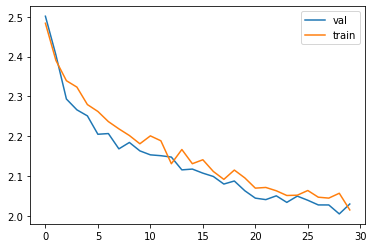

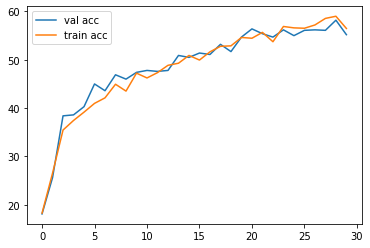


Iteration 600, loss = 2.0140
Checking accuracy on validation set
Got 566 / 1000 correct (56.60)
Checking accuracy on train set
Got 28501 / 49000 correct (58.17)


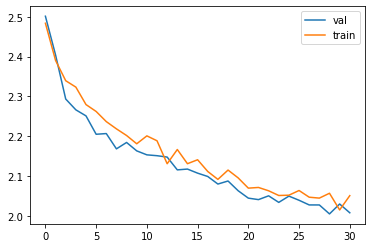

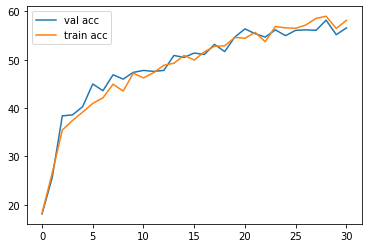


epoch  8
Iteration 0, loss = 2.0581
Checking accuracy on validation set
Got 588 / 1000 correct (58.80)
Checking accuracy on train set
Got 29022 / 49000 correct (59.23)


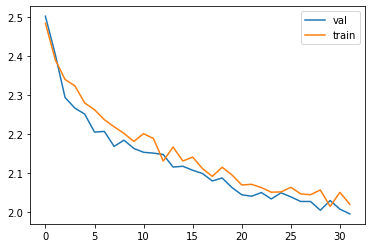

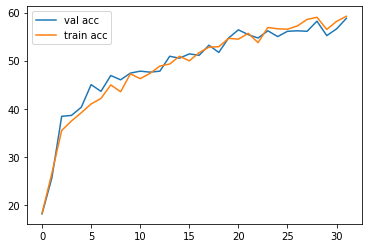


Iteration 200, loss = 1.9337
Checking accuracy on validation set
Got 617 / 1000 correct (61.70)
Checking accuracy on train set
Got 30022 / 49000 correct (61.27)


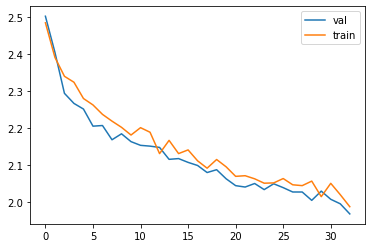

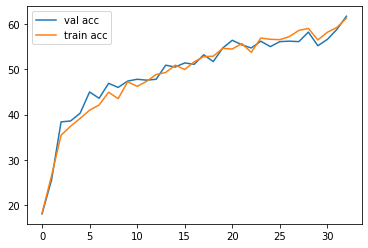


Iteration 400, loss = 1.9453
Checking accuracy on validation set
Got 593 / 1000 correct (59.30)
Checking accuracy on train set
Got 29398 / 49000 correct (60.00)


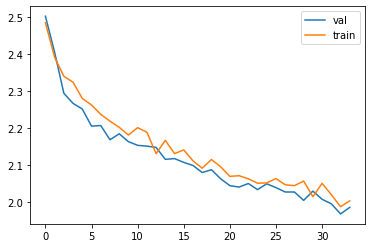

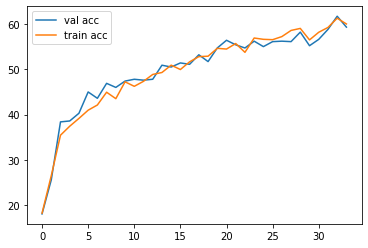


Iteration 600, loss = 2.0222
Checking accuracy on validation set
Got 609 / 1000 correct (60.90)
Checking accuracy on train set
Got 30075 / 49000 correct (61.38)


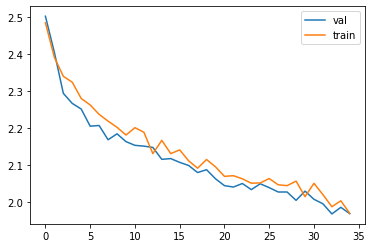

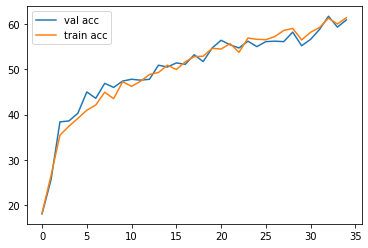


epoch  9
Iteration 0, loss = 2.0147
Checking accuracy on validation set
Got 593 / 1000 correct (59.30)
Checking accuracy on train set
Got 29841 / 49000 correct (60.90)


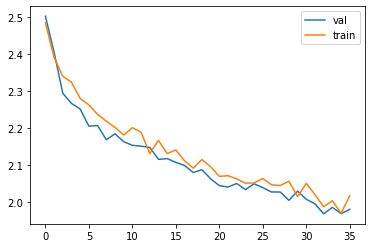

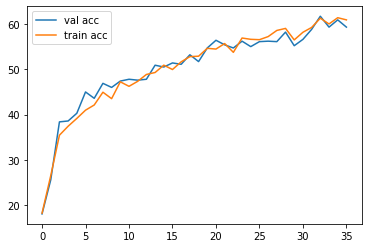


Iteration 200, loss = 2.0757
Checking accuracy on validation set
Got 608 / 1000 correct (60.80)
Checking accuracy on train set
Got 30145 / 49000 correct (61.52)


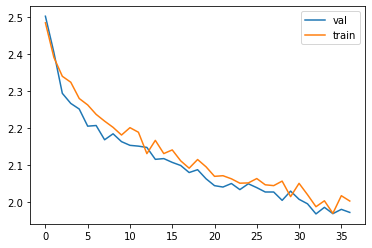

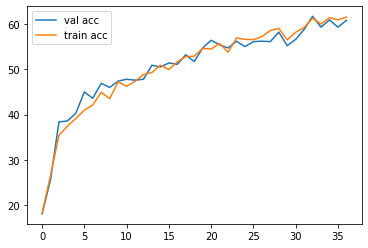


Iteration 400, loss = 2.0026
Checking accuracy on validation set
Got 601 / 1000 correct (60.10)
Checking accuracy on train set
Got 30210 / 49000 correct (61.65)


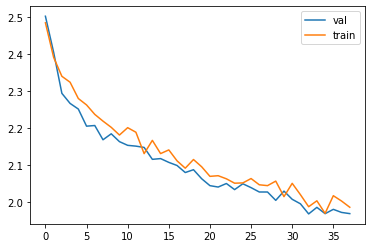

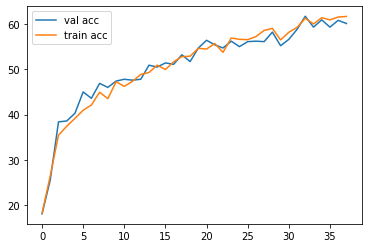


Iteration 600, loss = 1.9482
Checking accuracy on validation set
Got 624 / 1000 correct (62.40)
Checking accuracy on train set
Got 30484 / 49000 correct (62.21)


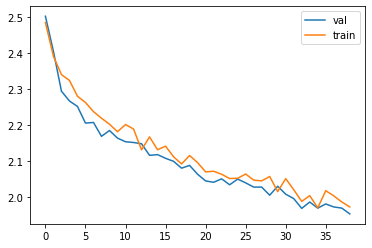

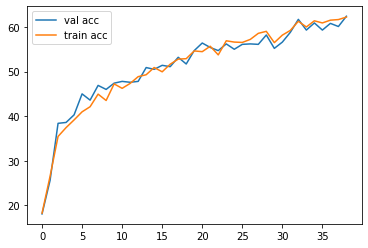


epoch  10
Iteration 0, loss = 2.0583
Checking accuracy on validation set
Got 627 / 1000 correct (62.70)
Checking accuracy on train set
Got 30678 / 49000 correct (62.61)


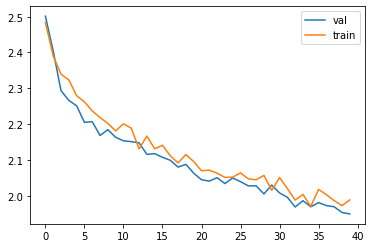

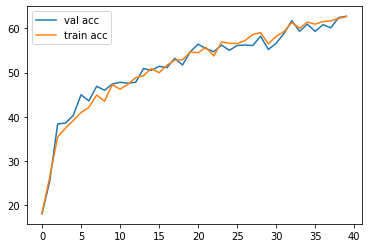


Iteration 200, loss = 1.8631
Checking accuracy on validation set
Got 645 / 1000 correct (64.50)
Checking accuracy on train set
Got 30874 / 49000 correct (63.01)


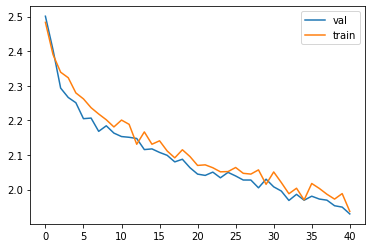

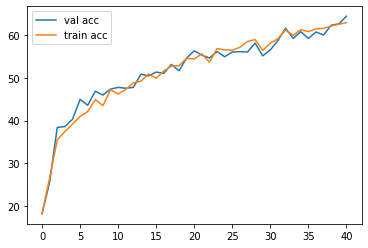


Iteration 400, loss = 1.8845
Checking accuracy on validation set
Got 622 / 1000 correct (62.20)
Checking accuracy on train set
Got 30869 / 49000 correct (63.00)


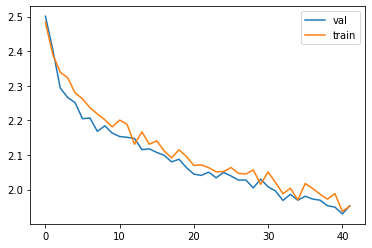

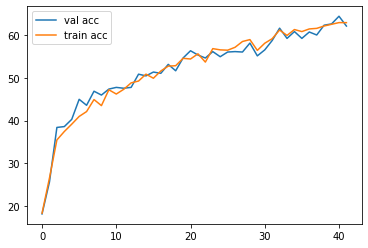


Iteration 600, loss = 1.9515
Checking accuracy on validation set
Got 635 / 1000 correct (63.50)
Checking accuracy on train set
Got 31253 / 49000 correct (63.78)


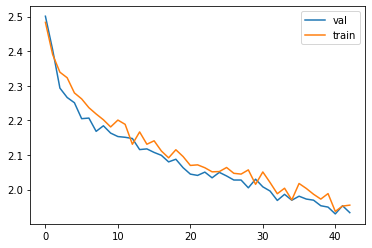

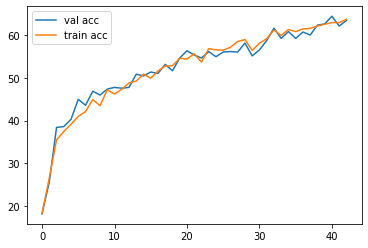


epoch  11
Iteration 0, loss = 1.9397
Checking accuracy on validation set
Got 604 / 1000 correct (60.40)
Checking accuracy on train set
Got 29815 / 49000 correct (60.85)


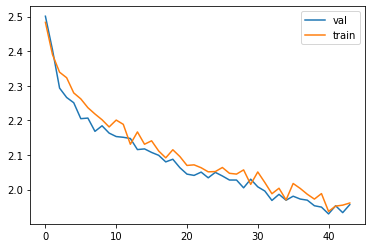

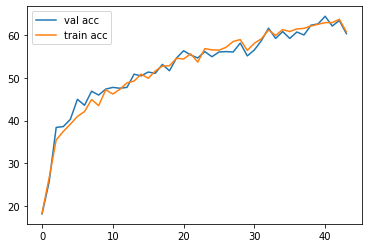


Iteration 200, loss = 2.0220
Checking accuracy on validation set
Got 652 / 1000 correct (65.20)
Checking accuracy on train set
Got 31902 / 49000 correct (65.11)


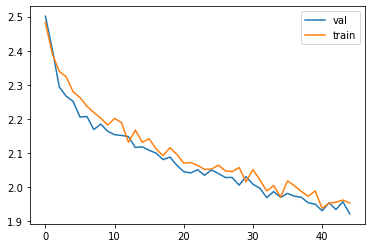

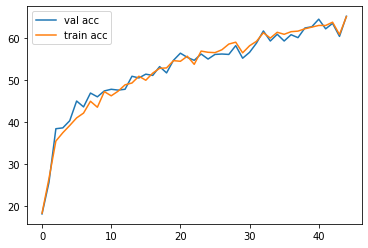


Iteration 400, loss = 1.9814
Checking accuracy on validation set
Got 631 / 1000 correct (63.10)
Checking accuracy on train set
Got 31322 / 49000 correct (63.92)


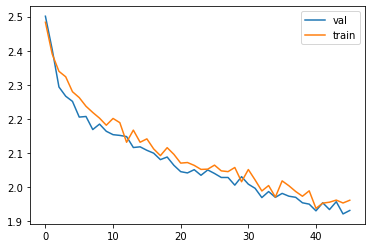

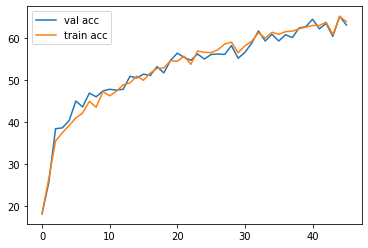


Iteration 600, loss = 2.0694
Checking accuracy on validation set
Got 641 / 1000 correct (64.10)
Checking accuracy on train set
Got 31325 / 49000 correct (63.93)


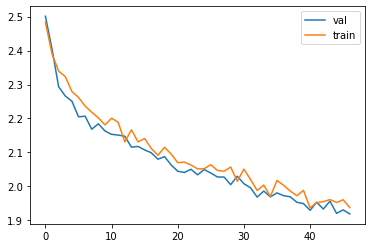

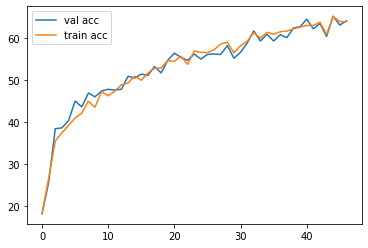


epoch  12
Iteration 0, loss = 1.8822
Checking accuracy on validation set
Got 637 / 1000 correct (63.70)
Checking accuracy on train set
Got 31604 / 49000 correct (64.50)


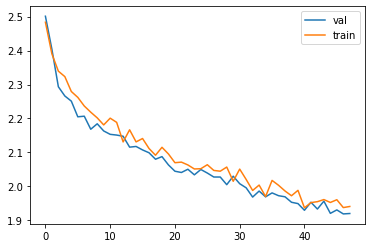

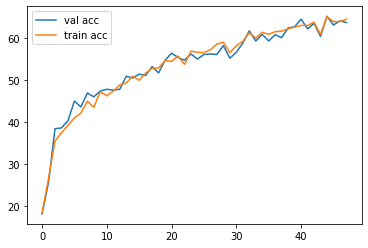


Iteration 200, loss = 1.9335
Checking accuracy on validation set
Got 641 / 1000 correct (64.10)
Checking accuracy on train set
Got 31571 / 49000 correct (64.43)


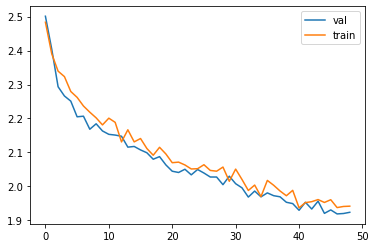

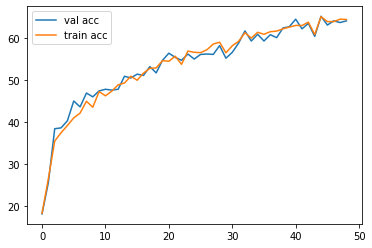


Iteration 400, loss = 2.0634
Checking accuracy on validation set
Got 625 / 1000 correct (62.50)
Checking accuracy on train set
Got 31081 / 49000 correct (63.43)


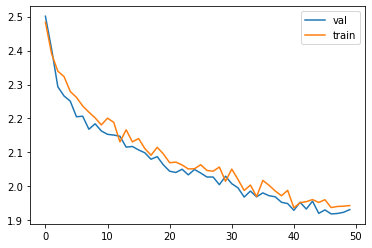

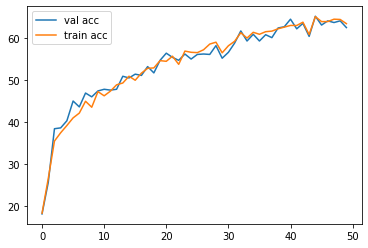


Iteration 600, loss = 1.9161
Checking accuracy on validation set
Got 674 / 1000 correct (67.40)
Checking accuracy on train set
Got 32410 / 49000 correct (66.14)


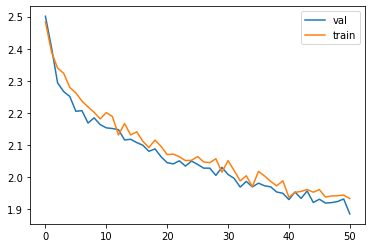

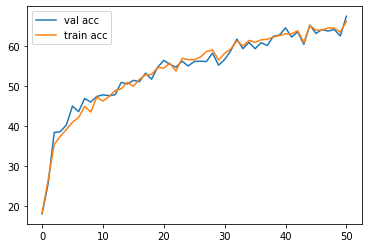


epoch  13
Iteration 0, loss = 1.9990
Checking accuracy on validation set
Got 628 / 1000 correct (62.80)
Checking accuracy on train set
Got 31555 / 49000 correct (64.40)


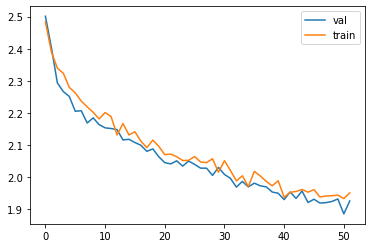

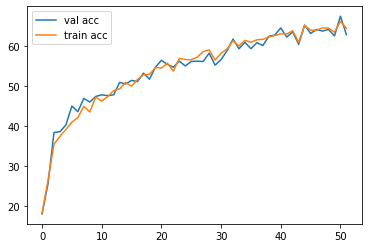


Iteration 200, loss = 1.9030
Checking accuracy on validation set
Got 650 / 1000 correct (65.00)
Checking accuracy on train set
Got 32252 / 49000 correct (65.82)


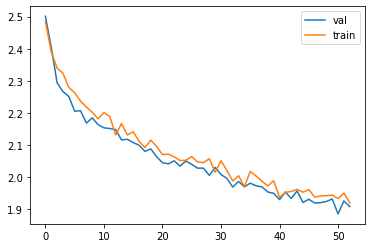

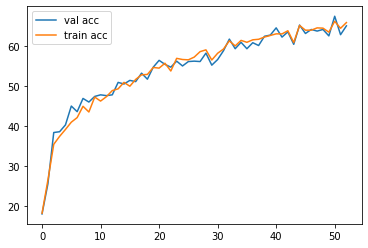


Iteration 400, loss = 1.9264
Checking accuracy on validation set
Got 659 / 1000 correct (65.90)
Checking accuracy on train set
Got 32551 / 49000 correct (66.43)


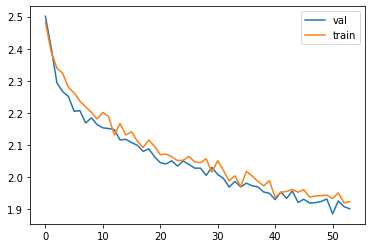

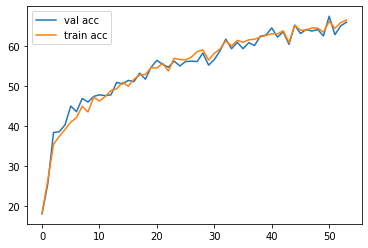


Iteration 600, loss = 1.9079
Checking accuracy on validation set
Got 663 / 1000 correct (66.30)
Checking accuracy on train set
Got 33000 / 49000 correct (67.35)


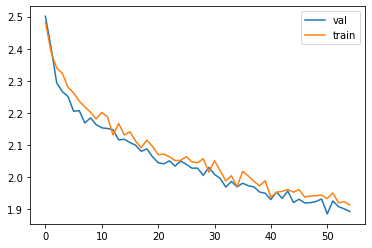

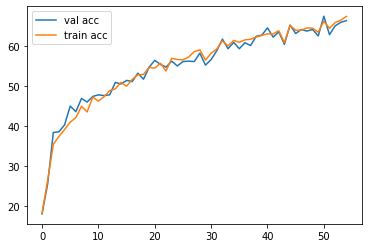


epoch  14
Iteration 0, loss = 1.8888
Checking accuracy on validation set
Got 667 / 1000 correct (66.70)
Checking accuracy on train set
Got 32787 / 49000 correct (66.91)


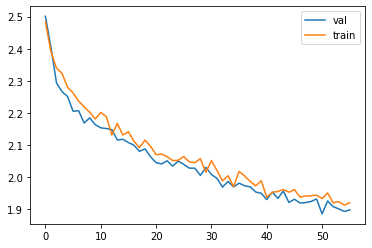

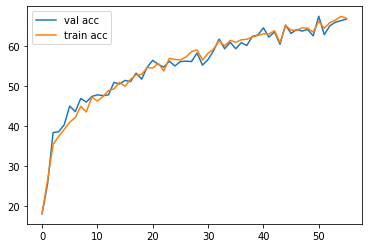


Iteration 200, loss = 1.9020
Checking accuracy on validation set
Got 680 / 1000 correct (68.00)
Checking accuracy on train set
Got 33052 / 49000 correct (67.45)


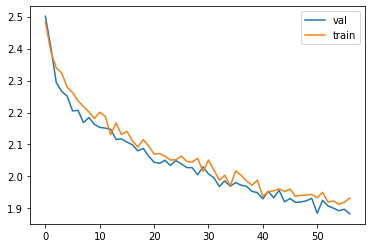

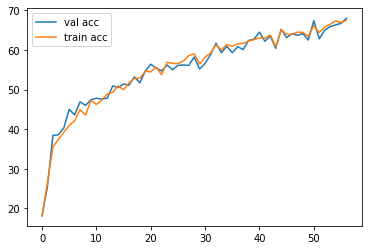


Iteration 400, loss = 1.9322
Checking accuracy on validation set
Got 664 / 1000 correct (66.40)
Checking accuracy on train set
Got 33119 / 49000 correct (67.59)


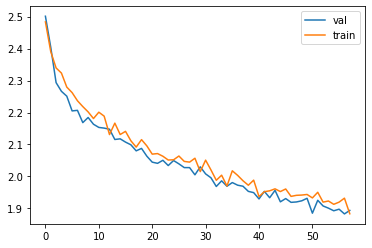

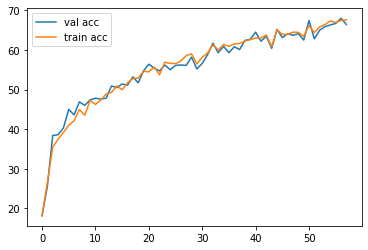


Iteration 600, loss = 1.8636
Checking accuracy on validation set
Got 684 / 1000 correct (68.40)
Checking accuracy on train set
Got 33543 / 49000 correct (68.46)


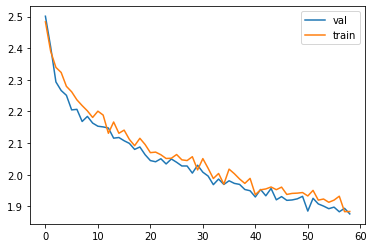

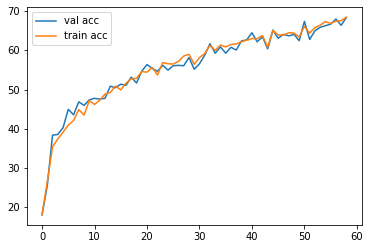


epoch  15
Iteration 0, loss = 1.8193
Checking accuracy on validation set
Got 681 / 1000 correct (68.10)
Checking accuracy on train set
Got 33884 / 49000 correct (69.15)


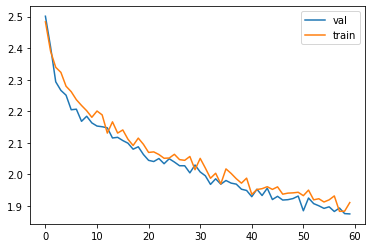

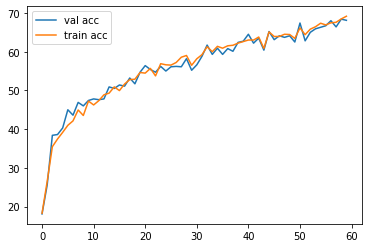


Iteration 200, loss = 1.8020
Checking accuracy on validation set
Got 671 / 1000 correct (67.10)
Checking accuracy on train set
Got 33570 / 49000 correct (68.51)


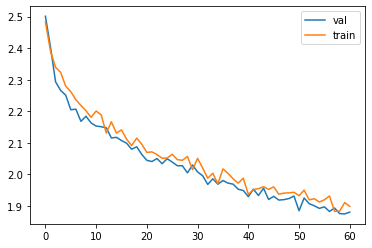

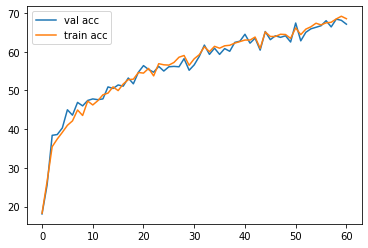


Iteration 400, loss = 1.8561
Checking accuracy on validation set
Got 675 / 1000 correct (67.50)
Checking accuracy on train set
Got 32880 / 49000 correct (67.10)


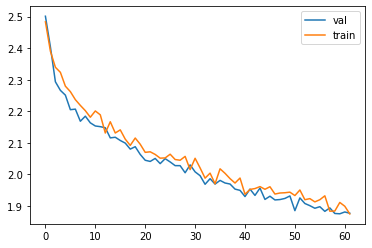

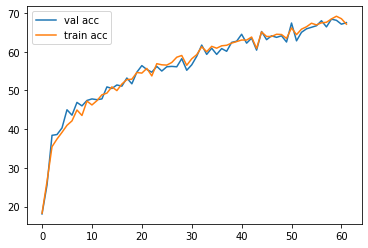


Iteration 600, loss = 1.8055
Checking accuracy on validation set
Got 680 / 1000 correct (68.00)
Checking accuracy on train set
Got 34170 / 49000 correct (69.73)


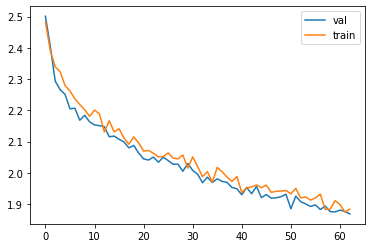

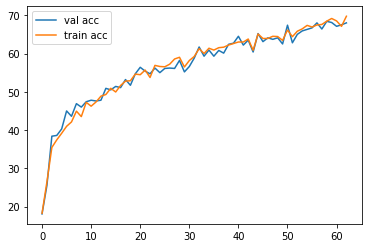


epoch  16
Iteration 0, loss = 1.8413
Checking accuracy on validation set
Got 672 / 1000 correct (67.20)
Checking accuracy on train set
Got 34040 / 49000 correct (69.47)


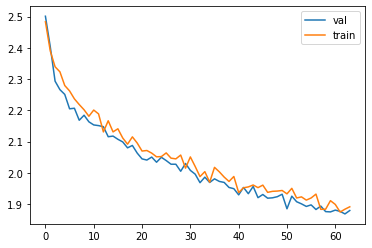

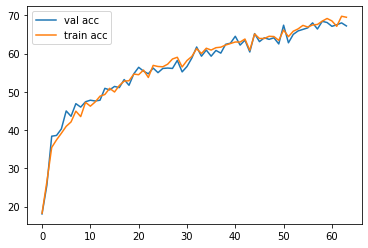


Iteration 200, loss = 1.8602
Checking accuracy on validation set
Got 675 / 1000 correct (67.50)
Checking accuracy on train set
Got 33775 / 49000 correct (68.93)


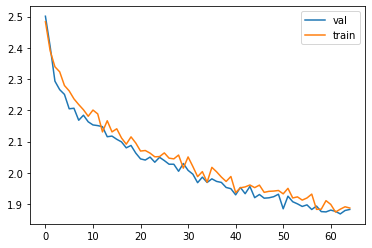

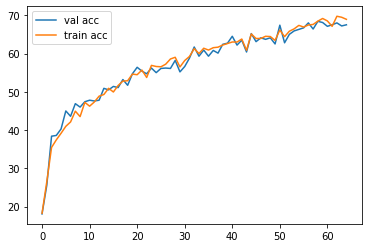


Iteration 400, loss = 1.9100
Checking accuracy on validation set
Got 700 / 1000 correct (70.00)
Checking accuracy on train set
Got 33859 / 49000 correct (69.10)


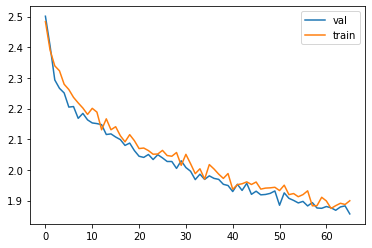

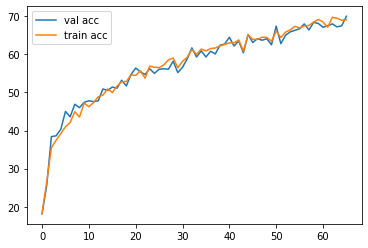


Iteration 600, loss = 1.9343
Checking accuracy on validation set
Got 684 / 1000 correct (68.40)
Checking accuracy on train set
Got 34245 / 49000 correct (69.89)


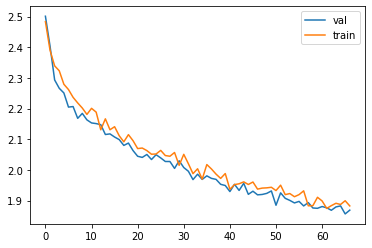

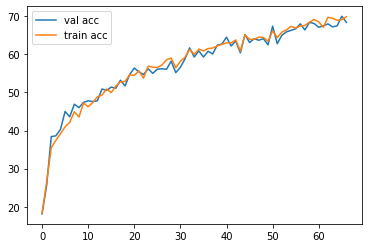


epoch  17
Iteration 0, loss = 1.8681
Checking accuracy on validation set
Got 675 / 1000 correct (67.50)
Checking accuracy on train set
Got 33863 / 49000 correct (69.11)


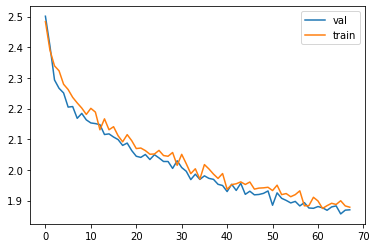

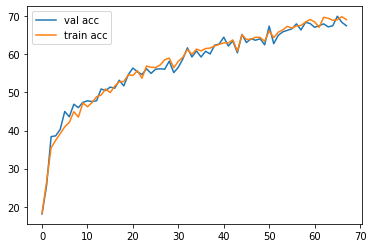


Iteration 200, loss = 1.9214
Checking accuracy on validation set
Got 663 / 1000 correct (66.30)
Checking accuracy on train set
Got 33421 / 49000 correct (68.21)


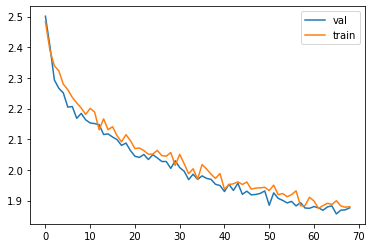

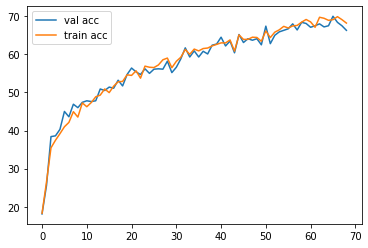


Iteration 400, loss = 1.8264
Checking accuracy on validation set
Got 695 / 1000 correct (69.50)
Checking accuracy on train set
Got 34419 / 49000 correct (70.24)


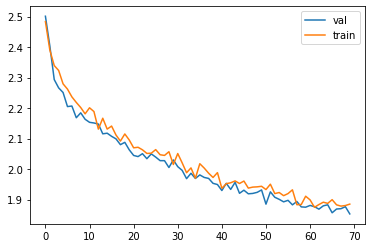

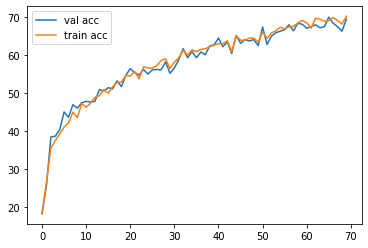


Iteration 600, loss = 1.7935
Checking accuracy on validation set
Got 695 / 1000 correct (69.50)
Checking accuracy on train set
Got 34204 / 49000 correct (69.80)


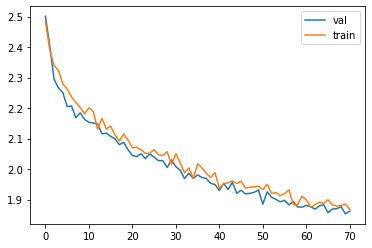

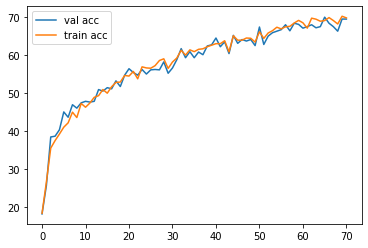


epoch  18
Iteration 0, loss = 1.9389
Checking accuracy on validation set
Got 690 / 1000 correct (69.00)
Checking accuracy on train set
Got 33963 / 49000 correct (69.31)


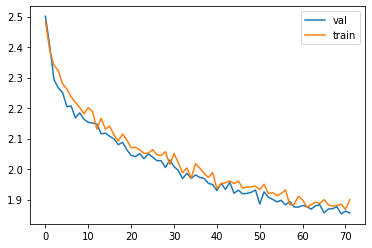

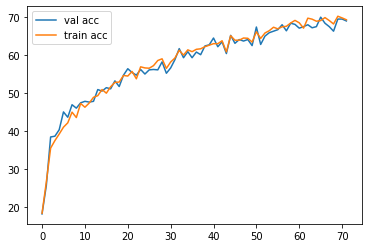


Iteration 200, loss = 1.8961
Checking accuracy on validation set
Got 698 / 1000 correct (69.80)
Checking accuracy on train set
Got 34864 / 49000 correct (71.15)


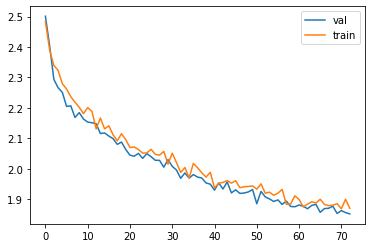

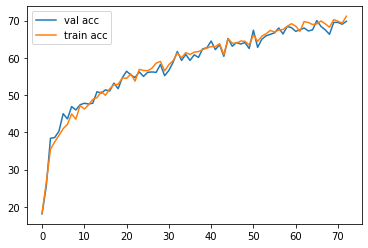


Iteration 400, loss = 1.8531
Checking accuracy on validation set
Got 689 / 1000 correct (68.90)
Checking accuracy on train set
Got 34381 / 49000 correct (70.17)


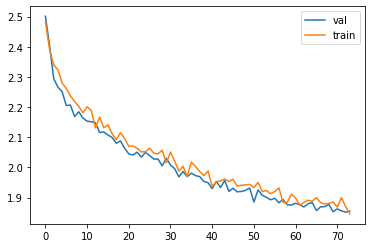

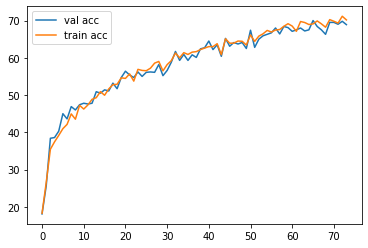


Iteration 600, loss = 1.9354
Checking accuracy on validation set
Got 703 / 1000 correct (70.30)
Checking accuracy on train set
Got 34771 / 49000 correct (70.96)


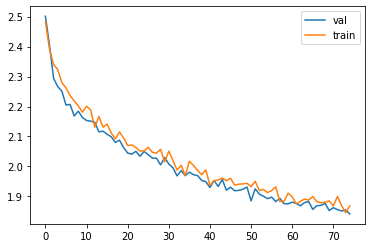

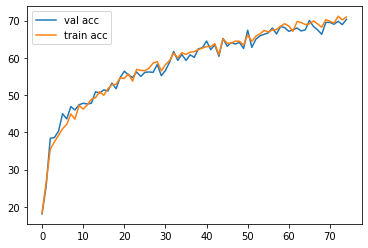


epoch  19
Iteration 0, loss = 1.8298
Checking accuracy on validation set
Got 698 / 1000 correct (69.80)
Checking accuracy on train set
Got 34429 / 49000 correct (70.26)


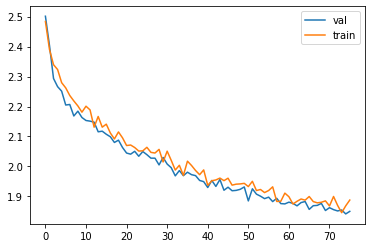

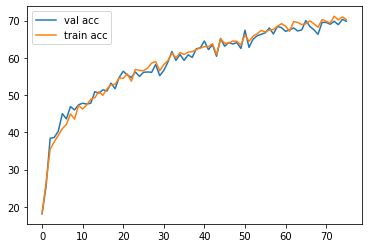


Iteration 200, loss = 1.8729
Checking accuracy on validation set
Got 688 / 1000 correct (68.80)
Checking accuracy on train set
Got 34730 / 49000 correct (70.88)


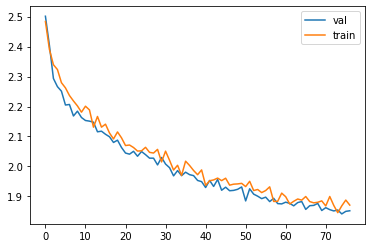

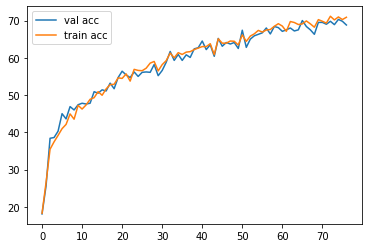


Iteration 400, loss = 1.8298
Checking accuracy on validation set
Got 677 / 1000 correct (67.70)
Checking accuracy on train set
Got 33982 / 49000 correct (69.35)


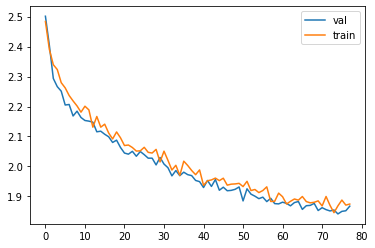

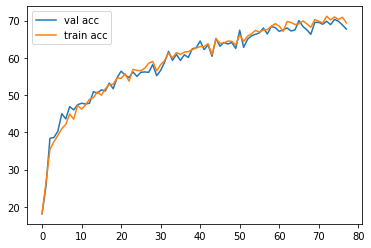


Iteration 600, loss = 1.8126
Checking accuracy on validation set
Got 692 / 1000 correct (69.20)
Checking accuracy on train set
Got 34531 / 49000 correct (70.47)


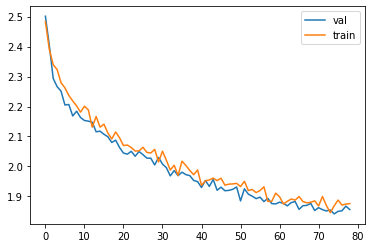

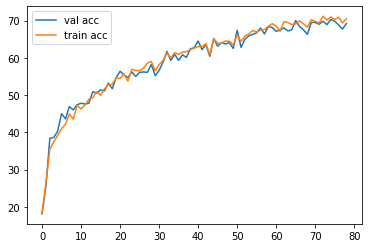


epoch  20
Iteration 0, loss = 1.8565
Checking accuracy on validation set
Got 712 / 1000 correct (71.20)
Checking accuracy on train set
Got 34680 / 49000 correct (70.78)


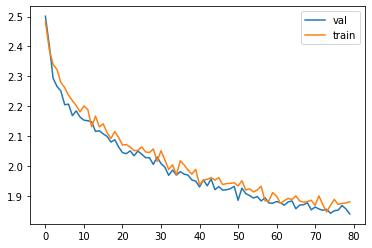

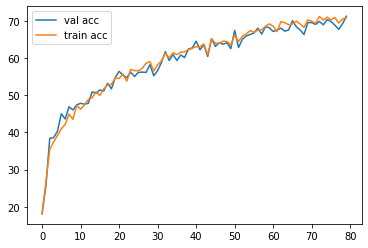


Iteration 200, loss = 1.8660
Checking accuracy on validation set
Got 704 / 1000 correct (70.40)
Checking accuracy on train set
Got 34636 / 49000 correct (70.69)


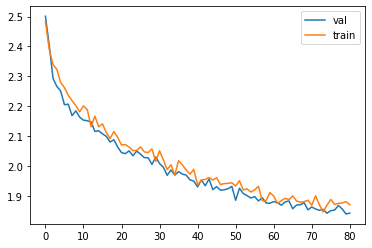

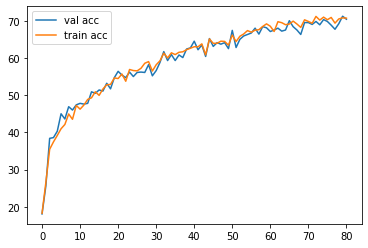


Iteration 400, loss = 1.9401
Checking accuracy on validation set
Got 704 / 1000 correct (70.40)
Checking accuracy on train set
Got 35012 / 49000 correct (71.45)


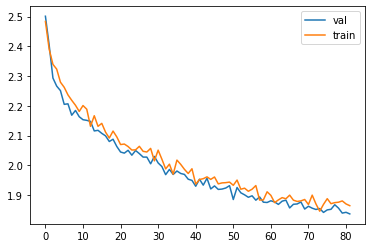

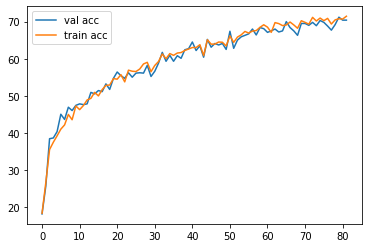


Iteration 600, loss = 1.8879
Checking accuracy on validation set
Got 714 / 1000 correct (71.40)
Checking accuracy on train set
Got 35102 / 49000 correct (71.64)


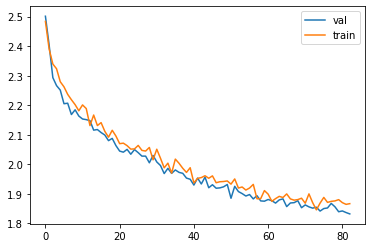

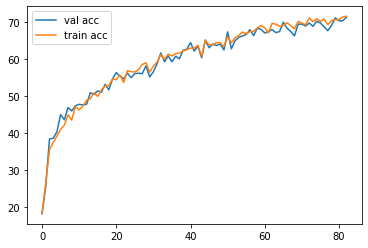


epoch  21
Iteration 0, loss = 1.8234
Checking accuracy on validation set
Got 696 / 1000 correct (69.60)
Checking accuracy on train set
Got 35068 / 49000 correct (71.57)


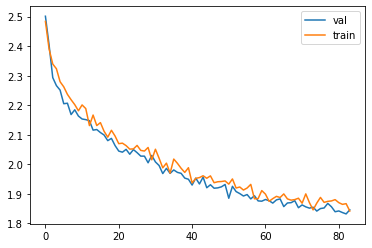

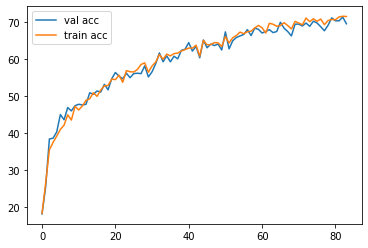


Iteration 200, loss = 1.9373
Checking accuracy on validation set
Got 705 / 1000 correct (70.50)
Checking accuracy on train set
Got 35461 / 49000 correct (72.37)


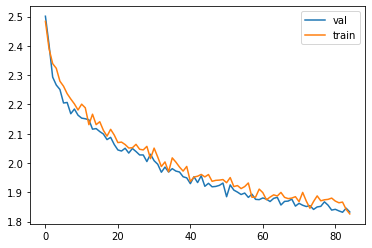

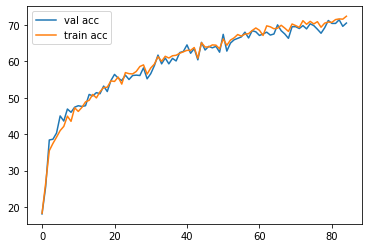


Iteration 400, loss = 1.8374
Checking accuracy on validation set
Got 689 / 1000 correct (68.90)
Checking accuracy on train set
Got 34099 / 49000 correct (69.59)


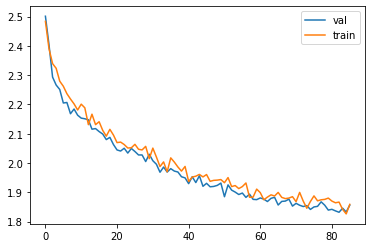

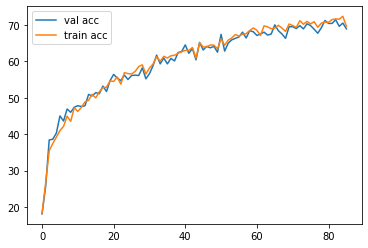


Iteration 600, loss = 1.8650
Checking accuracy on validation set
Got 688 / 1000 correct (68.80)
Checking accuracy on train set
Got 34637 / 49000 correct (70.69)


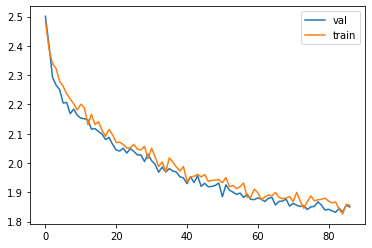

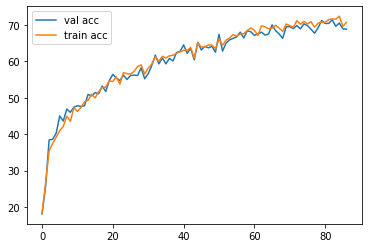


epoch  22
Iteration 0, loss = 1.8857
Checking accuracy on validation set
Got 717 / 1000 correct (71.70)
Checking accuracy on train set
Got 35577 / 49000 correct (72.61)


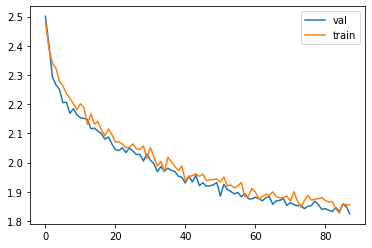

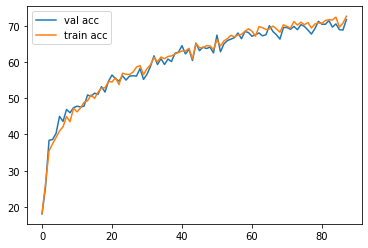


Iteration 200, loss = 1.7839
Checking accuracy on validation set
Got 689 / 1000 correct (68.90)
Checking accuracy on train set
Got 34934 / 49000 correct (71.29)


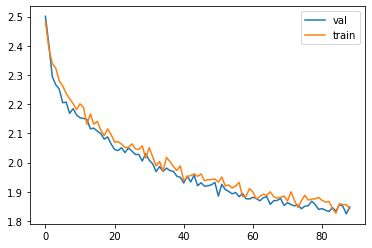

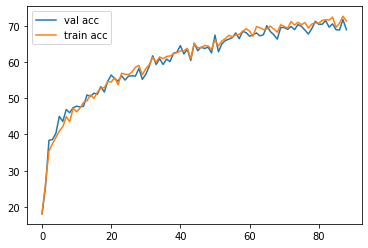


Iteration 400, loss = 1.8568
Checking accuracy on validation set
Got 697 / 1000 correct (69.70)
Checking accuracy on train set
Got 35227 / 49000 correct (71.89)


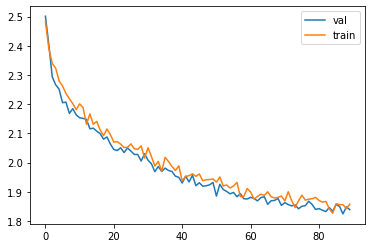

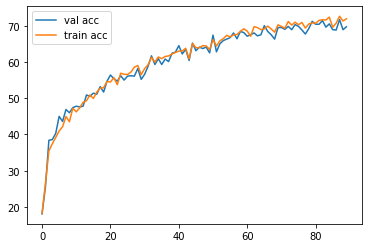


Iteration 600, loss = 1.9063
Checking accuracy on validation set
Got 705 / 1000 correct (70.50)
Checking accuracy on train set
Got 35323 / 49000 correct (72.09)


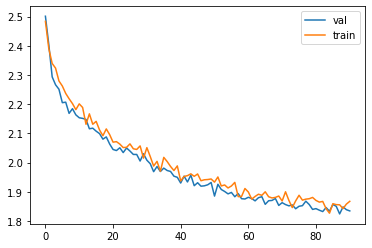

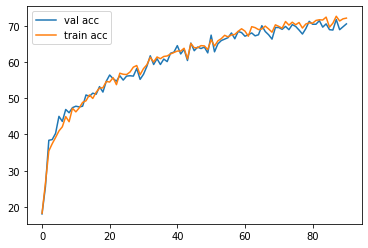


epoch  23
Iteration 0, loss = 1.8926
Checking accuracy on validation set
Got 707 / 1000 correct (70.70)
Checking accuracy on train set
Got 35315 / 49000 correct (72.07)


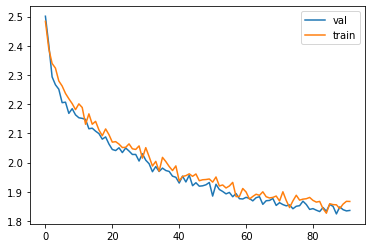

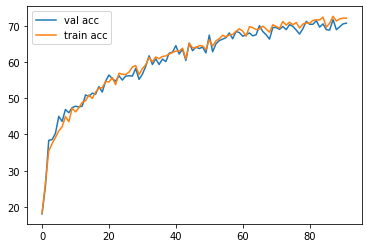


Iteration 200, loss = 1.9396
Checking accuracy on validation set
Got 711 / 1000 correct (71.10)
Checking accuracy on train set
Got 35256 / 49000 correct (71.95)


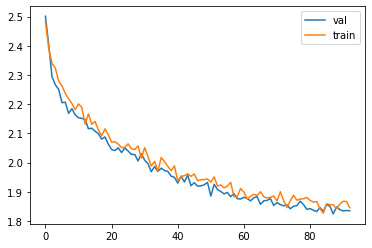

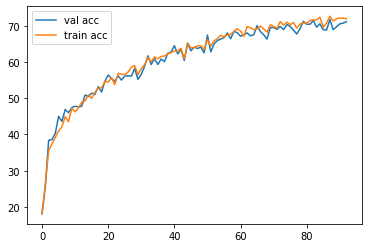


Iteration 400, loss = 1.8203
Checking accuracy on validation set
Got 697 / 1000 correct (69.70)
Checking accuracy on train set
Got 34721 / 49000 correct (70.86)


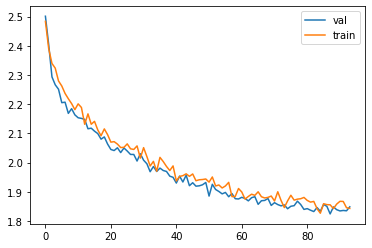

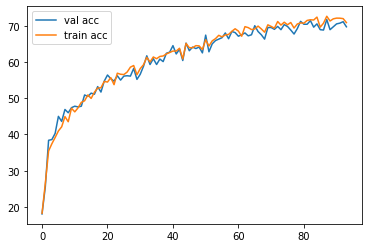


Iteration 600, loss = 1.8750
Checking accuracy on validation set
Got 717 / 1000 correct (71.70)
Checking accuracy on train set
Got 35648 / 49000 correct (72.75)


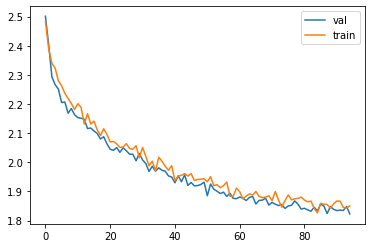

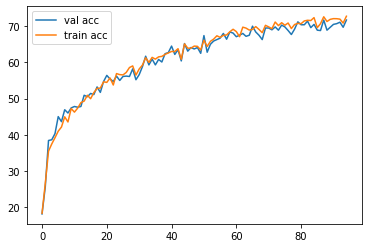


epoch  24
Iteration 0, loss = 1.8661
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)
Checking accuracy on train set
Got 34940 / 49000 correct (71.31)


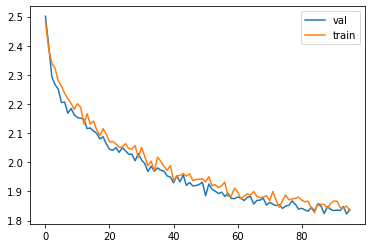

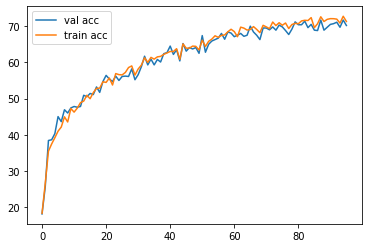


Iteration 200, loss = 1.8937
Checking accuracy on validation set
Got 669 / 1000 correct (66.90)
Checking accuracy on train set
Got 34244 / 49000 correct (69.89)


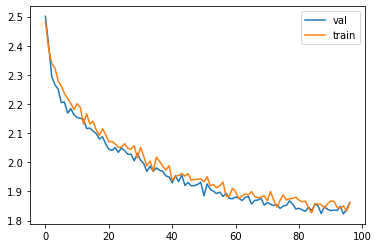

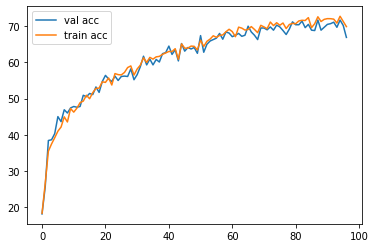


Iteration 400, loss = 1.7978
Checking accuracy on validation set
Got 711 / 1000 correct (71.10)
Checking accuracy on train set
Got 35529 / 49000 correct (72.51)


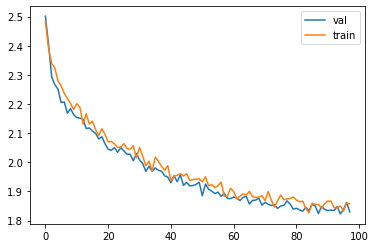

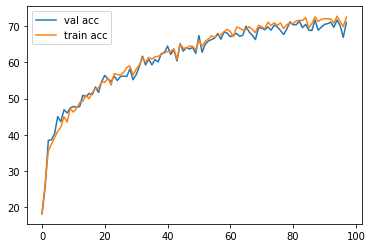


Iteration 600, loss = 1.6827
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)
Checking accuracy on train set
Got 35458 / 49000 correct (72.36)


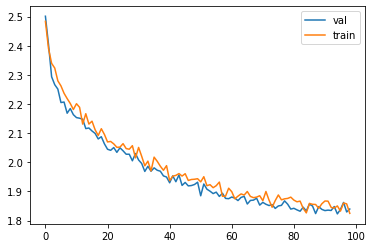

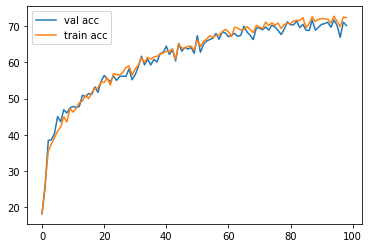


epoch  25
Iteration 0, loss = 1.7250
Checking accuracy on validation set
Got 711 / 1000 correct (71.10)
Checking accuracy on train set
Got 35503 / 49000 correct (72.46)


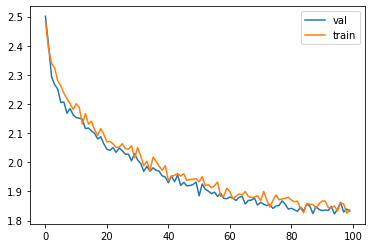

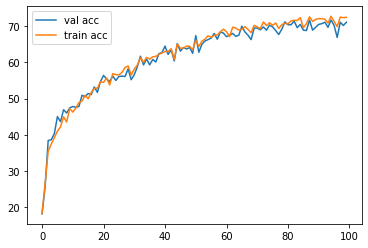


Iteration 200, loss = 1.8024
Checking accuracy on validation set
Got 718 / 1000 correct (71.80)
Checking accuracy on train set
Got 36450 / 49000 correct (74.39)


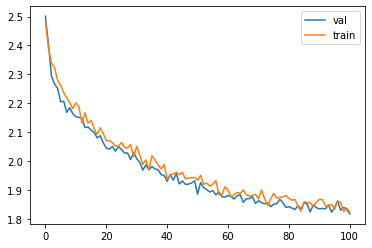

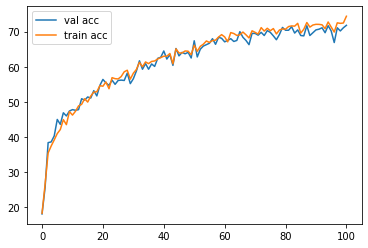


Iteration 400, loss = 1.8455
Checking accuracy on validation set
Got 710 / 1000 correct (71.00)
Checking accuracy on train set
Got 36039 / 49000 correct (73.55)


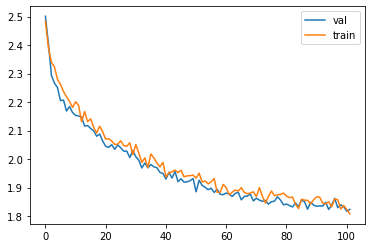

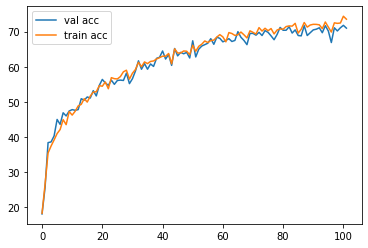


Iteration 600, loss = 1.8464
Checking accuracy on validation set
Got 722 / 1000 correct (72.20)
Checking accuracy on train set
Got 35999 / 49000 correct (73.47)


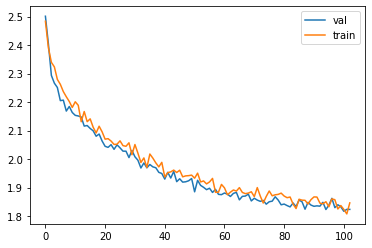

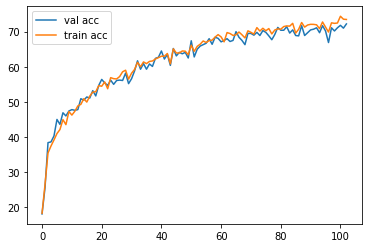


epoch  26
Iteration 0, loss = 1.8174
Checking accuracy on validation set
Got 709 / 1000 correct (70.90)
Checking accuracy on train set
Got 35420 / 49000 correct (72.29)


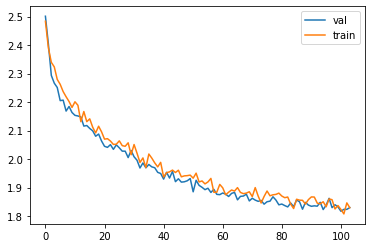

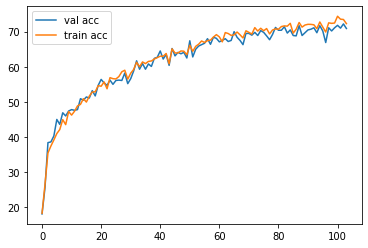


Iteration 200, loss = 1.8562
Checking accuracy on validation set
Got 711 / 1000 correct (71.10)
Checking accuracy on train set
Got 35879 / 49000 correct (73.22)


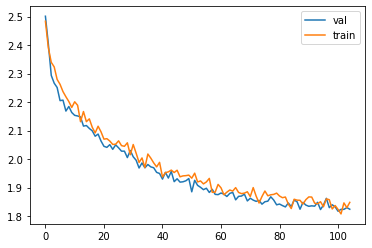

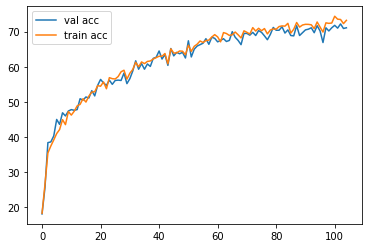


Iteration 400, loss = 1.8561
Checking accuracy on validation set
Got 721 / 1000 correct (72.10)
Checking accuracy on train set
Got 36049 / 49000 correct (73.57)


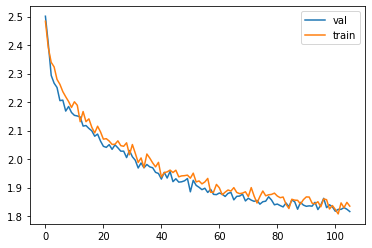

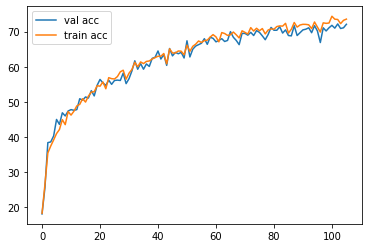


Iteration 600, loss = 1.8516
Checking accuracy on validation set
Got 703 / 1000 correct (70.30)
Checking accuracy on train set
Got 36141 / 49000 correct (73.76)


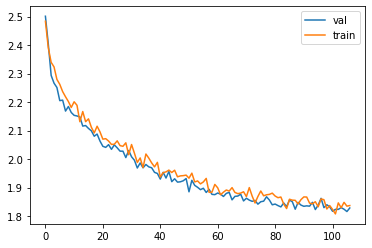

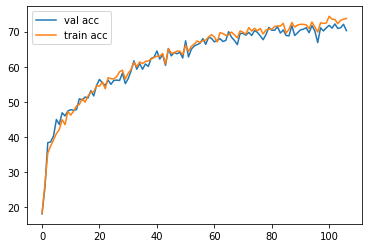


epoch  27
Iteration 0, loss = 1.8748
Checking accuracy on validation set
Got 722 / 1000 correct (72.20)
Checking accuracy on train set
Got 36389 / 49000 correct (74.26)


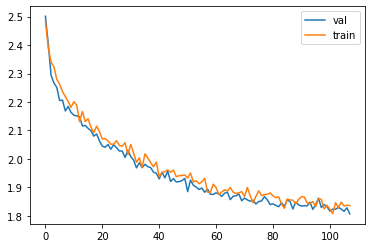

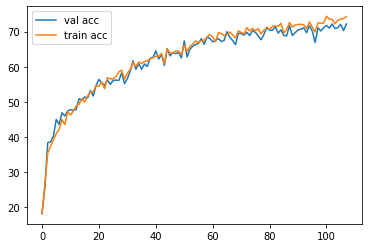


Iteration 200, loss = 1.8684
Checking accuracy on validation set
Got 708 / 1000 correct (70.80)
Checking accuracy on train set
Got 35439 / 49000 correct (72.32)


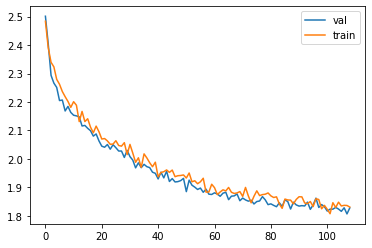

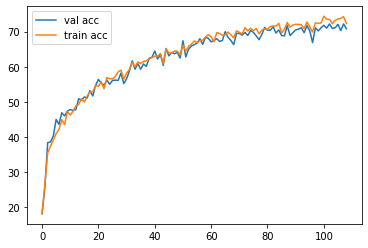


Iteration 400, loss = 1.8838
Checking accuracy on validation set
Got 702 / 1000 correct (70.20)
Checking accuracy on train set
Got 36015 / 49000 correct (73.50)


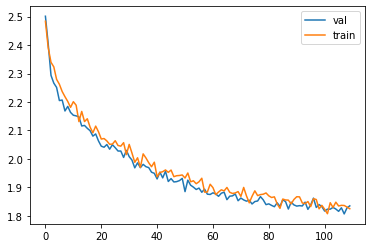

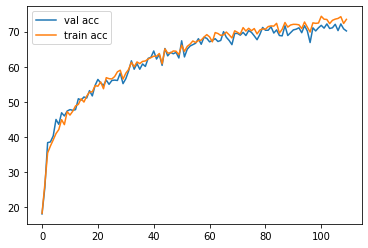


Iteration 600, loss = 1.8212
Checking accuracy on validation set
Got 709 / 1000 correct (70.90)
Checking accuracy on train set
Got 36123 / 49000 correct (73.72)


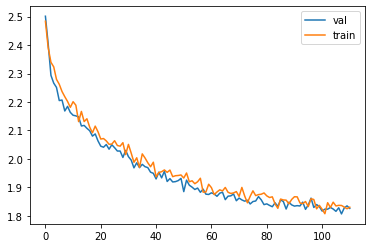

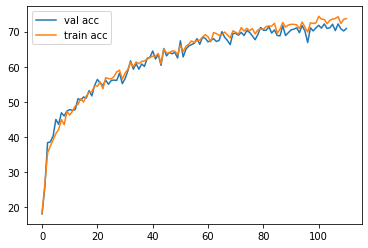


epoch  28
Iteration 0, loss = 1.8469
Checking accuracy on validation set
Got 704 / 1000 correct (70.40)
Checking accuracy on train set
Got 35540 / 49000 correct (72.53)


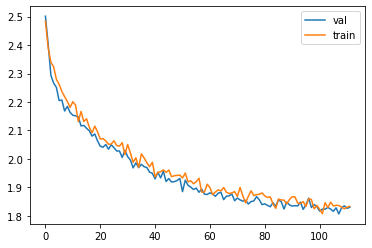

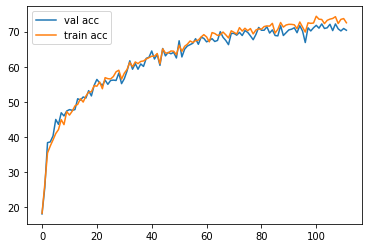


Iteration 200, loss = 1.8578
Checking accuracy on validation set
Got 710 / 1000 correct (71.00)
Checking accuracy on train set
Got 35953 / 49000 correct (73.37)


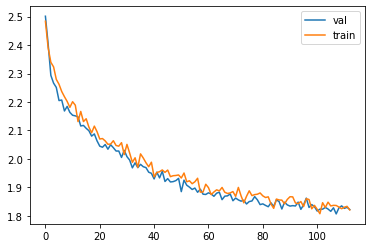

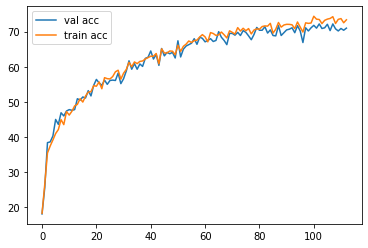


Iteration 400, loss = 1.9229
Checking accuracy on validation set
Got 709 / 1000 correct (70.90)
Checking accuracy on train set
Got 35144 / 49000 correct (71.72)


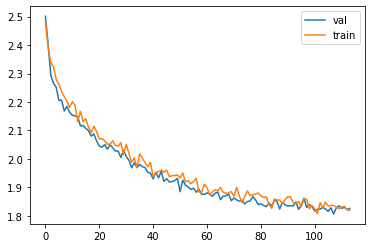

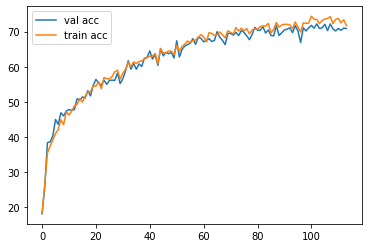


Iteration 600, loss = 1.8388
Checking accuracy on validation set
Got 719 / 1000 correct (71.90)
Checking accuracy on train set
Got 36538 / 49000 correct (74.57)


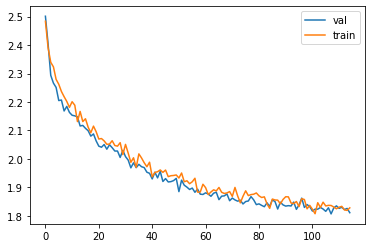

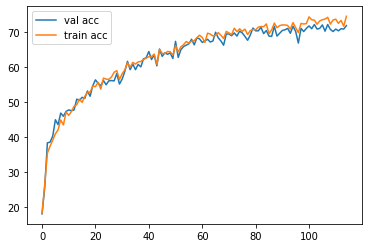


epoch  29
Iteration 0, loss = 1.8521
Checking accuracy on validation set
Got 735 / 1000 correct (73.50)
Checking accuracy on train set
Got 36535 / 49000 correct (74.56)


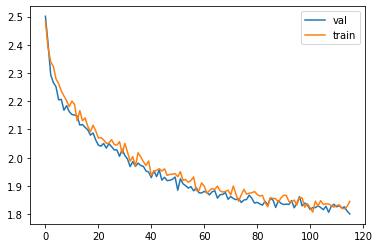

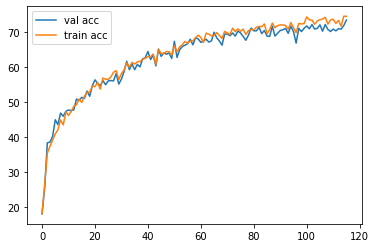


Iteration 200, loss = 1.8243
Checking accuracy on validation set
Got 734 / 1000 correct (73.40)
Checking accuracy on train set
Got 36113 / 49000 correct (73.70)


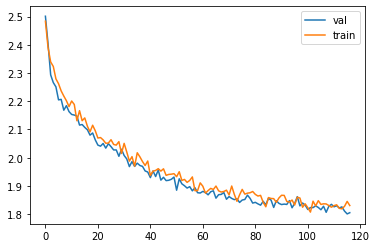

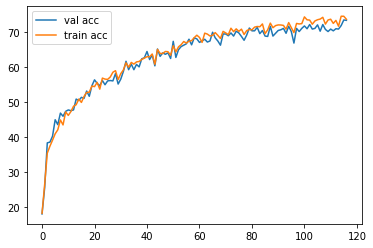


Iteration 400, loss = 1.6918
Checking accuracy on validation set
Got 733 / 1000 correct (73.30)
Checking accuracy on train set
Got 36261 / 49000 correct (74.00)


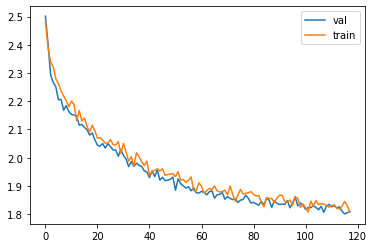

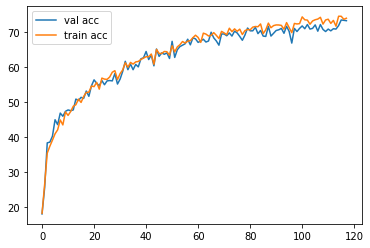


Iteration 600, loss = 1.8565
Checking accuracy on validation set
Got 715 / 1000 correct (71.50)
Checking accuracy on train set
Got 36765 / 49000 correct (75.03)


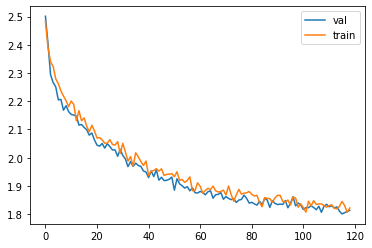

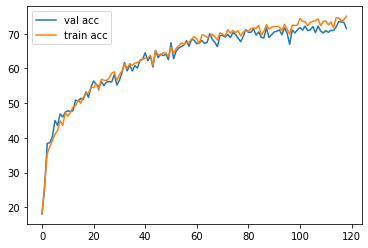


epoch  30
Iteration 0, loss = 1.7877
Checking accuracy on validation set
Got 725 / 1000 correct (72.50)
Checking accuracy on train set
Got 37094 / 49000 correct (75.70)


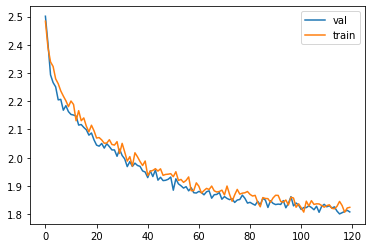

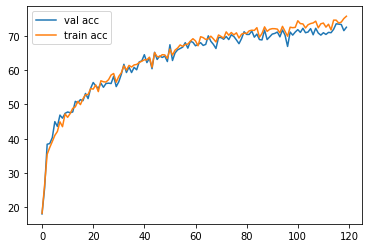


Iteration 200, loss = 1.9112
Checking accuracy on validation set
Got 709 / 1000 correct (70.90)
Checking accuracy on train set
Got 36350 / 49000 correct (74.18)


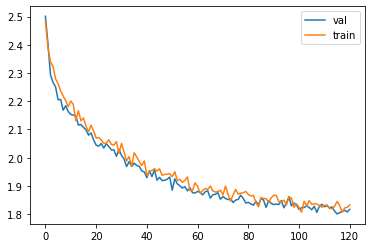

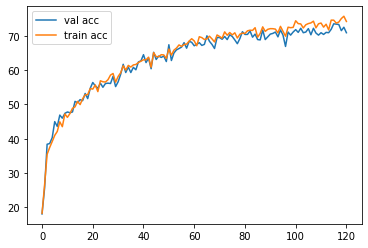


Iteration 400, loss = 1.7829
Checking accuracy on validation set
Got 721 / 1000 correct (72.10)
Checking accuracy on train set
Got 36374 / 49000 correct (74.23)


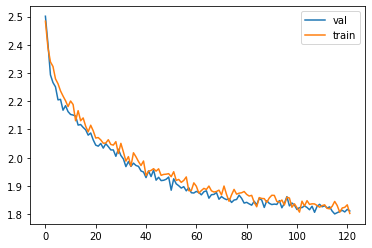

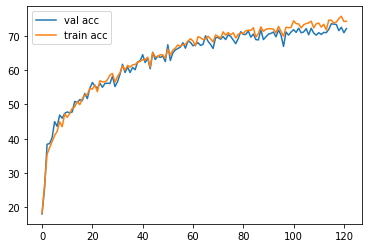


Iteration 600, loss = 1.8893
Checking accuracy on validation set
Got 671 / 1000 correct (67.10)
Checking accuracy on train set
Got 34985 / 49000 correct (71.40)


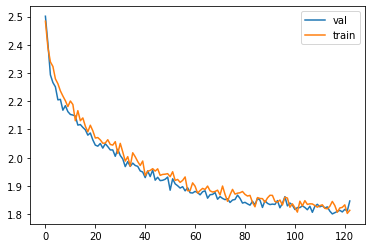

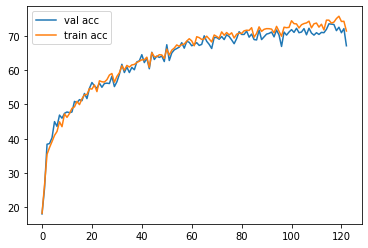


epoch  31
Iteration 0, loss = 1.8101
Checking accuracy on validation set
Got 728 / 1000 correct (72.80)
Checking accuracy on train set
Got 36531 / 49000 correct (74.55)


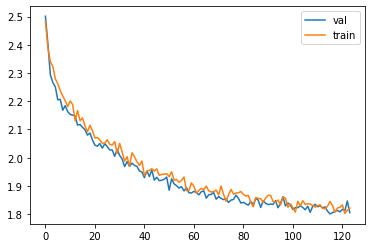

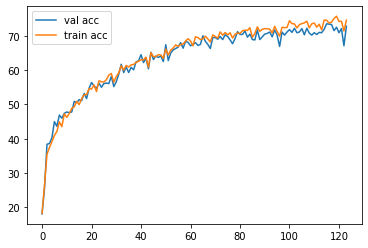


Iteration 200, loss = 1.7979
Checking accuracy on validation set
Got 721 / 1000 correct (72.10)
Checking accuracy on train set
Got 36392 / 49000 correct (74.27)


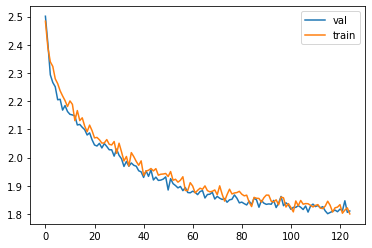

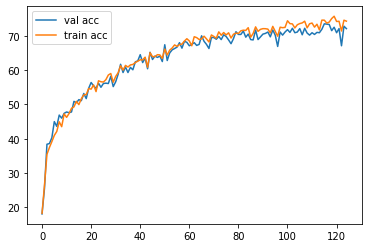


Iteration 400, loss = 1.7592
Checking accuracy on validation set
Got 729 / 1000 correct (72.90)
Checking accuracy on train set
Got 36815 / 49000 correct (75.13)


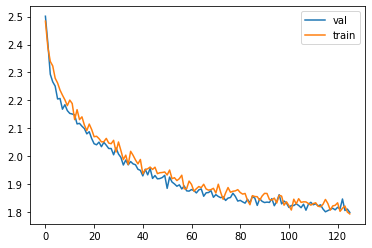

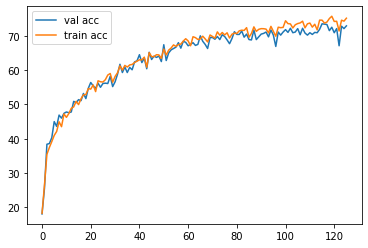


Iteration 600, loss = 1.7618
Checking accuracy on validation set
Got 692 / 1000 correct (69.20)
Checking accuracy on train set
Got 35083 / 49000 correct (71.60)


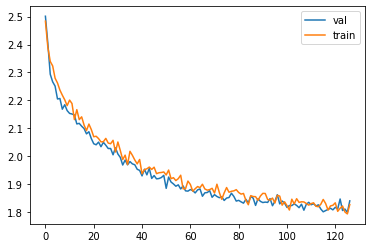

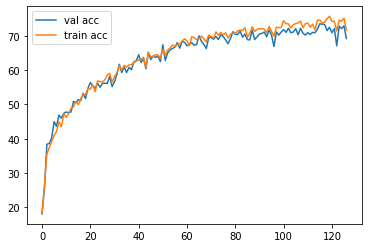


epoch  32
Iteration 0, loss = 1.8865
Checking accuracy on validation set
Got 730 / 1000 correct (73.00)
Checking accuracy on train set
Got 37257 / 49000 correct (76.03)


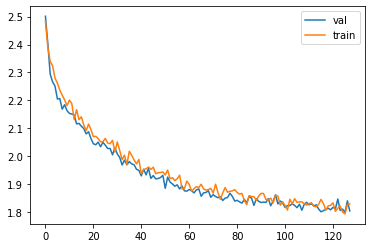

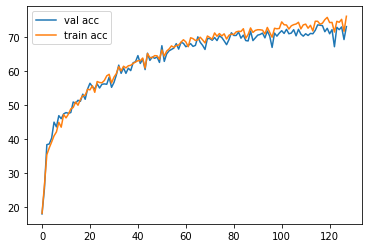


Iteration 200, loss = 1.7457
Checking accuracy on validation set
Got 730 / 1000 correct (73.00)
Checking accuracy on train set
Got 37287 / 49000 correct (76.10)


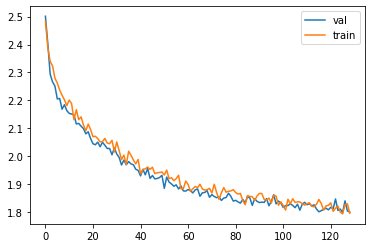

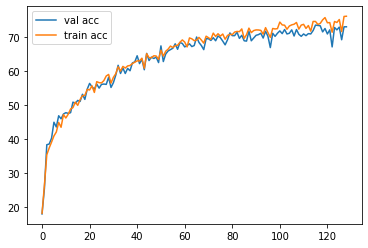


Iteration 400, loss = 1.8594
Checking accuracy on validation set
Got 725 / 1000 correct (72.50)
Checking accuracy on train set
Got 37072 / 49000 correct (75.66)


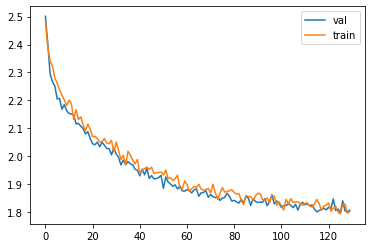

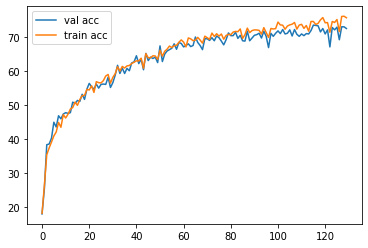


Iteration 600, loss = 1.8910
Checking accuracy on validation set
Got 718 / 1000 correct (71.80)
Checking accuracy on train set
Got 36203 / 49000 correct (73.88)


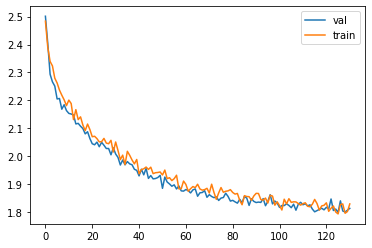

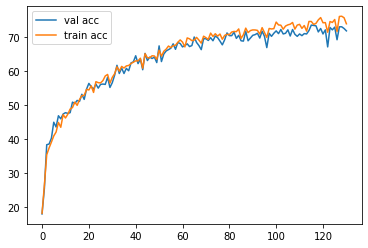


epoch  33
Iteration 0, loss = 1.8032
Checking accuracy on validation set
Got 710 / 1000 correct (71.00)
Checking accuracy on train set
Got 35928 / 49000 correct (73.32)


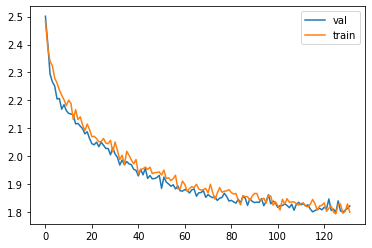

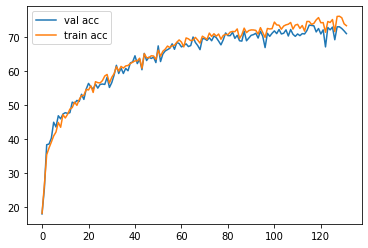


Iteration 200, loss = 1.7162
Checking accuracy on validation set
Got 708 / 1000 correct (70.80)
Checking accuracy on train set
Got 36093 / 49000 correct (73.66)


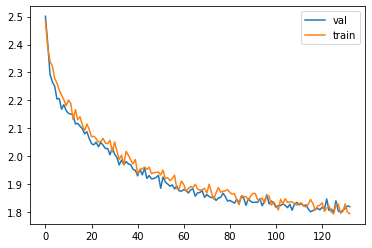

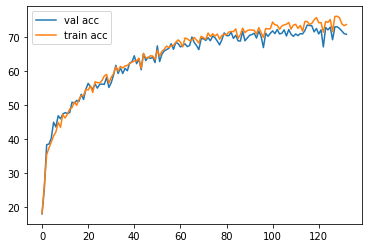


Iteration 400, loss = 1.8248
Checking accuracy on validation set
Got 714 / 1000 correct (71.40)
Checking accuracy on train set
Got 36421 / 49000 correct (74.33)


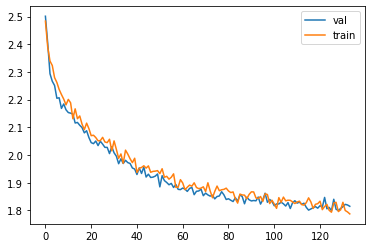

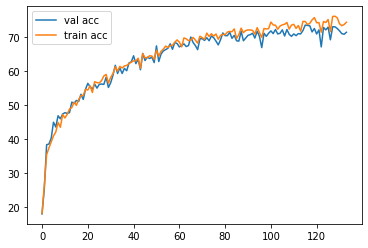


Iteration 600, loss = 1.8480
Checking accuracy on validation set
Got 715 / 1000 correct (71.50)
Checking accuracy on train set
Got 35988 / 49000 correct (73.44)


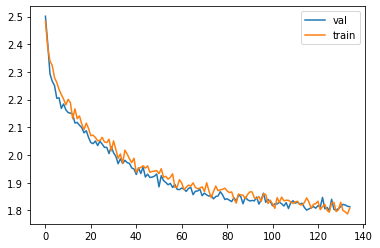

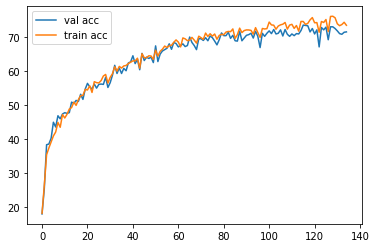


epoch  34
Iteration 0, loss = 1.7996
Checking accuracy on validation set
Got 720 / 1000 correct (72.00)
Checking accuracy on train set
Got 37074 / 49000 correct (75.66)


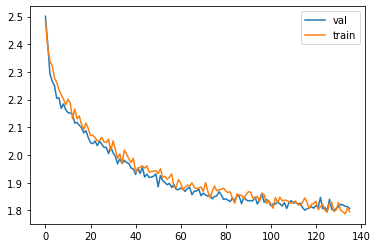

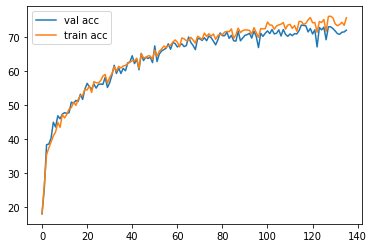


Iteration 200, loss = 1.8842
Checking accuracy on validation set
Got 703 / 1000 correct (70.30)
Checking accuracy on train set
Got 35917 / 49000 correct (73.30)


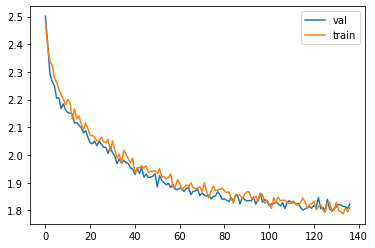

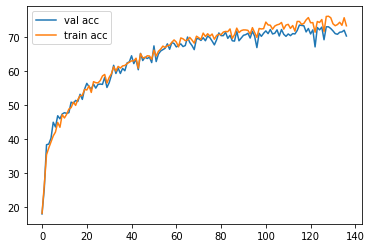


Iteration 400, loss = 1.7431
Checking accuracy on validation set
Got 726 / 1000 correct (72.60)
Checking accuracy on train set
Got 36785 / 49000 correct (75.07)


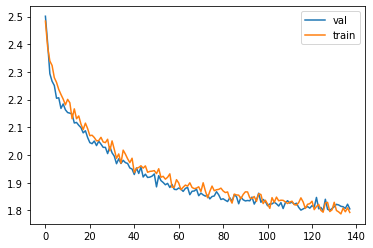

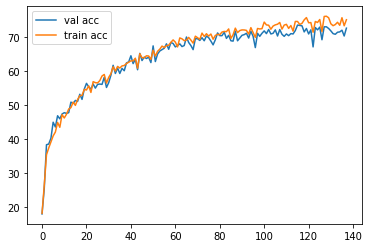


Iteration 600, loss = 1.8490
Checking accuracy on validation set
Got 708 / 1000 correct (70.80)
Checking accuracy on train set
Got 35321 / 49000 correct (72.08)


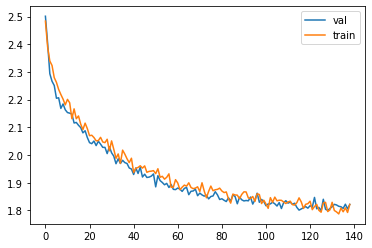

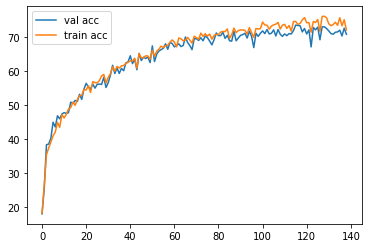


epoch  35
Iteration 0, loss = 1.8441
Checking accuracy on validation set
Got 723 / 1000 correct (72.30)
Checking accuracy on train set
Got 36701 / 49000 correct (74.90)


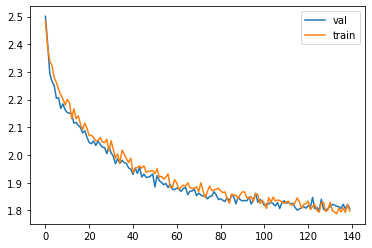

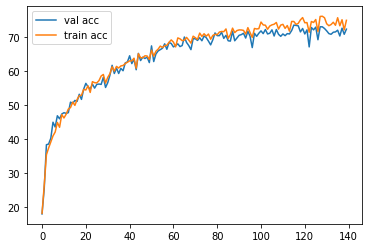


Iteration 200, loss = 1.8244
Checking accuracy on validation set
Got 736 / 1000 correct (73.60)
Checking accuracy on train set
Got 36560 / 49000 correct (74.61)


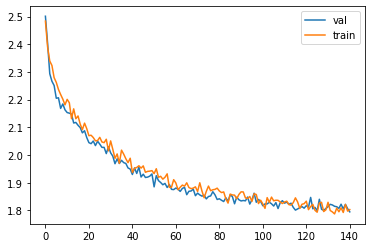

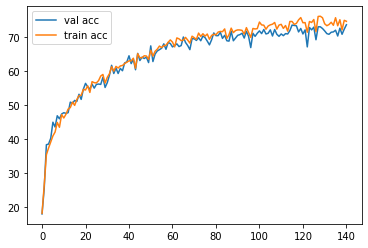


Iteration 400, loss = 1.7414
Checking accuracy on validation set
Got 719 / 1000 correct (71.90)
Checking accuracy on train set
Got 36877 / 49000 correct (75.26)


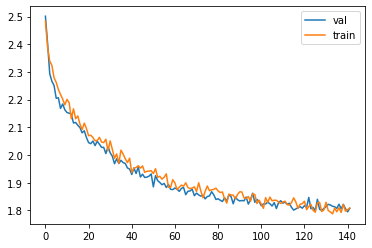

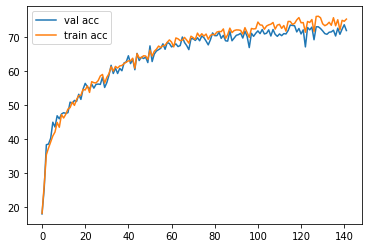


Iteration 600, loss = 1.7803
Checking accuracy on validation set
Got 732 / 1000 correct (73.20)
Checking accuracy on train set
Got 37438 / 49000 correct (76.40)


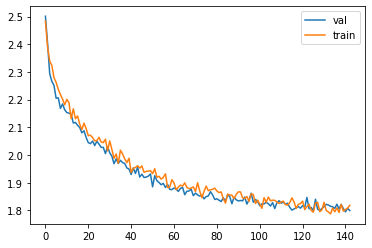

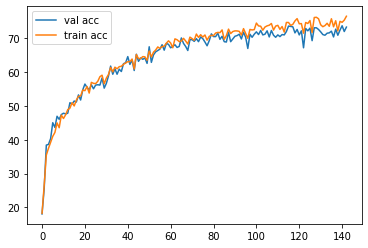


epoch  36
Iteration 0, loss = 1.8293
Checking accuracy on validation set
Got 723 / 1000 correct (72.30)
Checking accuracy on train set
Got 37121 / 49000 correct (75.76)


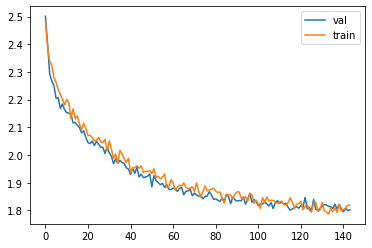

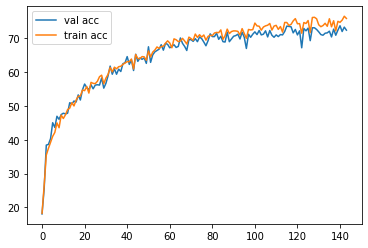


Iteration 200, loss = 1.8716
Checking accuracy on validation set
Got 742 / 1000 correct (74.20)
Checking accuracy on train set
Got 37392 / 49000 correct (76.31)


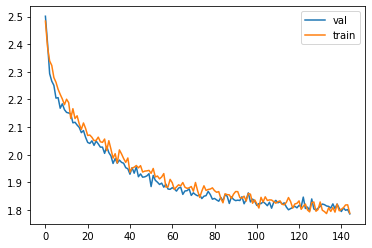

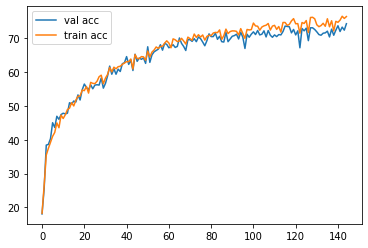


Iteration 400, loss = 1.7741
Checking accuracy on validation set
Got 753 / 1000 correct (75.30)
Checking accuracy on train set
Got 37507 / 49000 correct (76.54)


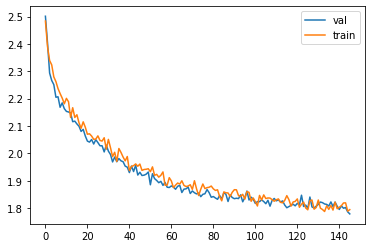

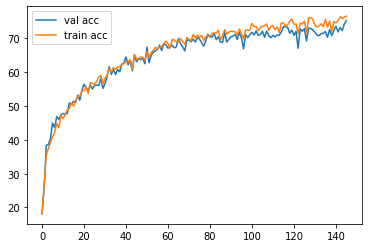


Iteration 600, loss = 1.7666
Checking accuracy on validation set
Got 716 / 1000 correct (71.60)
Checking accuracy on train set
Got 36722 / 49000 correct (74.94)


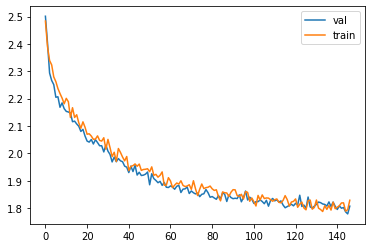

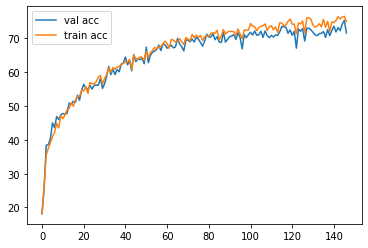


epoch  37
Iteration 0, loss = 1.7984
Checking accuracy on validation set
Got 738 / 1000 correct (73.80)
Checking accuracy on train set
Got 37224 / 49000 correct (75.97)


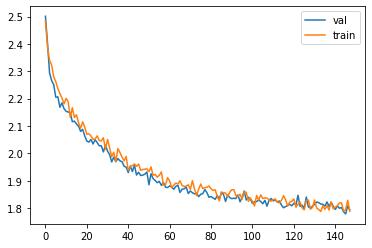

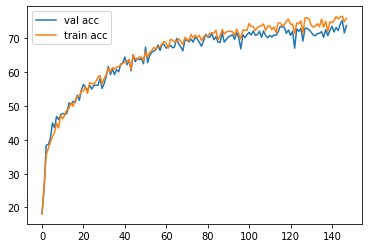


Iteration 200, loss = 1.7194
Checking accuracy on validation set
Got 741 / 1000 correct (74.10)
Checking accuracy on train set
Got 37012 / 49000 correct (75.53)


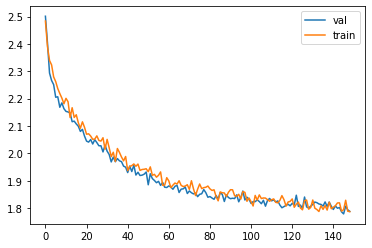

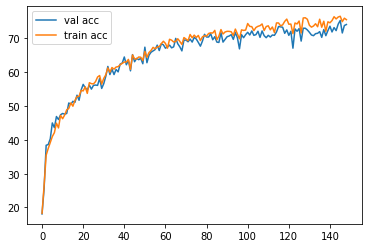


Iteration 400, loss = 1.7040
Checking accuracy on validation set
Got 728 / 1000 correct (72.80)
Checking accuracy on train set
Got 37149 / 49000 correct (75.81)


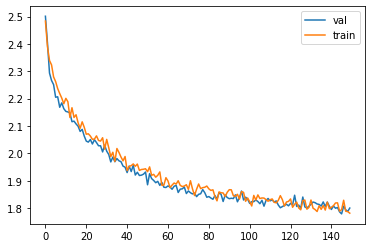

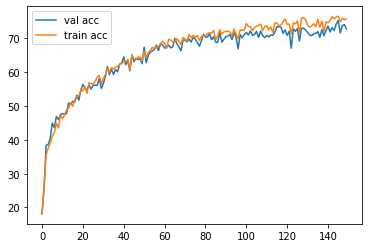


Iteration 600, loss = 1.7850
Checking accuracy on validation set
Got 733 / 1000 correct (73.30)
Checking accuracy on train set
Got 37006 / 49000 correct (75.52)


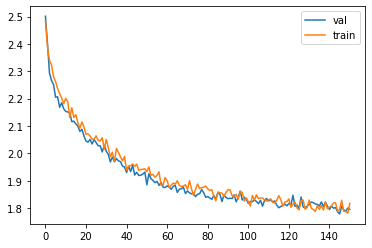

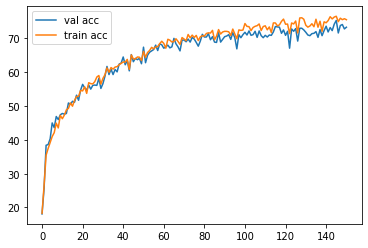


epoch  38
Iteration 0, loss = 1.7532
Checking accuracy on validation set
Got 725 / 1000 correct (72.50)
Checking accuracy on train set
Got 36982 / 49000 correct (75.47)


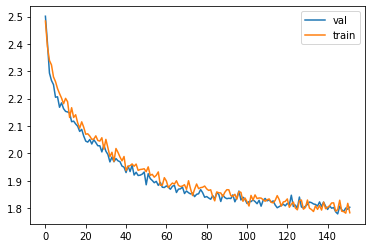

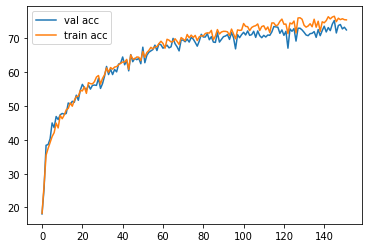


Iteration 200, loss = 1.7235
Checking accuracy on validation set
Got 734 / 1000 correct (73.40)
Checking accuracy on train set
Got 37276 / 49000 correct (76.07)


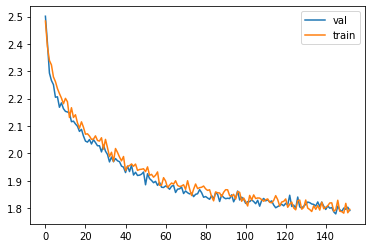

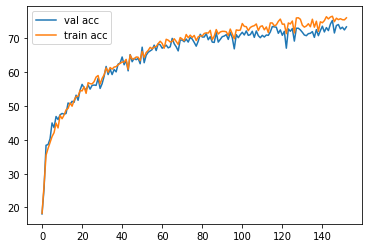


Iteration 400, loss = 1.7633
Checking accuracy on validation set
Got 730 / 1000 correct (73.00)
Checking accuracy on train set
Got 37281 / 49000 correct (76.08)


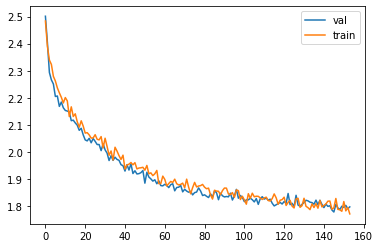

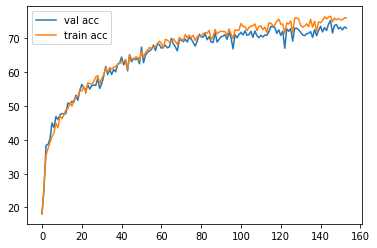


Iteration 600, loss = 1.8150
Checking accuracy on validation set
Got 712 / 1000 correct (71.20)
Checking accuracy on train set
Got 36494 / 49000 correct (74.48)


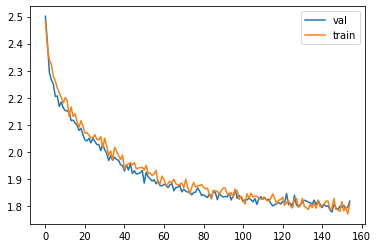

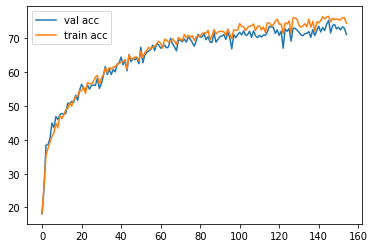


epoch  39
Iteration 0, loss = 1.7950
Checking accuracy on validation set
Got 744 / 1000 correct (74.40)
Checking accuracy on train set
Got 37845 / 49000 correct (77.23)


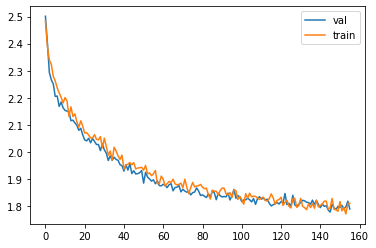

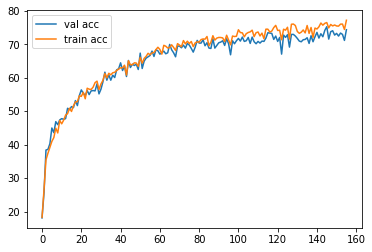


Iteration 200, loss = 1.7924
Checking accuracy on validation set
Got 737 / 1000 correct (73.70)
Checking accuracy on train set
Got 37238 / 49000 correct (76.00)


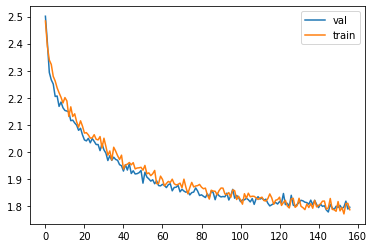

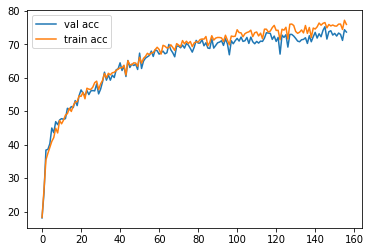


Iteration 400, loss = 1.8652
Checking accuracy on validation set
Got 731 / 1000 correct (73.10)
Checking accuracy on train set
Got 37156 / 49000 correct (75.83)


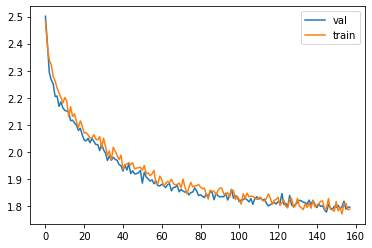

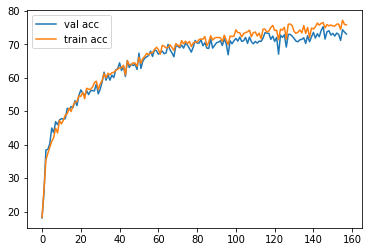


Iteration 600, loss = 1.7515
Checking accuracy on validation set
Got 730 / 1000 correct (73.00)
Checking accuracy on train set
Got 37199 / 49000 correct (75.92)


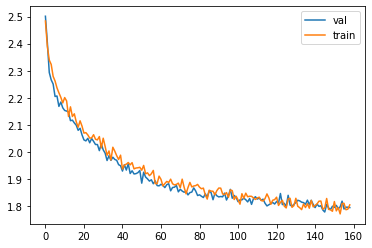

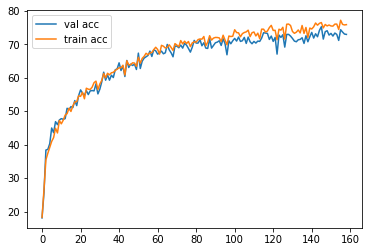


epoch  40
Iteration 0, loss = 1.7508
Checking accuracy on validation set
Got 745 / 1000 correct (74.50)
Checking accuracy on train set
Got 37732 / 49000 correct (77.00)


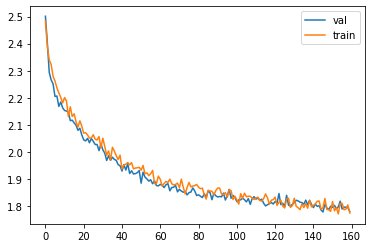

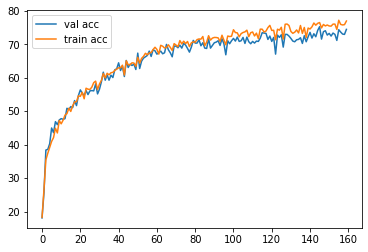


Iteration 200, loss = 1.8267
Checking accuracy on validation set
Got 729 / 1000 correct (72.90)
Checking accuracy on train set
Got 37095 / 49000 correct (75.70)


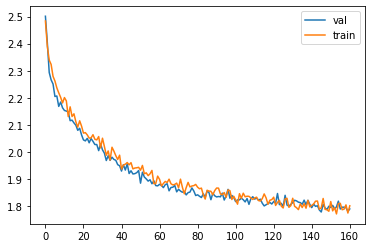

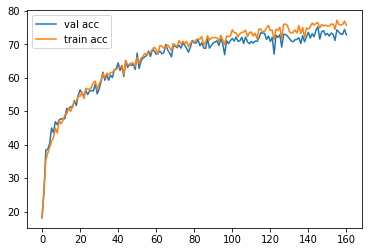


Iteration 400, loss = 1.7849
Checking accuracy on validation set
Got 735 / 1000 correct (73.50)
Checking accuracy on train set
Got 37798 / 49000 correct (77.14)


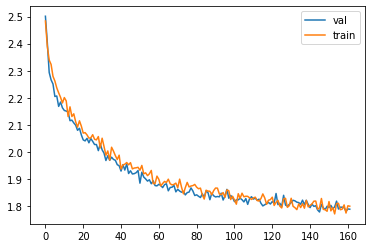

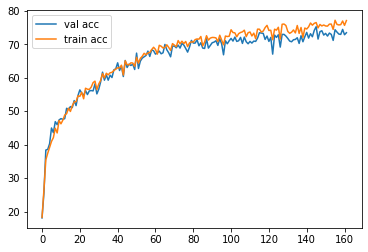


Iteration 600, loss = 1.8672
Checking accuracy on validation set
Got 717 / 1000 correct (71.70)
Checking accuracy on train set
Got 37184 / 49000 correct (75.89)


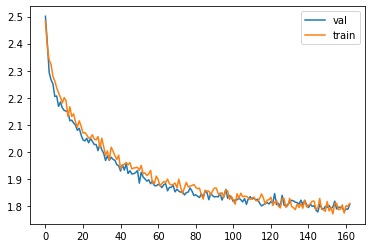

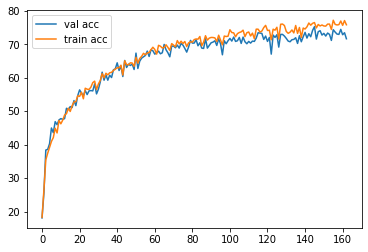


epoch  41
Iteration 0, loss = 1.8185
Checking accuracy on validation set
Got 736 / 1000 correct (73.60)
Checking accuracy on train set
Got 37499 / 49000 correct (76.53)


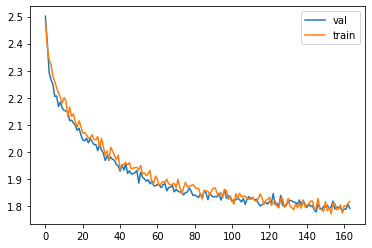

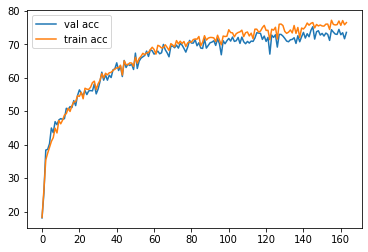


Iteration 200, loss = 1.7777
Checking accuracy on validation set
Got 725 / 1000 correct (72.50)
Checking accuracy on train set
Got 37415 / 49000 correct (76.36)


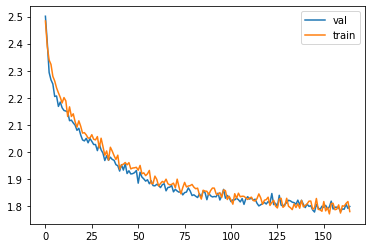

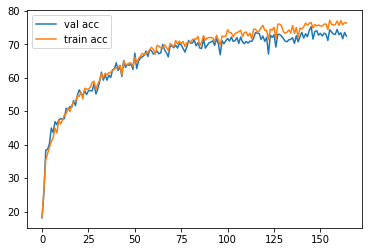


Iteration 400, loss = 1.9228
Checking accuracy on validation set
Got 721 / 1000 correct (72.10)
Checking accuracy on train set
Got 36875 / 49000 correct (75.26)


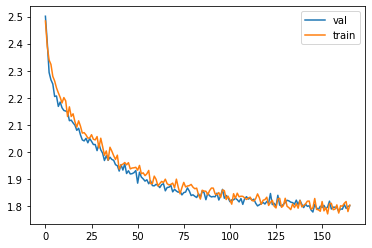

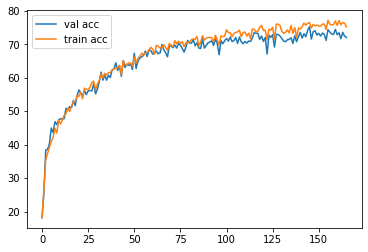


Iteration 600, loss = 1.8294
Checking accuracy on validation set
Got 731 / 1000 correct (73.10)
Checking accuracy on train set
Got 37154 / 49000 correct (75.82)


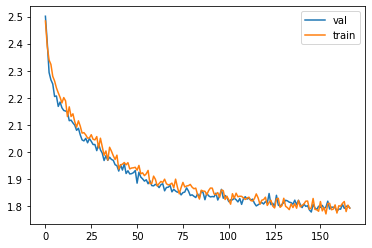

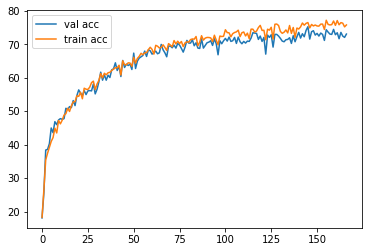


epoch  42
Iteration 0, loss = 1.7658
Checking accuracy on validation set
Got 743 / 1000 correct (74.30)
Checking accuracy on train set
Got 37503 / 49000 correct (76.54)


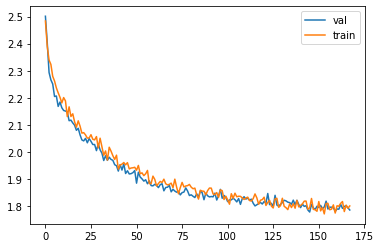

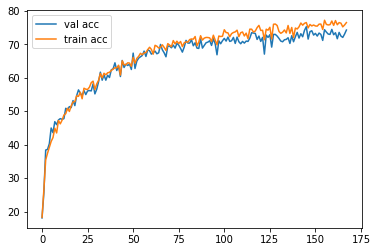


Iteration 200, loss = 1.8056
Checking accuracy on validation set
Got 713 / 1000 correct (71.30)
Checking accuracy on train set
Got 36479 / 49000 correct (74.45)


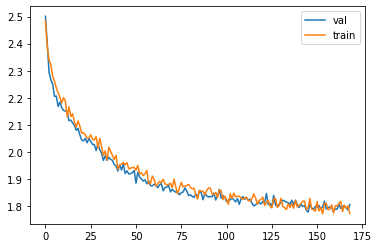

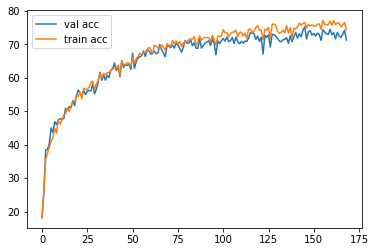


Iteration 400, loss = 1.6987
Checking accuracy on validation set
Got 723 / 1000 correct (72.30)
Checking accuracy on train set
Got 37095 / 49000 correct (75.70)


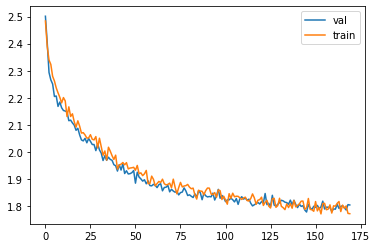

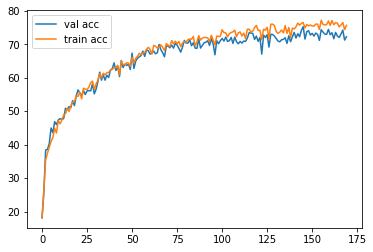


Iteration 600, loss = 1.7355
Checking accuracy on validation set
Got 745 / 1000 correct (74.50)
Checking accuracy on train set
Got 37941 / 49000 correct (77.43)


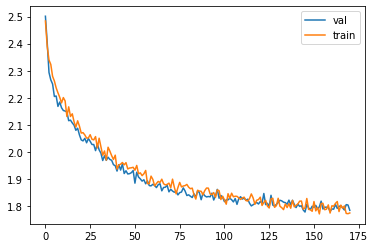

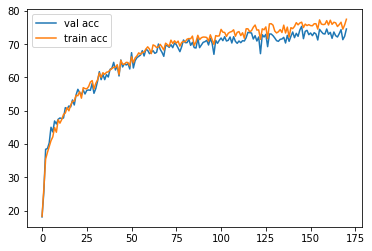


epoch  43
Iteration 0, loss = 1.8236
Checking accuracy on validation set
Got 733 / 1000 correct (73.30)
Checking accuracy on train set
Got 37571 / 49000 correct (76.68)


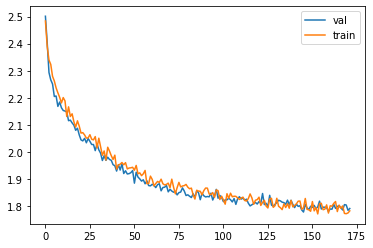

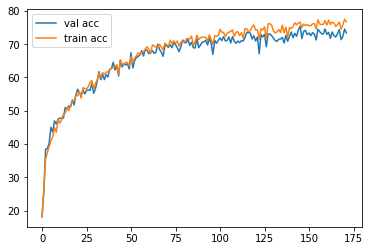


Iteration 200, loss = 1.8139
Checking accuracy on validation set
Got 745 / 1000 correct (74.50)
Checking accuracy on train set
Got 37399 / 49000 correct (76.32)


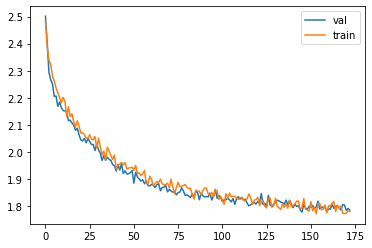

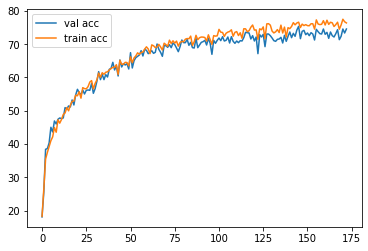


Iteration 400, loss = 1.7527
Checking accuracy on validation set
Got 721 / 1000 correct (72.10)
Checking accuracy on train set
Got 36691 / 49000 correct (74.88)


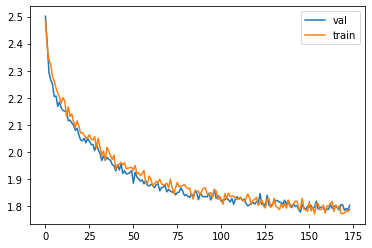

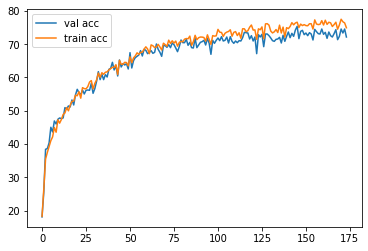


Iteration 600, loss = 1.6950
Checking accuracy on validation set
Got 741 / 1000 correct (74.10)
Checking accuracy on train set
Got 38206 / 49000 correct (77.97)


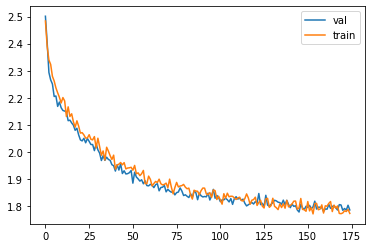

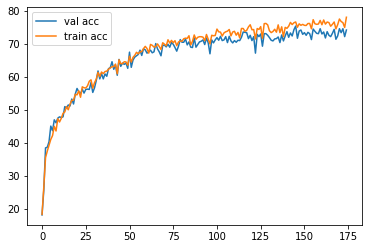


epoch  44
Iteration 0, loss = 1.8112
Checking accuracy on validation set
Got 733 / 1000 correct (73.30)
Checking accuracy on train set
Got 37740 / 49000 correct (77.02)


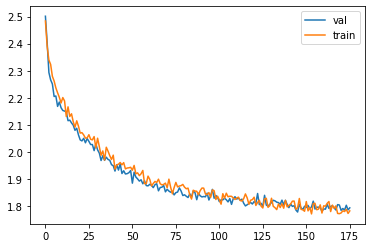

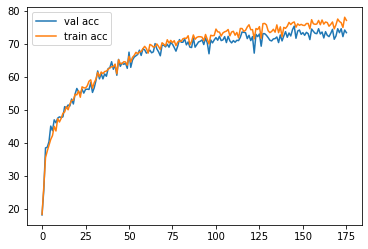


Iteration 200, loss = 1.7233
Checking accuracy on validation set
Got 740 / 1000 correct (74.00)
Checking accuracy on train set
Got 37713 / 49000 correct (76.97)


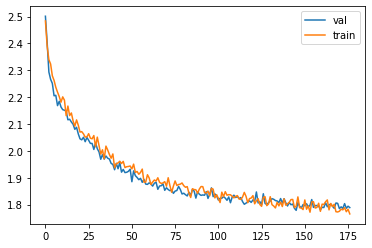

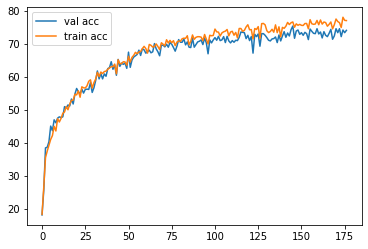


Iteration 400, loss = 1.7977
Checking accuracy on validation set
Got 740 / 1000 correct (74.00)
Checking accuracy on train set
Got 36893 / 49000 correct (75.29)


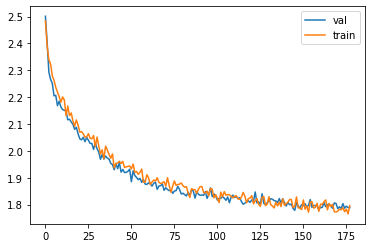

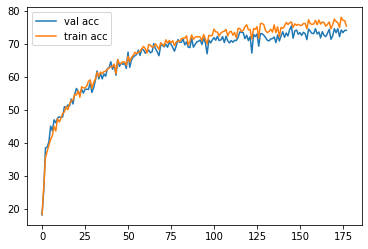


Iteration 600, loss = 1.7812
Checking accuracy on validation set
Got 748 / 1000 correct (74.80)
Checking accuracy on train set
Got 37836 / 49000 correct (77.22)


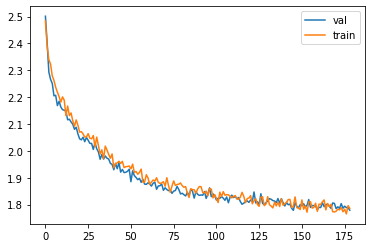

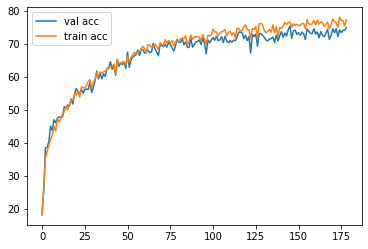


epoch  45
Iteration 0, loss = 1.8540
Checking accuracy on validation set
Got 724 / 1000 correct (72.40)
Checking accuracy on train set
Got 36835 / 49000 correct (75.17)


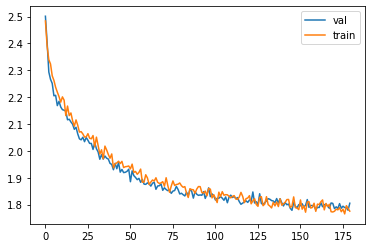

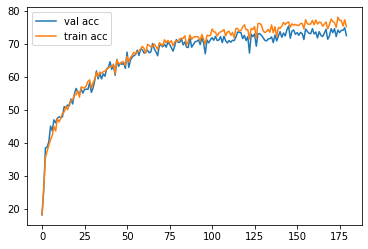


Iteration 200, loss = 1.8258
Checking accuracy on validation set
Got 728 / 1000 correct (72.80)
Checking accuracy on train set
Got 37738 / 49000 correct (77.02)


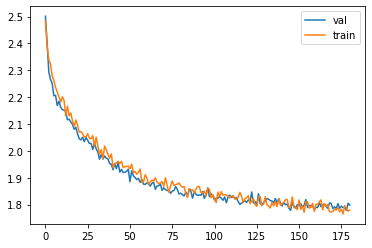

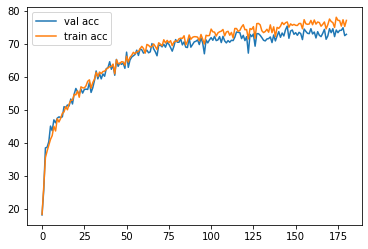


Iteration 400, loss = 1.7677
Checking accuracy on validation set
Got 742 / 1000 correct (74.20)
Checking accuracy on train set
Got 37621 / 49000 correct (76.78)


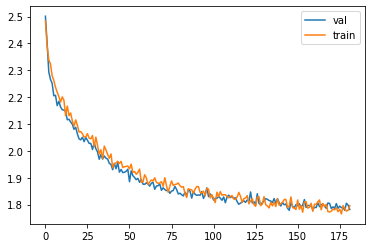

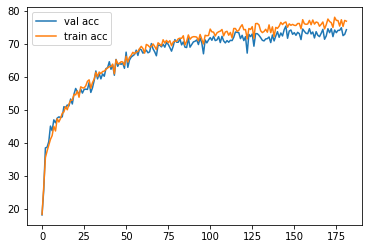


Iteration 600, loss = 1.7477
Checking accuracy on validation set
Got 732 / 1000 correct (73.20)
Checking accuracy on train set
Got 37508 / 49000 correct (76.55)


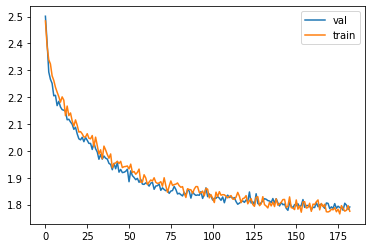

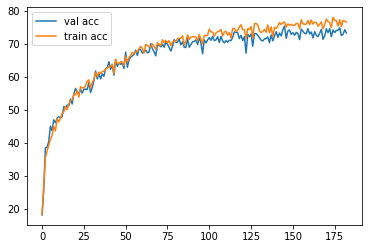


epoch  46
Iteration 0, loss = 1.8013
Checking accuracy on validation set
Got 714 / 1000 correct (71.40)
Checking accuracy on train set
Got 36585 / 49000 correct (74.66)


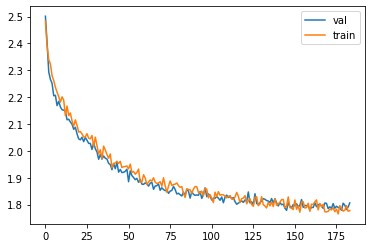

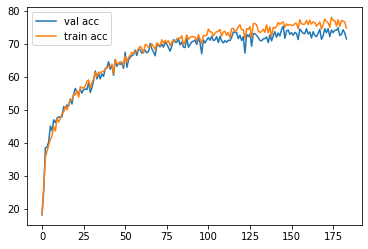


Iteration 200, loss = 1.7128
Checking accuracy on validation set
Got 762 / 1000 correct (76.20)
Checking accuracy on train set
Got 38073 / 49000 correct (77.70)


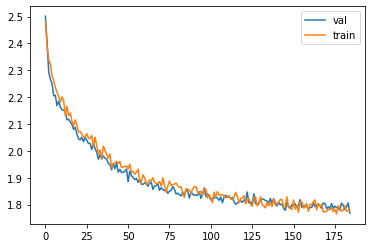

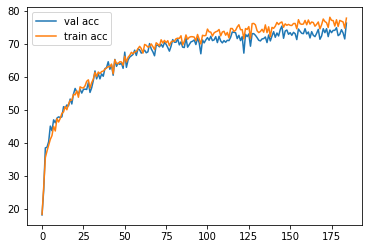


Iteration 400, loss = 1.7241
Checking accuracy on validation set
Got 747 / 1000 correct (74.70)
Checking accuracy on train set
Got 38154 / 49000 correct (77.87)


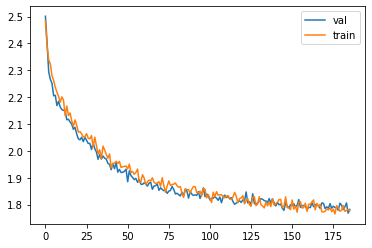

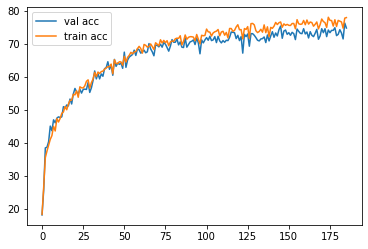


Iteration 600, loss = 1.7582
Checking accuracy on validation set
Got 729 / 1000 correct (72.90)
Checking accuracy on train set
Got 37579 / 49000 correct (76.69)


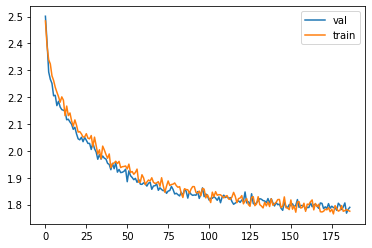

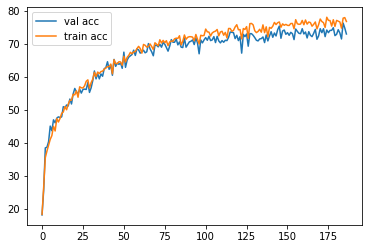


epoch  47
Iteration 0, loss = 1.7724
Checking accuracy on validation set
Got 762 / 1000 correct (76.20)
Checking accuracy on train set
Got 37911 / 49000 correct (77.37)


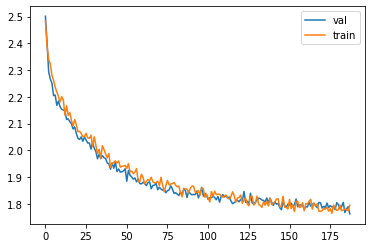

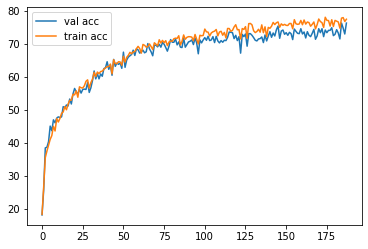


Iteration 200, loss = 1.8138
Checking accuracy on validation set
Got 747 / 1000 correct (74.70)
Checking accuracy on train set
Got 38172 / 49000 correct (77.90)


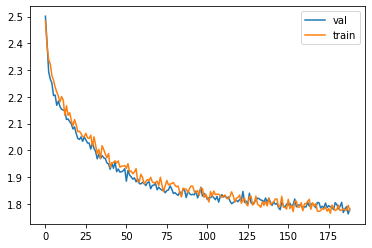

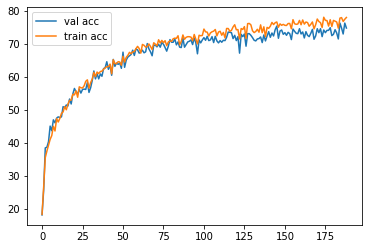


Iteration 400, loss = 1.7467
Checking accuracy on validation set
Got 759 / 1000 correct (75.90)
Checking accuracy on train set
Got 38413 / 49000 correct (78.39)


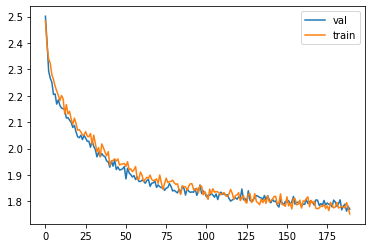

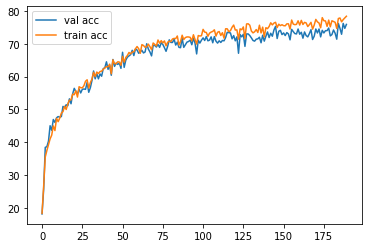


Iteration 600, loss = 1.8394
Checking accuracy on validation set
Got 755 / 1000 correct (75.50)
Checking accuracy on train set
Got 38113 / 49000 correct (77.78)


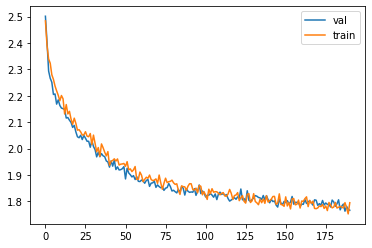

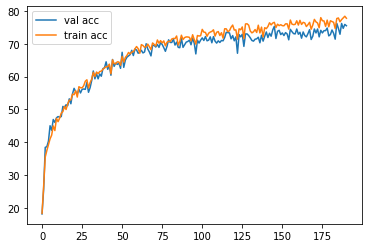


epoch  48
Iteration 0, loss = 1.6970
Checking accuracy on validation set
Got 738 / 1000 correct (73.80)
Checking accuracy on train set
Got 37469 / 49000 correct (76.47)


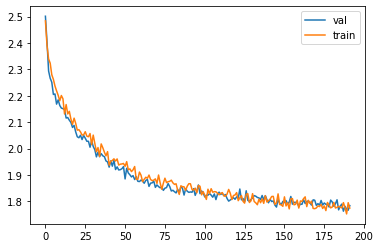

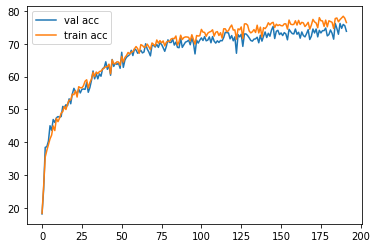


Iteration 200, loss = 1.8080
Checking accuracy on validation set
Got 725 / 1000 correct (72.50)
Checking accuracy on train set
Got 37277 / 49000 correct (76.08)


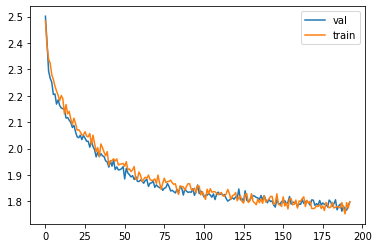

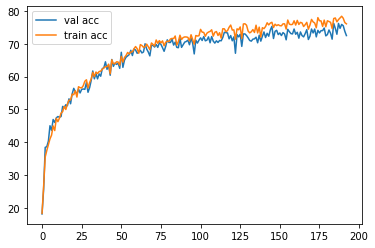


Iteration 400, loss = 1.7919
Checking accuracy on validation set
Got 725 / 1000 correct (72.50)
Checking accuracy on train set
Got 37044 / 49000 correct (75.60)


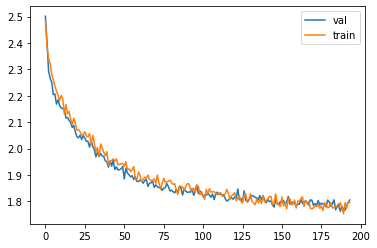

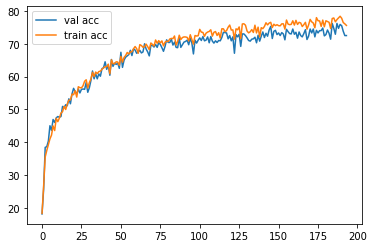


Iteration 600, loss = 1.7599
Checking accuracy on validation set
Got 735 / 1000 correct (73.50)
Checking accuracy on train set
Got 37802 / 49000 correct (77.15)


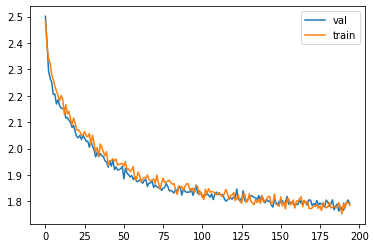

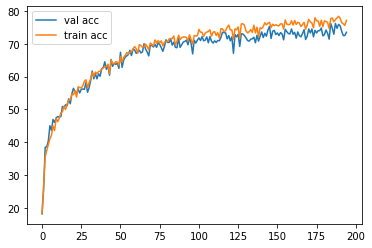


epoch  49
Iteration 0, loss = 1.7501
Checking accuracy on validation set
Got 759 / 1000 correct (75.90)
Checking accuracy on train set
Got 38257 / 49000 correct (78.08)


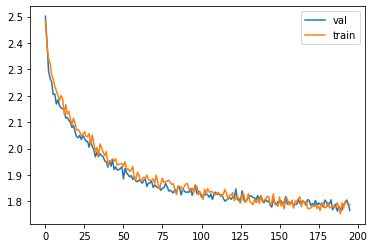

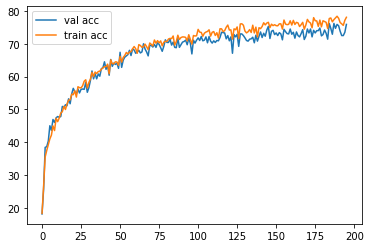


Iteration 200, loss = 1.6825
Checking accuracy on validation set
Got 751 / 1000 correct (75.10)
Checking accuracy on train set
Got 38502 / 49000 correct (78.58)


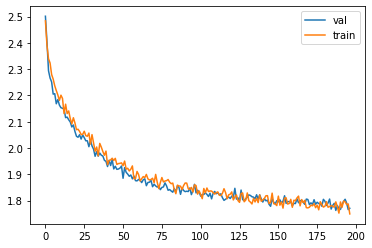

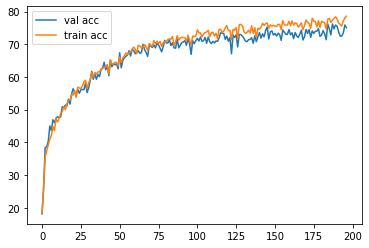


Iteration 400, loss = 1.7511
Checking accuracy on validation set
Got 744 / 1000 correct (74.40)
Checking accuracy on train set
Got 37896 / 49000 correct (77.34)


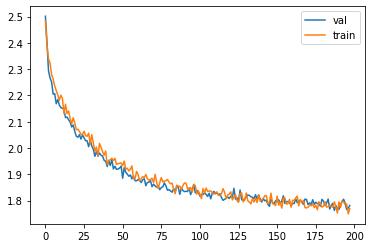

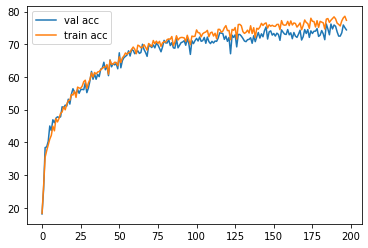


Iteration 600, loss = 1.8945
Checking accuracy on validation set
Got 734 / 1000 correct (73.40)
Checking accuracy on train set
Got 37019 / 49000 correct (75.55)


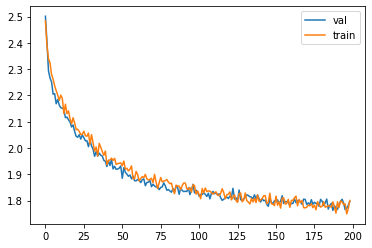

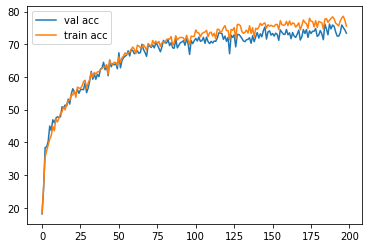


Wed Oct  7 20:07:04 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   73C    P0   123W / 149W |   1267MiB / 11441MiB |     56%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+------

(1.7674603059792975, 71.17)

In [16]:
# Another model

import torch
# assert '.'.join(torch.__version__.split('.')[:2]) == '1.4'
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler

import torchvision.datasets as dset
import torchvision.transforms as T

import numpy as np

NUM_TRAIN = 49000

# The torchvision.transforms package provides tools for preprocessing data
# and for performing data augmentation; here we set up a transform to
# preprocess the data by subtracting the mean RGB value and dividing by the
# standard deviation of each RGB value; we've hardcoded the mean and std.
transform = T.Compose([
                T.ToTensor(),
                T.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
            ])

# We set up a Dataset object for each split (train / val / test); Datasets load
# training examples one at a time, so we wrap each Dataset in a DataLoader which
# iterates through the Dataset and forms minibatches. We divide the CIFAR-10
# training set into train and val sets by passing a Sampler object to the
# DataLoader telling how it should sample from the underlying Dataset.
cifar10_train = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                             transform=transform)
loader_train = DataLoader(cifar10_train, batch_size=64, 
                          sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN)))

cifar10_val = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                           transform=transform)
loader_val = DataLoader(cifar10_val, batch_size=64, 
                        sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN, 50000)))

cifar10_test = dset.CIFAR10('./cs231n/datasets', train=False, download=True, 
                            transform=transform)
loader_test = DataLoader(cifar10_test, batch_size=64)
!nvidia-smi

USE_GPU = True

dtype = torch.float32 # we will be using float throughout this tutorial

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

# Constant to control how frequently we print train loss

print('using device:', device)
!nvidia-smi

import matplotlib.pyplot as plt
from statistics import mean 
import torch.nn.functional as F  # useful stateless functions

def check_accuracy_part34(loader, model, train_part=False):
    if train_part==False:
      if loader.dataset.train:
          print('Checking accuracy on validation set')
      else:
          print('Checking accuracy on test set')   
    else:
       print('Checking accuracy on train set')
    num_correct = 0
    num_samples = 0
    model.eval()  # set model to evaluation mode

    batch_loss = []
    with torch.no_grad():
        for x, y in loader:
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)
            scores = model(x)
            _, preds = scores.max(1)
            num_correct += (preds == y).sum()
            num_samples += preds.size(0)
            # print(nn.CrossEntropyLoss()(scores, y).type)
            # print(nn.CrossEntropyLoss()(scores, y))

            batch_loss.append(nn.CrossEntropyLoss()(scores, y).item())

        acc = float(num_correct) / num_samples

        print('Got %d / %d correct (%.2f)' % (num_correct, num_samples, 100 * acc))
        return sum(batch_loss)/len(batch_loss), 100 * acc, 
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

def train_part(model, optimizer, epochs=1, ld=0.01, print_every = 100):
    """
    Train a model on CIFAR-10 using the PyTorch Module API.
    
    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model
    - epochs: (Optional) A Python integer giving the number of epochs to train for
    
    Returns: Nothing, but prints model accuracies during training.
    """

    trainning_loss = []
    val_loss = []
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    ave_trainning_loss = 0.0

    train_acc_hist = []
    val_acc_hist  = []
    for e in range(epochs):
        print("epoch ", e)
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            # print(scores.item())
            loss = nn.CrossEntropyLoss()(scores, y)

            l2_reg = 0.0
            for param in model.parameters():
                l2_reg += torch.norm(param, 2)
            loss += ld*l2_reg

            ave_trainning_loss = loss.item()*0.1 + 0.9*ave_trainning_loss

            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            # This is the backwards pass: compute the gradient of the loss with
            # respect to each  parameter of the model.
            loss.backward()


            # Actually update the parameters of the model using the gradients
            # computed by the backwards pass.
            optimizer.step()

            if t % print_every == 0:
                print('Iteration %d, loss = %.4f' % (t, loss.item()))
                # print('Valid loss = ', val_loss)
                val_loss_, val_acc = check_accuracy_part34(loader_val, model)
                _, train_acc  = check_accuracy_part34(loader_train, model, train_part=True)
                trainning_loss.append(ave_trainning_loss)
                val_loss.append(val_loss_ + ld*l2_reg)

                train_acc_hist.append(train_acc)
                val_acc_hist.append(val_acc)

                # print(trainning_loss)
                # print(val_loss)
                if len(val_loss) > 2:
                  plt.plot(list(range(len(val_loss)-1)), val_loss[1:], label='val')
                  plt.plot(list(range(len(trainning_loss)-1)), trainning_loss[1:], label='train')
                  plt.legend()
                  plt.show()

                  plt.plot(list(range(len(val_acc_hist)-1)), val_acc_hist[1:], label='val acc')
                  plt.plot(list(range(len(train_acc_hist)-1)), train_acc_hist[1:], label='train acc')
                  plt.legend()
                  plt.show()
                print()


model = None
optimizer = None

channel_1  = int(32)
channel_2  = int(32)
channel_3  = int(32)

channel_4  = int(32)
channel_5  = int(32)
channel_6  = int(32)

channel_7  = int(64)
channel_8  = int(64)
channel_9  = int(64)

channel_10 = int(128)
channel_11 = int(128)
channel_12 = int(128)

channel_13 = int(256)
channel_14 = int(256)
channel_15 = int(256)

channel_16 = int(512)

# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
def flatten(x):
    N = x.shape[0] # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image
    
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3,         out_channels=channel_1, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_1),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_2, out_channels=channel_3, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_3),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_3, out_channels=channel_4, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_4),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_5, out_channels=channel_6, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_6),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_6, out_channels=channel_7, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_7),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_7, out_channels=channel_8, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_8),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_8, out_channels=channel_9, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_9),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_9, out_channels=channel_10, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_10),
    nn.LeakyReLU(),
    nn.Dropout2d(p=0.6),

    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_11, out_channels=channel_12, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_12),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_12, out_channels=channel_13, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_13),
    nn.LeakyReLU(),
    nn.Dropout2d(p=0.6),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_14, out_channels=channel_15, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_15),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_15, out_channels=channel_16, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_16),
    nn.LeakyReLU(),

    Flatten(),
    nn.Linear(channel_16, 1000),
    nn.Linear(1000, 10),
    nn.Softmax(),
)

# you can use Nesterov momentum in optim.SGD
learning_rate = 1e-4

optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=0.01)

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

# You should get at least 70% accuracy
!nvidia-smi
train_part(model, optimizer, epochs=50, ld=1e-3, print_every=200)
!nvidia-smi
best_model = model
check_accuracy_part34(loader_test, best_model)

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Thu Oct  8 08:41:09 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P0    33W / 250W |   3247MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+---------------------

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/container.py:117: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


Got 117 / 1000 correct (11.70)
Checking accuracy on train set
Got 5250 / 49000 correct (10.71)

Iteration 200, loss = 6.4897
Checking accuracy on validation set
Got 139 / 1000 correct (13.90)
Checking accuracy on train set
Got 7718 / 49000 correct (15.75)

Iteration 400, loss = 6.1115
Checking accuracy on validation set
Got 175 / 1000 correct (17.50)
Checking accuracy on train set
Got 8863 / 49000 correct (18.09)


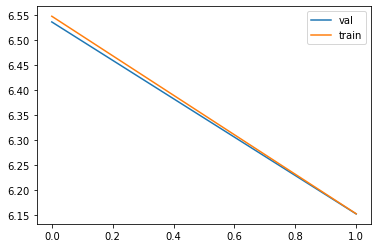

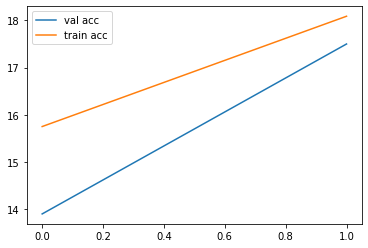


Iteration 600, loss = 5.8605
Checking accuracy on validation set
Got 236 / 1000 correct (23.60)
Checking accuracy on train set
Got 11021 / 49000 correct (22.49)


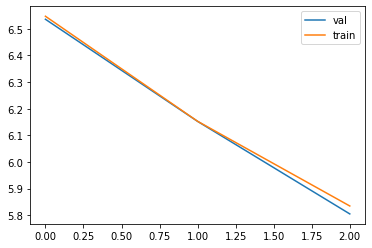

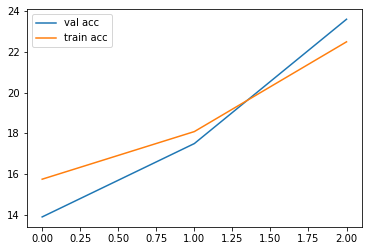


epoch  1
Iteration 0, loss = 5.5489
Checking accuracy on validation set
Got 244 / 1000 correct (24.40)
Checking accuracy on train set
Got 12823 / 49000 correct (26.17)


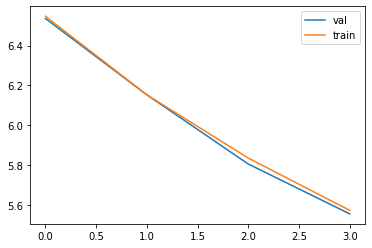

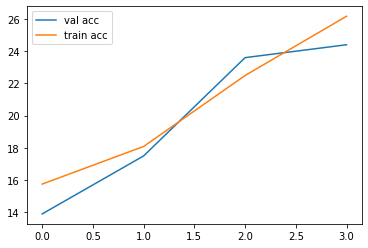


Iteration 200, loss = 5.3888
Checking accuracy on validation set
Got 253 / 1000 correct (25.30)
Checking accuracy on train set
Got 13112 / 49000 correct (26.76)


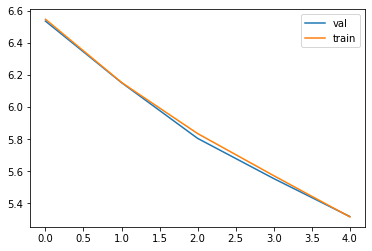

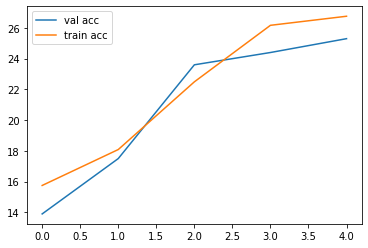


Iteration 400, loss = 5.0573
Checking accuracy on validation set
Got 320 / 1000 correct (32.00)
Checking accuracy on train set
Got 15908 / 49000 correct (32.47)


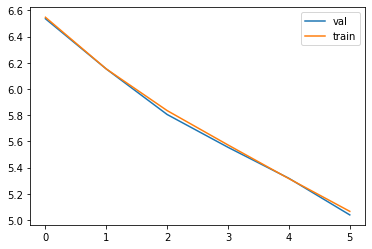

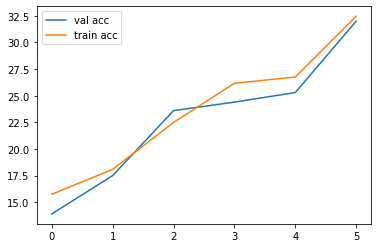


Iteration 600, loss = 4.8414
Checking accuracy on validation set
Got 318 / 1000 correct (31.80)
Checking accuracy on train set
Got 16214 / 49000 correct (33.09)


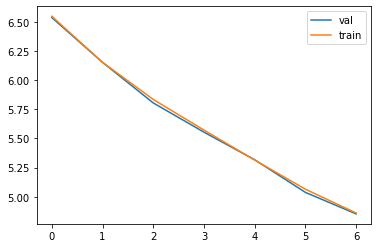

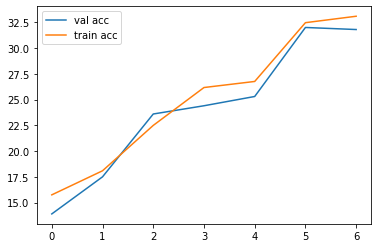


epoch  2
Iteration 0, loss = 4.6988
Checking accuracy on validation set
Got 314 / 1000 correct (31.40)
Checking accuracy on train set
Got 16654 / 49000 correct (33.99)


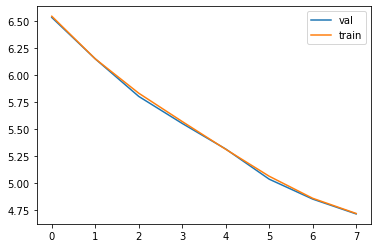

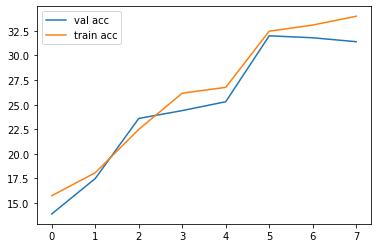


Iteration 200, loss = 4.5240
Checking accuracy on validation set
Got 368 / 1000 correct (36.80)
Checking accuracy on train set
Got 17688 / 49000 correct (36.10)


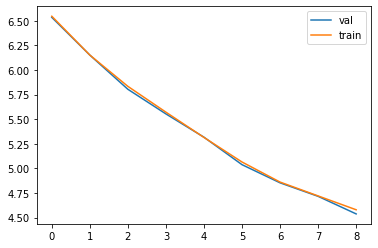

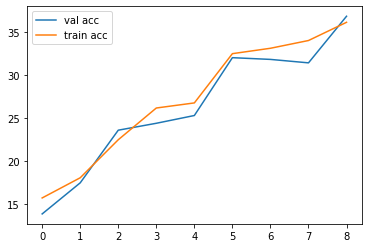


Iteration 400, loss = 4.4082
Checking accuracy on validation set
Got 375 / 1000 correct (37.50)
Checking accuracy on train set
Got 18658 / 49000 correct (38.08)


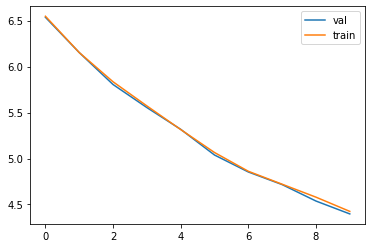

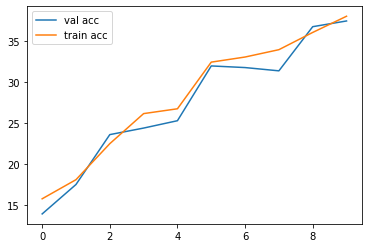


Iteration 600, loss = 4.3124
Checking accuracy on validation set
Got 398 / 1000 correct (39.80)
Checking accuracy on train set
Got 19798 / 49000 correct (40.40)


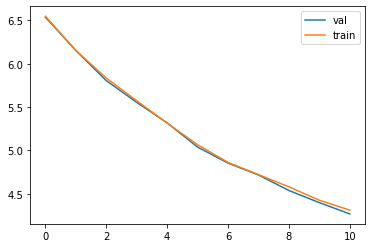

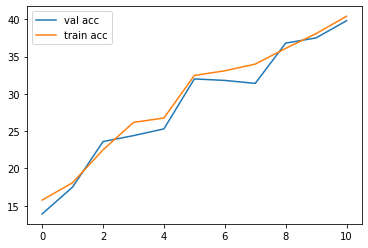


epoch  3
Iteration 0, loss = 4.2485
Checking accuracy on validation set
Got 395 / 1000 correct (39.50)
Checking accuracy on train set
Got 19803 / 49000 correct (40.41)


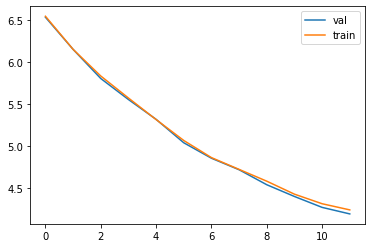

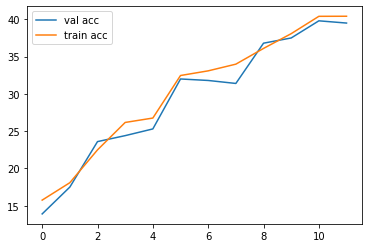


Iteration 200, loss = 4.1452
Checking accuracy on validation set
Got 380 / 1000 correct (38.00)
Checking accuracy on train set
Got 19347 / 49000 correct (39.48)


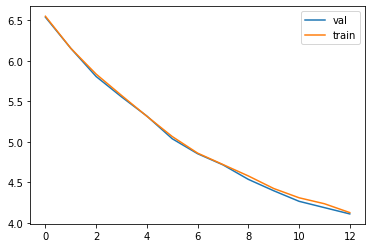

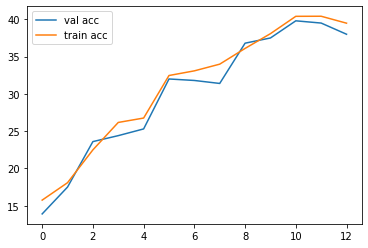


Iteration 400, loss = 4.0628
Checking accuracy on validation set
Got 410 / 1000 correct (41.00)
Checking accuracy on train set
Got 20268 / 49000 correct (41.36)


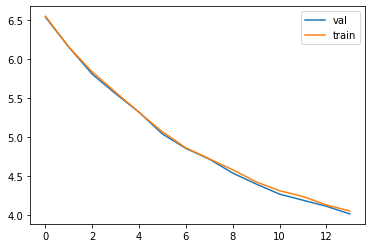

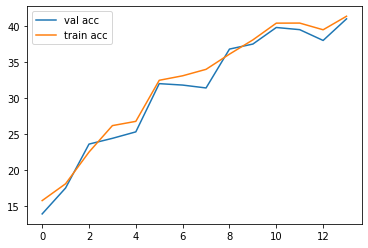


Iteration 600, loss = 4.0648
Checking accuracy on validation set
Got 415 / 1000 correct (41.50)
Checking accuracy on train set
Got 20556 / 49000 correct (41.95)


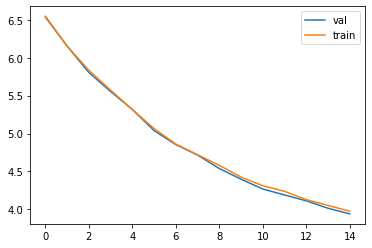

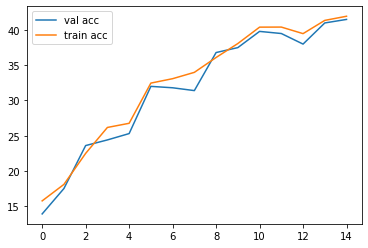


epoch  4
Iteration 0, loss = 3.9509
Checking accuracy on validation set
Got 411 / 1000 correct (41.10)
Checking accuracy on train set
Got 20015 / 49000 correct (40.85)


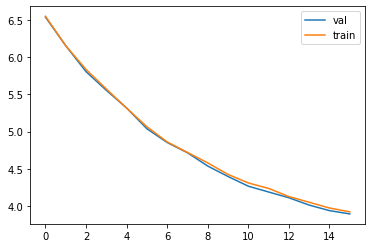

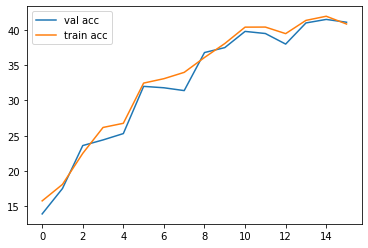


Iteration 200, loss = 3.7495
Checking accuracy on validation set
Got 404 / 1000 correct (40.40)
Checking accuracy on train set
Got 19994 / 49000 correct (40.80)


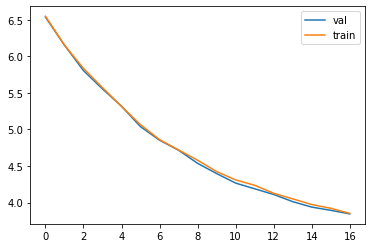

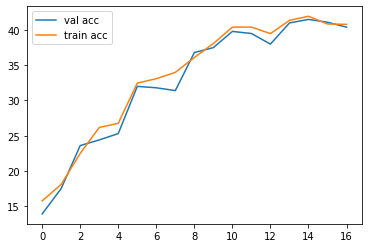


Iteration 400, loss = 3.7681
Checking accuracy on validation set
Got 443 / 1000 correct (44.30)
Checking accuracy on train set
Got 21501 / 49000 correct (43.88)


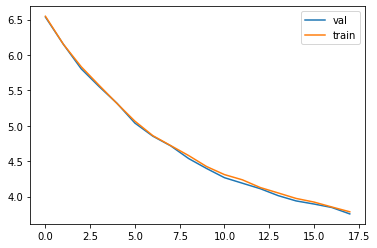

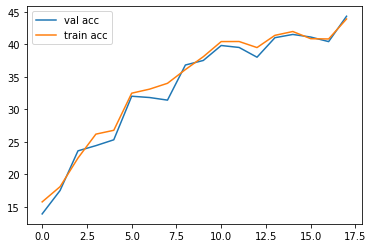


Iteration 600, loss = 3.7602
Checking accuracy on validation set
Got 452 / 1000 correct (45.20)
Checking accuracy on train set
Got 21621 / 49000 correct (44.12)


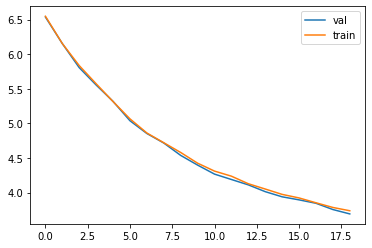

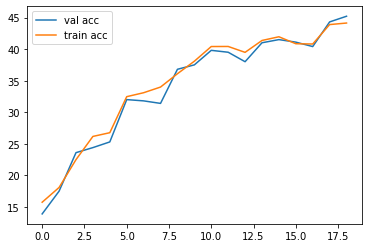


epoch  5
Iteration 0, loss = 3.7305
Checking accuracy on validation set
Got 421 / 1000 correct (42.10)
Checking accuracy on train set
Got 20901 / 49000 correct (42.66)


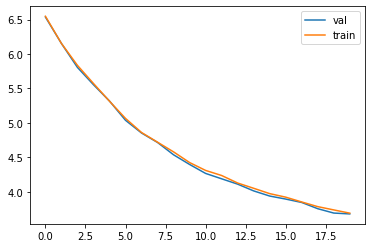

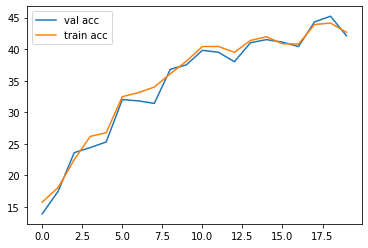


Iteration 200, loss = 3.6672
Checking accuracy on validation set
Got 424 / 1000 correct (42.40)
Checking accuracy on train set
Got 21322 / 49000 correct (43.51)


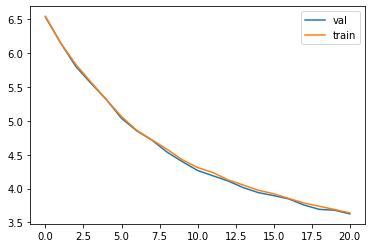

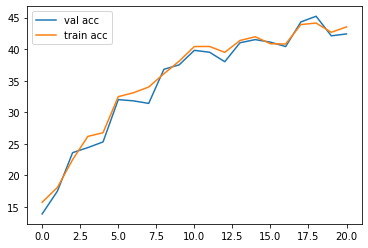


Iteration 400, loss = 3.5907
Checking accuracy on validation set
Got 452 / 1000 correct (45.20)
Checking accuracy on train set
Got 22391 / 49000 correct (45.70)


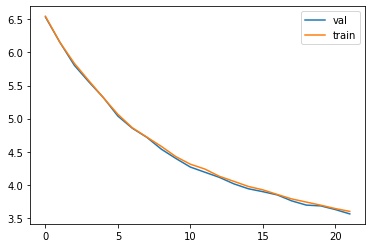

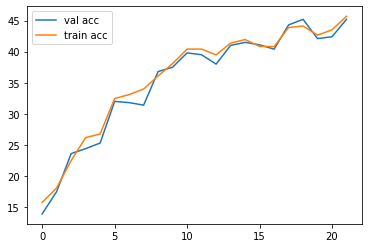


Iteration 600, loss = 3.5401
Checking accuracy on validation set
Got 458 / 1000 correct (45.80)
Checking accuracy on train set
Got 22286 / 49000 correct (45.48)


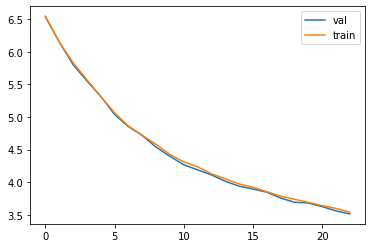

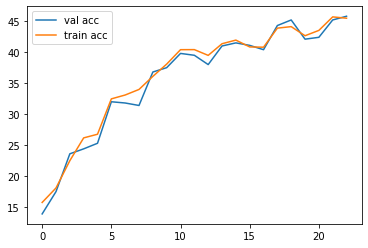


epoch  6
Iteration 0, loss = 3.5625
Checking accuracy on validation set
Got 440 / 1000 correct (44.00)
Checking accuracy on train set
Got 22492 / 49000 correct (45.90)


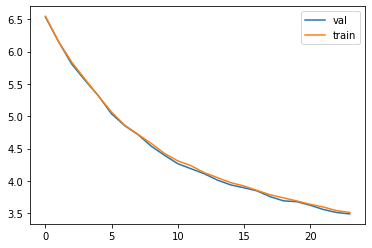

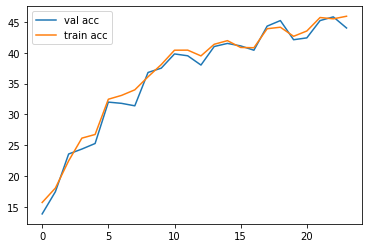


Iteration 200, loss = 3.5001
Checking accuracy on validation set
Got 444 / 1000 correct (44.40)
Checking accuracy on train set
Got 22845 / 49000 correct (46.62)


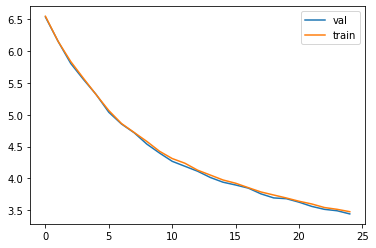

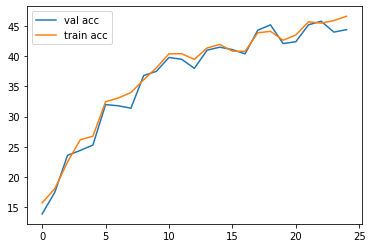


Iteration 400, loss = 3.3688
Checking accuracy on validation set
Got 463 / 1000 correct (46.30)
Checking accuracy on train set
Got 22960 / 49000 correct (46.86)


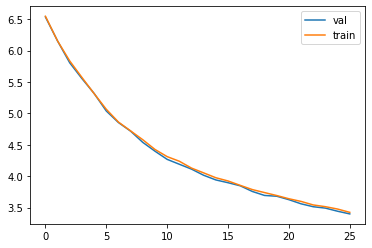

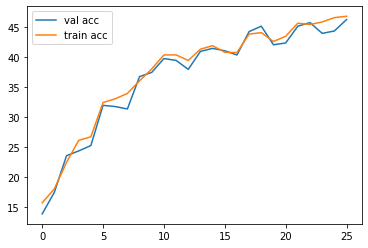


Iteration 600, loss = 3.2975
Checking accuracy on validation set
Got 474 / 1000 correct (47.40)
Checking accuracy on train set
Got 23070 / 49000 correct (47.08)


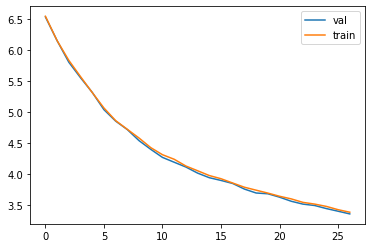

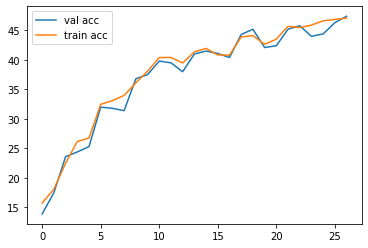


epoch  7
Iteration 0, loss = 3.3092
Checking accuracy on validation set
Got 479 / 1000 correct (47.90)
Checking accuracy on train set
Got 23447 / 49000 correct (47.85)


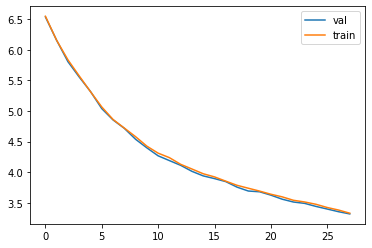

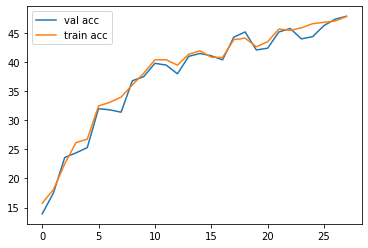


Iteration 200, loss = 3.3677
Checking accuracy on validation set
Got 466 / 1000 correct (46.60)
Checking accuracy on train set
Got 23165 / 49000 correct (47.28)


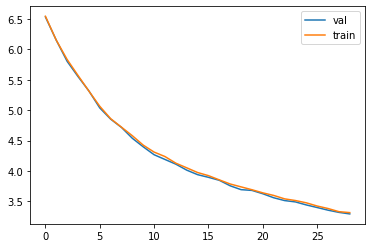

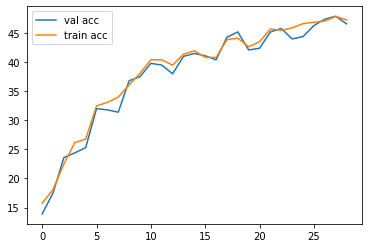


Iteration 400, loss = 3.2749
Checking accuracy on validation set
Got 474 / 1000 correct (47.40)
Checking accuracy on train set
Got 23698 / 49000 correct (48.36)


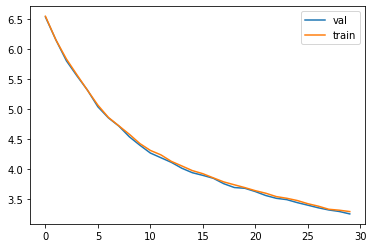

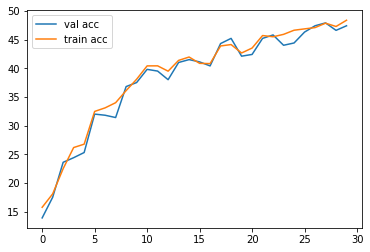


Iteration 600, loss = 3.2231
Checking accuracy on validation set
Got 489 / 1000 correct (48.90)
Checking accuracy on train set
Got 23959 / 49000 correct (48.90)


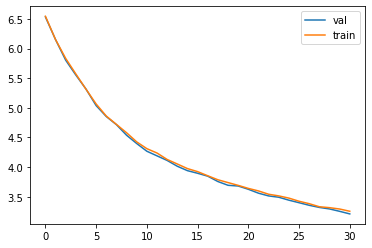

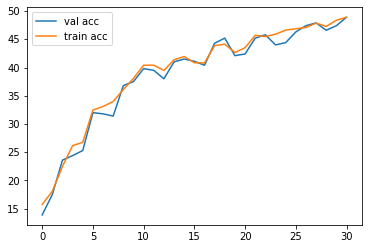


epoch  8
Iteration 0, loss = 3.2366
Checking accuracy on validation set
Got 473 / 1000 correct (47.30)
Checking accuracy on train set
Got 23914 / 49000 correct (48.80)


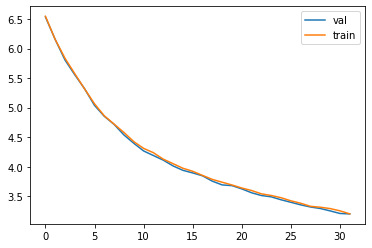

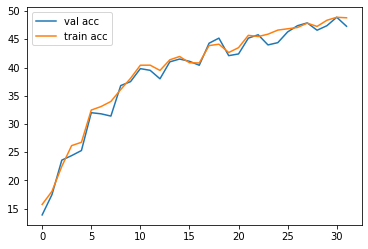


Iteration 200, loss = 3.1391
Checking accuracy on validation set
Got 487 / 1000 correct (48.70)
Checking accuracy on train set
Got 24601 / 49000 correct (50.21)


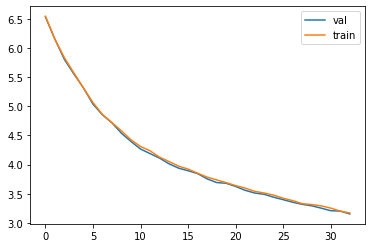

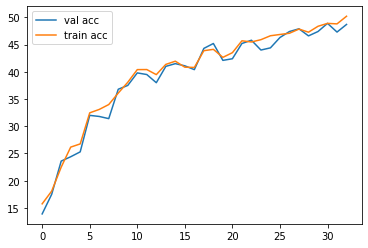


Iteration 400, loss = 3.2110
Checking accuracy on validation set
Got 485 / 1000 correct (48.50)
Checking accuracy on train set
Got 24494 / 49000 correct (49.99)


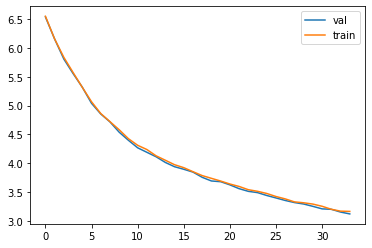

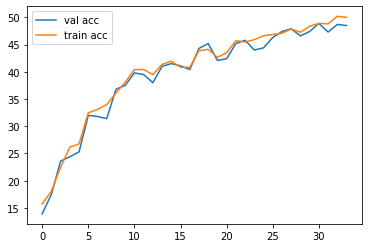


Iteration 600, loss = 3.1095
Checking accuracy on validation set
Got 487 / 1000 correct (48.70)
Checking accuracy on train set
Got 24559 / 49000 correct (50.12)


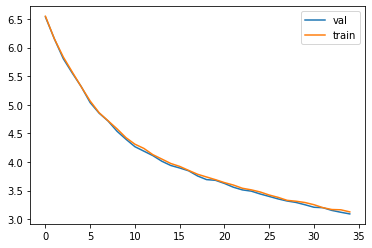

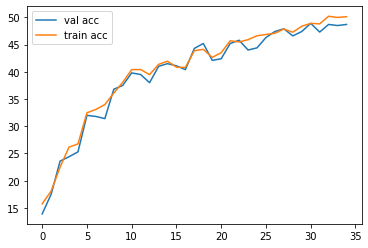


epoch  9
Iteration 0, loss = 3.1699
Checking accuracy on validation set
Got 506 / 1000 correct (50.60)
Checking accuracy on train set
Got 25033 / 49000 correct (51.09)


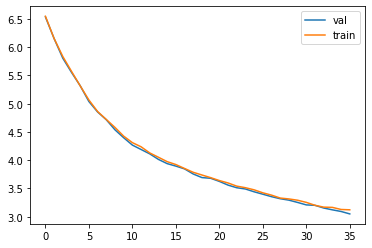

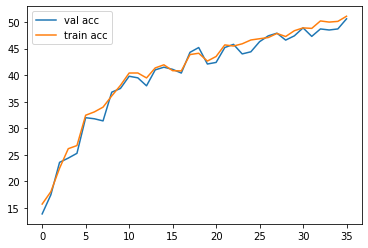


Iteration 200, loss = 3.0092
Checking accuracy on validation set
Got 500 / 1000 correct (50.00)
Checking accuracy on train set
Got 24531 / 49000 correct (50.06)


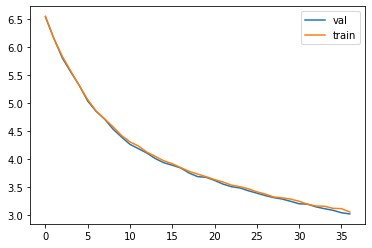

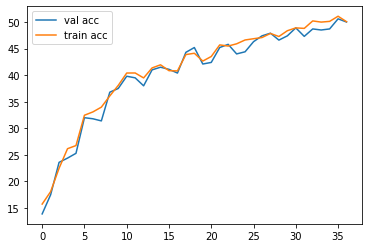


Iteration 400, loss = 3.0905
Checking accuracy on validation set
Got 485 / 1000 correct (48.50)
Checking accuracy on train set
Got 24311 / 49000 correct (49.61)


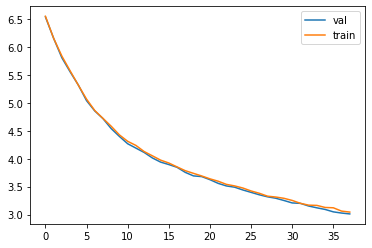

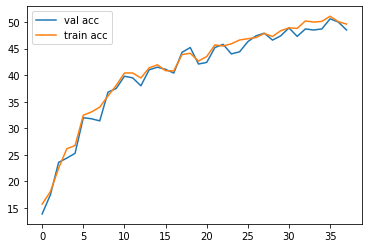


Iteration 600, loss = 2.9751
Checking accuracy on validation set
Got 498 / 1000 correct (49.80)
Checking accuracy on train set
Got 24618 / 49000 correct (50.24)


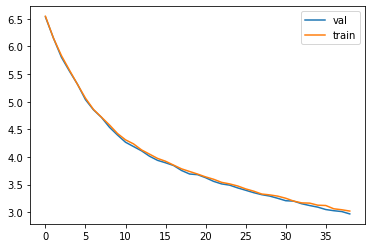

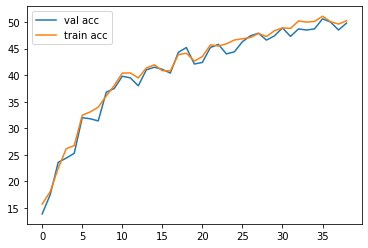


epoch  10
Iteration 0, loss = 2.9759
Checking accuracy on validation set
Got 523 / 1000 correct (52.30)
Checking accuracy on train set
Got 25705 / 49000 correct (52.46)


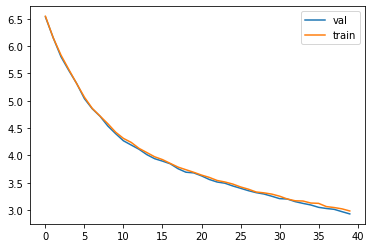

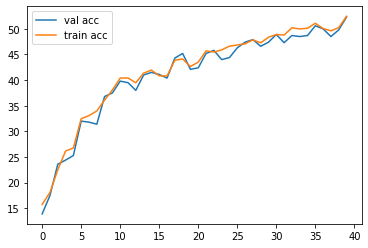


Iteration 200, loss = 2.8921
Checking accuracy on validation set
Got 531 / 1000 correct (53.10)
Checking accuracy on train set
Got 25837 / 49000 correct (52.73)


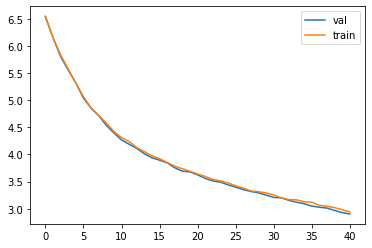

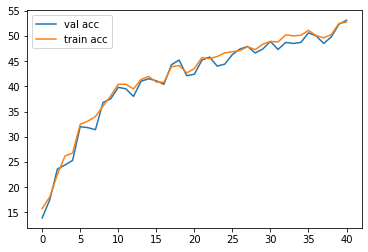


Iteration 400, loss = 2.9333
Checking accuracy on validation set
Got 510 / 1000 correct (51.00)
Checking accuracy on train set
Got 25770 / 49000 correct (52.59)


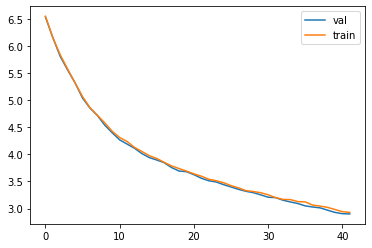

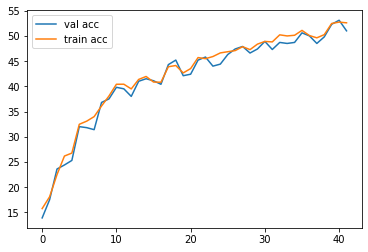


Iteration 600, loss = 2.8525
Checking accuracy on validation set
Got 541 / 1000 correct (54.10)
Checking accuracy on train set
Got 25849 / 49000 correct (52.75)


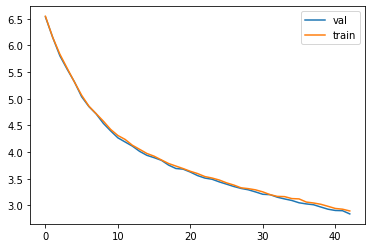

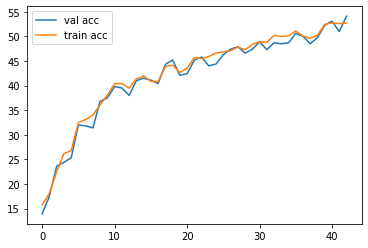


epoch  11
Iteration 0, loss = 2.8012
Checking accuracy on validation set
Got 517 / 1000 correct (51.70)
Checking accuracy on train set
Got 25516 / 49000 correct (52.07)


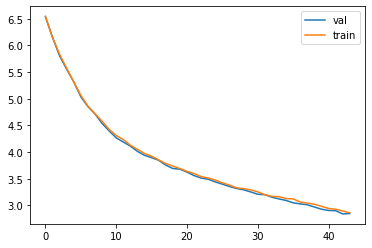

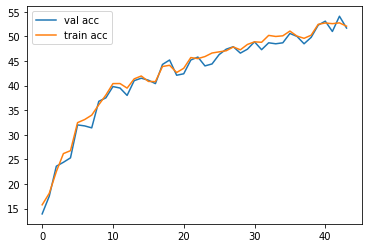


Iteration 200, loss = 2.8828
Checking accuracy on validation set
Got 509 / 1000 correct (50.90)
Checking accuracy on train set
Got 25903 / 49000 correct (52.86)


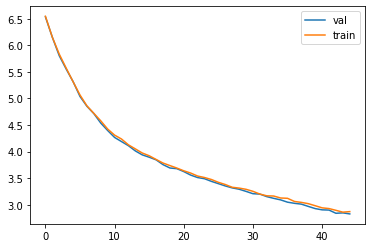

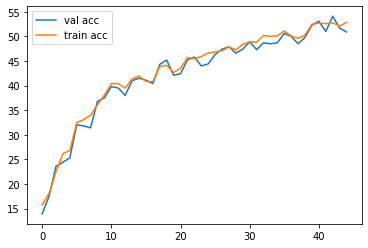


Iteration 400, loss = 2.8017
Checking accuracy on validation set
Got 539 / 1000 correct (53.90)
Checking accuracy on train set
Got 26920 / 49000 correct (54.94)


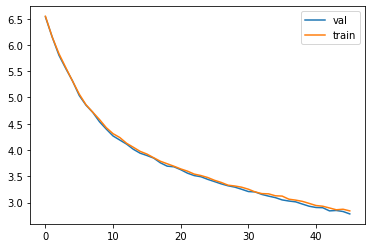

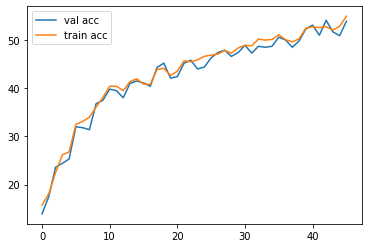


Iteration 600, loss = 2.8169
Checking accuracy on validation set
Got 522 / 1000 correct (52.20)
Checking accuracy on train set
Got 26379 / 49000 correct (53.83)


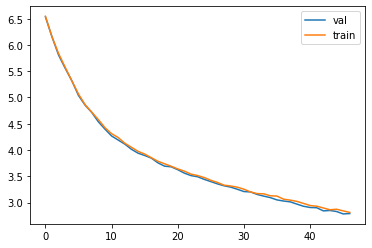

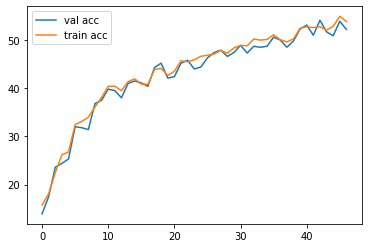


epoch  12
Iteration 0, loss = 2.6773
Checking accuracy on validation set
Got 545 / 1000 correct (54.50)
Checking accuracy on train set
Got 26833 / 49000 correct (54.76)


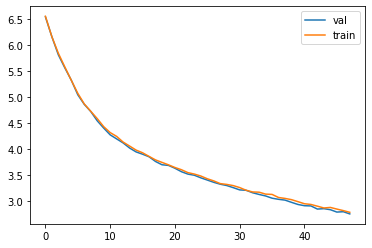

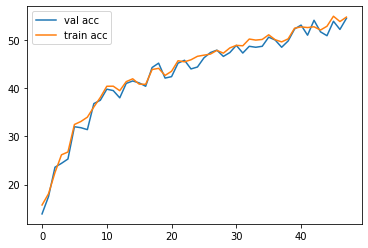


Iteration 200, loss = 2.8474
Checking accuracy on validation set
Got 528 / 1000 correct (52.80)
Checking accuracy on train set
Got 26424 / 49000 correct (53.93)


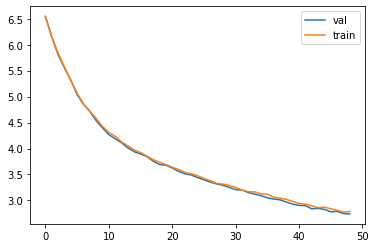

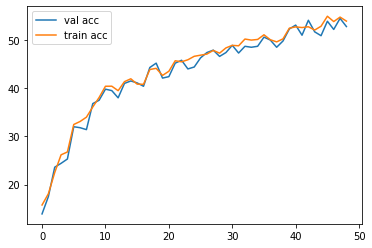


Iteration 400, loss = 2.8055
Checking accuracy on validation set
Got 545 / 1000 correct (54.50)
Checking accuracy on train set
Got 26637 / 49000 correct (54.36)


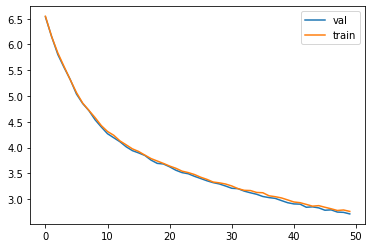

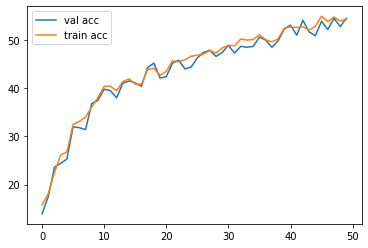


Iteration 600, loss = 2.7318
Checking accuracy on validation set
Got 538 / 1000 correct (53.80)
Checking accuracy on train set
Got 27070 / 49000 correct (55.24)


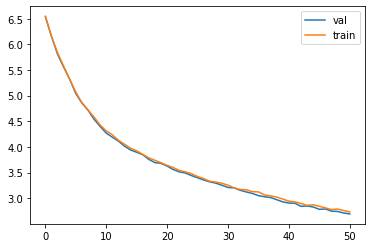

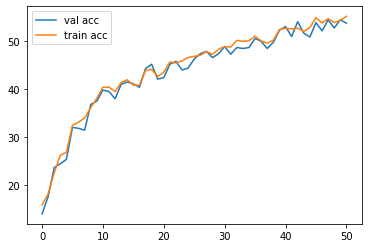


epoch  13
Iteration 0, loss = 2.6907
Checking accuracy on validation set
Got 546 / 1000 correct (54.60)
Checking accuracy on train set
Got 27524 / 49000 correct (56.17)


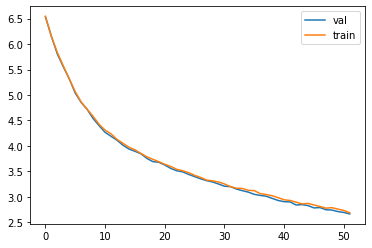

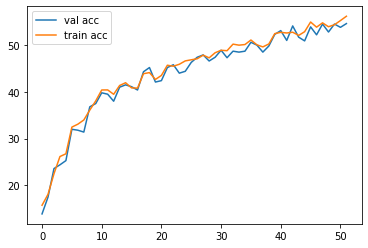


Iteration 200, loss = 2.7455
Checking accuracy on validation set
Got 566 / 1000 correct (56.60)
Checking accuracy on train set
Got 27720 / 49000 correct (56.57)


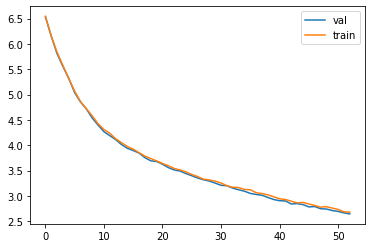

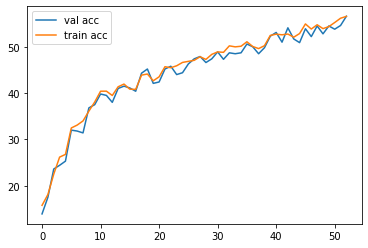


Iteration 400, loss = 2.6737
Checking accuracy on validation set
Got 553 / 1000 correct (55.30)
Checking accuracy on train set
Got 27810 / 49000 correct (56.76)


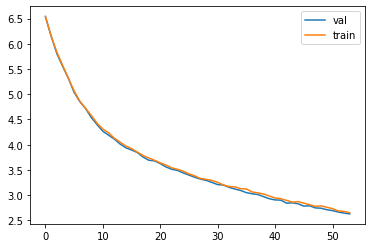

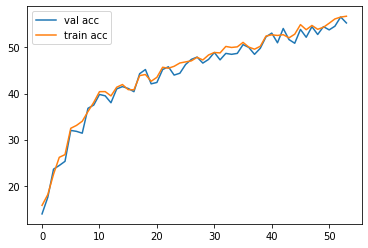


Iteration 600, loss = 2.6378
Checking accuracy on validation set
Got 537 / 1000 correct (53.70)
Checking accuracy on train set


In [ ]:
# Another model

import torch
# assert '.'.join(torch.__version__.split('.')[:2]) == '1.4'
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler

import torchvision.datasets as dset
import torchvision.transforms as T

import numpy as np

NUM_TRAIN = 49000

# The torchvision.transforms package provides tools for preprocessing data
# and for performing data augmentation; here we set up a transform to
# preprocess the data by subtracting the mean RGB value and dividing by the
# standard deviation of each RGB value; we've hardcoded the mean and std.
transform = T.Compose([
                T.ToTensor(),
                T.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
            ])

# We set up a Dataset object for each split (train / val / test); Datasets load
# training examples one at a time, so we wrap each Dataset in a DataLoader which
# iterates through the Dataset and forms minibatches. We divide the CIFAR-10
# training set into train and val sets by passing a Sampler object to the
# DataLoader telling how it should sample from the underlying Dataset.
cifar10_train = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                             transform=transform)
loader_train = DataLoader(cifar10_train, batch_size=64, 
                          sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN)))

cifar10_val = dset.CIFAR10('./cs231n/datasets', train=True, download=True,
                           transform=transform)
loader_val = DataLoader(cifar10_val, batch_size=64, 
                        sampler=sampler.SubsetRandomSampler(range(NUM_TRAIN, 50000)))

cifar10_test = dset.CIFAR10('./cs231n/datasets', train=False, download=True, 
                            transform=transform)
loader_test = DataLoader(cifar10_test, batch_size=64)
!nvidia-smi

USE_GPU = True

dtype = torch.float32 # we will be using float throughout this tutorial

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

# Constant to control how frequently we print train loss

print('using device:', device)
!nvidia-smi

import matplotlib.pyplot as plt
from statistics import mean 
import torch.nn.functional as F  # useful stateless functions

def check_accuracy_part34(loader, model, train_part=False):
    if train_part==False:
      if loader.dataset.train:
          print('Checking accuracy on validation set')
      else:
          print('Checking accuracy on test set')   
    else:
       print('Checking accuracy on train set')
    num_correct = 0
    num_samples = 0
    model.eval()  # set model to evaluation mode

    batch_loss = []
    with torch.no_grad():
        for x, y in loader:
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)
            scores = model(x)
            _, preds = scores.max(1)
            num_correct += (preds == y).sum()
            num_samples += preds.size(0)
            # print(nn.CrossEntropyLoss()(scores, y).type)
            # print(nn.CrossEntropyLoss()(scores, y))

            batch_loss.append(nn.CrossEntropyLoss()(scores, y).item())

        acc = float(num_correct) / num_samples

        print('Got %d / %d correct (%.2f)' % (num_correct, num_samples, 100 * acc))
        return sum(batch_loss)/len(batch_loss), 100 * acc, 
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

def train_part(model, optimizer, epochs=1, ld=0.01, print_every = 100):
    """
    Train a model on CIFAR-10 using the PyTorch Module API.
    
    Inputs:
    - model: A PyTorch Module giving the model to train.
    - optimizer: An Optimizer object we will use to train the model
    - epochs: (Optional) A Python integer giving the number of epochs to train for
    
    Returns: Nothing, but prints model accuracies during training.
    """

    trainning_loss = []
    val_loss = []
    model = model.to(device=device)  # move the model parameters to CPU/GPU
    ave_trainning_loss = 0.0

    train_acc_hist = []
    val_acc_hist  = []
    for e in range(epochs):
        print("epoch ", e)
        for t, (x, y) in enumerate(loader_train):
            model.train()  # put model to training mode
            x = x.to(device=device, dtype=dtype)  # move to device, e.g. GPU
            y = y.to(device=device, dtype=torch.long)

            scores = model(x)
            # print(scores.item())
            loss = nn.CrossEntropyLoss()(scores, y)

            l2_reg = 0.0
            for param in model.parameters():
                l2_reg += torch.norm(param, 2)
            loss += ld*l2_reg

            ave_trainning_loss = loss.item()*0.1 + 0.9*ave_trainning_loss

            # Zero out all of the gradients for the variables which the optimizer
            # will update.
            optimizer.zero_grad()

            # This is the backwards pass: compute the gradient of the loss with
            # respect to each  parameter of the model.
            loss.backward()


            # Actually update the parameters of the model using the gradients
            # computed by the backwards pass.
            optimizer.step()

            if t % print_every == 0:
                print('Iteration %d, loss = %.4f' % (t, loss.item()))
                # print('Valid loss = ', val_loss)
                val_loss_, val_acc = check_accuracy_part34(loader_val, model)
                _, train_acc  = check_accuracy_part34(loader_train, model, train_part=True)
                trainning_loss.append(ave_trainning_loss)
                val_loss.append(val_loss_ + ld*l2_reg)

                train_acc_hist.append(train_acc)
                val_acc_hist.append(val_acc)

                # print(trainning_loss)
                # print(val_loss)
                if len(val_loss) > 2:
                  plt.plot(list(range(len(val_loss)-1)), val_loss[1:], label='val')
                  plt.plot(list(range(len(trainning_loss)-1)), trainning_loss[1:], label='train')
                  plt.legend()
                  plt.show()

                  plt.plot(list(range(len(val_acc_hist)-1)), val_acc_hist[1:], label='val acc')
                  plt.plot(list(range(len(train_acc_hist)-1)), train_acc_hist[1:], label='train acc')
                  plt.legend()
                  plt.show()
                print()


model = None
optimizer = None

channel_1  = int(8)
channel_2  = int(16)
channel_3  = int(32)

channel_4  = int(32)
channel_5  = int(32)
channel_6  = int(32)

channel_7  = int(64)
channel_8  = int(64)
channel_9  = int(64)

channel_10 = int(128)
channel_11 = int(128)
channel_12 = int(128)

channel_13 = int(256)
channel_14 = int(256)
channel_15 = int(256)

channel_16 = int(256)

# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
def flatten(x):
    N = x.shape[0] # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image
    
class Flatten(nn.Module):
    def forward(self, x):
        return flatten(x)

model = nn.Sequential(
    nn.Conv2d(in_channels=3,         out_channels=channel_1, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_1),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_1, out_channels=channel_2, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_2),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_2, out_channels=channel_3, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_3),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_3, out_channels=channel_4, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_4),
    nn.LeakyReLU(),
    nn.Dropout2d(p=0.2),

    nn.Conv2d(in_channels=channel_4, out_channels=channel_5, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_5),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_5, out_channels=channel_6, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_6),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_6, out_channels=channel_7, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_7),
    nn.LeakyReLU(),
    nn.Dropout2d(p=0.2),

    nn.Conv2d(in_channels=channel_7, out_channels=channel_8, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_8),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_8, out_channels=channel_9, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_9),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_9, out_channels=channel_10, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_10),
    nn.LeakyReLU(),
    nn.Dropout2d(p=0.2),

    nn.Conv2d(in_channels=channel_10, out_channels=channel_11, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_11),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_11, out_channels=channel_12, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_12),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_12, out_channels=channel_13, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_13),
    nn.LeakyReLU(),
    nn.Dropout2d(p=0.2),

    nn.Conv2d(in_channels=channel_13, out_channels=channel_14, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_14),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_14, out_channels=channel_15, kernel_size=3, padding=1),
    nn.BatchNorm2d(num_features=channel_15),
    nn.LeakyReLU(),

    nn.Conv2d(in_channels=channel_15, out_channels=channel_16, kernel_size=2, padding=0, stride=2),
    nn.BatchNorm2d(num_features=channel_16),
    nn.LeakyReLU(),

    Flatten(),
    nn.Linear(channel_16, 1000),
    nn.Linear(1000, 1000),
    nn.Linear(1000, 10),
    nn.Softmax(),
)

for m in model:
    if isinstance(m, nn.Conv2d):
        nn.init.kaiming_normal_(m.weight)
    if isinstance(m, nn.Linear):
      nn.init.kaiming_normal_(m.weight)
    # nn.init.normal(m.weight, mean=0, std=0.01)
    # nn.init.constant(m.bias, 0)

# you can use Nesterov momentum in optim.SGD
learning_rate = 1e-4

optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=0.01)
# scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=3, eps=1e-7, verbose=True )

# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****
################################################################################
#                                 END OF YOUR CODE                             
################################################################################

# You should get at least 70% accuracy
!nvidia-smi
train_part(model, optimizer, epochs=50, ld=1e-2, print_every=200)
!nvidia-smi
best_model = model
check_accuracy_part34(loader_test, best_model)